In [1]:
import os.path as path
import os
up = path.abspath(path.join('FastRCNNPredictor.ipynb' ,"../../../.."))

In [2]:
up

'/dih4/dih4_2/wimlds'

In [16]:
working_dir = up + '/mkortas/detect-waste/FastRCNN/'
data_file = up + '/mkortas/detect-waste/annotations/annotat.csv'
data_folder = up + '/TACO-master/data/'
model_path = up + '/mkortas/detect-waste/models/model'
num_classes = 28

In [4]:
os.chdir(working_dir)

In [5]:
import numpy as np
import os
import torch
import pycocotools
import torch.utils.data
from PIL import Image
import pandas as pd
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from engine import train_one_epoch, evaluate
import utils
import transforms as T
from  PIL import ImageDraw
import os.path as path
import re

In [6]:
def parse_one_annot(path_to_data_file, filename):
    data = pd.read_csv(path_to_data_file)
    print(filename)
    boxes_array = data[data["filename"] == filename][["xmin", "ymin",        
    "xmax", "ymax"]].values
    print(boxes_array)
    return boxes_array

In [7]:
def getListOfFiles(dirName):
    listOfFile = os.listdir(dirName)
    allFiles = list()
    for entry in listOfFile:
        fullPath = os.path.join(dirName, entry)
        if os.path.isdir(fullPath):
            allFiles = allFiles + getListOfFiles(fullPath)
        else:
                fullPath = fullPath.replace(data_folder, '')
                allFiles.append(fullPath)  
    return allFiles    

In [8]:
class Dataset(torch.utils.data.Dataset):
    def __init__(self, root, data_file, transforms=None):
        self.root = root
        self.transforms = transforms
        files = getListOfFiles(os.path.join(root))
        p = re.compile('batch')
        l2 = [ s for s in files if p.match(s) ]
        self.imgs = sorted(l2)
        self.path_to_data_file = data_file
    def __getitem__(self, idx):
        img_path = os.path.join(self.root, self.imgs[idx])
        self.imgs[idx] = self.imgs[idx]
        img = Image.open(img_path).convert("RGB")
        box_list = parse_one_annot(self.path_to_data_file, self.imgs[idx])
        boxes = torch.as_tensor(box_list, dtype=torch.float32)
        num_objs = len(box_list)
        labels = torch.ones((num_objs,), dtype=torch.int64)
        image_id = torch.tensor([idx])
        area = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:,0])
        iscrowd = torch.zeros((num_objs,), dtype=torch.int64)
        target = {}
        target["boxes"] = boxes
        target["labels"] = labels
        target["image_id"] = image_id
        target["area"] = area
        target["iscrowd"] = iscrowd
        if self.transforms is not None:
                 img, target = self.transforms(img, target)
        return img, target
    
    def __len__(self):
        return len(self.imgs)

In [9]:
dataset = Dataset(root= data_folder, data_file= data_file)

In [10]:
def get_model(num_classes):
    model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features,num_classes)
    return model

In [11]:
def get_transform(train):
    transforms = []
    transforms.append(T.ToTensor())
    if train:
        transforms.append(T.RandomHorizontalFlip(0.5))
    return T.Compose(transforms)

In [12]:
dataset = Dataset(root= data_folder, data_file= data_file , transforms = get_transform(train=True))
dataset_test = Dataset(root= data_folder, data_file= data_file , transforms = get_transform(train=False))

torch.manual_seed(1)
indices = torch.randperm(len(dataset)).tolist()
testing_num = int(len(dataset)*0.2)
dataset = torch.utils.data.Subset(dataset, indices[:-testing_num])
dataset_test = torch.utils.data.Subset(dataset_test, indices[-testing_num:])
data_loader = torch.utils.data.DataLoader(
              dataset, batch_size=2, shuffle=True, num_workers=4,
              collate_fn=utils.collate_fn)
data_loader_test = torch.utils.data.DataLoader(
         dataset_test, batch_size=1, shuffle=False, num_workers=4,
         collate_fn=utils.collate_fn)
print("We have: {} examples, {} are training and {} testing".format(len(indices), len(dataset), len(dataset_test)))

We have: 1500 examples, 1200 are training and 300 testing


In [13]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model = get_model(num_classes)
model.to(device)
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.005,
                            momentum=0.9, weight_decay=0.0005)
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer,
                                               step_size=3,
                                               gamma=0.1)

In [13]:
num_epochs = 10
for epoch in range(num_epochs):
    train_one_epoch(model, optimizer, data_loader, device, epoch, print_freq=10)
    lr_scheduler.step()
    evaluate(model, data_loader_test, device=device)

batch_1/000119.JPG
batch_9/000025.jpg
[[ 922. 1748. 2940. 4039.]]
batch_1/000073.JPG
[[ 716. 1443. 2848. 3585.]
 [1074. 3039. 2637. 3456.]]
[[ 940.  837. 2940. 3975.]]
batch_12/000086.jpg
[[1478. 2524. 3486. 5155.]
 [1658.  290. 3744. 4727.]
 [1615.  674. 3307. 4364.]
 [1816. 3630. 4219. 4672.]]
batch_4/000087.JPG
[[1114. 1104. 3388. 2550.]
 [1526.  919. 3383. 2530.]
 [1999.  522. 3691. 2865.]
 [1926.  472. 3567. 3249.]
 [ 193. 1103. 3325. 2515.]]
batch_12/000038.jpg
[[ 482.3333  2051.2856  3392.      4256.     ]
 [1234.1428  2224.3333  3423.      4369.     ]
 [ 696.1428  1824.9048  3290.      4251.     ]
 [2288.9048  3128.5713  3475.99995 4284.     ]
 [1616.5238  2275.524   3158.      4157.     ]
 [ 109.9524  2187.1904  3164.      4173.     ]]
batch_6/000063.JPG
[[ 787. 1774. 4414. 2761.]]
batch_15/000061.jpg
[[ 714.  535. 1709. 2708.]]
batch_5/000058.JPG
batch_15/000037.jpg
[[1092. 1262. 2609. 3505.]
 [1268. 2366. 2472. 3314.]
 [1318. 1888. 2474. 3298.]
 [1308. 1762. 2470. 3306.]
 [ 

 [2.890e+02 1.923e+03 1.801e+03 2.168e+03]]
batch_1/000067.JPG
[[  31.  194. 4148. 5371.]]
batch_11/000094.jpg
[[ 801.  947. 4222. 8001.]
 [ 596. 1646. 4357. 6316.]]
batch_15/000028.jpg
[[ 822. 1605. 2014. 2229.]
 [ 793. 1941. 1599. 2102.]
 [1012. 1293. 1632. 2284.]
 [1056. 1373. 1557. 2131.]
 [ 841. 1105. 1633. 2130.]
 [ 718.  763. 1630. 2136.]
 [ 436.  880. 1765. 2264.]
 [ 172. 1051. 1649. 2125.]
 [ 263.  815. 1627. 2131.]
 [ 437.  353. 1650. 2126.]
 [1039. 1011. 1622. 2098.]
 [1036. 1826. 1592. 2089.]
 [ 842. 1465. 1641. 2119.]
 [ 197.  260. 1558. 2084.]]
batch_15/000066.jpg
[[2179. 1240. 4762. 4059.]
 [ 288.  292. 4125. 3083.]
 [  96. 1629. 4117. 3111.]
 [ 805. 2545. 4063. 3061.]
 [3414. 2708. 4078. 3061.]
 [3945.   67. 4060. 3055.]
 [ 847. 2018. 4091. 3089.]
 [1351.  268. 4118. 3087.]]
batch_6/000102.JPG
[[1467. 1439. 2523. 3385.]
 [1395. 1845. 2649. 3371.]
 [1089. 1423. 2668. 3463.]
 [1038. 2820. 2543. 3388.]
 [ 481. 2865. 2579. 3332.]]
batch_7/000120.JPG
[[1395. 1346. 3635. 2586

 [1592. 1924. 2486. 3295.]]
batch_8/000071.jpg
[[2075. 1281. 3620. 2761.]
 [2700.  954. 3446. 2682.]]
batch_7/000091.JPG
[[1741. 1200. 3486. 3108.]
 [1819. 1200. 3338. 2533.]]
batch_8/000097.jpg
[[ 657. 1018. 2597. 4265.]
 [1082. 1279. 2581. 4385.]]
batch_14/000050.jpg
[[ 542. 3319. 5506. 4743.]]
batch_13/000035.jpg
[[1237.  525. 6369. 4351.]
 [1830. 1555. 5288. 3821.]]
batch_13/000090.jpg
[[ 840.  973. 5224. 4199.]
 [2559.  884. 5282. 4221.]]
batch_12/000028.jpg
[[1.000e+00 3.101e+03 3.567e+03 5.769e+03]
 [1.074e+03 2.286e+03 3.406e+03 5.746e+03]
 [1.942e+03 2.824e+03 3.521e+03 5.887e+03]
 [1.980e+03 2.901e+03 3.085e+03 5.376e+03]
 [2.579e+03 4.651e+03 3.397e+03 5.539e+03]
 [1.911e+03 4.110e+02 3.056e+03 5.413e+03]
 [4.400e+02 1.792e+03 3.205e+03 5.545e+03]
 [1.367e+03 1.130e+03 3.082e+03 5.418e+03]
 [1.093e+03 1.338e+03 3.042e+03 5.365e+03]
 [2.834e+03 2.511e+03 3.141e+03 6.305e+03]]
batch_7/000073.JPG
[[1041. 1327. 2712. 3437.]
 [1434. 1898. 2492. 3305.]
 [1100. 2040. 2498. 3286.]
 

 [ 118. 2243. 3005. 5350.]]
batch_13/000048.jpg
[[ 930. 1688. 3835. 5713.]]
batch_14/000039.jpg
[[ 852. 1713. 4230. 5155.]]
batch_10/000002.jpg
[[ 643.  551. 4116. 1875.]
 [ 257. 1386. 4116. 1852.]
 [1224.  994. 4406. 2024.]
 [1224. 1159. 4033. 1861.]
 [1217.  429. 4139. 1883.]
 [   7.  689. 4102. 1906.]]
batch_3/IMG_4914.JPG
[[  41.  775. 3406. 4256.]
 [1601.  510. 3251. 4206.]
 [ 504.  774. 2941. 3695.]
 [1702.  509. 3149. 3880.]
 [1220. 1287. 2662. 3470.]]
batch_2/000098.JPG
[[1031. 1093. 2647. 3366.]
 [ 854.  422. 2488. 3280.]
 [ 840.  152. 2462. 3284.]
 [1240.  212. 2470. 3290.]
 [ 998.  720. 2494. 3298.]
 [1382.  532. 2472. 3278.]
 [ 252. 1318. 2496. 3282.]
 [ 724.  922. 2470. 3288.]]
Epoch: [0]  [130/600]  eta: 0:05:26  lr: 0.001097  loss: 0.2419 (0.7123)  loss_classifier: 0.0609 (0.4346)  loss_box_reg: 0.0796 (0.0744)  loss_objectness: 0.0286 (0.1101)  loss_rpn_box_reg: 0.0418 (0.0932)  time: 0.5849  data: 0.2271  max mem: 5403
batch_11/000024.jpg
[[3103.     1832.7228 6347.   

 [ 826. 2647. 2461. 3283.]]
batch_14/000079.jpg
[[1324. 2005. 4041. 4892.]
 [1848. 2531. 3510. 4614.]
 [1074. 1449. 3593. 4740.]
 [2198. 2085. 3191. 4137.]]
batch_7/000083.JPG
[[ 650. 1100. 2906. 3723.]
 [1992.  890. 2490. 3309.]
 [ 340. 1310. 2476. 3298.]]
batch_14/000069.jpg
[[  25. 1561. 5339. 5406.]
 [1536. 1844. 3388. 4504.]]
batch_7/000098.JPG
[[1103. 1273. 4395. 2850.]]
batch_15/000065.jpg
[[1861. 1405. 4586. 3733.]
 [2179. 1519. 4495. 3086.]
 [2124. 1508. 4124. 3109.]
 [2700. 1121. 4150. 3174.]]
batch_11/000049.jpg
[[1214. 1935. 3580. 4595.]]
batch_2/000015.JPG
[[1239. 1706. 2927. 3602.]]
batch_11/000003.jpg
batch_1/000092.JPG
[[ 131. 1160. 2544. 4799.]
 [ 194. 1674. 3356. 5541.]
 [ 687.  226. 2959. 5619.]
 [1681. 1803. 1929. 4117.]
 [1689. 1838. 1957. 4184.]]
[[ 277.  686. 3581. 4462.]
 [1533.  926. 3066. 3920.]
 [1535.  926. 3062. 3789.]]
batch_9/000083.jpg
[[ 719. 1199. 2318. 4709.]]
batch_6/000017.JPGbatch_11/000096.jpg

[[1507.8572 2824.8096 3345.     5693.    ]
 [1445.   

 [1096. 1178. 3302. 2570.]]
batch_7/000085.JPG
[[6.940e+02 2.484e+03 2.876e+03 3.598e+03]
 [9.270e+02 1.786e+03 2.809e+03 3.495e+03]
 [4.610e+02 1.196e+03 2.815e+03 3.373e+03]
 [4.330e+02 1.065e+03 2.599e+03 3.371e+03]
 [5.550e+02 1.481e+03 2.586e+03 3.496e+03]
 [1.064e+03 7.370e+02 2.644e+03 3.345e+03]
 [4.070e+02 8.740e+02 2.571e+03 3.413e+03]
 [5.900e+01 1.072e+03 2.613e+03 3.379e+03]
 [1.010e+02 3.100e+02 2.532e+03 3.414e+03]
 [2.000e+00 2.360e+02 2.517e+03 3.331e+03]
 [1.093e+03 2.038e+03 2.529e+03 3.350e+03]
 [5.860e+02 2.512e+03 2.587e+03 3.383e+03]
 [4.600e+02 1.223e+03 2.469e+03 3.284e+03]
 [1.064e+03 7.620e+02 2.466e+03 3.304e+03]
 [2.570e+02 1.088e+03 2.676e+03 3.431e+03]
 [0.000e+00 7.260e+02 2.895e+03 3.614e+03]
 [0.000e+00 0.000e+00 2.499e+03 3.366e+03]
 [1.350e+02 1.880e+02 2.519e+03 3.329e+03]
 [5.460e+02 2.181e+03 2.489e+03 3.316e+03]
 [7.600e+02 2.870e+03 2.492e+03 3.334e+03]]
batch_7/000071.JPG
[[1558.  807. 3508. 2528.]]
batch_5/000036.JPG
[[1341. 1627. 2683. 3498.]

 [2.000e+00 5.570e+02 4.557e+03 3.689e+03]]
batch_5/000049.JPG
[[1538. 2113. 2714. 3574.]
 [1966.  171. 2613. 3427.]
 [ 949. 1781. 2833. 3506.]
 [1435. 2322. 2722. 3626.]
 [1963.    0. 2554. 3550.]
 [1490. 2301. 2700. 3493.]
 [1974.   67. 2618. 3395.]
 [ 790. 1129. 3201. 3937.]
 [1935.  608. 2960. 3979.]
 [1451.  552. 2900. 3531.]
 [1475. 1322. 2559. 3399.]
 [1963. 2178. 2651. 3404.]
 [1734.  864. 2528. 3288.]]
batch_1/000047.jpg
[[1205.   47. 2672. 2258.]
 [ 309.   11. 2630. 2357.]
 [ 189.  751. 3666. 2126.]
 [ 189.  903. 2254. 1763.]
 [ 569.  137. 2276. 1645.]
 [1540.  171. 2295. 1648.]]
Epoch: [0]  [240/600]  eta: 0:04:07  lr: 0.002015  loss: 0.1973 (0.4993)  loss_classifier: 0.0477 (0.2655)  loss_box_reg: 0.0646 (0.0706)  loss_objectness: 0.0146 (0.0716)  loss_rpn_box_reg: 0.0546 (0.0917)  time: 0.7394  data: 0.3857  max mem: 5403
batch_10/000073.jpg
[[2312.5 1038.  4250.  1934. ]]
batch_14/000029.jpg
[[1245.9524 2700.7144 3446.     4465.    ]]
batch_7/000068.JPG
[[1503.  675. 3439

 [2378. 4791. 3073. 5735.]]
batch_10/000032.jpg
[[ 557.4 2351.  1917.  4106. ]]
batch_13/000059.jpg
[[2.000e+00 8.620e+02 3.762e+03 4.903e+03]
 [1.340e+02 1.284e+03 3.928e+03 4.857e+03]
 [6.440e+02 4.380e+02 4.558e+03 5.068e+03]
 [1.551e+03 7.110e+02 3.521e+03 4.902e+03]
 [1.178e+03 1.368e+03 3.665e+03 4.586e+03]
 [1.942e+03 6.640e+02 4.106e+03 5.086e+03]
 [1.817e+03 1.680e+03 4.231e+03 5.092e+03]
 [8.450e+02 2.616e+03 4.196e+03 5.095e+03]
 [1.178e+03 1.369e+03 3.667e+03 4.603e+03]
 [6.420e+02 1.367e+03 3.473e+03 4.473e+03]
 [1.304e+03 1.092e+03 3.855e+03 4.316e+03]]
batch_14/000028.jpg
[[ 684. 1423. 4334. 4620.]]
batch_15/000058.jpg
[[1459.493  1836.7639 3518.     4883.5557]
 [1735.     1782.4584 3228.     4169.    ]]
batch_9/000098.jpg
[[ 228.7143 1550.0476 2831.9999 4579.    ]
 [1041.3334 1721.7142 1965.     4138.    ]]
batch_13/000053.jpg
[[ 374. 1542. 4429. 3460.]
 [2279. 1151. 4295. 3301.]
 [2941. 1158. 4963. 3755.]]
batch_5/000106.JPG
[[2321. 1067. 3851. 2809.]
 [1469.  288. 328

 [2750. 1715. 4206. 3156.]]
batch_13/000005.jpg
[[ 752.    0. 3916. 5522.]
 [2688. 2796. 3549. 4654.]
 [1724. 2157. 3457. 4670.]
 [ 838. 2457. 3304. 4238.]
 [ 443. 3106. 3937. 5045.]]
batch_11/000005.jpg
[[2.000e+00 1.207e+03 3.465e+03 5.653e+03]
 [2.000e+00 1.896e+03 3.001e+03 4.837e+03]]
Epoch: [0]  [340/600]  eta: 0:02:50  lr: 0.002849  loss: 0.1574 (0.4724)  loss_classifier: 0.0367 (0.2052)  loss_box_reg: 0.0296 (0.0672)  loss_objectness: 0.0300 (0.0807)  loss_rpn_box_reg: 0.0266 (0.1193)  time: 0.4774  data: 0.1333  max mem: 5403
batch_6/000023.JPG
[[ 726. 1203. 3615. 2901.]
 [1311. 1177. 4005. 2746.]
 [ 727. 1550. 3361. 2552.]]
batch_5/000120.JPG
[[1305. 2250. 2760. 3946.]
 [1336.  750. 2661. 3384.]
 [1246. 1225. 2739. 3651.]
 [ 975. 2369. 2609. 3478.]]
batch_6/000008.JPG
[[1586. 1644. 3091. 2292.]]
batch_1/000048.jpg
[[1.527e+03 4.600e+02 2.464e+03 2.570e+03]
 [5.790e+02 5.210e+02 2.371e+03 2.458e+03]
 [2.110e+02 1.000e+00 2.466e+03 2.954e+03]
 [1.208e+03 6.110e+02 2.418e+03 2.4

 [3297.0952   455.0476  4063.      1843.     ]]
batch_6/000038.JPG
[[1403. 1199. 2803. 2066.]
 [ 850.  817. 2682. 2028.]
 [1709.  821. 2764. 2050.]]
batch_2/000072.JPG
[[2165. 1445. 3371. 2550.]]
batch_3/IMG_4964.JPG
[[1305. 1162. 3371. 2549.]]
batch_8/000066.jpg
[[ 808. 1671. 2738. 3655.]
 [1030.  941. 2769. 3603.]
 [1649.  314. 2782. 3695.]
 [1543. 1158. 2496. 3307.]]
batch_15/000000.jpg
[[2204. 2198. 3242. 4285.]
 [1913. 2245. 3303. 4243.]
 [ 569. 2678. 3390. 4228.]
 [1146.  347. 3187. 4202.]
 [1265.  477. 3060. 4062.]
 [1249.   11. 3123. 4203.]
 [1349.   47. 3133. 4130.]
 [1817.  450. 3107. 4090.]]
batch_3/IMG_4961.JPG
[[ 868.  644. 3644. 3951.]
 [1882.  712. 2690. 3895.]
 [1863.  880. 2592. 3980.]]
Epoch: [0]  [370/600]  eta: 0:02:32  lr: 0.003099  loss: 0.1833 (0.4533)  loss_classifier: 0.0544 (0.1935)  loss_box_reg: 0.0545 (0.0663)  loss_objectness: 0.0243 (0.0767)  loss_rpn_box_reg: 0.0583 (0.1168)  time: 0.7360  data: 0.3805  max mem: 5403
batch_9/000016.jpg
[[1629. 2461. 2511

 [ 146.  256. 3284. 2454.]]
batch_12/000079.jpg
[[ 748.  865. 4054. 7001.]
 [ 878.  863. 3500. 4360.]]
batch_4/000010.JPG
[[ 528. 1457. 2865. 3520.]
 [ 714. 1190. 2508. 3296.]
 [1883. 1599. 2691. 3434.]]
batch_11/000021.jpg
[[1859.     1248.8448 8577.     5217.6992]]
batch_4/000049.JPG
[[ 905. 1798. 2708. 3690.]]
batch_9/000040.jpg
[[1282.8572  1590.      2598.9524  3657.8096 ]
 [ 476.33334 2920.4287  2539.99996 3380.     ]]
batch_5/000075.JPG
[[1584. 1486. 2595. 3526.]]
batch_9/000069.jpg
[[  16.  415. 1965. 4039.]
 [ 893. 1915. 2078. 4191.]]
batch_5/000076.JPG
[[1156. 1531. 2574. 3691.]]
batch_13/000051.jpg
[[1751.  916. 5683. 4604.]]
batch_3/IMG_5039.JPG
[[1150. 2072. 2532. 3337.]
 [1216. 1246. 2552. 3403.]]
batch_6/000006.JPG
[[3047. 1483. 3352. 2512.]
 [2660. 1067. 3326. 2477.]
 [1313. 1144. 3489. 2595.]
 [1522. 1227. 3341. 2497.]]
batch_15/000003.jpg
[[1907. 1214. 3285. 4496.]
 [1208. 2220. 3329. 4550.]]
batch_9/000010.jpg
[[  17.  345. 3340. 2646.]
 [1504. 1298. 3668. 2590.]]
ba

 [ 154. 3234. 2480. 3294.]]
batch_9/000027.jpg
[[1036. 2695. 2671. 3503.]
 [1580.  483. 2804. 3689.]
 [1849.    5. 2619. 3421.]
 [ 262. 3087. 2703. 3430.]]
batch_13/000075.jpg
[[1110.  281. 5607. 5127.]]
batch_13/000037.jpg
batch_5/000063.JPG
[[ 831. 1072. 3448. 4188.]
 [ 992. 1266. 2685. 3469.]][[1226.0156 1623.1406 3690.     5678.    ]]

batch_2/000039.JPG
[[1069. 1403. 2650. 3484.]
 [1238.  730. 2527. 3342.]]
batch_11/000035.jpg
[[ 847.  636. 4938. 3834.]]
batch_9/000078.jpg
[[ 849.  565. 2187. 4159.]
 [ 355. 3492. 1890. 4059.]
 [ 674. 3206. 1887. 4110.]]
batch_12/000033.jpg
[[2476.   612.  3259.  5629. ]
 [1164.  3272.5 3404.  5927. ]
 [1336.  3049.  3114.  5603. ]
 [1760.  3871.5 3514.  5710. ]
 [1167.  1895.  3240.  5595. ]
 [1249.  1897.5 3161.  5467. ]
 [1551.  2052.  3214.  5559. ]]
batch_6/000062.JPG
[[1131. 1561. 3666. 2789.]]
batch_7/000090.JPG
[[1510. 2313. 2770. 3908.]
 [1524. 2315. 2525. 3352.]]
Epoch: [0]  [440/600]  eta: 0:01:44  lr: 0.003682  loss: 0.1748 (0.4252)  lo

batch_10/000045.jpg
[[1257. 2007. 1857. 4028.]]
batch_8/000085.jpg
[[ 835.8 1831.8 2457.  4655. ]
 [ 885.  2377.  2370.  4109. ]]
batch_15/000083.jpg
[[ 398.  593. 2368. 2804.]]
batch_3/IMG_4897.JPG
[[1415. 1683. 2685. 3569.]
 [1263. 1619. 2642. 3390.]
 [1733. 2616. 2627. 3473.]]
batch_6/000054.JPG
[[1442. 1028. 3459. 2677.]
 [2011.  654. 3727. 2840.]]
batch_9/000022.jpg
[[1123.  964. 3537. 2655.]
 [2118. 1648. 3458. 2658.]
 [2711. 1944. 3340. 2516.]]
batch_13/000023.jpg
[[2338.      693.5857 4866.     3231.7294]]
batch_10/000043.jpg
[[ 544.  315. 1882. 4020.]
 [1021.  253. 1852. 4087.]
 [1363.  447. 1853. 4076.]
 [1391.  525. 1880. 4027.]
 [ 725. 1735. 1943. 4142.]
 [ 382. 2733. 2070. 4277.]
 [1341. 3659. 1970. 4162.]]
batch_3/IMG_4939.JPG
[[ 686.   21. 3317. 4296.]
 [ 686.   19. 3311. 3989.]
 [   0.  923. 4545. 5600.]]
batch_8/000069.jpg
[[2088. 1079. 3580. 2904.]
 [2098. 1078. 3312. 2479.]
 [2550. 1593. 3345. 2487.]]
batch_5/000022.JPG
[[ 512. 1449. 3838. 4276.]
 [1086. 1133. 2984. 

 [1421.  309. 2516. 3308.]]
batch_8/000001.jpg
[[1053.  970. 2612. 3629.]]
batch_3/IMG_4865.JPG
[[1125. 1679. 3347. 4101.]
 [ 433.  659. 3572. 4281.]]
batch_15/000002.jpg
[[1273. 2148. 3464. 4310.]
 [1172. 2302. 3135. 4062.]]
batch_1/000037.jpg
[[ 929.  557. 2428. 2037.]
 [ 494.  531. 2421. 2070.]
 [ 709.  271. 2345. 2019.]
 [ 658.  639. 2186. 1627.]
 [ 781.  293. 2150. 1613.]]
batch_10/000044.jpg
[[ 568. 1640. 2072. 4089.]]
batch_8/000057.jpg
[[ 505.  791. 1294. 1686.]
 [ 588.  966. 1225. 1628.]]
batch_10/000083.jpg
[[1011. 1993. 2023. 4124.]
 [ 271. 2063. 1866. 4019.]
 [ 452. 2133. 1860. 4026.]
 [1641. 2713. 1877. 4029.]
 [ 341. 2070. 1858. 4018.]]
batch_14/000099.jpg
[[1235.7999 2160.8    3555.8001 4560.    ]
 [1514.     3232.     3205.     4125.    ]]
batch_15/000052.jpg
[[5.750e+02 1.516e+03 4.524e+03 5.257e+03]
 [2.000e+00 3.886e+03 3.375e+03 4.157e+03]
 [3.460e+02 3.971e+03 3.305e+03 4.092e+03]
 [7.850e+02 3.599e+03 3.209e+03 4.152e+03]
 [5.120e+02 5.950e+02 3.091e+03 4.111e+03]

 [  60.     3837.     3029.     5388.    ]]
batch_8/000030.jpg
[[1210.  911. 2612. 3614.]
 [1309.  912. 2504. 3295.]]
batch_8/000014.jpg
[[ 795. 1102. 3416. 2751.]
 [ 933. 1058. 3418. 2782.]
 [1066. 1069. 3423. 2802.]
 [1217. 1156. 3424. 2752.]
 [1355. 1105. 3424. 2789.]
 [1496. 1071. 3405. 2768.]
 [1631. 1053. 3405. 2804.]
 [1763. 1115. 3417. 2806.]
 [1902. 1058. 3405. 2923.]
 [2091. 1198. 3466. 2777.]
 [1512. 1447. 3636. 2597.]
 [1185. 1452. 3591. 2581.]
 [ 804. 1435. 3636. 2596.]
 [ 757. 1419. 3356. 2536.]
 [1007. 1335. 3316. 2495.]
 [1130. 1393. 3304. 2469.]
 [1386. 1406. 3307. 2468.]
 [1543. 1343. 3297. 2474.]
 [1686. 1376. 3299. 2464.]
 [1423.  807. 3345. 2486.]
 [1290.  808. 3387. 2502.]
 [1224.  816. 3341. 2541.]
 [2087.  915. 3338. 2534.]
 [1986. 2191. 3285. 2505.]
 [1947. 1494. 3330. 2485.]]
batch_3/IMG_4855.JPG
[[1245.  956. 3613. 2854.]]
batch_1/000105.JPG
[[ 848. 1113. 3547. 4682.]]
batch_5/000001.JPG
[[1310. 1445. 2741. 3476.]
 [1567. 1445. 2483. 3308.]]
batch_11/000051.j

batch_1/000049.jpg
[[ 399.  502. 2020. 2790.]
 [ 451.  572. 1695. 2122.]]
batch_1/000050.jpg
[[ 642.  854. 2370. 2853.]
 [ 124.  735. 1929. 2599.]]
batch_1/000053.jpg
[[3.980e+02 4.100e+02 2.671e+03 3.047e+03]
 [1.336e+03 4.100e+02 1.733e+03 2.259e+03]
 [0.000e+00 1.000e+00 1.875e+03 2.713e+03]
 [0.000e+00 3.690e+02 2.024e+03 2.368e+03]]
batch_1/000054.jpg
[[ 184.  898. 2031. 2903.]
 [ 605.  259. 1916. 3245.]
 [1051.  202. 2023. 3127.]
 [1263.  202. 1810. 2351.]]
batch_1/000055.jpg
[[ 515.  439. 1894. 3174.]]
batch_1/000056.jpg
[[ 419.    8. 2250. 3903.]]
batch_1/000058.jpg
[[ 150.  328. 2105. 3353.]
 [ 802.  405. 2084. 3453.]
 [ 971.  405. 1833. 2240.]]
batch_1/000059.jpg
[[ 656.  705. 1856. 2890.]
 [ 744.  551. 2329. 2826.]
 [ 975.  221. 2098. 2375.]
 [1032.  281. 1565. 2195.]]
batch_1/000060.jpg
[[ 750.  244. 1939. 3516.]
 [1205.  989. 1869. 2651.]]
batch_1/000061.jpg
[[ 274.  723. 2200. 2895.]]
batch_1/000062.JPG
[[ 870.  673. 3068. 3650.]
 [1447.  829. 3051. 3925.]
 [ 657. 1036. 3

batch_10/000004.jpg
[[ 549. 2217. 1973. 4184.]
 [ 959. 2301. 2311. 4269.]
 [1334. 2600. 1911. 4075.]
 [ 981. 3636. 2220. 4190.]
 [1657. 3383. 1945. 4089.]
 [ 694. 3091. 1911. 4111.]
 [1589. 2445. 2058. 4238.]
 [1778. 3419. 1866. 4148.]
 [1383. 2242. 2152. 4111.]
 [1344. 1858. 1912. 4075.]
 [1655. 2052. 1916. 4081.]]
batch_10/000005.jpg
[[1.210e+02 1.122e+03 1.898e+03 4.174e+03]
 [1.001e+03 1.226e+03 2.095e+03 4.178e+03]
 [1.089e+03 1.551e+03 2.264e+03 4.561e+03]
 [1.139e+03 3.035e+03 2.393e+03 4.222e+03]
 [4.050e+02 3.679e+03 2.063e+03 4.237e+03]
 [2.000e+00 3.586e+03 1.923e+03 4.243e+03]
 [2.560e+02 2.220e+03 2.256e+03 4.583e+03]
 [5.440e+02 7.500e+02 1.961e+03 4.180e+03]
 [9.180e+02 2.546e+03 1.895e+03 4.061e+03]]
batch_10/000006.jpg
[[ 912. 1235. 2230. 4644.]
 [1144. 1472. 2159. 4391.]
 [1510.  730. 1948. 4177.]
 [1757. 2179. 1886. 4141.]]
batch_10/000007.jpg
[[1.530e+02 2.621e+03 2.055e+03 4.153e+03]
 [2.000e+00 1.460e+02 1.996e+03 4.064e+03]]
batch_10/000008.jpg
[[ 4.040e+02  1.89

batch_10/000062.jpg
[[1367.  236. 4215. 2073.]
 [1366.  547. 4118. 1882.]
 [2286.  363. 4231. 2053.]]
batch_10/000063.jpg
[[1373.  834. 4403. 2002.]
 [1772.  646. 4274. 2212.]]
batch_10/000064.jpg
[[1152.  801. 4119. 1909.]]
batch_10/000065.jpg
[[ 782. 1680. 2322. 4126.]]
batch_10/000066.jpg
[[2109.  701. 4490. 2143.]]
batch_10/000067.jpg
[[2350.  416. 4174. 1964.]]
batch_10/000068.jpg
[[ 700. 1524. 2077. 4222.]]
batch_10/000069.jpg
[[ 675.  867. 4146. 1949.]]
batch_10/000070.jpg
[[ 990.8      628.80005 4110.      1905.     ]
 [1514.8      366.4     4240.      2092.     ]]
batch_10/000071.jpg
[[ 418. 1362. 2132. 4050.]
 [1646. 1306. 1860. 4025.]]
batch_10/000072.jpg
[[1643.  338. 4119. 1897.]
 [1170. 1015. 4146. 1905.]]
batch_10/000073.jpg
[[2312.5 1038.  4250.  1934. ]]
batch_10/000074.jpg
[[1281. 1393. 2012. 4255.]]
batch_10/000075.jpg
[[9.130e+02 1.658e+03 1.872e+03 4.062e+03]
 [9.410e+02 1.678e+03 1.865e+03 4.043e+03]
 [1.000e+00 3.464e+03 1.895e+03 4.031e+03]]
batch_10/000076.jpg


batch_11/000040.jpg
[[2435.0493 3366.     4296.4463 5004.    ]
 [ 636.5886 1805.     4032.3057 5023.    ]
 [  23.6736 1478.     3920.7737 4755.    ]
 [2185.5227 2563.     3829.7111 5074.    ]]
batch_11/000041.jpg
[[1374.9507 2107.     3793.6412 5027.    ]]
batch_11/000042.jpg
[[1695.7523 2584.8    3861.1427 5109.    ]]
batch_11/000043.jpg
[[1490. 2290. 3477. 4521.]]
batch_11/000044.jpg
[[ 738. 1566. 4499. 4775.]
 [ 906. 2117. 3448. 4424.]
 [1321. 1854. 3517. 4419.]]
batch_11/000045.jpg
[[1302. 1804. 3483. 4572.]]
batch_11/000046.jpg
[[ 283. 3130. 3951. 5098.]
 [1736. 1128. 3693. 4954.]]
batch_11/000047.jpg
[[1132.95 1990.8  3534.3  4775.4 ]]
batch_11/000048.jpg
[[ 715. 1961. 4120. 4697.]
 [1700. 2131. 3133. 4189.]]
batch_11/000049.jpg
[[1214. 1935. 3580. 4595.]]
batch_11/000050.jpg
[[ 267.  391. 3886. 5173.]]
batch_11/000051.jpg
[[1246.  936. 4672. 3733.]]
batch_11/000052.jpg
[[ 915. 1859. 3352. 4735.]
 [1204. 1795. 3891. 4795.]]
batch_11/000053.jpg
[[ 891.  698. 5477. 4339.]
 [ 891. 1

batch_12/000025.jpg
[[ 990.  862. 3485. 5653.]
 [1182. 2443. 3457. 5773.]
 [ 199. 1959. 3203. 5516.]
 [2865. 1648. 3051. 5337.]
 [2687. 2094. 3047. 5399.]
 [2698. 2372. 3059. 5387.]
 [2860. 2865. 3113. 5352.]
 [2910. 3129. 3061. 5385.]
 [2721. 3037. 3070. 5377.]
 [2638. 3709. 3153. 5399.]
 [2541. 4956. 3029. 5366.]
 [1587. 4683. 3104. 5433.]
 [1405. 4091. 3000. 5363.]
 [1494. 4503. 3017. 5359.]
 [ 927. 4686. 3065. 5390.]
 [1007. 4706. 3025. 5396.]
 [ 140. 1180. 3056. 5405.]
 [ 103. 1242. 3050. 5425.]
 [2166. 2560. 3103. 5468.]
 [2251. 3197. 3047. 5437.]
 [2359. 3077. 3069. 5423.]
 [1828. 3101. 3067. 5437.]
 [1868. 3305. 3057. 5381.]
 [1122. 2956. 3031. 5401.]
 [1183. 2363. 3100. 5407.]
 [1571.  850. 3104. 5368.]
 [ 330. 2330. 3035. 5342.]]
batch_12/000026.jpg
[[ 999.  636. 3068. 5381.]
 [ 952.  851. 3042. 5373.]
 [1158. 1206. 3026. 5390.]
 [1166. 1380. 3061. 5392.]
 [1497. 1700. 3074. 5405.]
 [1365. 1944. 3288. 5588.]
 [1592. 1933. 3087. 5554.]
 [1402. 2290. 3021. 5419.]
 [1749. 3101. 

batch_12/000062.jpg
[[ 105.  479. 4195. 3064.]
 [ 455. 1479. 4375. 3334.]
 [ 361. 1378. 4150. 3119.]
 [ 773. 1724. 4356. 3239.]
 [ 979. 1669. 4676. 3382.]
 [1552. 1786. 4367. 3407.]
 [1110. 2261. 4675. 3564.]
 [2798.  366. 4293. 3161.]
 [2208. 1344. 4139. 3094.]
 [2519. 1670. 4062. 3042.]
 [2780. 1572. 4053. 3054.]
 [3043. 1548. 4056. 3063.]
 [3427. 1635. 4174. 3104.]
 [2175.  547. 4052. 3070.]
 [2211.  581. 4046. 3055.]
 [ 790. 1568. 4138. 3081.]
 [ 322. 1790. 4177. 3201.]
 [ 783. 1989. 4174. 3093.]
 [2575. 2817. 4328. 3179.]
 [3474. 1958. 4243. 3146.]
 [2522. 1334. 4149. 3126.]
 [2664. 1153. 4147. 3090.]
 [2750. 1487. 4099. 3116.]
 [1344. 1230. 4074. 3071.]
 [1667. 1480. 4158. 3112.]
 [1542. 1587. 4164. 3216.]
 [1345. 1668. 4146. 3104.]
 [1608. 1703. 4134. 3132.]
 [1485. 1728. 4106. 3054.]
 [2236. 2001. 4152. 3108.]
 [2242. 2675. 4186. 3134.]
 [1355. 1510. 4101. 3100.]
 [1386. 1479. 4074. 3083.]
 [2439. 1599. 4122. 3054.]
 [3355. 1617. 4223. 3140.]
 [ 840. 2300. 4097. 3081.]
 [2679. 

batch_13/000016.jpg
[[1498.3334   429.7143  4001.9999  5576.8571 ]
 [1528.3334  1739.8572  3187.      4263.     ]
 [ 212.33333 3152.524   4750.00007 5160.7616 ]]
batch_13/000017.jpg
[[1111.5 1532.  4267.5 5839. ]]
batch_13/000018.jpg
[[ 731. 1316. 4500. 6044.]]
batch_13/000019.jpg
[[1167.  802. 4433. 4856.]
 [2718. 1893. 3477. 4516.]
 [ 205. 2726. 4368. 4918.]
 [ 345. 3061. 3893. 4577.]
 [ 321. 3007. 4019. 4661.]
 [1168. 1686. 4068. 5230.]
 [ 359. 1566. 4488. 4888.]
 [ 102. 1306. 3548. 4412.]]
batch_13/000020.jpg
[[1466.      997.6842 5830.     2532.2773]
 [1838.     1527.9349 4375.     2566.251 ]
 [2100.     1388.     4283.     2450.    ]]
batch_13/000021.jpg
[[1443.     1157.4888 5976.     2674.1292]]
batch_13/000022.jpg
[[1652. 1762. 5072. 3623.]
 [2336.  938. 4868. 3558.]
 [1776.  831. 4253. 3169.]
 [ 516.  781. 4817. 4082.]
 [ 882.  378. 7131. 4757.]
 [2425. 1899. 4568. 3612.]
 [ 869. 2890. 4764. 3347.]
 [2492. 2658. 4774. 3577.]]
batch_13/000023.jpg
[[2338.      693.5857 4866.   

batch_13/000085.jpg
[[ 706. 1378. 4828. 5339.]]
batch_13/000086.jpg
[[ 990.  628. 4480. 6580.]]
batch_13/000087.jpg
[[2073. 1088. 3331. 4842.]
 [1171. 2972. 3707. 4638.]
 [1144.  891. 3555. 4606.]]
batch_13/000088.jpg
[[ 807.  512. 6407. 4380.]]
batch_13/000089.jpg
[[1055.  839. 3490. 4480.]
 [1546. 2846. 3548. 4481.]]
batch_13/000090.jpg
[[ 840.  973. 5224. 4199.]
 [2559.  884. 5282. 4221.]]
batch_13/000091.jpg
[[1.000e+00 5.480e+02 6.159e+03 7.225e+03]]
batch_13/000092.jpg
[[ 975.5  367.  4183.  7746. ]
 [1330.   370.  3575.  4423. ]]
batch_13/000093.jpg
[[  40.  450. 7848. 4618.]]
batch_13/000094.jpg
[[ 727.  821. 7242. 4557.]
 [ 726. 1304. 4218. 3426.]]
batch_13/000095.jpg
[[ 550.  771. 4116. 7175.]
 [1602.  412. 4089. 7276.]
 [1956.  413. 3513. 4380.]]
batch_13/000096.jpg
[[ 739.  800. 6812. 4884.]]
batch_13/000097.jpg
[[1329.  964. 4766. 4843.]
 [1293.  989. 5721. 3689.]]
batch_13/000098.jpg
[[ 942.  630. 6401. 5326.]]
batch_13/000099.jpg
[[1.036e+03 1.000e+00 6.088e+03 6.238e+03

batch_14/000099.jpg
[[1235.7999 2160.8    3555.8001 4560.    ]
 [1514.     3232.     3205.     4125.    ]]
batch_15/000000.jpg
[[2204. 2198. 3242. 4285.]
 [1913. 2245. 3303. 4243.]
 [ 569. 2678. 3390. 4228.]
 [1146.  347. 3187. 4202.]
 [1265.  477. 3060. 4062.]
 [1249.   11. 3123. 4203.]
 [1349.   47. 3133. 4130.]
 [1817.  450. 3107. 4090.]]
batch_15/000001.jpg
[[1063. 2602. 3218. 4210.]]
batch_15/000002.jpg
[[1273. 2148. 3464. 4310.]
 [1172. 2302. 3135. 4062.]]
batch_15/000003.jpg
[[1907. 1214. 3285. 4496.]
 [1208. 2220. 3329. 4550.]]
batch_15/000004.jpg
[[1435. 1924. 3574. 4354.]
 [ 100.  988. 3246. 4142.]]
batch_15/000005.jpg
[[ 946.  2362.5 3802.  4575. ]
 [1552.  1199.  3183.  4300. ]]
batch_15/000006.jpg
[[1192. 1561. 3268. 4281.]
 [1308. 1559. 3154. 4166.]]
batch_15/000007.jpg
[[ 818. 1255. 3562. 4246.]
 [2068. 1508. 3342. 4334.]
 [2235. 3229. 3366. 4404.]
 [1970. 2687. 3385. 4611.]
 [1417. 2878. 3084. 4090.]
 [1863. 2706. 3090. 4256.]]
batch_15/000008.jpg
[[ 884. 2770. 3447. 45

batch_15/000056.jpg
[[ 706.  478. 4294. 4919.]
 [1176. 1375. 3290. 4386.]
 [1101. 2551. 3676. 4643.]
 [ 951. 3250. 3289. 4668.]
 [ 475. 3294. 3502. 4575.]]
batch_15/000057.jpg
[[ 938.  1725.  4509.  5014. ]
 [ 938.5 1749.  3195.  4258. ]]
batch_15/000058.jpg
[[1459.493  1836.7639 3518.     4883.5557]
 [1735.     1782.4584 3228.     4169.    ]]
batch_15/000059.jpg
[[1477.  652. 3748. 6448.]]
batch_15/000060.jpg
[[ 724.  785. 1575. 2945.]]
batch_15/000061.jpg
[[ 714.  535. 1709. 2708.]]
batch_15/000062.jpg
[[ 624.  121. 2372. 1629.]
 [1116.  967. 2642. 2103.]
 [1179.  871. 2110. 1572.]]
batch_15/000063.jpg
[[1719. 1335. 3393. 2549.]
 [1342.  845. 3339. 2514.]]
batch_15/000064.jpg
[[1536. 1156. 5165. 3896.]
 [1168.  967. 4115. 3139.]
 [3364.  720. 4071. 3103.]
 [2682.  691. 4103. 3062.]
 [1868.  752. 4082. 3089.]
 [3159. 1533. 4105. 3081.]
 [   0.  927. 4092. 3061.]
 [ 918.  821. 4244. 3082.]]
batch_15/000065.jpg
[[1861. 1405. 4586. 3733.]
 [2179. 1519. 4495. 3086.]
 [2124. 1508. 4124. 31

batch_2/000049.JPG
[[ 669. 1067. 3304. 2481.]
 [ 870. 1049. 3244. 2489.]
 [3011.  974. 3242. 2493.]
 [1198.  990. 3387. 2536.]
 [2348.  969. 3318. 2512.]
 [2700.  986. 3234. 2480.]
 [2016.  994. 3258. 2501.]
 [2110.  994. 3199. 2505.]
 [2053. 1031. 3289. 2461.]
 [1982. 1284. 3191. 2466.]]
batch_2/000050.JPG
[[1040. 1190. 2669. 3572.]
 [1127. 1498. 2505. 3460.]
 [1045. 1437. 2666. 3402.]
 [1112. 2114. 2486. 3348.]
 [1266.  440. 2470. 3336.]
 [1280.  370. 2504. 3326.]
 [ 904.  252. 2462. 3302.]]
batch_2/000051.JPG
[[1387.  804. 2537. 3381.]
 [2394.  746. 2473. 3287.]]
batch_2/000052.JPG
[[1004. 2121. 3058. 3295.]
 [ 816. 2375. 2659. 3390.]
 [ 964. 2078. 2488. 3374.]
 [1006. 2060. 2564. 3300.]
 [1150. 2016. 2520. 3350.]
 [1316. 2248. 2526. 3342.]
 [ 120. 3036. 2546. 3342.]
 [ 176.  768. 2512. 3366.]]
batch_2/000053.JPG
[[1604.  788. 2802. 3478.]
 [  81.  621. 2519. 3321.]
 [ 160.  456. 2507. 3311.]]
batch_2/000054.JPG
[[ 811. 1710. 3196. 4026.]
 [ 915.  780. 3040. 3702.]
 [1007. 1723. 280

batch_3/IMG_4936.JPG
[[1148. 1742. 2873. 3416.]
 [ 911. 3054. 2533. 3375.]]
batch_3/IMG_4939.JPG
[[ 686.   21. 3317. 4296.]
 [ 686.   19. 3311. 3989.]
 [   0.  923. 4545. 5600.]]
batch_3/IMG_4941.JPG
[[1063. 1455. 3470. 2562.]
 [3022. 1673. 3411. 2500.]
 [1603. 1728. 3421. 2514.]
 [1468. 1449. 3342. 2520.]
 [2743. 1242. 3328. 2506.]
 [2205. 1236. 3291. 2477.]
 [ 961.  145. 3319. 2479.]
 [1752.  207. 3313. 2470.]
 [1520. 1963. 3284. 2475.]
 [1625. 1863. 3292. 2465.]
 [   4. 1933. 3344. 2503.]
 [ 542. 1894. 3568. 2608.]
 [ 410. 1930. 3474. 2581.]
 [1788.   70. 3369. 2533.]
 [1278. 1265. 3289. 2462.]
 [ 130. 1800. 3442. 2559.]
 [   0. 1944. 3421. 2590.]
 [1584. 1747. 3354. 2654.]
 [ 667. 1806. 3580. 2671.]
 [1974. 1914. 3276. 2492.]]
batch_3/IMG_4948.JPG
[[ 240. 1431. 2600. 2722.]
 [1403. 1308. 2576. 2716.]
 [1504. 1391. 2656. 2568.]
 [1378. 1532. 2475. 2496.]
 [1226. 1536. 2477. 2499.]
 [1309. 1638. 2483. 2503.]
 [1403. 1525. 2498. 2500.]
 [1212. 1524. 2475. 2496.]
 [ 226. 1778. 2491. 25

batch_4/000034.JPG
[[1252. 1028. 3331. 2580.]]
batch_4/000035.JPG
[[1257. 2679. 2516. 3380.]
 [ 346. 2488. 2516. 3314.]]
batch_4/000036.JPG
[[ 750. 1540. 2765. 3595.]]
batch_4/000037.JPG
[[ 799. 1811. 2528. 3308.]]
batch_4/000039.JPG
[[ 624. 1087. 4060. 2786.]]
batch_4/000040.JPG
[[1163. 2064. 2821. 3752.]]
batch_4/000041.JPG
[[ 879.  858. 2709. 3671.]]
batch_4/000042.JPG
[[ 167. 1399. 2897. 3604.]]
batch_4/000043.JPG
[[ 180. 1026. 3698. 3473.]]
batch_4/000045.JPG
[[   0. 1494. 4391. 2523.]
 [ 603. 1642. 3946. 3253.]
 [2629.  629. 3544. 2567.]]
batch_4/000046.JPG
[[ 995. 1639. 4151. 2764.]
 [ 381. 1141. 3870. 2774.]]
batch_4/000047.JPG
[[  86. 1961. 4808. 4004.]]
batch_4/000048.JPG
[[ 846. 1779. 2852. 3464.]]
batch_4/000049.JPG
[[ 905. 1798. 2708. 3690.]]
batch_4/000050.JPG
[[ 910. 1680. 2514. 3374.]]
batch_4/000051.JPG
[[1052. 1800. 2675. 3501.]]
batch_4/000052.JPG
[[ 433. 1314. 3144. 3876.]]
batch_4/000053.JPG
[[1621. 1611. 3745. 2882.]]
batch_4/000054.JPG
[[1611.  364. 3741. 2854.]


batch_5/000041.JPG
[[ 738. 2192. 2714. 3514.]
 [1420. 1301. 2922. 3546.]
 [2224. 2985. 2496. 3349.]]
batch_5/000042.JPG
[[1340. 1374. 2600. 3402.]]
batch_5/000043.JPG
[[ 981. 1431. 3020. 3648.]]
batch_5/000045.JPG
[[ 847. 1516. 2990. 3813.]
 [1021. 1208. 2576. 3389.]
 [ 921. 1511. 2599. 3345.]
 [ 697. 2295. 2646. 3326.]
 [ 393. 1730. 2542. 3437.]]
batch_5/000046.JPG
[[1067. 1422. 2772. 3636.]]
batch_5/000047.JPG
[[1624. 1289. 2637. 3471.]
 [1624. 1266. 2574. 3359.]
 [1865. 1652. 2489. 3433.]
 [2150. 1212. 2567. 3400.]
 [ 154.  786. 2482. 3292.]]
batch_5/000048.JPG
[[ 880.  968. 2551. 3499.]]
batch_5/000049.JPG
[[1538. 2113. 2714. 3574.]
 [1966.  171. 2613. 3427.]
 [ 949. 1781. 2833. 3506.]
 [1435. 2322. 2722. 3626.]
 [1963.    0. 2554. 3550.]
 [1490. 2301. 2700. 3493.]
 [1974.   67. 2618. 3395.]
 [ 790. 1129. 3201. 3937.]
 [1935.  608. 2960. 3979.]
 [1451.  552. 2900. 3531.]
 [1475. 1322. 2559. 3399.]
 [1963. 2178. 2651. 3404.]
 [1734.  864. 2528. 3288.]]
batch_5/000050.JPG
[[ 663. 182

batch_6/000026.JPG
[[ 701. 1444. 3243. 4123.]]
batch_6/000027.JPG
[[ 950. 1803. 3798. 2776.]]
batch_6/000028.JPG
[[1159. 1753. 2981. 3653.]]
batch_6/000029.JPG
[[1512. 1267. 4134. 2978.]
 [1616. 1474. 4185. 2969.]
 [1512. 1297. 3715. 2846.]
 [1964. 1181. 3898. 2979.]
 [2101. 1542. 3799. 2884.]
 [1378. 1067. 3915. 2995.]]
batch_6/000031.JPG
[[1258. 1529. 2544. 3376.]
 [1305. 1458. 2525. 3311.]
 [1203. 1497. 2494. 3288.]
 [1360. 1544. 2484. 3292.]
 [1269. 1474. 2486. 3298.]
 [1422. 1564. 2495. 3308.]
 [1212. 1437. 2527. 3323.]]
batch_6/000032.JPG
[[ 951. 1516. 3501. 2604.]
 [2202. 1638. 3520. 2549.]
 [ 360. 1917. 3369. 2509.]
 [1316. 1943. 3373. 2546.]]
batch_6/000033.JPG
[[1040. 1226. 2741. 2085.]
 [ 963. 1282. 2754. 2015.]]
batch_6/000034.JPG
[[1625.  503. 2816. 3659.]
 [1289. 2018. 2659. 3788.]]
batch_6/000035.JPG
[[ 634.  741. 2897. 3519.]
 [1221. 1735. 2807. 3625.]
 [ 703. 1487. 2605. 3494.]
 [ 492. 1214. 2554. 3409.]
 [ 840. 1542. 2625. 3444.]
 [ 792. 2268. 2647. 3510.]]
batch_6/00

batch_6/000073.JPG
[[2058.  878. 3525. 3230.]
 [2131. 1616. 3348. 2489.]
 [1470.   96. 3375. 2599.]]
batch_6/000074.JPG
[[1548. 1298. 3975. 2823.]
 [ 456.  678. 4169. 2987.]]
batch_6/000075.JPG
[[ 496. 1600. 3165. 4301.]]
batch_6/000076.JPG
[[1150. 1286. 2537. 3792.]
 [ 886.  890. 2499. 3886.]
 [ 385.  974. 2587. 3612.]]
batch_6/000077.JPG
[[1728. 1668. 3854. 2902.]
 [3289. 1222. 3708. 2784.]]
batch_6/000078.JPG
[[ 652.  710. 2933. 2180.]
 [ 473.  768. 2858. 2199.]
 [ 334.  735. 2816. 2086.]
 [1775.  939. 2842. 2048.]
 [2506.  875. 2742. 2256.]]
batch_6/000079.JPG
[[1217. 1318. 2660. 3603.]]
batch_6/000080.JPG
[[ 737. 1948. 3741. 2610.]
 [1193. 2024. 3286. 2501.]]
batch_6/000082.JPG
[[2302. 1090. 3762. 2850.]
 [2721.  934. 3871. 2858.]]
batch_6/000083.JPG
[[ 738. 2047. 3065. 2935.]
 [1139. 2279. 2934. 2816.]]
batch_6/000085.JPG
[[ 639. 1417. 2995. 3794.]]
batch_6/000086.JPG
[[1026. 1055. 2990. 2156.]]
batch_6/000087.JPG
[[1362.  741. 2829. 2069.]
 [ 764.  249. 2695. 2040.]
 [1738.  331

batch_7/000063.JPG
[[1445.  874. 3386. 2920.]
 [1546.  182. 3351. 2632.]]
batch_7/000064.JPG
[[1409. 1558. 3402. 2576.]
 [1978. 1146. 3457. 2532.]
 [ 793. 2266. 3372. 2520.]]
batch_7/000065.JPG
[[1.151e+03 7.180e+02 3.561e+03 2.610e+03]
 [2.292e+03 8.680e+02 3.376e+03 2.523e+03]
 [2.292e+03 9.200e+02 3.286e+03 2.472e+03]
 [1.000e+00 7.880e+02 3.337e+03 2.486e+03]]
batch_7/000066.JPG
[[1716. 1246. 3343. 2560.]
 [2511.  940. 3456. 2576.]
 [ 702.  608. 3374. 2533.]]
batch_7/000067.JPG
[[1837.  909. 3582. 2699.]
 [1726. 1627. 3343. 2584.]]
batch_7/000068.JPG
[[1503.  675. 3439. 2605.]]
batch_7/000069.JPG
[[1200. 1795. 2669. 3491.]]
batch_7/000070.JPG
[[ 907. 1943. 2777. 3369.]
 [ 840. 2103. 2648. 3372.]
 [ 764. 2845. 2475. 3339.]]
batch_7/000071.JPG
[[1558.  807. 3508. 2528.]]
batch_7/000072.JPG
[[1070. 1284. 2891. 3581.]
 [2033. 2806. 2785. 3546.]
 [ 448.  350. 2875. 3640.]
 [1016. 3036. 2478. 3338.]
 [ 458. 3090. 2538. 3318.]]
batch_7/000073.JPG
[[1041. 1327. 2712. 3437.]
 [1434. 1898. 2

batch_8/000001.jpg
[[1053.  970. 2612. 3629.]]
batch_8/000002.jpg
[[ 581. 1161. 3298. 2556.]
 [1248. 1032. 3441. 2624.]]
batch_8/000003.jpg
[[1791. 1289. 3591. 2706.]]
batch_8/000004.jpg
[[1852.  722. 3555. 2681.]
 [1489. 1262. 3694. 3087.]]
batch_8/000005.jpg
[[3520. 2402. 6161. 4265.]
 [5573.  442. 6059. 4033.]]
batch_8/000006.jpg
[[1255.  768. 3692. 2884.]]
batch_8/000007.jpg
[[2.320e+02 1.278e+03 3.118e+03 3.533e+03]
 [8.830e+02 8.710e+02 3.675e+03 4.287e+03]
 [2.800e+01 1.860e+03 3.953e+03 3.901e+03]
 [8.580e+02 2.057e+03 3.341e+03 3.686e+03]
 [1.546e+03 1.816e+03 3.041e+03 3.695e+03]
 [1.547e+03 1.901e+03 2.682e+03 3.492e+03]
 [1.000e+00 2.929e+03 2.702e+03 3.595e+03]]
batch_8/000008.jpg
[[ 827.  365. 2610. 3378.]
 [1358. 1142. 2830. 3860.]
 [1124.  946. 2515. 3317.]
 [ 596. 2760. 2522. 3330.]
 [1063.  586. 2502. 3334.]
 [ 663. 1927. 2550. 3313.]
 [1580. 2486. 2642. 3405.]]
batch_8/000009.jpg
[[1076. 1559. 2720. 3543.]
 [1083. 1594. 2497. 3320.]]
batch_8/000010.jpg
[[1509. 1011. 

batch_8/000048.jpg
[[1750.7144 1768.0476 3870.     2629.    ]
 [1747.619  1836.0476 3294.     2510.    ]]
batch_8/000049.jpg
[[ 723. 1229. 3601. 2733.]]
batch_8/000050.jpg
[[ 495.  851. 3361. 2480.]]
batch_8/000051.jpg
[[2108.  392. 2607. 3302.]
 [1729. 1598. 2988. 3492.]
 [1458. 1411. 2593. 3352.]
 [ 884. 1826. 2514. 3307.]
 [ 530. 1457. 2658. 3362.]
 [ 854.  688. 2595. 3322.]
 [1458. 1323. 2559. 3363.]
 [1297. 1873. 2477. 3294.]]
batch_8/000052.jpg
[[ 211. 1412. 3317. 2469.]
 [ 448. 1340. 3448. 2513.]
 [1915. 1111. 4131. 2679.]]
batch_8/000053.jpg
[[   0.    0. 3733. 2541.]
 [2140. 1088. 3407. 2498.]
 [2604. 1165. 3299. 2460.]
 [ 699. 1274. 3306. 2464.]
 [2034. 1151. 3288. 2463.]
 [2440. 1315. 3305. 2471.]
 [2993. 1353. 3293. 2467.]
 [2377. 1043. 3292. 2485.]
 [1451.  987. 3327. 2498.]
 [1495. 1028. 3330. 2475.]
 [ 772. 1009. 3319. 2515.]
 [ 426. 1235. 3299. 2461.]
 [ 163. 1054. 3313. 2489.]
 [2009. 1301. 3294. 2467.]
 [2625. 1372. 3322. 2475.]
 [2764. 1119. 3382. 2490.]
 [2733. 1030

batch_9/000021.jpg
[[1073. 2046. 2722. 3556.]]
batch_9/000022.jpg
[[1123.  964. 3537. 2655.]
 [2118. 1648. 3458. 2658.]
 [2711. 1944. 3340. 2516.]]
batch_9/000023.jpg
[[2895.  532. 3317. 2538.]
 [2057. 1597. 3414. 2573.]
 [2079. 1928. 3309. 2537.]
 [ 750. 1035. 3575. 2646.]]
batch_9/000024.jpg
[[ 813. 2307. 3356. 3781.]]
batch_9/000025.jpg
[[ 716. 1443. 2848. 3585.]
 [1074. 3039. 2637. 3456.]]
batch_9/000026.jpg
[[1547.5 2099.  2569.  3382. ]
 [1524.  2026.  2571.  3304. ]]
batch_9/000027.jpg
[[1036. 2695. 2671. 3503.]
 [1580.  483. 2804. 3689.]
 [1849.    5. 2619. 3421.]
 [ 262. 3087. 2703. 3430.]]
batch_9/000028.jpg
[[1609. 2564. 2471. 3331.]
 [1966. 2062. 2503. 3330.]
 [1317. 2127. 2775. 3429.]
 [1186.  867. 2594. 3534.]
 [2342. 1492. 2470. 3291.]
 [2067. 2494. 2489. 3309.]
 [1507. 2599. 2477. 3301.]
 [ 384. 2561. 2485. 3291.]
 [1060. 2124. 2514. 3326.]]
batch_9/000029.jpg
[[1269. 2918. 2582. 3376.]
 [ 926. 2028. 2721. 3482.]
 [1569. 2641. 2512. 3340.]
 [2105.  103. 2500. 3375.]
 [ 

batch_9/000096.jpg
[[ 996. 2590. 2195. 4313.]]
batch_9/000097.jpg
[[ 354.  575. 4294. 2445.]
 [ 776.  355. 4231. 2415.]
 [ 354.  576. 4133. 1925.]]
batch_9/000098.jpg
[[ 228.7143 1550.0476 2831.9999 4579.    ]
 [1041.3334 1721.7142 1965.     4138.    ]]
batch_9/000099.jpg
[[ 862.0274 1331.25   2329.9726 4612.5   ]
 [ 966.     1996.     2035.     4336.    ]
 [1125.     1858.     2058.     4510.    ]]
creating index...
index created!
batch_3/IMG_4887.JPG
[[ 974. 1074. 2651. 3397.]
 [ 828. 1652. 2537. 3321.]]
batch_3/IMG_5067.JPG
[[1530.  448. 3350. 3893.]
 [1790. 1602. 3106. 3875.]
 [1131. 1450. 2959. 3912.]
 [  30.  871. 3666. 4813.]]
batch_9/000028.jpg
[[1609. 2564. 2471. 3331.]
 [1966. 2062. 2503. 3330.]
 [1317. 2127. 2775. 3429.]
 [1186.  867. 2594. 3534.]
 [2342. 1492. 2470. 3291.]
 [2067. 2494. 2489. 3309.]
 [1507. 2599. 2477. 3301.]
 [ 384. 2561. 2485. 3291.]
 [1060. 2124. 2514. 3326.]]
batch_12/000021.jpg
[[1408. 2531. 3491. 5914.]
 [ 823. 3378. 3207. 5537.]]
batch_3/IMG_5068.JPG

 [1100. 2798. 3289. 4379.]]
batch_5/000091.JPG
[[1968. 1571. 3407. 2578.]
 [1930. 1362. 3492. 2639.]
 [2253. 1381. 3364. 2511.]]
batch_15/000047.jpg
[[ 700. 1103. 4003. 4980.]
 [1596. 2670. 3317. 4342.]
 [2056. 3177. 3107. 4126.]
 [1940. 3042. 3126. 4275.]]
batch_8/000046.jpgbatch_5/000056.JPG

[[1280. 1081. 3468. 2561.]
 [2440.  996. 3308. 2500.]]
[[ 817. 2291. 2609. 3401.]
 [ 699. 2374. 2715. 3487.]
 [ 897. 2464. 2607. 3434.]]
batch_5/000067.JPG
[[ 883. 1274. 2908. 3679.]
 [1031. 1592. 2543. 3960.]
 [ 437. 2672. 2542. 3569.]
 [ 445. 3060. 2610. 3467.]
 [1680. 3156. 2537. 3371.]
 [ 478. 1472. 2554. 3362.]]
batch_8/000062.jpg
[[  48.  679. 1386. 1935.]]
batch_5/000004.JPG
[[ 674.  903. 3810. 2890.]
 [2127.  691. 3892. 2966.]
 [2240.  742. 3368. 2506.]]
batch_4/000072.JPG
[[ 991. 1540. 4114. 3096.]]
batch_12/000093.jpg
[[1082. 2255. 6196. 3858.]
 [2867. 2835. 4385. 3404.]
 [ 674. 2706. 5102. 3470.]
 [2903. 1815. 4625. 3452.]
 [3732. 2112. 4325. 3219.]]
batch_5/000082.JPG
[[ 974. 2341. 2

[[ 312. 1719. 2748. 3511.]]
batch_1/000050.jpg
[[ 642.  854. 2370. 2853.]
 [ 124.  735. 1929. 2599.]]
batch_2/000050.JPG
[[1040. 1190. 2669. 3572.]
 [1127. 1498. 2505. 3460.]
 [1045. 1437. 2666. 3402.]
 [1112. 2114. 2486. 3348.]
 [1266.  440. 2470. 3336.]
 [1280.  370. 2504. 3326.]
 [ 904.  252. 2462. 3302.]]
batch_14/000032.jpg
[[2556. 1274. 4114. 3238.]
 [2031. 2239. 4401. 3537.]]
batch_10/000058.jpg
[[1201.5 1806.  2162.  4313. ]]
batch_13/000038.jpg
[[ 955. 1402. 4143. 6260.]]
Test:  [299/300]  eta: 0:00:00  model_time: 0.0497 (0.0497)  evaluator_time: 0.0017 (0.0024)  time: 0.1204  data: 0.0353  max mem: 5403
Test: Total time: 0:00:38 (0.1268 s / it)
Averaged stats: model_time: 0.0497 (0.0497)  evaluator_time: 0.0017 (0.0024)
Accumulating evaluation results...
DONE (t=0.04s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.025
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.096
 Average Precision  (AP) @[ IoU

 [ 470.  848. 2474. 3278.]]
batch_15/000034.jpg
[[1248. 1768. 3987. 5373.]]
batch_9/000005.jpg
[[1198. 1063. 2893. 3577.]]
Epoch: [1]  [ 20/600]  eta: 0:07:11  lr: 0.005000  loss: 0.2715 (0.2807)  loss_classifier: 0.0662 (0.0812)  loss_box_reg: 0.0568 (0.0774)  loss_objectness: 0.0262 (0.0313)  loss_rpn_box_reg: 0.0609 (0.0909)  time: 0.6337  data: 0.2963  max mem: 5403
batch_1/000087.JPG
batch_13/000012.jpg
[[1018. 1125. 2806. 3661.]
 [ 148.  816. 2508. 3336.]][[1925.5 1307.  4908.  3884. ]]

batch_12/000019.jpg
[[2811.  317. 3163. 5734.]
 [1604. 2787. 3316. 5643.]
 [1500. 2929. 3255. 5594.]
 [1623. 2351. 3449. 5404.]
 [1126. 1984. 3474. 5653.]
 [1020. 2237. 3580. 5854.]
 [1018. 2237. 3078. 5416.]
 [1396. 2178. 3534. 5784.]]
batch_5/000116.JPG
[[1128. 1811. 3757. 2728.]
 [1061. 1885. 3356. 2552.]]
batch_8/000080.jpg
[[ 173.   376.  2337.  4057. ]
 [ 732.5 2424.  2526.  4335. ]]
batch_3/IMG_4977.JPG
[[1155. 1733. 2709. 3529.]]
batch_3/IMG_5051.JPG
[[ 982. 1842. 2499. 3299.]]
batch_14/0

 [ 948.      1912.      5184.      2821.     ]]
batch_14/000044.jpg
[[1112. 1982. 3440. 4456.]]
Epoch: [1]  [ 50/600]  eta: 0:05:24  lr: 0.005000  loss: 0.2469 (0.2917)  loss_classifier: 0.0828 (0.0895)  loss_box_reg: 0.0866 (0.0894)  loss_objectness: 0.0244 (0.0297)  loss_rpn_box_reg: 0.0575 (0.0830)  time: 0.5306  data: 0.2209  max mem: 5403
batch_8/000079.jpg
[[ 449. 2448. 2495. 4247.]
 [ 507. 2215. 2337. 4095.]]
batch_6/000031.JPG
[[1258. 1529. 2544. 3376.]
 [1305. 1458. 2525. 3311.]
 [1203. 1497. 2494. 3288.]
 [1360. 1544. 2484. 3292.]
 [1269. 1474. 2486. 3298.]
 [1422. 1564. 2495. 3308.]
 [1212. 1437. 2527. 3323.]]
batch_2/000083.JPG
[[1115. 1480. 2760. 3521.]]
batch_15/000007.jpg
[[ 818. 1255. 3562. 4246.]
 [2068. 1508. 3342. 4334.]
 [2235. 3229. 3366. 4404.]
 [1970. 2687. 3385. 4611.]
 [1417. 2878. 3084. 4090.]
 [1863. 2706. 3090. 4256.]]
batch_1/000016.jpg
[[ 593.  934. 1969. 2287.]]
batch_15/000018.jpg
[[ 576.  997. 1991. 2205.]
 [ 549. 1381. 1588. 2104.]]
batch_1/000006.jpg


 [ 750. 1035. 3575. 2646.]]
batch_4/000094.JPG
[[1694. 1094. 4046. 3034.]
 [ 848. 1462. 3288. 2470.]]
batch_1/000118.JPG
[[ 831. 1289. 2796. 3515.]]
batch_13/000095.jpg
batch_7/000031.JPG
[[ 550.  771. 4116. 7175.]
 [1602.  412. 4089. 7276.]
 [1956.  413. 3513. 4380.]]
[[ 373. 1047. 3887. 4653.]
 [ 863. 1045. 3394. 4186.]]
Epoch: [1]  [ 80/600]  eta: 0:04:47  lr: 0.005000  loss: 0.2525 (0.2957)  loss_classifier: 0.0616 (0.0911)  loss_box_reg: 0.0393 (0.0907)  loss_objectness: 0.0194 (0.0271)  loss_rpn_box_reg: 0.0628 (0.0867)  time: 0.4938  data: 0.1711  max mem: 5403
batch_11/000052.jpg
[[ 915. 1859. 3352. 4735.]
 [1204. 1795. 3891. 4795.]]
batch_9/000055.jpg
[[2313. 1161. 3394. 2542.]
 [2529. 1893. 3309. 2506.]]
batch_2/000094.JPG
[[1592. 1000. 3823. 2898.]]
batch_5/000081.JPG
[[ 177. 2398. 2894. 3317.]]
batch_6/000090.JPG
[[ 710. 1624. 3472. 2638.]]
batch_11/000086.jpg
[[1033. 2507. 3777. 4756.]]
batch_5/000013.JPG
batch_2/000037.JPG[[ 704. 1622. 2696. 3390.]]

[[1161. 1532. 2600. 3

batch_7/000052.JPG
[[1317. 1432. 3818. 2886.]
 [3017. 1814. 3316. 2503.]]
batch_8/000056.jpg
[[ 489.  614. 1472. 1725.]
 [ 319.  645. 1271. 1658.]]
batch_8/000015.jpg
[[2330.  862. 3338. 2491.]
 [2005. 1859. 3326. 2477.]
 [1981. 1901. 3330. 2467.]]
Epoch: [1]  [150/600]  eta: 0:04:02  lr: 0.005000  loss: 0.1744 (0.2831)  loss_classifier: 0.0576 (0.0863)  loss_box_reg: 0.0276 (0.0842)  loss_objectness: 0.0218 (0.0276)  loss_rpn_box_reg: 0.0309 (0.0851)  time: 0.5954  data: 0.2629  max mem: 5403
batch_8/000020.jpg
[[1051.5  464.  2510.  3481. ]
 [1423.   595.  2561.  3341. ]]
batch_15/000081.jpg
[[ 837.  893. 1688. 2222.]]
batch_3/IMG_4998.JPG
[[1129. 1456. 2776. 3418.]]
batch_14/000089.jpg
[[1387. 2755. 3477. 4678.]]
batch_13/000068.jpg
[[1376. 2390. 3806. 4754.]]
batch_9/000074.jpg
[[ 665.7619 2077.8572 1931.     4097.    ]
 [ 726.     2120.7144 1940.     4137.    ]
 [1333.     1916.3333 1903.     4089.    ]
 [ 778.7619 2012.9048 1875.     4029.    ]]
batch_14/000038.jpg
[[ 876.1905 15

 [ 916.  3141.  1908.  4045. ]]
batch_7/000127.JPG
[[1650. 1465. 2603. 3381.]
 [1613. 1409. 2478. 3525.]
 [1595.  466. 2563. 3481.]]
batch_11/000034.jpg
[[  58.  371. 4752. 5775.]]
batch_12/000045.jpg
[[1377. 1499. 3070. 4100.]]
batch_11/000076.jpg
[[ 472. 1688. 4896. 5117.]
 [1927. 1461. 3358. 4290.]]
batch_3/IMG_4889.JPG
[[ 982. 1196. 2710. 3388.]
 [ 353. 1587. 2486. 3372.]]
batch_8/000072.jpg
[[ 549.     2932.9524 2664.     3498.    ]
 [ 631.     3001.9524 2496.     3339.    ]
 [2159.0952 1838.6666 2732.     3547.0001]]
Epoch: [1]  [190/600]  eta: 0:03:37  lr: 0.005000  loss: 0.2070 (0.2735)  loss_classifier: 0.0576 (0.0815)  loss_box_reg: 0.0453 (0.0791)  loss_objectness: 0.0193 (0.0266)  loss_rpn_box_reg: 0.0451 (0.0863)  time: 0.5526  data: 0.2227  max mem: 5403
batch_10/000075.jpg
[[9.130e+02 1.658e+03 1.872e+03 4.062e+03]
 [9.410e+02 1.678e+03 1.865e+03 4.043e+03]
 [1.000e+00 3.464e+03 1.895e+03 4.031e+03]]
batch_9/000061.jpg
[[1078. 1298. 2628. 3425.]
 [1191. 1238. 2487. 3322.

batch_7/000083.JPG
[[ 650. 1100. 2906. 3723.]
 [1992.  890. 2490. 3309.]
 [ 340. 1310. 2476. 3298.]]
batch_11/000043.jpg
[[1490. 2290. 3477. 4521.]]
batch_8/000060.jpg
[[ 527.  873. 1340. 1673.]]
batch_9/000056.jpg
[[1041. 1243. 2567. 3373.]
 [ 919. 1680. 2717. 3541.]
 [1795.  123. 2550. 3367.]
 [ 354. 1848. 2571. 3407.]]
batch_15/000040.jpg
batch_1/000069.JPG[[1231. 2246. 3380. 4392.]]

[[1050. 1654. 2858. 3617.]]
batch_15/000080.jpg
[[ 586.  652. 1820. 2710.]
 [ 764.  937. 1776. 2710.]
 [  92. 1016. 1596. 2193.]]
batch_13/000094.jpg
[[ 727.  821. 7242. 4557.]
 [ 726. 1304. 4218. 3426.]]
batch_14/000029.jpg
[[1245.9524 2700.7144 3446.     4465.    ]]
batch_5/000045.JPG
[[ 847. 1516. 2990. 3813.]
 [1021. 1208. 2576. 3389.]
 [ 921. 1511. 2599. 3345.]
 [ 697. 2295. 2646. 3326.]
 [ 393. 1730. 2542. 3437.]]
batch_7/000011.JPG
[[2999. 2432. 6308. 4173.]]
batch_1/000070.JPG
[[1038. 1111. 2703. 3901.]]
batch_10/000014.jpg
[[2335.  853. 4209. 1892.]
 [2269.  899. 4075. 1903.]
 [2666. 1086. 409

 [2.42551130e+02 2.58891460e+03 4.33700002e+03 3.21400000e+03]]
batch_5/000076.JPG
[[1156. 1531. 2574. 3691.]]
batch_13/000015.jpg
[[1.000e+00 1.199e+03 3.960e+03 5.540e+03]
 [1.088e+03 1.782e+03 3.235e+03 4.835e+03]
 [4.940e+02 1.962e+03 4.387e+03 5.734e+03]
 [1.023e+03 1.392e+03 3.265e+03 4.243e+03]
 [1.390e+02 2.187e+03 3.490e+03 4.464e+03]]
batch_11/000016.jpg
[[ 578.  221. 5131. 2611.]
 [2257.  386. 4813. 3261.]]
batch_1/000029.jpg
[[ 652.  874. 1962. 2738.]]
batch_14/000093.jpg
[[ 960.  756. 3121. 4159.]
 [1174. 2023. 3114. 4107.]
 [1357. 2046. 3234. 4198.]]
batch_12/000049.jpg
[[1272. 1706. 3372. 4485.]
 [1489. 2992. 3094. 4068.]]
batch_15/000078.jpg
[[ 6.6500e+02  1.2030e+03  3.0280e+03  4.0590e+03]
 [ 1.0210e+03  1.1685e+03  2.5820e+03  3.5970e+03]
 [ 1.1040e+03  1.2000e+03  2.8220e+03  3.7540e+03]
 [ 3.1300e+02  1.6935e+03  3.3030e+03  3.9920e+03]
 [ 3.8700e+02  2.1870e+03  3.0270e+03  3.8300e+03]
 [ 1.3110e+03 -5.0000e-01  2.7340e+03  3.8530e+03]]
batch_3/IMG_4980.JPG
[[ 241

 [4032. 2818. 4271. 3415.]]
batch_7/000142.JPG
[[1555. 1192. 2561. 3432.]]
batch_7/000123.JPG
[[ 900. 1339. 3561. 2698.]
 [ 142. 1362. 3306. 2548.]]
batch_1/000065.JPG
[[  53.  480. 4305. 3495.]
 [1414. 1285. 3863. 3042.]
 [1824.  475. 4292. 3183.]
 [1183.   55. 4270. 3502.]]
batch_1/000121.JPG
[[ 728. 2087. 2640. 3468.]
 [1050. 1243. 2615. 3383.]]
batch_14/000050.jpg
[[ 542. 3319. 5506. 4743.]]
batch_8/000045.jpg
[[1225. 1335. 3452. 2512.]]
Epoch: [1]  [330/600]  eta: 0:02:20  lr: 0.005000  loss: 0.1903 (0.2907)  loss_classifier: 0.0507 (0.0715)  loss_box_reg: 0.0420 (0.0706)  loss_objectness: 0.0374 (0.0353)  loss_rpn_box_reg: 0.0634 (0.1133)  time: 0.5776  data: 0.2552  max mem: 5403
batch_15/000052.jpg
[[5.750e+02 1.516e+03 4.524e+03 5.257e+03]
 [2.000e+00 3.886e+03 3.375e+03 4.157e+03]
 [3.460e+02 3.971e+03 3.305e+03 4.092e+03]
 [7.850e+02 3.599e+03 3.209e+03 4.152e+03]
 [5.120e+02 5.950e+02 3.091e+03 4.111e+03]
 [1.014e+03 3.466e+03 3.607e+03 4.441e+03]
 [1.222e+03 1.941e+03 4.53

 [2282.0952  1845.4762  3429.      4417.4762 ]]
batch_6/000027.JPG
[[ 950. 1803. 3798. 2776.]]
batch_7/000055.JPG
[[1262. 1243. 2865. 3462.]]
batch_7/000100.JPG
[[1519. 1451. 3471. 2708.]]
batch_1/000111.JPG
[[ 844. 2332. 2705. 3560.]
 [ 434. 1871. 2635. 3545.]
 [ 839. 1845. 2689. 3639.]]
batch_15/000045.jpg
[[ 610. 1030. 1759. 2238.]]
batch_8/000073.jpg
[[1877.  736. 2873. 3702.]
 [1903.  524. 2899. 3595.]
 [1023. 1780. 2689. 4006.]
 [ 714. 2233. 2516. 3342.]
 [ 930. 1877. 2517. 3305.]
 [ 602. 2880. 2573. 3299.]
 [ 407. 2756. 2555. 3326.]
 [ 560. 1448. 2921. 3580.]
 [ 926. 1478. 2642. 3552.]
 [ 661. 1515. 3096. 3488.]
 [1021. 1648. 2497. 3304.]
 [1141. 1642. 2518. 3303.]
 [ 783. 3156. 2508. 3349.]
 [1121. 1188. 2470. 3322.]]
batch_12/000052.jpg
[[1011. 1589. 3812. 6094.]]
batch_10/000002.jpg
[[ 643.  551. 4116. 1875.]
 [ 257. 1386. 4116. 1852.]
 [1224.  994. 4406. 2024.]
 [1224. 1159. 4033. 1861.]
 [1217.  429. 4139. 1883.]
 [   7.  689. 4102. 1906.]]
batch_5/000026.JPG
[[1431. 1326. 

batch_4/000012.JPG
[[ 881. 1456. 3207. 3792.]]
batch_4/000028.JPG
[[1315. 1575. 3460. 2621.]
 [1253. 1758. 3315. 2506.]]
batch_12/000077.jpg
[[ 726. 3214. 4429. 5021.]
 [ 687.  353. 4435. 4996.]]
batch_11/000046.jpg
[[ 283. 3130. 3951. 5098.]
 [1736. 1128. 3693. 4954.]]
batch_7/000114.JPG
[[1767. 1397. 3512. 2639.]
 [1639. 1308. 3413. 2574.]
 [1733. 1352. 3296. 2492.]
 [1785. 1413. 3275. 2492.]]
batch_11/000091.jpg
[[1211. 1602. 2629. 3360.]]
batch_1/000115.JPG
[[1523. 1057. 3828. 2987.]
 [ 361.  520. 3962. 2779.]
 [ 993.  520. 3329. 2545.]
 [2278.  759. 3721. 2661.]
 [2981.  151. 3547. 2742.]
 [2427.  845. 3677. 2710.]
 [2728.  797. 3395. 2532.]
 [2803.  116. 3366. 2561.]
 [ 474.  496. 3354. 2492.]
 [ 898.  346. 3302. 2466.]
 [ 248.   84. 3328. 2476.]
 [ 700. 1560. 3322. 2482.]]
batch_13/000029.jpg
[[ 302. 2140. 5909. 5315.]]
batch_15/000029.jpg
[[  12.  543. 1748. 2137.]
 [  83.  650. 1638. 2151.]
 [ 153.  751. 1645. 2159.]
 [  12.  952. 1904. 2078.]
 [ 356.  546. 1657. 2101.]
 [ 549

 [2493. 1674. 4363. 3255.]]
batch_13/000027.jpg
[[ 398. 1433. 5202. 5567.]
 [ 394. 2237. 3364. 4411.]]
batch_6/000047.JPG
[[ 941.  799. 4175. 3058.]
 [ 939. 1302. 3362. 2553.]]
batch_10/000070.jpg
[[ 990.8      628.80005 4110.      1905.     ]
 [1514.8      366.4     4240.      2092.     ]]
batch_6/000052.JPG
[[ 956. 1473. 2602. 3466.]]
batch_8/000023.jpg
[[ 350.  541. 4050. 3306.]
 [ 535.  804. 3373. 2547.]
 [ 376.  681. 3372. 2543.]
 [ 397.  593. 3359. 2582.]
 [ 459.  739. 3395. 2590.]
 [2099.  978. 3442. 2749.]
 [2181.  559. 3525. 2681.]
 [2034.  729. 3469. 2547.]
 [2636.  258. 3341. 2482.]
 [2410.  754. 3348. 2508.]
 [2319.  403. 3295. 2473.]
 [2405.  378. 3300. 2470.]
 [1541.  308. 3294. 2470.]
 [1203.  717. 3304. 2473.]
 [1426.  723. 3303. 2476.]
 [1864.  744. 3299. 2477.]
 [2814.   41. 3308. 2468.]]
batch_10/000026.jpg
[[1250. 1299. 4435. 2274.]
 [1689.  777. 4449. 2263.]
 [ 262.    0. 5653. 2908.]]
batch_12/000055.jpg
[[ 473. 3471. 3698. 4846.]
 [1038. 1997. 4425. 5431.]
 [2282

batch_1/000119.JPG
[[ 922. 1748. 2940. 4039.]]
batch_12/000067.jpg
[[ 368.4666 1010.     3421.3339 4660.    ]
 [ 724.6119 3071.     3385.8594 4979.    ]]
batch_7/000085.JPG
[[6.940e+02 2.484e+03 2.876e+03 3.598e+03]
 [9.270e+02 1.786e+03 2.809e+03 3.495e+03]
 [4.610e+02 1.196e+03 2.815e+03 3.373e+03]
 [4.330e+02 1.065e+03 2.599e+03 3.371e+03]
 [5.550e+02 1.481e+03 2.586e+03 3.496e+03]
 [1.064e+03 7.370e+02 2.644e+03 3.345e+03]
 [4.070e+02 8.740e+02 2.571e+03 3.413e+03]
 [5.900e+01 1.072e+03 2.613e+03 3.379e+03]
 [1.010e+02 3.100e+02 2.532e+03 3.414e+03]
 [2.000e+00 2.360e+02 2.517e+03 3.331e+03]
 [1.093e+03 2.038e+03 2.529e+03 3.350e+03]
 [5.860e+02 2.512e+03 2.587e+03 3.383e+03]
 [4.600e+02 1.223e+03 2.469e+03 3.284e+03]
 [1.064e+03 7.620e+02 2.466e+03 3.304e+03]
 [2.570e+02 1.088e+03 2.676e+03 3.431e+03]
 [0.000e+00 7.260e+02 2.895e+03 3.614e+03]
 [0.000e+00 0.000e+00 2.499e+03 3.366e+03]
 [1.350e+02 1.880e+02 2.519e+03 3.329e+03]
 [5.460e+02 2.181e+03 2.489e+03 3.316e+03]
 [7.600e+0

batch_6/000072.JPG
[[1023. 1632. 2493. 3360.]
 [1116. 1743. 2514. 3352.]
 [1140. 1722. 2520. 3361.]
 [1658.    0. 2510. 3319.]
 [1337.  906. 2542. 3303.]
 [1411.  985. 2481. 3352.]
 [1259.  900. 2487. 3341.]
 [ 870. 2452. 2541. 3374.]
 [1673.   55. 2499. 3309.]
 [1545.  148. 2512. 3333.]
 [1711.   38. 2527. 3326.]
 [1606.  133. 2472. 3301.]
 [1631.  143. 2489. 3298.]
 [1661.  151. 2510. 3305.]
 [1522.  399. 2476. 3298.]
 [1600.  392. 2492. 3301.]
 [1513.  474. 2483. 3301.]
 [1453.  519. 2475. 3285.]
 [1523.  548. 2469. 3284.]
 [1465.  644. 2494. 3304.]
 [1417.  588. 2468. 3287.]
 [1317. 1003. 2536. 3308.]
 [1355. 1059. 2524. 3293.]
 [1387. 1165. 2506. 3291.]
 [1526. 1123. 2462. 3287.]
 [1951.  830. 2517. 3311.]
 [1713. 1824. 2498. 3314.]
 [1396. 1547. 2483. 3318.]
 [1520.  804. 2475. 3298.]
 [ 910. 2184. 2539. 3337.]
 [ 981. 1911. 2468. 3285.]
 [1119. 1345. 2515. 3334.]
 [1050. 1855. 2554. 3354.]
 [1157. 1873. 2483. 3302.]
 [1426. 1560. 2481. 3294.]
 [1408. 1458. 2460. 3285.]
 [1043. 1

batch_1/000040.jpg
[[ 285.  402. 2521. 2161.]
 [1450.  379. 2563. 2149.]
 [ 504.  451. 2221. 1633.]
 [1754.  479. 2233. 1621.]]
batch_1/000042.jpg
[[ 664.  619. 2288. 1807.]
 [1179.  662. 2335. 1802.]
 [ 753.  722. 2130. 1650.]
 [1318.  677. 2114. 1635.]]
batch_1/000043.jpg
[[ 602.  290. 2914. 2596.]
 [ 923.  337. 2276. 1814.]]
batch_1/000045.jpg
[[ 564. 1303. 2571. 1770.]
 [   0.  452. 2486. 2041.]
 [ 395.  475. 2473. 2023.]
 [ 804.  465. 2388. 2038.]
 [1128.  327. 2545. 2185.]
 [1583.  315. 2515. 2206.]]
batch_1/000047.jpg
[[1205.   47. 2672. 2258.]
 [ 309.   11. 2630. 2357.]
 [ 189.  751. 3666. 2126.]
 [ 189.  903. 2254. 1763.]
 [ 569.  137. 2276. 1645.]
 [1540.  171. 2295. 1648.]]
batch_1/000048.jpg
[[1.527e+03 4.600e+02 2.464e+03 2.570e+03]
 [5.790e+02 5.210e+02 2.371e+03 2.458e+03]
 [2.110e+02 1.000e+00 2.466e+03 2.954e+03]
 [1.208e+03 6.110e+02 2.418e+03 2.419e+03]
 [8.630e+02 6.080e+02 2.402e+03 2.397e+03]
 [1.677e+03 4.600e+02 2.260e+03 1.635e+03]
 [1.325e+03 6.630e+02 2.204e+

batch_10/000000.jpg
[[1370. 1291. 2204. 4150.]]
batch_10/000001.jpg
[[ 247.       101.04761 4458.      2221.99999]
 [ 247.       427.0476  4077.      1894.     ]
 [ 295.        75.04761 4203.      1951.99999]
 [ 869.       718.0476  4426.      2072.     ]
 [ 851.       751.0476  4191.      2010.     ]
 [2231.       836.0476  4263.      2030.     ]
 [2436.9524   873.0476  4083.      1930.     ]
 [2577.0952   423.0476  4168.      1963.     ]
 [3007.0952   874.0476  4064.      1889.     ]
 [2955.0952   868.0476  4032.      1836.     ]
 [1353.7144  1598.0476  4056.      1880.     ]
 [1061.8572   661.0476  4057.      1883.     ]
 [3297.0952   455.0476  4063.      1843.     ]]
batch_10/000002.jpg
[[ 643.  551. 4116. 1875.]
 [ 257. 1386. 4116. 1852.]
 [1224.  994. 4406. 2024.]
 [1224. 1159. 4033. 1861.]
 [1217.  429. 4139. 1883.]
 [   7.  689. 4102. 1906.]]
batch_10/000003.jpg
[[1.000e+00 2.390e+02 4.098e+03 1.908e+03]
 [5.160e+02 3.770e+02 4.248e+03 2.002e+03]
 [6.650e+02 3.130e+02 4.245e+03

batch_10/000048.jpg
[[ 146. 1714. 1926. 4113.]
 [1176. 1912. 1982. 4119.]
 [1109. 2046. 1890. 4036.]
 [ 707. 1541. 2169. 4157.]
 [1304. 1500. 1892. 4097.]]
batch_10/000049.jpg
[[ 955. 1790. 1907. 4083.]
 [1309. 1455. 1842. 4067.]]
batch_10/000050.jpg
[[3.544e+03 1.000e+00 4.242e+03 1.992e+03]
 [3.389e+03 2.300e+02 4.056e+03 1.874e+03]
 [3.114e+03 7.480e+02 4.136e+03 1.902e+03]
 [1.666e+03 7.220e+02 4.407e+03 2.217e+03]
 [1.806e+03 6.440e+02 4.061e+03 1.851e+03]
 [1.455e+03 7.180e+02 4.143e+03 1.994e+03]
 [9.390e+02 9.470e+02 4.416e+03 2.309e+03]
 [1.967e+03 1.167e+03 4.076e+03 1.874e+03]
 [2.102e+03 1.213e+03 4.051e+03 1.880e+03]
 [3.628e+03 1.610e+03 4.367e+03 1.977e+03]]
batch_10/000051.jpg
[[1456. 1023. 4306. 2016.]]
batch_10/000052.jpg
[[1485.      773.3333 4157.     1925.    ]]
batch_10/000053.jpg
[[ 690.  716. 4272. 2128.]]
batch_10/000054.jpg
[[1075. 2537. 1981. 4093.]
 [ 331.  824. 1841. 4025.]]
batch_10/000055.jpg
[[1323.9048  959.1428 4296.     2140.    ]]
batch_10/000056.jpg

batch_11/000023.jpg
[[2258.5713 1709.619  6512.     4337.    ]]
batch_11/000024.jpg
[[3103.     1832.7228 6347.     4248.7767]]
batch_11/000025.jpg
[[1813.       942.41064 8833.      5638.66916]]
batch_11/000026.jpg
[[2459.     1427.9662 6997.     5056.5882]
 [3171.     2211.854  6286.     4273.7068]
 [2656.     1340.2162 6969.     4478.494 ]]
batch_11/000027.jpg
[[1071.3333 1921.1818 2623.2406 4405.8182]]
batch_11/000028.jpg
[[ 687. 2055. 3294. 4700.]
 [1209. 2285. 2608. 4423.]
 [ 820. 2515. 3146. 4751.]
 [ 205. 3081. 3109. 5006.]
 [ 489. 2918. 2797. 4450.]
 [ 270. 2923. 3514. 5305.]
 [1615. 2162. 2851. 4542.]
 [1945. 2164. 2454. 4398.]
 [1998. 2427. 2642. 4529.]
 [1254. 2996. 2636. 4513.]
 [1642. 2530. 2860. 4769.]]
batch_11/000029.jpg
[[ 873. 2072. 2876. 4446.]
 [1047. 2269. 2685. 4478.]]
batch_11/000030.jpg
[[1080. 2426. 2910. 4368.]]
batch_11/000031.jpg
[[ 843. 2084. 3012. 4671.]]
batch_11/000032.jpg
[[1058. 1104. 2799. 4833.]]
batch_11/000033.jpg
[[ 699. 1964. 2920. 4627.]]
batch

batch_12/000012.jpg
[[ 682. 1178. 4266. 7395.]]
batch_12/000013.jpg
[[ 334.  739. 7053. 4564.]
 [1817.  739. 5572. 3256.]]
batch_12/000014.jpg
[[ 971. 1668. 4116. 6383.]]
batch_12/000015.jpg
[[1261. 1011. 4493. 2518.]
 [1804. 1225. 4391. 2557.]
 [2133.  646. 4420. 2472.]]
batch_12/000016.jpg
[[1558.  855. 5286. 3148.]]
batch_12/000017.jpg
[[1236. 1377. 3251. 5546.]
 [ 876. 2061. 3639. 6126.]
 [1785. 3287. 3308. 5707.]]
batch_12/000018.jpg
[[1146. 2174. 3713. 5831.]]
batch_12/000019.jpg
[[2811.  317. 3163. 5734.]
 [1604. 2787. 3316. 5643.]
 [1500. 2929. 3255. 5594.]
 [1623. 2351. 3449. 5404.]
 [1126. 1984. 3474. 5653.]
 [1020. 2237. 3580. 5854.]
 [1018. 2237. 3078. 5416.]
 [1396. 2178. 3534. 5784.]]
batch_12/000020.jpg
[[1.142e+03 1.985e+03 3.110e+03 5.352e+03]
 [1.552e+03 2.516e+03 3.407e+03 5.707e+03]
 [1.000e+00 1.285e+03 3.109e+03 5.360e+03]]
batch_12/000021.jpg
[[1408. 2531. 3491. 5914.]
 [ 823. 3378. 3207. 5537.]]
batch_12/000022.jpg
[[1045.1904 1893.381  3771.     6161.9999]]
bat

batch_12/000057.jpg
[[1468. 2181. 3628. 4597.]
 [2254. 1217. 3369. 4333.]
 [2331.  791. 3349. 4364.]
 [2744. 3150. 3367. 4371.]
 [1277.  311. 3593. 4345.]
 [ 353.  951. 3205. 4209.]
 [ 848. 3785. 3377. 4343.]
 [2747.  154. 3153. 4210.]
 [1343. 3815. 3209. 4281.]]
batch_12/000058.jpg
[[ 305. 1496. 3951. 4589.]
 [2449. 1724. 3206. 4258.]
 [1991. 3585. 3149. 4177.]
 [1548. 3791. 3150. 4163.]
 [2122. 3489. 3121. 4134.]
 [1019. 3373. 3181. 4147.]
 [ 994. 3009. 3168. 4099.]]
batch_12/000059.jpg
[[ 237. 2277. 3734. 4322.]
 [1512.  491. 3135. 4191.]
 [1772.  634. 3128. 4147.]
 [2743. 2267. 3084. 4114.]
 [ 134.  264. 3250. 4220.]
 [ 235.  168. 3191. 4132.]]
batch_12/000060.jpg
[[1862.       785.40906 5044.      2578.21774]]
batch_12/000061.jpg
[[2823.  643. 3097. 4055.]
 [2706.  697. 3183. 4084.]
 [2508.  814. 3122. 4118.]
 [2368.  845. 3205. 4241.]
 [1939. 1500. 3150. 4135.]
 [1852. 1718. 3197. 4262.]
 [1643. 1628. 3335. 4221.]
 [1885. 1686. 3223. 4138.]
 [1273. 1764. 3289. 4270.]
 [1210. 1513

batch_13/000007.jpg
[[ 614.  917. 5200. 4459.]
 [3013.  994. 4386. 3270.]]
batch_13/000008.jpg
[[ 800.  576. 6088. 5028.]
 [1916. 1259. 4974. 4331.]
 [2009. 1694. 4995. 4015.]
 [1290.  850. 5403. 4961.]]
batch_13/000009.jpg
[[1.96973290e+03 5.86079560e+01 4.75500010e+03 3.65100004e+03]
 [3.33608520e+03 1.55114750e+00 4.50600000e+03 3.26900000e+03]
 [2.68108810e+03 7.89460200e+02 4.42899990e+03 3.27500000e+03]
 [3.21909080e+03 1.77627830e+03 4.82000000e+03 3.64000000e+03]
 [1.17548300e+02 1.58027830e+03 4.54600000e+03 4.22263630e+03]
 [2.42551130e+02 2.58891460e+03 4.33700002e+03 3.21400000e+03]]
batch_13/000010.jpg
[[ 168.    7. 6457. 4869.]
 [1915.    9. 4711. 4867.]
 [1475.  689. 6305. 3880.]
 [3815. 1112. 4408. 3385.]]
batch_13/000011.jpg
[[1435. 1622. 4302. 3148.]]
batch_13/000012.jpg
[[1925.5 1307.  4908.  3884. ]]
batch_13/000013.jpg
[[2633.5      431.72882 4936.      3063.17348]
 [1182.75    1034.3098  4721.      3036.8471 ]
 [1163.25     947.19946 4282.      2470.12944]
 [1792.

batch_13/000060.jpg
[[ 985.  206. 6333. 5969.]]
batch_13/000061.jpg
[[ 312. 1064. 5738. 5758.]]
batch_13/000062.jpg
[[ 632.  561. 4405. 7158.]]
batch_13/000063.jpg
[[ 320. 1490. 5459. 6129.]]
batch_13/000064.jpg
[[ 581.  933. 7098. 5306.]]
batch_13/000065.jpg
[[1.000e+00 9.710e+02 5.634e+03 7.348e+03]]
batch_13/000066.jpg
[[1168.  858. 5061. 4014.]]
batch_13/000067.jpg
[[ 395. 1032. 7918. 4162.]]
batch_13/000068.jpg
[[1376. 2390. 3806. 4754.]]
batch_13/000069.jpg
[[ 744.  534. 6882. 5703.]]
batch_13/000070.jpg
[[1467.1702 1496.3195 3815.     5156.3333]]
batch_13/000071.jpg
[[1160. 1501. 4432. 5854.]]
batch_13/000072.jpg
[[1035. 2106. 3970. 4485.]]
batch_13/000073.jpg
[[1679. 1010. 4900. 3870.]]
batch_13/000074.jpg
[[ 915.  318. 5909. 5290.]]
batch_13/000075.jpg
[[1110.  281. 5607. 5127.]]
batch_13/000076.jpg
[[ 969. 1002. 4441. 6976.]]
batch_13/000077.jpg
[[1020. 1488. 4059. 5119.]]
batch_13/000078.jpg
[[ 312.  790. 5446. 6464.]
 [ 289. 1349. 5177. 5992.]]
batch_13/000079.jpg
[[1307. 1

batch_14/000085.jpg
[[1287. 2951. 3223. 4254.]]
batch_14/000086.jpg
[[1152.1428 1268.2856 3400.     4509.    ]]
batch_14/000087.jpg
[[1.262e+03 1.886e+03 3.533e+03 4.611e+03]
 [3.000e+00 2.343e+03 3.662e+03 4.438e+03]]
batch_14/000088.jpg
[[1267. 1771. 3307. 4438.]
 [2039. 2178. 3089. 4118.]
 [1965. 2095. 3078. 4065.]]
batch_14/000089.jpg
[[1387. 2755. 3477. 4678.]]
batch_14/000090.jpg
[[1073. 1935. 3163. 4357.]]
batch_14/000091.jpg
[[1435.  2140.5 3353.  4376. ]]
batch_14/000092.jpg
[[1082. 1908. 3659. 4455.]]
batch_14/000093.jpg
[[ 960.  756. 3121. 4159.]
 [1174. 2023. 3114. 4107.]
 [1357. 2046. 3234. 4198.]]
batch_14/000094.jpg
[[1631. 1972. 3388. 4468.]
 [1630. 2329. 3110. 4109.]
 [1200. 2518. 3191. 4240.]
 [1317. 2639. 3077. 4089.]]
batch_14/000095.jpg
[[1328. 2677. 3349. 4300.]]
batch_14/000096.jpg
[[ 934. 3067. 3930. 4619.]]
batch_14/000097.jpg
[[ 663. 2390. 4120. 5067.]
 [ 543. 2236. 3195. 4204.]
 [ 649. 2409. 3139. 4104.]
 [ 879. 2784. 3193. 4210.]
 [ 625. 2859. 3156. 4076.]
 

batch_15/000037.jpg
[[1114. 2016. 3322. 4322.]]
batch_15/000038.jpg
[[1098. 1952. 3132. 4594.]
 [1103. 2533. 3058. 4221.]
 [1098. 1604. 3120. 4121.]]
batch_15/000039.jpg
[[1258. 2249. 3364. 4378.]]
batch_15/000040.jpg
[[1231. 2246. 3380. 4392.]]
batch_15/000041.jpg
[[1027.     2136.9524 3410.     4351.    ]
 [1799.619  3323.9524 3086.     4091.    ]]
batch_15/000042.jpg
[[1533. 2213. 3336. 4365.]]
batch_15/000043.jpg
[[ 628. 1019. 1652. 2309.]]
batch_15/000044.jpg
[[ 595.     1112.0476 1686.     2206.    ]]
batch_15/000045.jpg
[[ 610. 1030. 1759. 2238.]]
batch_15/000046.jpg
[[1408.  814. 3873. 2953.]]
batch_15/000047.jpg
[[ 700. 1103. 4003. 4980.]
 [1596. 2670. 3317. 4342.]
 [2056. 3177. 3107. 4126.]
 [1940. 3042. 3126. 4275.]]
batch_15/000048.jpg
[[1245. 1410. 4052. 5777.]
 [1016. 1976. 3417. 4411.]]
batch_15/000049.jpg
[[1531.  999. 3849. 6049.]
 [1607. 2867. 3319. 4184.]
 [1651. 3882. 3496. 4101.]
 [1466. 3093. 3532. 4822.]]
batch_15/000050.jpg
[[1129. 1254. 3668. 6239.]]
batch_15/0

batch_2/000035.JPG
[[1.395e+03 1.281e+03 3.201e+03 3.870e+03]
 [3.450e+02 1.868e+03 3.353e+03 3.918e+03]
 [2.710e+02 1.429e+03 3.117e+03 3.831e+03]
 [0.000e+00 1.544e+03 2.805e+03 3.848e+03]
 [1.000e+00 1.951e+03 2.784e+03 3.706e+03]]
batch_2/000036.JPG
[[1756. 2166. 2639. 3621.]
 [1402. 1634. 2460. 3296.]]
batch_2/000037.JPG
[[1161. 1532. 2600. 3584.]
 [1784.  707. 2489. 3285.]]
batch_2/000038.JPG
[[1626. 1571. 2672. 3452.]
 [1332.  926. 2485. 3292.]
 [ 710.  334. 2496. 3282.]
 [ 370.  576. 2476. 3292.]]
batch_2/000039.JPG
[[1069. 1403. 2650. 3484.]
 [1238.  730. 2527. 3342.]]
batch_2/000040.JPG
[[1336. 1016. 2563. 3350.]]
batch_2/000041.JPG
[[1558. 1781. 2597. 3470.]
 [1592. 1924. 2486. 3295.]]
batch_2/000042.JPG
[[ 954. 1910. 2736. 3648.]
 [ 810. 2618. 2470. 3310.]]
batch_2/000043.JPG
[[1046. 1277. 2669. 3385.]
 [1264. 1228. 2609. 3454.]]
batch_2/000044.JPG
[[1817. 1298. 2733. 3344.]
 [1817. 1322. 2468. 3300.]
 [ 484. 1254. 2466. 3284.]]
batch_2/000046.JPG
[[1000. 1594. 2663. 3358.]

batch_3/IMG_4889.JPG
[[ 982. 1196. 2710. 3388.]
 [ 353. 1587. 2486. 3372.]]
batch_3/IMG_4891.JPG
[[1810. 1320. 2636. 3538.]
 [1129. 1446. 2500. 3319.]
 [ 654. 3220. 2500. 3308.]]
batch_3/IMG_4893.JPG
[[1083. 1815. 2698. 3815.]
 [ 950. 1123. 2550. 3440.]]
batch_3/IMG_4895.JPG
[[1251. 1646. 2689. 3640.]
 [ 985. 1868. 2625. 3388.]]
batch_3/IMG_4897.JPG
[[1415. 1683. 2685. 3569.]
 [1263. 1619. 2642. 3390.]
 [1733. 2616. 2627. 3473.]]
batch_3/IMG_4898.JPG
[[1095. 2212. 3301. 4148.]]
batch_3/IMG_4901.JPG
[[1757. 2706. 2852. 3515.]
 [1743. 2031. 2708. 3384.]
 [ 425. 1970. 2509. 3329.]]
batch_3/IMG_4902.JPG
[[1170. 1060. 2812. 3536.]
 [1171. 1062. 2811. 3493.]
 [1625. 1854. 2510. 3357.]
 [2315. 2834. 2523. 3374.]]
batch_3/IMG_4907.JPG
[[1246. 2164. 2679. 3419.]]
batch_3/IMG_4911.JPG
[[ 775. 1622. 2747. 3519.]
 [ 776. 1595. 2575. 3500.]]
batch_3/IMG_4913.JPG
[[ 488.  457. 4203. 4358.]
 [ 108. 1582. 3026. 3715.]
 [1413. 1673. 2940. 3665.]
 [ 712. 1799. 3181. 4158.]
 [1555. 1937. 3309. 4312.]]
ba

batch_4/000003.JPG
[[ 840. 1028. 2607. 3422.]]
batch_4/000004.JPG
[[ 544. 1090. 3665. 2522.]
 [1573. 1029. 3673. 2565.]
 [1903. 1054. 3648. 2535.]
 [2486. 1242. 3318. 2464.]
 [2482. 1216. 3318. 2476.]
 [  40. 1286. 3310. 2474.]]
batch_4/000005.JPG
[[1549.  855. 3545. 2646.]
 [ 740. 1188. 3340. 2466.]
 [2048. 1392. 3346. 2486.]]
batch_4/000006.JPG
[[1331. 2671. 2791. 3457.]]
batch_4/000007.JPG
[[ 688. 1215. 2751. 3435.]]
batch_4/000008.JPG
[[1095. 1381. 2890. 3775.]]
batch_4/000009.JPG
[[ 894. 1606. 2919. 3372.]]
batch_4/000010.JPG
[[ 528. 1457. 2865. 3520.]
 [ 714. 1190. 2508. 3296.]
 [1883. 1599. 2691. 3434.]]
batch_4/000011.JPG
[[1200. 2101. 2585. 3500.]
 [1416.  397. 2728. 3678.]
 [ 965. 2577. 2607. 3453.]]
batch_4/000012.JPG
[[ 881. 1456. 3207. 3792.]]
batch_4/000013.JPG
[[ 691. 1323. 2729. 3538.]]
batch_4/000014.JPG
[[1852. 3080. 2543. 3354.]
 [1655. 1930. 2539. 3351.]]
batch_4/000015.JPG
[[ 962. 2331. 2736. 3529.]]
batch_4/000016.JPG
[[ 979. 1151. 3524. 2842.]]
batch_4/000018.JPG

batch_5/000023.JPG
[[1173. 1534. 2726. 3411.]]
batch_5/000024.JPG
[[ 420. 1722. 3324. 4177.]]
batch_5/000025.JPG
[[1292. 1677. 2629. 3374.]]
batch_5/000026.JPG
[[1431. 1326. 2579. 3447.]]
batch_5/000027.JPG
[[1256.  234. 2623. 3950.]
 [ 944. 1874. 2540. 3548.]
 [ 876. 1796. 2536. 3543.]]
batch_5/000028.JPG
[[1055. 1724. 2789. 3925.]
 [ 506. 1954. 2486. 3322.]
 [ 192. 2686. 2494. 3350.]]
batch_5/000029.JPG
[[1256. 1544. 2732. 3504.]
 [1068. 1587. 2513. 3433.]
 [ 947. 1665. 2707. 3468.]
 [ 947. 1666. 2707. 3647.]
 [1221. 1891. 2527. 3334.]
 [1542. 2611. 2499. 3299.]]
batch_5/000030.JPG
[[1152. 1563. 2627. 3563.]
 [ 950. 1787. 2588. 3405.]
 [ 982. 1736. 2476. 3318.]
 [ 998. 1672. 2488. 3322.]
 [1038. 1674. 2508. 3300.]
 [1060. 1578. 2464. 3320.]
 [1108. 1644. 2480. 3296.]
 [1098. 1510. 2486. 3322.]
 [1128. 1604. 2472. 3298.]
 [1118. 1604. 2486. 3290.]
 [1104. 1584. 2502. 3290.]
 [1084. 1564. 2462. 3340.]
 [ 982. 1794. 2484. 3290.]
 [ 998. 1802. 2486. 3294.]
 [1060. 1802. 2476. 3278.]
 [ 4

batch_6/000002.JPG
[[1385. 1052. 4392. 2979.]
 [ 715.  578. 3742. 2846.]]
batch_6/000003.JPG
[[1356. 1425. 2663. 3487.]
 [2022. 1172. 2494. 3318.]]
batch_6/000005.JPG
[[ 939. 1657. 2797. 3486.]
 [1686. 2828. 2506. 3298.]
 [1820. 3030. 2518. 3338.]]
batch_6/000006.JPG
[[3047. 1483. 3352. 2512.]
 [2660. 1067. 3326. 2477.]
 [1313. 1144. 3489. 2595.]
 [1522. 1227. 3341. 2497.]]
batch_6/000007.JPG
[[ 879. 1411. 3991. 4185.]]
batch_6/000008.JPG
[[1586. 1644. 3091. 2292.]]
batch_6/000009.JPG
[[ 766.  571. 4715. 3544.]]
batch_6/000010.JPG
[[ 534. 1591. 3058. 3989.]]
batch_6/000011.JPG
[[1199. 1736. 2700. 3414.]]
batch_6/000013.JPG
[[ 971.  703. 2690. 3526.]
 [1036. 1105. 2844. 3573.]
 [1306. 1481. 2983. 3729.]]
batch_6/000014.JPG
[[ 718. 1321. 2701. 3545.]
 [ 754. 1488. 2470. 3292.]
 [ 596. 1420. 2480. 3308.]
 [1340. 1782. 2508. 3310.]
 [1400. 2196. 2502. 3296.]
 [1680. 2208. 2490. 3316.]
 [ 336. 2346. 2514. 3318.]]
batch_6/000015.JPG
[[1142. 1801. 3063. 2433.]
 [1283. 1556. 3306. 2413.]
 [166

batch_6/000073.JPG
[[2058.  878. 3525. 3230.]
 [2131. 1616. 3348. 2489.]
 [1470.   96. 3375. 2599.]]
batch_6/000074.JPG
[[1548. 1298. 3975. 2823.]
 [ 456.  678. 4169. 2987.]]
batch_6/000075.JPG
[[ 496. 1600. 3165. 4301.]]
batch_6/000076.JPG
[[1150. 1286. 2537. 3792.]
 [ 886.  890. 2499. 3886.]
 [ 385.  974. 2587. 3612.]]
batch_6/000077.JPG
[[1728. 1668. 3854. 2902.]
 [3289. 1222. 3708. 2784.]]
batch_6/000078.JPG
[[ 652.  710. 2933. 2180.]
 [ 473.  768. 2858. 2199.]
 [ 334.  735. 2816. 2086.]
 [1775.  939. 2842. 2048.]
 [2506.  875. 2742. 2256.]]
batch_6/000079.JPG
[[1217. 1318. 2660. 3603.]]
batch_6/000080.JPG
[[ 737. 1948. 3741. 2610.]
 [1193. 2024. 3286. 2501.]]
batch_6/000082.JPG
[[2302. 1090. 3762. 2850.]
 [2721.  934. 3871. 2858.]]
batch_6/000083.JPG
[[ 738. 2047. 3065. 2935.]
 [1139. 2279. 2934. 2816.]]
batch_6/000085.JPG
[[ 639. 1417. 2995. 3794.]]
batch_6/000086.JPG
[[1026. 1055. 2990. 2156.]]
batch_6/000087.JPG
[[1362.  741. 2829. 2069.]
 [ 764.  249. 2695. 2040.]
 [1738.  331

batch_7/000063.JPG
[[1445.  874. 3386. 2920.]
 [1546.  182. 3351. 2632.]]
batch_7/000064.JPG
[[1409. 1558. 3402. 2576.]
 [1978. 1146. 3457. 2532.]
 [ 793. 2266. 3372. 2520.]]
batch_7/000065.JPG
[[1.151e+03 7.180e+02 3.561e+03 2.610e+03]
 [2.292e+03 8.680e+02 3.376e+03 2.523e+03]
 [2.292e+03 9.200e+02 3.286e+03 2.472e+03]
 [1.000e+00 7.880e+02 3.337e+03 2.486e+03]]
batch_7/000066.JPG
[[1716. 1246. 3343. 2560.]
 [2511.  940. 3456. 2576.]
 [ 702.  608. 3374. 2533.]]
batch_7/000067.JPG
[[1837.  909. 3582. 2699.]
 [1726. 1627. 3343. 2584.]]
batch_7/000068.JPG
[[1503.  675. 3439. 2605.]]
batch_7/000069.JPG
[[1200. 1795. 2669. 3491.]]
batch_7/000070.JPG
[[ 907. 1943. 2777. 3369.]
 [ 840. 2103. 2648. 3372.]
 [ 764. 2845. 2475. 3339.]]
batch_7/000071.JPG
[[1558.  807. 3508. 2528.]]
batch_7/000072.JPG
[[1070. 1284. 2891. 3581.]
 [2033. 2806. 2785. 3546.]
 [ 448.  350. 2875. 3640.]
 [1016. 3036. 2478. 3338.]
 [ 458. 3090. 2538. 3318.]]
batch_7/000073.JPG
[[1041. 1327. 2712. 3437.]
 [1434. 1898. 2

batch_8/000001.jpg
[[1053.  970. 2612. 3629.]]
batch_8/000002.jpg
[[ 581. 1161. 3298. 2556.]
 [1248. 1032. 3441. 2624.]]
batch_8/000003.jpg
[[1791. 1289. 3591. 2706.]]
batch_8/000004.jpg
[[1852.  722. 3555. 2681.]
 [1489. 1262. 3694. 3087.]]
batch_8/000005.jpg
[[3520. 2402. 6161. 4265.]
 [5573.  442. 6059. 4033.]]
batch_8/000006.jpg
[[1255.  768. 3692. 2884.]]
batch_8/000007.jpg
[[2.320e+02 1.278e+03 3.118e+03 3.533e+03]
 [8.830e+02 8.710e+02 3.675e+03 4.287e+03]
 [2.800e+01 1.860e+03 3.953e+03 3.901e+03]
 [8.580e+02 2.057e+03 3.341e+03 3.686e+03]
 [1.546e+03 1.816e+03 3.041e+03 3.695e+03]
 [1.547e+03 1.901e+03 2.682e+03 3.492e+03]
 [1.000e+00 2.929e+03 2.702e+03 3.595e+03]]
batch_8/000008.jpg
[[ 827.  365. 2610. 3378.]
 [1358. 1142. 2830. 3860.]
 [1124.  946. 2515. 3317.]
 [ 596. 2760. 2522. 3330.]
 [1063.  586. 2502. 3334.]
 [ 663. 1927. 2550. 3313.]
 [1580. 2486. 2642. 3405.]]
batch_8/000009.jpg
[[1076. 1559. 2720. 3543.]
 [1083. 1594. 2497. 3320.]]
batch_8/000010.jpg
[[1509. 1011. 

batch_8/000048.jpg
[[1750.7144 1768.0476 3870.     2629.    ]
 [1747.619  1836.0476 3294.     2510.    ]]
batch_8/000049.jpg
[[ 723. 1229. 3601. 2733.]]
batch_8/000050.jpg
[[ 495.  851. 3361. 2480.]]
batch_8/000051.jpg
[[2108.  392. 2607. 3302.]
 [1729. 1598. 2988. 3492.]
 [1458. 1411. 2593. 3352.]
 [ 884. 1826. 2514. 3307.]
 [ 530. 1457. 2658. 3362.]
 [ 854.  688. 2595. 3322.]
 [1458. 1323. 2559. 3363.]
 [1297. 1873. 2477. 3294.]]
batch_8/000052.jpg
[[ 211. 1412. 3317. 2469.]
 [ 448. 1340. 3448. 2513.]
 [1915. 1111. 4131. 2679.]]
batch_8/000053.jpg
[[   0.    0. 3733. 2541.]
 [2140. 1088. 3407. 2498.]
 [2604. 1165. 3299. 2460.]
 [ 699. 1274. 3306. 2464.]
 [2034. 1151. 3288. 2463.]
 [2440. 1315. 3305. 2471.]
 [2993. 1353. 3293. 2467.]
 [2377. 1043. 3292. 2485.]
 [1451.  987. 3327. 2498.]
 [1495. 1028. 3330. 2475.]
 [ 772. 1009. 3319. 2515.]
 [ 426. 1235. 3299. 2461.]
 [ 163. 1054. 3313. 2489.]
 [2009. 1301. 3294. 2467.]
 [2625. 1372. 3322. 2475.]
 [2764. 1119. 3382. 2490.]
 [2733. 1030

batch_9/000021.jpg
[[1073. 2046. 2722. 3556.]]
batch_9/000022.jpg
[[1123.  964. 3537. 2655.]
 [2118. 1648. 3458. 2658.]
 [2711. 1944. 3340. 2516.]]
batch_9/000023.jpg
[[2895.  532. 3317. 2538.]
 [2057. 1597. 3414. 2573.]
 [2079. 1928. 3309. 2537.]
 [ 750. 1035. 3575. 2646.]]
batch_9/000024.jpg
[[ 813. 2307. 3356. 3781.]]
batch_9/000025.jpg
[[ 716. 1443. 2848. 3585.]
 [1074. 3039. 2637. 3456.]]
batch_9/000026.jpg
[[1547.5 2099.  2569.  3382. ]
 [1524.  2026.  2571.  3304. ]]
batch_9/000027.jpg
[[1036. 2695. 2671. 3503.]
 [1580.  483. 2804. 3689.]
 [1849.    5. 2619. 3421.]
 [ 262. 3087. 2703. 3430.]]
batch_9/000028.jpg
[[1609. 2564. 2471. 3331.]
 [1966. 2062. 2503. 3330.]
 [1317. 2127. 2775. 3429.]
 [1186.  867. 2594. 3534.]
 [2342. 1492. 2470. 3291.]
 [2067. 2494. 2489. 3309.]
 [1507. 2599. 2477. 3301.]
 [ 384. 2561. 2485. 3291.]
 [1060. 2124. 2514. 3326.]]
batch_9/000029.jpg
[[1269. 2918. 2582. 3376.]
 [ 926. 2028. 2721. 3482.]
 [1569. 2641. 2512. 3340.]
 [2105.  103. 2500. 3375.]
 [ 

batch_9/000096.jpg
[[ 996. 2590. 2195. 4313.]]
batch_9/000097.jpg
[[ 354.  575. 4294. 2445.]
 [ 776.  355. 4231. 2415.]
 [ 354.  576. 4133. 1925.]]
batch_9/000098.jpg
[[ 228.7143 1550.0476 2831.9999 4579.    ]
 [1041.3334 1721.7142 1965.     4138.    ]]
batch_9/000099.jpg
[[ 862.0274 1331.25   2329.9726 4612.5   ]
 [ 966.     1996.     2035.     4336.    ]
 [1125.     1858.     2058.     4510.    ]]
creating index...
index created!
batch_3/IMG_5067.JPG
[[1530.  448. 3350. 3893.]
 [1790. 1602. 3106. 3875.]
 [1131. 1450. 2959. 3912.]
 [  30.  871. 3666. 4813.]]
batch_9/000028.jpg
[[1609. 2564. 2471. 3331.]
 [1966. 2062. 2503. 3330.]
 [1317. 2127. 2775. 3429.]
 [1186.  867. 2594. 3534.]
 [2342. 1492. 2470. 3291.]
 [2067. 2494. 2489. 3309.]
 [1507. 2599. 2477. 3301.]
 [ 384. 2561. 2485. 3291.]
 [1060. 2124. 2514. 3326.]]
batch_3/IMG_4887.JPG
[[ 974. 1074. 2651. 3397.]
 [ 828. 1652. 2537. 3321.]]
batch_12/000021.jpg
[[1408. 2531. 3491. 5914.]
 [ 823. 3378. 3207. 5537.]]
batch_5/000008.JPG
[

 [1100. 2798. 3289. 4379.]]
batch_6/000025.JPG
[[1405.  894. 4539. 3630.]]
batch_5/000091.JPG
[[1968. 1571. 3407. 2578.]
 [1930. 1362. 3492. 2639.]
 [2253. 1381. 3364. 2511.]]
batch_15/000047.jpg
[[ 700. 1103. 4003. 4980.]
 [1596. 2670. 3317. 4342.]
 [2056. 3177. 3107. 4126.]
 [1940. 3042. 3126. 4275.]]
batch_8/000046.jpg
[[1280. 1081. 3468. 2561.]
 [2440.  996. 3308. 2500.]]
batch_5/000056.JPG
[[ 817. 2291. 2609. 3401.]
 [ 699. 2374. 2715. 3487.]
 [ 897. 2464. 2607. 3434.]]
batch_5/000067.JPG
[[ 883. 1274. 2908. 3679.]
 [1031. 1592. 2543. 3960.]
 [ 437. 2672. 2542. 3569.]
 [ 445. 3060. 2610. 3467.]
 [1680. 3156. 2537. 3371.]
 [ 478. 1472. 2554. 3362.]]
batch_8/000062.jpg
[[  48.  679. 1386. 1935.]]
batch_4/000072.JPGbatch_5/000004.JPG

[[ 991. 1540. 4114. 3096.]]
[[ 674.  903. 3810. 2890.]
 [2127.  691. 3892. 2966.]
 [2240.  742. 3368. 2506.]]
batch_12/000093.jpg
[[1082. 2255. 6196. 3858.]
 [2867. 2835. 4385. 3404.]
 [ 674. 2706. 5102. 3470.]
 [2903. 1815. 4625. 3452.]
 [3732. 2112. 4

 [1447. 2388. 3449. 4140.]]
batch_2/000050.JPG
[[1040. 1190. 2669. 3572.]
 [1127. 1498. 2505. 3460.]
 [1045. 1437. 2666. 3402.]
 [1112. 2114. 2486. 3348.]
 [1266.  440. 2470. 3336.]
 [1280.  370. 2504. 3326.]
 [ 904.  252. 2462. 3302.]]
batch_1/000050.jpg
[[ 642.  854. 2370. 2853.]
 [ 124.  735. 1929. 2599.]]
batch_10/000058.jpg
[[1201.5 1806.  2162.  4313. ]]
batch_14/000032.jpg
[[2556. 1274. 4114. 3238.]
 [2031. 2239. 4401. 3537.]]
batch_13/000038.jpg
[[ 955. 1402. 4143. 6260.]]
Test:  [299/300]  eta: 0:00:00  model_time: 0.0528 (0.0532)  evaluator_time: 0.0030 (0.0039)  time: 0.1474  data: 0.0510  max mem: 5403
Test: Total time: 0:00:46 (0.1549 s / it)
Averaged stats: model_time: 0.0528 (0.0532)  evaluator_time: 0.0030 (0.0039)
Accumulating evaluation results...
DONE (t=0.07s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.026
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.077
 Average Precision  (AP) @[ IoU

batch_4/000027.JPG
[[ 912. 1952. 2817. 3555.]]
batch_6/000052.JPG
[[ 956. 1473. 2602. 3466.]]
batch_14/000090.jpg
[[1073. 1935. 3163. 4357.]]
batch_7/000115.JPG
[[1654.  827. 3491. 2638.]]
batch_15/000039.jpg
[[1258. 2249. 3364. 4378.]]
batch_13/000011.jpg
[[1435. 1622. 4302. 3148.]]
batch_13/000007.jpg
[[ 614.  917. 5200. 4459.]
 [3013.  994. 4386. 3270.]]
batch_2/000005.JPG
[[ 330.  769. 3608. 4374.]
 [ 732. 1191. 3870. 4647.]
 [ 848. 1983. 3724. 4419.]
 [ 941. 2269. 3197. 3882.]
 [ 806. 1591. 3274. 3756.]
 [  22. 1565. 3462. 4873.]
 [ 454. 1859. 2849. 4199.]]
batch_4/000011.JPG
[[1200. 2101. 2585. 3500.]
 [1416.  397. 2728. 3678.]
 [ 965. 2577. 2607. 3453.]]
batch_3/IMG_4901.JPG
[[1757. 2706. 2852. 3515.]
 [1743. 2031. 2708. 3384.]
 [ 425. 1970. 2509. 3329.]]
batch_13/000066.jpg
[[1168.  858. 5061. 4014.]]
batch_9/000033.jpg
[[1115. 1537. 2821. 3880.]]
batch_8/000061.jpg
[[ 562.  801. 1297. 1794.]
 [ 917.    0. 1226. 1617.]
 [ 678.  718. 1225. 1666.]]
batch_7/000132.JPG
[[1014. 1336

 [2.110e+02 2.030e+02 4.197e+03 1.932e+03]]
batch_12/000071.jpg
[[ 437.  709. 2133. 2752.]]
batch_12/000025.jpg
[[ 990.  862. 3485. 5653.]
 [1182. 2443. 3457. 5773.]
 [ 199. 1959. 3203. 5516.]
 [2865. 1648. 3051. 5337.]
 [2687. 2094. 3047. 5399.]
 [2698. 2372. 3059. 5387.]
 [2860. 2865. 3113. 5352.]
 [2910. 3129. 3061. 5385.]
 [2721. 3037. 3070. 5377.]
 [2638. 3709. 3153. 5399.]
 [2541. 4956. 3029. 5366.]
 [1587. 4683. 3104. 5433.]
 [1405. 4091. 3000. 5363.]
 [1494. 4503. 3017. 5359.]
 [ 927. 4686. 3065. 5390.]
 [1007. 4706. 3025. 5396.]
 [ 140. 1180. 3056. 5405.]
 [ 103. 1242. 3050. 5425.]
 [2166. 2560. 3103. 5468.]
 [2251. 3197. 3047. 5437.]
 [2359. 3077. 3069. 5423.]
 [1828. 3101. 3067. 5437.]
 [1868. 3305. 3057. 5381.]
 [1122. 2956. 3031. 5401.]
 [1183. 2363. 3100. 5407.]
 [1571.  850. 3104. 5368.]
 [ 330. 2330. 3035. 5342.]]
batch_4/000007.JPG
[[ 688. 1215. 2751. 3435.]]
batch_9/000037.jpg
[[1405. 1855. 2533. 3348.]]
batch_13/000004.jpg
[[ 725.381  1849.619  4190.     5054.0001]
 

 [ 301.  628. 2488. 3320.]]
batch_15/000027.jpg
[[ 429.  980. 1850. 2367.]]
batch_9/000047.jpg
[[ 844. 2285. 2633. 3455.]
 [ 917. 1145. 2767. 3597.]]
batch_13/000009.jpg
[[1.96973290e+03 5.86079560e+01 4.75500010e+03 3.65100004e+03]
 [3.33608520e+03 1.55114750e+00 4.50600000e+03 3.26900000e+03]
 [2.68108810e+03 7.89460200e+02 4.42899990e+03 3.27500000e+03]
 [3.21909080e+03 1.77627830e+03 4.82000000e+03 3.64000000e+03]
 [1.17548300e+02 1.58027830e+03 4.54600000e+03 4.22263630e+03]
 [2.42551130e+02 2.58891460e+03 4.33700002e+03 3.21400000e+03]]
batch_6/000038.JPG
[[1403. 1199. 2803. 2066.]
 [ 850.  817. 2682. 2028.]
 [1709.  821. 2764. 2050.]]
batch_7/000018.JPG
[[1081. 1048. 3544. 2719.]
 [ 719. 2131. 3301. 2497.]
 [1026. 1737. 3356. 2483.]
 [2241. 1811. 3332. 2502.]
 [1821. 1373. 3305. 2486.]]
batch_7/000039.JPG
[[ 604. 1668. 2964. 3729.]
 [ 903. 1573. 2515. 3314.]
 [1163. 1997. 2588. 3350.]
 [1174. 1554. 2535. 3318.]
 [ 441. 2996. 2689. 3400.]
 [2288. 1932. 2510. 3298.]
 [2326. 1918. 

batch_14/000026.jpg
[[1482. 2023. 3587. 4319.]]
batch_10/000098.jpg

[[ 564.0952 1500.238  2837.     5336.    ]
 [ 527.     1478.619  2783.     5332.0001]
 [1398.1428 2330.9048 1924.     4119.    ]]batch_10/000046.jpg
[[ 750.  860. 2017. 4147.]]
batch_9/000010.jpg
[[  17.  345. 3340. 2646.]
 [1504. 1298. 3668. 2590.]]
batch_14/000077.jpg
[[1131.  2248.  4297.  4838. ]
 [ 991.  2828.5 3251.  4320. ]]
batch_1/000127.JPG
[[1.000e+00 1.727e+03 3.297e+03 4.481e+03]
 [7.680e+02 1.254e+03 3.410e+03 3.939e+03]
 [0.000e+00 7.020e+02 3.325e+03 4.665e+03]
 [2.000e+02 1.601e+03 4.696e+03 4.927e+03]
 [1.000e+00 0.000e+00 4.895e+03 4.361e+03]
 [6.610e+02 9.700e+01 4.235e+03 4.476e+03]
 [1.711e+03 1.285e+03 3.184e+03 4.222e+03]
 [0.000e+00 1.580e+02 3.980e+03 4.420e+03]
 [6.340e+02 7.100e+01 2.961e+03 3.427e+03]
 [4.340e+02 8.400e+01 2.739e+03 3.452e+03]]
batch_7/000082.JPG
[[ 886. 1343. 3529. 2668.]]
batch_10/000062.jpg
[[1367.  236. 4215. 2073.]
 [1366.  547. 4118. 1882.]
 [2286.  363. 4231. 2053.]

 [9.180e+02 2.546e+03 1.895e+03 4.061e+03]]
batch_2/000061.JPG
[[1581. 1404. 3441. 2603.]]
batch_5/000087.JPG
[[1200. 1260. 2899. 3719.]]
Epoch: [2]  [200/600]  eta: 0:04:09  lr: 0.005000  loss: 0.2150 (0.3401)  loss_classifier: 0.0675 (0.0708)  loss_box_reg: 0.0650 (0.0740)  loss_objectness: 0.0210 (0.0491)  loss_rpn_box_reg: 0.0386 (0.1462)  time: 0.6314  data: 0.2823  max mem: 5403
batch_2/000033.JPG
[[ 704. 1692. 2634. 3429.]
 [1307. 2136. 2496. 3309.]
 [  32. 2710. 2480. 3312.]
 [ 196. 2476. 2466. 3324.]
 [ 274. 2344. 2506. 3328.]
 [ 500. 2120. 2484. 3286.]
 [ 668. 2170. 2484. 3318.]
 [ 956. 1716. 2482. 3274.]
 [ 188.  724. 2478. 3294.]]
batch_8/000075.jpg
[[ 736. 1703. 2856. 4658.]
 [ 788. 1784. 2777. 4557.]]
batch_1/000030.jpg
[[ 604. 1052. 1724. 2369.]]
batch_7/000137.JPG
[[2214. 1327. 3618. 2699.]
 [2534. 1163. 3301. 2473.]]
batch_13/000055.jpg
[[1402.  991. 3590. 5796.]]
batch_8/000039.jpg
[[ 946. 2079. 2946. 3471.]]
batch_6/000069.JPG
[[ 999.  586. 3872. 2762.]
 [2476. 2007.

batch_7/000086.JPG
[[1480. 2176. 2659. 3498.]
 [1920. 2448. 2497. 3301.]
 [1686. 2527. 2591. 3501.]
 [1676. 2558. 2490. 3318.]]
batch_8/000001.jpg
[[1053.  970. 2612. 3629.]]
batch_5/000015.JPG
[[1358. 1589. 2599. 3429.]
 [1065. 1498. 2608. 3404.]
 [ 949. 1536. 2534. 3359.]
 [ 942. 1624. 2658. 3352.]
 [1125. 1571. 2658. 3369.]
 [1132. 1522. 2634. 3351.]
 [1130. 1672. 2470. 3278.]
 [1124. 1603. 2664. 3424.]
 [1027. 1523. 2514. 3378.]
 [1318. 1555. 2532. 3283.]
 [ 301. 2578. 2516. 3312.]
 [2213. 1450. 2683. 3414.]
 [1724. 1558. 2569. 3348.]
 [1801. 1575. 2486. 3306.]]
batch_4/000002.JPG
[[ 410.  810. 2509. 3321.]
 [1756. 1416. 2515. 3327.]
 [1186. 3000. 2699. 3527.]
 [1110. 3176. 2602. 3351.]
 [1586. 2710. 2480. 3278.]
 [1538. 2736. 2484. 3284.]
 [1532. 2758. 2484. 3288.]
 [1528. 2772. 2474. 3280.]
 [1452. 2750. 2484. 3294.]
 [1514. 2536. 2476. 3298.]
 [1508. 2408. 2490. 3290.]
 [1778. 2326. 2474. 3300.]
 [1826. 1676. 2458. 3298.]
 [ 514. 3182. 2490. 3282.]
 [1538. 2434. 2470. 3282.]]
ba

 [ 354. 1848. 2571. 3407.]]
batch_15/000076.jpg
[[1.27439580e+03 7.92319460e+02 2.38200000e+03 1.78500004e+03]
 [1.22245740e+03 1.02273290e+03 2.45900000e+03 1.95400000e+03]
 [1.57818750e+03 9.50551100e+02 2.08000000e+03 1.57900000e+03]
 [1.14539780e+02 5.24460200e+02 2.29300002e+03 1.78100000e+03]
 [5.42617800e-01 6.31005700e+02 2.64999998e+03 1.79600000e+03]
 [5.35454560e+01 8.26096560e+02 2.39200001e+03 1.82527274e+03]]
batch_6/000032.JPG
[[ 951. 1516. 3501. 2604.]
 [2202. 1638. 3520. 2549.]
 [ 360. 1917. 3369. 2509.]
 [1316. 1943. 3373. 2546.]]
batch_13/000021.jpg
[[1443.     1157.4888 5976.     2674.1292]]
batch_2/000026.JPG
[[ 424. 1378. 3408. 2577.]
 [ 720.  915. 3435. 2587.]
 [1973.  957. 3398. 2576.]
 [3194.  964. 3333. 2542.]
 [3147.  999. 3348. 2534.]
 [2617.  907. 3542. 2628.]]
batch_12/000063.jpg
[[1283.6255 1117.     2495.161  4446.    ]
 [1508.2736 3478.     2913.4605 4744.    ]]
batch_11/000092.jpg
batch_4/000082.JPG
[[1528.  954. 3613. 2834.]
 [ 436. 1816. 3431. 2573.]

 [ 262. 3087. 2703. 3430.]]
batch_12/000067.jpg
[[ 368.4666 1010.     3421.3339 4660.    ]
 [ 724.6119 3071.     3385.8594 4979.    ]]
batch_7/000089.JPG
[[1449. 1316. 3393. 2487.]]
batch_7/000131.JPG
[[1538. 1539. 2519. 3331.]
 [1289. 1423. 2512. 3327.]
 [ 505.  570. 2515. 3321.]
 [ 230. 2830. 2667. 3486.]]
batch_1/000086.JPG
[[1246. 1052. 2855. 3827.]
 [ 740.  540. 2570. 3326.]
 [1396. 1630. 2572. 3350.]]
batch_9/000038.jpg
[[1055. 1088. 2647. 3481.]
 [ 940. 1992. 2706. 3710.]]
batch_14/000093.jpg
[[ 960.  756. 3121. 4159.]
 [1174. 2023. 3114. 4107.]
 [1357. 2046. 3234. 4198.]]
batch_13/000002.jpg
[[1962.  355. 6033. 5260.]]
Epoch: [2]  [370/600]  eta: 0:02:24  lr: 0.005000  loss: 0.2084 (0.2886)  loss_classifier: 0.0643 (0.0701)  loss_box_reg: 0.0729 (0.0711)  loss_objectness: 0.0171 (0.0355)  loss_rpn_box_reg: 0.0410 (0.1119)  time: 0.5826  data: 0.2381  max mem: 5403
batch_13/000080.jpg
[[  48. 1096. 6188. 6654.]
 [2945.    0. 3290. 4400.]]
batch_6/000073.JPG
[[2058.  878. 3525. 3

 [ 451.  572. 1695. 2122.]]
batch_14/000022.jpg
[[1227.  706. 4887. 4691.]
 [1432. 1462. 3744. 3780.]
 [1265. 1392. 3651. 3860.]
 [ 909. 1232. 3899. 3869.]
 [1261. 1599. 4385. 4131.]]
batch_9/000094.jpg
[[2258.  766. 4364. 2059.]
 [3590.  704. 4193. 1904.]
 [1459. 1094. 4232. 2094.]]
Epoch: [2]  [400/600]  eta: 0:02:05  lr: 0.005000  loss: 0.1273 (0.2843)  loss_classifier: 0.0426 (0.0697)  loss_box_reg: 0.0188 (0.0703)  loss_objectness: 0.0179 (0.0345)  loss_rpn_box_reg: 0.0562 (0.1098)  time: 0.6417  data: 0.3042  max mem: 5403
batch_10/000093.jpg
[[   0. 1390. 4142. 1931.]
 [ 983. 1369. 4272. 1941.]
 [1152. 1712. 4198. 1935.]
 [ 623. 1399. 4040. 1943.]
 [2236. 1662. 4111. 1918.]
 [2588. 1543. 4143. 2103.]
 [2868.  395. 4073. 1896.]
 [1626. 1079. 4078. 1926.]
 [2687. 1411. 4110. 1875.]
 [  61. 1221. 4180. 1883.]
 [3045. 1329. 4038. 1859.]
 [3280. 1147. 4095. 1907.]
 [2128. 1295. 4168. 1922.]
 [2733. 1456. 4076. 1895.]]
batch_8/000034.jpg
[[1747.  538. 2603. 3408.]
 [2321. 2300. 2543. 

batch_4/000055.JPG
[[1129.  919. 3687. 3706.]]
batch_13/000075.jpg
[[1110.  281. 5607. 5127.]]
batch_2/000092.JPG
[[1310.  941. 3656. 2818.]]
batch_7/000055.JPG
[[1262. 1243. 2865. 3462.]]
batch_12/000041.jpg
[[1361. 1377. 3513. 5914.]
 [2378. 4791. 3073. 5735.]]
batch_13/000036.jpg
[[1011. 1985. 4342. 3290.]
 [2781. 1425. 4420. 3679.]
 [2917. 2489. 4299. 3270.]]
batch_13/000051.jpg
[[1751.  916. 5683. 4604.]]
batch_12/000029.jpg
[[ 724.  840. 3265. 5806.]
 [ 521. 2818. 3717. 5616.]
 [1208. 2847. 3028. 5427.]
 [2301. 1771. 3132. 5477.]
 [1910. 1933. 3469. 5555.]
 [1606. 1945. 3158. 5520.]
 [2826. 2733. 3149. 5463.]
 [2635. 4884. 3286. 5589.]]
batch_12/000059.jpg
[[ 237. 2277. 3734. 4322.]
 [1512.  491. 3135. 4191.]
 [1772.  634. 3128. 4147.]
 [2743. 2267. 3084. 4114.]
 [ 134.  264. 3250. 4220.]
 [ 235.  168. 3191. 4132.]]
batch_15/000067.jpg
[[ 704.     1282.0476 1692.     2203.    ]]
batch_14/000060.jpg
[[ 824. 1413. 3938. 5288.]]
batch_15/000052.jpg
[[5.750e+02 1.516e+03 4.524e+03 5.

 [2560. 1436. 4202. 3146.]]
batch_3/IMG_4897.JPG
batch_11/000031.jpg
[[1415. 1683. 2685. 3569.]
 [1263. 1619. 2642. 3390.]
 [1733. 2616. 2627. 3473.]]
[[ 843. 2084. 3012. 4671.]]
batch_5/000093.JPG
[[1544.  676. 3482. 2621.]
 [1945. 1508. 3461. 2595.]]
batch_7/000001.JPG
[[2542. 1381. 6651. 4134.]
 [2199. 1013. 6112. 4044.]
 [1901. 1052. 6255. 4192.]
 [3895. 2872. 6134. 4133.]]
batch_11/000019.jpg
[[2689.     1780.58   6462.     4280.0487]
 [2687.     1925.1539 6065.     4100.0896]
 [1467.     1934.1725 6406.     4088.5521]
 [2079.     1934.1725 6278.     4174.0855]]
batch_3/IMG_4965.JPG
[[1977. 1067. 3843. 3051.]]
batch_10/000089.jpg
[[1202. 1988. 1971. 4167.]
 [1205. 1702. 1961. 4118.]
 [1036. 1615. 1880. 4041.]
 [ 810. 1751. 1958. 4095.]
 [1771. 3164. 1876. 4111.]]
batch_1/000067.JPG
[[  31.  194. 4148. 5371.]]
batch_14/000058.jpg
[[1037.1904  945.4287 5485.6668 4194.3809]]
batch_1/000091.JPG
[[   0.  414. 5454. 4049.]
 [2593.  914. 3846. 2889.]]
batch_7/000070.JPG
[[ 907. 1943. 277

 [1769.     1523.     3218.     5491.    ]]
batch_1/000056.jpg
[[ 419.    8. 2250. 3903.]]
batch_6/000055.JPG
[[ 970. 1538. 3606. 2602.]
 [2028. 1200. 3639. 2790.]
 [3057.  806. 3442. 2591.]
 [3031. 1012. 3398. 2498.]
 [2574.  723. 3359. 2543.]]
batch_15/000022.jpg
[[1.000e+00 1.420e+02 2.628e+03 3.292e+03]
 [9.320e+02 1.026e+03 1.636e+03 2.288e+03]
 [7.570e+02 1.347e+03 1.803e+03 2.328e+03]
 [6.540e+02 1.634e+03 1.753e+03 2.272e+03]
 [1.396e+03 1.549e+03 1.673e+03 2.140e+03]
 [1.493e+03 1.352e+03 1.574e+03 2.268e+03]
 [1.117e+03 6.180e+02 1.763e+03 2.322e+03]
 [6.530e+02 1.722e+03 2.173e+03 2.371e+03]
 [2.890e+02 1.923e+03 1.801e+03 2.168e+03]]
batch_14/000084.jpg
[[1324. 2115. 3529. 4362.]]
batch_3/IMG_4891.JPG
[[1810. 1320. 2636. 3538.]
 [1129. 1446. 2500. 3319.]
 [ 654. 3220. 2500. 3308.]]
batch_10/000076.jpg
[[1373. 2844. 1954. 4093.]
 [ 671. 3937. 1872. 4058.]
 [ 476. 1694. 1845. 4048.]
 [ 670. 1780. 1846. 4011.]]
batch_14/000011.jpg
[[1246.  560. 5801. 4158.]]
batch_8/000018.jpg

 [ 433.  678. 2504. 3293.]]
batch_13/000005.jpg
[[ 752.    0. 3916. 5522.]
 [2688. 2796. 3549. 4654.]
 [1724. 2157. 3457. 4670.]
 [ 838. 2457. 3304. 4238.]
 [ 443. 3106. 3937. 5045.]]
batch_7/000136.JPG
[[1720.  482. 3408. 2645.]
 [1903.  947. 3485. 2588.]
 [1018. 1108. 3306. 2504.]]
batch_8/000054.jpg
[[ 184.  524. 1692. 1301.]
 [ 607.  320. 1524. 1159.]
 [ 404.  351. 1347. 1143.]
 [ 618.  404. 1644. 1344.]
 [ 812.  301. 1416. 1094.]
 [ 350.  505. 1364. 1023.]]
batch_12/000003.jpg
[[ 791. 3003. 4080. 5882.]]
batch_6/000010.JPG
[[ 534. 1591. 3058. 3989.]]
batch_12/000038.jpg
[[ 482.3333  2051.2856  3392.      4256.     ]
 [1234.1428  2224.3333  3423.      4369.     ]
 [ 696.1428  1824.9048  3290.      4251.     ]
 [2288.9048  3128.5713  3475.99995 4284.     ]
 [1616.5238  2275.524   3158.      4157.     ]
 [ 109.9524  2187.1904  3164.      4173.     ]]
batch_8/000045.jpg
[[1225. 1335. 3452. 2512.]]
batch_7/000083.JPG
[[ 650. 1100. 2906. 3723.]
 [1992.  890. 2490. 3309.]
 [ 340. 1310. 2

batch_1/000035.jpg
[[  33.  230. 2139. 3365.]
 [ 807.  103. 2247. 3662.]
 [ 886.  522. 1851. 2481.]]
batch_1/000037.jpg
[[ 929.  557. 2428. 2037.]
 [ 494.  531. 2421. 2070.]
 [ 709.  271. 2345. 2019.]
 [ 658.  639. 2186. 1627.]
 [ 781.  293. 2150. 1613.]]
batch_1/000038.jpg
[[ 238.  686. 2450. 2012.]
 [ 802.  410. 2462. 1881.]
 [1498.  636. 2454. 2014.]
 [ 392.  764. 2206. 1617.]
 [1134.  570. 2113. 1620.]
 [1719.  752. 2189. 1635.]]
batch_1/000040.jpg
[[ 285.  402. 2521. 2161.]
 [1450.  379. 2563. 2149.]
 [ 504.  451. 2221. 1633.]
 [1754.  479. 2233. 1621.]]
batch_1/000042.jpg
[[ 664.  619. 2288. 1807.]
 [1179.  662. 2335. 1802.]
 [ 753.  722. 2130. 1650.]
 [1318.  677. 2114. 1635.]]
batch_1/000043.jpg
[[ 602.  290. 2914. 2596.]
 [ 923.  337. 2276. 1814.]]
batch_1/000045.jpg
[[ 564. 1303. 2571. 1770.]
 [   0.  452. 2486. 2041.]
 [ 395.  475. 2473. 2023.]
 [ 804.  465. 2388. 2038.]
 [1128.  327. 2545. 2185.]
 [1583.  315. 2515. 2206.]]
batch_1/000047.jpg
[[1205.   47. 2672. 2258.]
 [ 3

batch_1/000129.JPG
[[   0. 1139. 4842. 5227.]
 [ 618. 1224. 2697. 3506.]
 [ 984.  901. 2888. 3897.]
 [1014.  805. 2895. 3626.]
 [1196.  549. 2710. 3540.]
 [1479.  772. 3044. 3592.]
 [ 335.  641. 3068. 3775.]]
batch_10/000000.jpg
[[1370. 1291. 2204. 4150.]]
batch_10/000001.jpg
[[ 247.       101.04761 4458.      2221.99999]
 [ 247.       427.0476  4077.      1894.     ]
 [ 295.        75.04761 4203.      1951.99999]
 [ 869.       718.0476  4426.      2072.     ]
 [ 851.       751.0476  4191.      2010.     ]
 [2231.       836.0476  4263.      2030.     ]
 [2436.9524   873.0476  4083.      1930.     ]
 [2577.0952   423.0476  4168.      1963.     ]
 [3007.0952   874.0476  4064.      1889.     ]
 [2955.0952   868.0476  4032.      1836.     ]
 [1353.7144  1598.0476  4056.      1880.     ]
 [1061.8572   661.0476  4057.      1883.     ]
 [3297.0952   455.0476  4063.      1843.     ]]
batch_10/000002.jpg
[[ 643.  551. 4116. 1875.]
 [ 257. 1386. 4116. 1852.]
 [1224.  994. 4406. 2024.]
 [1224. 11

batch_10/000044.jpg
[[ 568. 1640. 2072. 4089.]]
batch_10/000045.jpg
[[1257. 2007. 1857. 4028.]]
batch_10/000046.jpg
[[ 750.  860. 2017. 4147.]]
batch_10/000047.jpg
[[ 736. 1829. 1987. 4146.]
 [ 554. 1441. 1884. 4034.]
 [ 457. 1585. 1878. 4023.]
 [1524.  454. 1846. 4021.]
 [1252.  883. 1889. 4027.]]
batch_10/000048.jpg
[[ 146. 1714. 1926. 4113.]
 [1176. 1912. 1982. 4119.]
 [1109. 2046. 1890. 4036.]
 [ 707. 1541. 2169. 4157.]
 [1304. 1500. 1892. 4097.]]
batch_10/000049.jpg
[[ 955. 1790. 1907. 4083.]
 [1309. 1455. 1842. 4067.]]
batch_10/000050.jpg
[[3.544e+03 1.000e+00 4.242e+03 1.992e+03]
 [3.389e+03 2.300e+02 4.056e+03 1.874e+03]
 [3.114e+03 7.480e+02 4.136e+03 1.902e+03]
 [1.666e+03 7.220e+02 4.407e+03 2.217e+03]
 [1.806e+03 6.440e+02 4.061e+03 1.851e+03]
 [1.455e+03 7.180e+02 4.143e+03 1.994e+03]
 [9.390e+02 9.470e+02 4.416e+03 2.309e+03]
 [1.967e+03 1.167e+03 4.076e+03 1.874e+03]
 [2.102e+03 1.213e+03 4.051e+03 1.880e+03]
 [3.628e+03 1.610e+03 4.367e+03 1.977e+03]]
batch_10/000051.jp

batch_11/000020.jpg
[[2356.     1587.9011 7247.     5232.9069]]
batch_11/000021.jpg
[[1859.     1248.8448 8577.     5217.6992]]
batch_11/000022.jpg
[[1.91400000e+03 9.01408500e+00 9.08600000e+03 7.14892022e+03]]
batch_11/000023.jpg
[[2258.5713 1709.619  6512.     4337.    ]]
batch_11/000024.jpg
[[3103.     1832.7228 6347.     4248.7767]]
batch_11/000025.jpg
[[1813.       942.41064 8833.      5638.66916]]
batch_11/000026.jpg
[[2459.     1427.9662 6997.     5056.5882]
 [3171.     2211.854  6286.     4273.7068]
 [2656.     1340.2162 6969.     4478.494 ]]
batch_11/000027.jpg
[[1071.3333 1921.1818 2623.2406 4405.8182]]
batch_11/000028.jpg
[[ 687. 2055. 3294. 4700.]
 [1209. 2285. 2608. 4423.]
 [ 820. 2515. 3146. 4751.]
 [ 205. 3081. 3109. 5006.]
 [ 489. 2918. 2797. 4450.]
 [ 270. 2923. 3514. 5305.]
 [1615. 2162. 2851. 4542.]
 [1945. 2164. 2454. 4398.]
 [1998. 2427. 2642. 4529.]
 [1254. 2996. 2636. 4513.]
 [1642. 2530. 2860. 4769.]]
batch_11/000029.jpg
[[ 873. 2072. 2876. 4446.]
 [1047. 2269.

batch_12/000010.jpg
[[  68.  810. 5624. 7623.]
 [2175.  715. 3642. 5550.]
 [2715. 2386. 3261. 5693.]
 [1734.  497. 3151. 5542.]
 [2799.  542. 3169. 5628.]]
batch_12/000011.jpg
[[  21. 1012. 5391. 7548.]]
batch_12/000012.jpg
[[ 682. 1178. 4266. 7395.]]
batch_12/000013.jpg
[[ 334.  739. 7053. 4564.]
 [1817.  739. 5572. 3256.]]
batch_12/000014.jpg
[[ 971. 1668. 4116. 6383.]]
batch_12/000015.jpg
[[1261. 1011. 4493. 2518.]
 [1804. 1225. 4391. 2557.]
 [2133.  646. 4420. 2472.]]
batch_12/000016.jpg
[[1558.  855. 5286. 3148.]]
batch_12/000017.jpg
[[1236. 1377. 3251. 5546.]
 [ 876. 2061. 3639. 6126.]
 [1785. 3287. 3308. 5707.]]
batch_12/000018.jpg
[[1146. 2174. 3713. 5831.]]
batch_12/000019.jpg
[[2811.  317. 3163. 5734.]
 [1604. 2787. 3316. 5643.]
 [1500. 2929. 3255. 5594.]
 [1623. 2351. 3449. 5404.]
 [1126. 1984. 3474. 5653.]
 [1020. 2237. 3580. 5854.]
 [1018. 2237. 3078. 5416.]
 [1396. 2178. 3534. 5784.]]
batch_12/000020.jpg
[[1.142e+03 1.985e+03 3.110e+03 5.352e+03]
 [1.552e+03 2.516e+03 3.4

batch_12/000054.jpg
[[ 978. 1615. 3970. 6105.]]
batch_12/000055.jpg
[[ 473. 3471. 3698. 4846.]
 [1038. 1997. 4425. 5431.]
 [2282. 2446. 3781. 4751.]]
batch_12/000056.jpg
[[1169.  286. 5655. 5040.]]
batch_12/000057.jpg
[[1468. 2181. 3628. 4597.]
 [2254. 1217. 3369. 4333.]
 [2331.  791. 3349. 4364.]
 [2744. 3150. 3367. 4371.]
 [1277.  311. 3593. 4345.]
 [ 353.  951. 3205. 4209.]
 [ 848. 3785. 3377. 4343.]
 [2747.  154. 3153. 4210.]
 [1343. 3815. 3209. 4281.]]
batch_12/000058.jpg
[[ 305. 1496. 3951. 4589.]
 [2449. 1724. 3206. 4258.]
 [1991. 3585. 3149. 4177.]
 [1548. 3791. 3150. 4163.]
 [2122. 3489. 3121. 4134.]
 [1019. 3373. 3181. 4147.]
 [ 994. 3009. 3168. 4099.]]
batch_12/000059.jpg
[[ 237. 2277. 3734. 4322.]
 [1512.  491. 3135. 4191.]
 [1772.  634. 3128. 4147.]
 [2743. 2267. 3084. 4114.]
 [ 134.  264. 3250. 4220.]
 [ 235.  168. 3191. 4132.]]
batch_12/000060.jpg
[[1862.       785.40906 5044.      2578.21774]]
batch_12/000061.jpg
[[2823.  643. 3097. 4055.]
 [2706.  697. 3183. 4084.]
 [2

batch_13/000006.jpg
[[1943. 1892. 3415. 4312.]]
batch_13/000007.jpg
[[ 614.  917. 5200. 4459.]
 [3013.  994. 4386. 3270.]]
batch_13/000008.jpg
[[ 800.  576. 6088. 5028.]
 [1916. 1259. 4974. 4331.]
 [2009. 1694. 4995. 4015.]
 [1290.  850. 5403. 4961.]]
batch_13/000009.jpg
[[1.96973290e+03 5.86079560e+01 4.75500010e+03 3.65100004e+03]
 [3.33608520e+03 1.55114750e+00 4.50600000e+03 3.26900000e+03]
 [2.68108810e+03 7.89460200e+02 4.42899990e+03 3.27500000e+03]
 [3.21909080e+03 1.77627830e+03 4.82000000e+03 3.64000000e+03]
 [1.17548300e+02 1.58027830e+03 4.54600000e+03 4.22263630e+03]
 [2.42551130e+02 2.58891460e+03 4.33700002e+03 3.21400000e+03]]
batch_13/000010.jpg
[[ 168.    7. 6457. 4869.]
 [1915.    9. 4711. 4867.]
 [1475.  689. 6305. 3880.]
 [3815. 1112. 4408. 3385.]]
batch_13/000011.jpg
[[1435. 1622. 4302. 3148.]]
batch_13/000012.jpg
[[1925.5 1307.  4908.  3884. ]]
batch_13/000013.jpg
[[2633.5      431.72882 4936.      3063.17348]
 [1182.75    1034.3098  4721.      3036.8471 ]
 [1163

batch_13/000060.jpg
[[ 985.  206. 6333. 5969.]]
batch_13/000061.jpg
[[ 312. 1064. 5738. 5758.]]
batch_13/000062.jpg
[[ 632.  561. 4405. 7158.]]
batch_13/000063.jpg
[[ 320. 1490. 5459. 6129.]]
batch_13/000064.jpg
[[ 581.  933. 7098. 5306.]]
batch_13/000065.jpg
[[1.000e+00 9.710e+02 5.634e+03 7.348e+03]]
batch_13/000066.jpg
[[1168.  858. 5061. 4014.]]
batch_13/000067.jpg
[[ 395. 1032. 7918. 4162.]]
batch_13/000068.jpg
[[1376. 2390. 3806. 4754.]]
batch_13/000069.jpg
[[ 744.  534. 6882. 5703.]]
batch_13/000070.jpg
[[1467.1702 1496.3195 3815.     5156.3333]]
batch_13/000071.jpg
[[1160. 1501. 4432. 5854.]]
batch_13/000072.jpg
[[1035. 2106. 3970. 4485.]]
batch_13/000073.jpg
[[1679. 1010. 4900. 3870.]]
batch_13/000074.jpg
[[ 915.  318. 5909. 5290.]]
batch_13/000075.jpg
[[1110.  281. 5607. 5127.]]
batch_13/000076.jpg
[[ 969. 1002. 4441. 6976.]]
batch_13/000077.jpg
[[1020. 1488. 4059. 5119.]]
batch_13/000078.jpg
[[ 312.  790. 5446. 6464.]
 [ 289. 1349. 5177. 5992.]]
batch_13/000079.jpg
[[1307. 1

batch_14/000085.jpg
[[1287. 2951. 3223. 4254.]]
batch_14/000086.jpg
[[1152.1428 1268.2856 3400.     4509.    ]]
batch_14/000087.jpg
[[1.262e+03 1.886e+03 3.533e+03 4.611e+03]
 [3.000e+00 2.343e+03 3.662e+03 4.438e+03]]
batch_14/000088.jpg
[[1267. 1771. 3307. 4438.]
 [2039. 2178. 3089. 4118.]
 [1965. 2095. 3078. 4065.]]
batch_14/000089.jpg
[[1387. 2755. 3477. 4678.]]
batch_14/000090.jpg
[[1073. 1935. 3163. 4357.]]
batch_14/000091.jpg
[[1435.  2140.5 3353.  4376. ]]
batch_14/000092.jpg
[[1082. 1908. 3659. 4455.]]
batch_14/000093.jpg
[[ 960.  756. 3121. 4159.]
 [1174. 2023. 3114. 4107.]
 [1357. 2046. 3234. 4198.]]
batch_14/000094.jpg
[[1631. 1972. 3388. 4468.]
 [1630. 2329. 3110. 4109.]
 [1200. 2518. 3191. 4240.]
 [1317. 2639. 3077. 4089.]]
batch_14/000095.jpg
[[1328. 2677. 3349. 4300.]]
batch_14/000096.jpg
[[ 934. 3067. 3930. 4619.]]
batch_14/000097.jpg
[[ 663. 2390. 4120. 5067.]
 [ 543. 2236. 3195. 4204.]
 [ 649. 2409. 3139. 4104.]
 [ 879. 2784. 3193. 4210.]
 [ 625. 2859. 3156. 4076.]
 

batch_15/000037.jpg
[[1114. 2016. 3322. 4322.]]
batch_15/000038.jpg
[[1098. 1952. 3132. 4594.]
 [1103. 2533. 3058. 4221.]
 [1098. 1604. 3120. 4121.]]
batch_15/000039.jpg
[[1258. 2249. 3364. 4378.]]
batch_15/000040.jpg
[[1231. 2246. 3380. 4392.]]
batch_15/000041.jpg
[[1027.     2136.9524 3410.     4351.    ]
 [1799.619  3323.9524 3086.     4091.    ]]
batch_15/000042.jpg
[[1533. 2213. 3336. 4365.]]
batch_15/000043.jpg
[[ 628. 1019. 1652. 2309.]]
batch_15/000044.jpg
[[ 595.     1112.0476 1686.     2206.    ]]
batch_15/000045.jpg
[[ 610. 1030. 1759. 2238.]]
batch_15/000046.jpg
[[1408.  814. 3873. 2953.]]
batch_15/000047.jpg
[[ 700. 1103. 4003. 4980.]
 [1596. 2670. 3317. 4342.]
 [2056. 3177. 3107. 4126.]
 [1940. 3042. 3126. 4275.]]
batch_15/000048.jpg
[[1245. 1410. 4052. 5777.]
 [1016. 1976. 3417. 4411.]]
batch_15/000049.jpg
[[1531.  999. 3849. 6049.]
 [1607. 2867. 3319. 4184.]
 [1651. 3882. 3496. 4101.]
 [1466. 3093. 3532. 4822.]]
batch_15/000050.jpg
[[1129. 1254. 3668. 6239.]]
batch_15/0

batch_2/000035.JPG
[[1.395e+03 1.281e+03 3.201e+03 3.870e+03]
 [3.450e+02 1.868e+03 3.353e+03 3.918e+03]
 [2.710e+02 1.429e+03 3.117e+03 3.831e+03]
 [0.000e+00 1.544e+03 2.805e+03 3.848e+03]
 [1.000e+00 1.951e+03 2.784e+03 3.706e+03]]
batch_2/000036.JPG
[[1756. 2166. 2639. 3621.]
 [1402. 1634. 2460. 3296.]]
batch_2/000037.JPG
[[1161. 1532. 2600. 3584.]
 [1784.  707. 2489. 3285.]]
batch_2/000038.JPG
[[1626. 1571. 2672. 3452.]
 [1332.  926. 2485. 3292.]
 [ 710.  334. 2496. 3282.]
 [ 370.  576. 2476. 3292.]]
batch_2/000039.JPG
[[1069. 1403. 2650. 3484.]
 [1238.  730. 2527. 3342.]]
batch_2/000040.JPG
[[1336. 1016. 2563. 3350.]]
batch_2/000041.JPG
[[1558. 1781. 2597. 3470.]
 [1592. 1924. 2486. 3295.]]
batch_2/000042.JPG
[[ 954. 1910. 2736. 3648.]
 [ 810. 2618. 2470. 3310.]]
batch_2/000043.JPG
[[1046. 1277. 2669. 3385.]
 [1264. 1228. 2609. 3454.]]
batch_2/000044.JPG
[[1817. 1298. 2733. 3344.]
 [1817. 1322. 2468. 3300.]
 [ 484. 1254. 2466. 3284.]]
batch_2/000046.JPG
[[1000. 1594. 2663. 3358.]

batch_3/IMG_4889.JPG
[[ 982. 1196. 2710. 3388.]
 [ 353. 1587. 2486. 3372.]]
batch_3/IMG_4891.JPG
[[1810. 1320. 2636. 3538.]
 [1129. 1446. 2500. 3319.]
 [ 654. 3220. 2500. 3308.]]
batch_3/IMG_4893.JPG
[[1083. 1815. 2698. 3815.]
 [ 950. 1123. 2550. 3440.]]
batch_3/IMG_4895.JPG
[[1251. 1646. 2689. 3640.]
 [ 985. 1868. 2625. 3388.]]
batch_3/IMG_4897.JPG
[[1415. 1683. 2685. 3569.]
 [1263. 1619. 2642. 3390.]
 [1733. 2616. 2627. 3473.]]
batch_3/IMG_4898.JPG
[[1095. 2212. 3301. 4148.]]
batch_3/IMG_4901.JPG
[[1757. 2706. 2852. 3515.]
 [1743. 2031. 2708. 3384.]
 [ 425. 1970. 2509. 3329.]]
batch_3/IMG_4902.JPG
[[1170. 1060. 2812. 3536.]
 [1171. 1062. 2811. 3493.]
 [1625. 1854. 2510. 3357.]
 [2315. 2834. 2523. 3374.]]
batch_3/IMG_4907.JPG
[[1246. 2164. 2679. 3419.]]
batch_3/IMG_4911.JPG
[[ 775. 1622. 2747. 3519.]
 [ 776. 1595. 2575. 3500.]]
batch_3/IMG_4913.JPG
[[ 488.  457. 4203. 4358.]
 [ 108. 1582. 3026. 3715.]
 [1413. 1673. 2940. 3665.]
 [ 712. 1799. 3181. 4158.]
 [1555. 1937. 3309. 4312.]]
ba

batch_4/000003.JPG
[[ 840. 1028. 2607. 3422.]]
batch_4/000004.JPG
[[ 544. 1090. 3665. 2522.]
 [1573. 1029. 3673. 2565.]
 [1903. 1054. 3648. 2535.]
 [2486. 1242. 3318. 2464.]
 [2482. 1216. 3318. 2476.]
 [  40. 1286. 3310. 2474.]]
batch_4/000005.JPG
[[1549.  855. 3545. 2646.]
 [ 740. 1188. 3340. 2466.]
 [2048. 1392. 3346. 2486.]]
batch_4/000006.JPG
[[1331. 2671. 2791. 3457.]]
batch_4/000007.JPG
[[ 688. 1215. 2751. 3435.]]
batch_4/000008.JPG
[[1095. 1381. 2890. 3775.]]
batch_4/000009.JPG
[[ 894. 1606. 2919. 3372.]]
batch_4/000010.JPG
[[ 528. 1457. 2865. 3520.]
 [ 714. 1190. 2508. 3296.]
 [1883. 1599. 2691. 3434.]]
batch_4/000011.JPG
[[1200. 2101. 2585. 3500.]
 [1416.  397. 2728. 3678.]
 [ 965. 2577. 2607. 3453.]]
batch_4/000012.JPG
[[ 881. 1456. 3207. 3792.]]
batch_4/000013.JPG
[[ 691. 1323. 2729. 3538.]]
batch_4/000014.JPG
[[1852. 3080. 2543. 3354.]
 [1655. 1930. 2539. 3351.]]
batch_4/000015.JPG
[[ 962. 2331. 2736. 3529.]]
batch_4/000016.JPG
[[ 979. 1151. 3524. 2842.]]
batch_4/000018.JPG

batch_5/000023.JPG
[[1173. 1534. 2726. 3411.]]
batch_5/000024.JPG
[[ 420. 1722. 3324. 4177.]]
batch_5/000025.JPG
[[1292. 1677. 2629. 3374.]]
batch_5/000026.JPG
[[1431. 1326. 2579. 3447.]]
batch_5/000027.JPG
[[1256.  234. 2623. 3950.]
 [ 944. 1874. 2540. 3548.]
 [ 876. 1796. 2536. 3543.]]
batch_5/000028.JPG
[[1055. 1724. 2789. 3925.]
 [ 506. 1954. 2486. 3322.]
 [ 192. 2686. 2494. 3350.]]
batch_5/000029.JPG
[[1256. 1544. 2732. 3504.]
 [1068. 1587. 2513. 3433.]
 [ 947. 1665. 2707. 3468.]
 [ 947. 1666. 2707. 3647.]
 [1221. 1891. 2527. 3334.]
 [1542. 2611. 2499. 3299.]]
batch_5/000030.JPG
[[1152. 1563. 2627. 3563.]
 [ 950. 1787. 2588. 3405.]
 [ 982. 1736. 2476. 3318.]
 [ 998. 1672. 2488. 3322.]
 [1038. 1674. 2508. 3300.]
 [1060. 1578. 2464. 3320.]
 [1108. 1644. 2480. 3296.]
 [1098. 1510. 2486. 3322.]
 [1128. 1604. 2472. 3298.]
 [1118. 1604. 2486. 3290.]
 [1104. 1584. 2502. 3290.]
 [1084. 1564. 2462. 3340.]
 [ 982. 1794. 2484. 3290.]
 [ 998. 1802. 2486. 3294.]
 [1060. 1802. 2476. 3278.]
 [ 4

batch_6/000002.JPG
[[1385. 1052. 4392. 2979.]
 [ 715.  578. 3742. 2846.]]
batch_6/000003.JPG
[[1356. 1425. 2663. 3487.]
 [2022. 1172. 2494. 3318.]]
batch_6/000005.JPG
[[ 939. 1657. 2797. 3486.]
 [1686. 2828. 2506. 3298.]
 [1820. 3030. 2518. 3338.]]
batch_6/000006.JPG
[[3047. 1483. 3352. 2512.]
 [2660. 1067. 3326. 2477.]
 [1313. 1144. 3489. 2595.]
 [1522. 1227. 3341. 2497.]]
batch_6/000007.JPG
[[ 879. 1411. 3991. 4185.]]
batch_6/000008.JPG
[[1586. 1644. 3091. 2292.]]
batch_6/000009.JPG
[[ 766.  571. 4715. 3544.]]
batch_6/000010.JPG
[[ 534. 1591. 3058. 3989.]]
batch_6/000011.JPG
[[1199. 1736. 2700. 3414.]]
batch_6/000013.JPG
[[ 971.  703. 2690. 3526.]
 [1036. 1105. 2844. 3573.]
 [1306. 1481. 2983. 3729.]]
batch_6/000014.JPG
[[ 718. 1321. 2701. 3545.]
 [ 754. 1488. 2470. 3292.]
 [ 596. 1420. 2480. 3308.]
 [1340. 1782. 2508. 3310.]
 [1400. 2196. 2502. 3296.]
 [1680. 2208. 2490. 3316.]
 [ 336. 2346. 2514. 3318.]]
batch_6/000015.JPG
[[1142. 1801. 3063. 2433.]
 [1283. 1556. 3306. 2413.]
 [166

batch_6/000073.JPG
[[2058.  878. 3525. 3230.]
 [2131. 1616. 3348. 2489.]
 [1470.   96. 3375. 2599.]]
batch_6/000074.JPG
[[1548. 1298. 3975. 2823.]
 [ 456.  678. 4169. 2987.]]
batch_6/000075.JPG
[[ 496. 1600. 3165. 4301.]]
batch_6/000076.JPG
[[1150. 1286. 2537. 3792.]
 [ 886.  890. 2499. 3886.]
 [ 385.  974. 2587. 3612.]]
batch_6/000077.JPG
[[1728. 1668. 3854. 2902.]
 [3289. 1222. 3708. 2784.]]
batch_6/000078.JPG
[[ 652.  710. 2933. 2180.]
 [ 473.  768. 2858. 2199.]
 [ 334.  735. 2816. 2086.]
 [1775.  939. 2842. 2048.]
 [2506.  875. 2742. 2256.]]
batch_6/000079.JPG
[[1217. 1318. 2660. 3603.]]
batch_6/000080.JPG
[[ 737. 1948. 3741. 2610.]
 [1193. 2024. 3286. 2501.]]
batch_6/000082.JPG
[[2302. 1090. 3762. 2850.]
 [2721.  934. 3871. 2858.]]
batch_6/000083.JPG
[[ 738. 2047. 3065. 2935.]
 [1139. 2279. 2934. 2816.]]
batch_6/000085.JPG
[[ 639. 1417. 2995. 3794.]]
batch_6/000086.JPG
[[1026. 1055. 2990. 2156.]]
batch_6/000087.JPG
[[1362.  741. 2829. 2069.]
 [ 764.  249. 2695. 2040.]
 [1738.  331

batch_7/000063.JPG
[[1445.  874. 3386. 2920.]
 [1546.  182. 3351. 2632.]]
batch_7/000064.JPG
[[1409. 1558. 3402. 2576.]
 [1978. 1146. 3457. 2532.]
 [ 793. 2266. 3372. 2520.]]
batch_7/000065.JPG
[[1.151e+03 7.180e+02 3.561e+03 2.610e+03]
 [2.292e+03 8.680e+02 3.376e+03 2.523e+03]
 [2.292e+03 9.200e+02 3.286e+03 2.472e+03]
 [1.000e+00 7.880e+02 3.337e+03 2.486e+03]]
batch_7/000066.JPG
[[1716. 1246. 3343. 2560.]
 [2511.  940. 3456. 2576.]
 [ 702.  608. 3374. 2533.]]
batch_7/000067.JPG
[[1837.  909. 3582. 2699.]
 [1726. 1627. 3343. 2584.]]
batch_7/000068.JPG
[[1503.  675. 3439. 2605.]]
batch_7/000069.JPG
[[1200. 1795. 2669. 3491.]]
batch_7/000070.JPG
[[ 907. 1943. 2777. 3369.]
 [ 840. 2103. 2648. 3372.]
 [ 764. 2845. 2475. 3339.]]
batch_7/000071.JPG
[[1558.  807. 3508. 2528.]]
batch_7/000072.JPG
[[1070. 1284. 2891. 3581.]
 [2033. 2806. 2785. 3546.]
 [ 448.  350. 2875. 3640.]
 [1016. 3036. 2478. 3338.]
 [ 458. 3090. 2538. 3318.]]
batch_7/000073.JPG
[[1041. 1327. 2712. 3437.]
 [1434. 1898. 2

batch_8/000001.jpg
[[1053.  970. 2612. 3629.]]
batch_8/000002.jpg
[[ 581. 1161. 3298. 2556.]
 [1248. 1032. 3441. 2624.]]
batch_8/000003.jpg
[[1791. 1289. 3591. 2706.]]
batch_8/000004.jpg
[[1852.  722. 3555. 2681.]
 [1489. 1262. 3694. 3087.]]
batch_8/000005.jpg
[[3520. 2402. 6161. 4265.]
 [5573.  442. 6059. 4033.]]
batch_8/000006.jpg
[[1255.  768. 3692. 2884.]]
batch_8/000007.jpg
[[2.320e+02 1.278e+03 3.118e+03 3.533e+03]
 [8.830e+02 8.710e+02 3.675e+03 4.287e+03]
 [2.800e+01 1.860e+03 3.953e+03 3.901e+03]
 [8.580e+02 2.057e+03 3.341e+03 3.686e+03]
 [1.546e+03 1.816e+03 3.041e+03 3.695e+03]
 [1.547e+03 1.901e+03 2.682e+03 3.492e+03]
 [1.000e+00 2.929e+03 2.702e+03 3.595e+03]]
batch_8/000008.jpg
[[ 827.  365. 2610. 3378.]
 [1358. 1142. 2830. 3860.]
 [1124.  946. 2515. 3317.]
 [ 596. 2760. 2522. 3330.]
 [1063.  586. 2502. 3334.]
 [ 663. 1927. 2550. 3313.]
 [1580. 2486. 2642. 3405.]]
batch_8/000009.jpg
[[1076. 1559. 2720. 3543.]
 [1083. 1594. 2497. 3320.]]
batch_8/000010.jpg
[[1509. 1011. 

batch_8/000048.jpg
[[1750.7144 1768.0476 3870.     2629.    ]
 [1747.619  1836.0476 3294.     2510.    ]]
batch_8/000049.jpg
[[ 723. 1229. 3601. 2733.]]
batch_8/000050.jpg
[[ 495.  851. 3361. 2480.]]
batch_8/000051.jpg
[[2108.  392. 2607. 3302.]
 [1729. 1598. 2988. 3492.]
 [1458. 1411. 2593. 3352.]
 [ 884. 1826. 2514. 3307.]
 [ 530. 1457. 2658. 3362.]
 [ 854.  688. 2595. 3322.]
 [1458. 1323. 2559. 3363.]
 [1297. 1873. 2477. 3294.]]
batch_8/000052.jpg
[[ 211. 1412. 3317. 2469.]
 [ 448. 1340. 3448. 2513.]
 [1915. 1111. 4131. 2679.]]
batch_8/000053.jpg
[[   0.    0. 3733. 2541.]
 [2140. 1088. 3407. 2498.]
 [2604. 1165. 3299. 2460.]
 [ 699. 1274. 3306. 2464.]
 [2034. 1151. 3288. 2463.]
 [2440. 1315. 3305. 2471.]
 [2993. 1353. 3293. 2467.]
 [2377. 1043. 3292. 2485.]
 [1451.  987. 3327. 2498.]
 [1495. 1028. 3330. 2475.]
 [ 772. 1009. 3319. 2515.]
 [ 426. 1235. 3299. 2461.]
 [ 163. 1054. 3313. 2489.]
 [2009. 1301. 3294. 2467.]
 [2625. 1372. 3322. 2475.]
 [2764. 1119. 3382. 2490.]
 [2733. 1030

batch_9/000021.jpg
[[1073. 2046. 2722. 3556.]]
batch_9/000022.jpg
[[1123.  964. 3537. 2655.]
 [2118. 1648. 3458. 2658.]
 [2711. 1944. 3340. 2516.]]
batch_9/000023.jpg
[[2895.  532. 3317. 2538.]
 [2057. 1597. 3414. 2573.]
 [2079. 1928. 3309. 2537.]
 [ 750. 1035. 3575. 2646.]]
batch_9/000024.jpg
[[ 813. 2307. 3356. 3781.]]
batch_9/000025.jpg
[[ 716. 1443. 2848. 3585.]
 [1074. 3039. 2637. 3456.]]
batch_9/000026.jpg
[[1547.5 2099.  2569.  3382. ]
 [1524.  2026.  2571.  3304. ]]
batch_9/000027.jpg
[[1036. 2695. 2671. 3503.]
 [1580.  483. 2804. 3689.]
 [1849.    5. 2619. 3421.]
 [ 262. 3087. 2703. 3430.]]
batch_9/000028.jpg
[[1609. 2564. 2471. 3331.]
 [1966. 2062. 2503. 3330.]
 [1317. 2127. 2775. 3429.]
 [1186.  867. 2594. 3534.]
 [2342. 1492. 2470. 3291.]
 [2067. 2494. 2489. 3309.]
 [1507. 2599. 2477. 3301.]
 [ 384. 2561. 2485. 3291.]
 [1060. 2124. 2514. 3326.]]
batch_9/000029.jpg
[[1269. 2918. 2582. 3376.]
 [ 926. 2028. 2721. 3482.]
 [1569. 2641. 2512. 3340.]
 [2105.  103. 2500. 3375.]
 [ 

batch_9/000096.jpg
[[ 996. 2590. 2195. 4313.]]
batch_9/000097.jpg
[[ 354.  575. 4294. 2445.]
 [ 776.  355. 4231. 2415.]
 [ 354.  576. 4133. 1925.]]
batch_9/000098.jpg
[[ 228.7143 1550.0476 2831.9999 4579.    ]
 [1041.3334 1721.7142 1965.     4138.    ]]
batch_9/000099.jpg
[[ 862.0274 1331.25   2329.9726 4612.5   ]
 [ 966.     1996.     2035.     4336.    ]
 [1125.     1858.     2058.     4510.    ]]
creating index...
index created!
batch_9/000028.jpg
[[1609. 2564. 2471. 3331.]
 [1966. 2062. 2503. 3330.]
 [1317. 2127. 2775. 3429.]
 [1186.  867. 2594. 3534.]
 [2342. 1492. 2470. 3291.]
 [2067. 2494. 2489. 3309.]
 [1507. 2599. 2477. 3301.]
 [ 384. 2561. 2485. 3291.]
 [1060. 2124. 2514. 3326.]]
batch_3/IMG_4887.JPG
[[ 974. 1074. 2651. 3397.]
 [ 828. 1652. 2537. 3321.]]
batch_3/IMG_5067.JPG
[[1530.  448. 3350. 3893.]
 [1790. 1602. 3106. 3875.]
 [1131. 1450. 2959. 3912.]
 [  30.  871. 3666. 4813.]]
batch_12/000021.jpg
[[1408. 2531. 3491. 5914.]
 [ 823. 3378. 3207. 5537.]]
batch_3/IMG_5068.JPG

 [2253. 1381. 3364. 2511.]]
batch_14/000037.jpg
[[ 988. 1551. 4051. 5274.]
 [ 988. 2583. 3285. 4245.]
 [1100. 2798. 3289. 4379.]]
batch_6/000025.JPG
[[1405.  894. 4539. 3630.]]
batch_5/000056.JPG
[[ 817. 2291. 2609. 3401.]
 [ 699. 2374. 2715. 3487.]
 [ 897. 2464. 2607. 3434.]]
batch_15/000047.jpg
[[ 700. 1103. 4003. 4980.]
 [1596. 2670. 3317. 4342.]
 [2056. 3177. 3107. 4126.]
 [1940. 3042. 3126. 4275.]]
batch_5/000067.JPG
[[ 883. 1274. 2908. 3679.]
 [1031. 1592. 2543. 3960.]
 [ 437. 2672. 2542. 3569.]
 [ 445. 3060. 2610. 3467.]
 [1680. 3156. 2537. 3371.]
 [ 478. 1472. 2554. 3362.]]
batch_8/000046.jpg
[[1280. 1081. 3468. 2561.]
 [2440.  996. 3308. 2500.]]
batch_5/000004.JPG
[[ 674.  903. 3810. 2890.]
 [2127.  691. 3892. 2966.]
 [2240.  742. 3368. 2506.]]
batch_8/000062.jpg
[[  48.  679. 1386. 1935.]]
batch_12/000093.jpg
[[1082. 2255. 6196. 3858.]
 [2867. 2835. 4385. 3404.]
 [ 674. 2706. 5102. 3470.]
 [2903. 1815. 4625. 3452.]
 [3732. 2112. 4325. 3219.]]
batch_4/000072.JPG
[[ 991. 1540. 

 [1447. 2388. 3449. 4140.]]
batch_6/000096.JPG
[[ 312. 1719. 2748. 3511.]]
batch_1/000050.jpg
[[ 642.  854. 2370. 2853.]
 [ 124.  735. 1929. 2599.]]
batch_2/000050.JPG
[[1040. 1190. 2669. 3572.]
 [1127. 1498. 2505. 3460.]
 [1045. 1437. 2666. 3402.]
 [1112. 2114. 2486. 3348.]
 [1266.  440. 2470. 3336.]
 [1280.  370. 2504. 3326.]
 [ 904.  252. 2462. 3302.]]
batch_13/000038.jpg
[[ 955. 1402. 4143. 6260.]]
batch_14/000032.jpg
[[2556. 1274. 4114. 3238.]
 [2031. 2239. 4401. 3537.]]
batch_10/000058.jpg
[[1201.5 1806.  2162.  4313. ]]
Test:  [299/300]  eta: 0:00:00  model_time: 0.0487 (0.0488)  evaluator_time: 0.0018 (0.0025)  time: 0.1161  data: 0.0327  max mem: 5403
Test: Total time: 0:00:37 (0.1238 s / it)
Averaged stats: model_time: 0.0487 (0.0488)  evaluator_time: 0.0018 (0.0025)
Accumulating evaluation results...
DONE (t=0.03s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.064
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDet

batch_14/000084.jpg
[[1324. 2115. 3529. 4362.]]
batch_2/000020.JPG
[[1754. 1042. 3480. 2591.]]
batch_6/000033.JPG
[[1040. 1226. 2741. 2085.]
 [ 963. 1282. 2754. 2015.]]
batch_11/000039.jpg
[[3050.81195    322.        3873.1685443 4821.       ]
 [1862.622     2358.        4101.9418    5149.       ]
 [1135.         494.        3750.        4785.       ]]
batch_12/000098.jpg
[[1131.  1170.  6714.5 4530.5]]
batch_7/000017.JPG
[[1436. 1742. 3619. 2906.]]
batch_1/000118.JPG
[[ 831. 1289. 2796. 3515.]]
batch_15/000044.jpg
[[ 595.     1112.0476 1686.     2206.    ]]
batch_1/000083.JPG
[[ 942.  950. 2942. 3768.]
 [1390.  915. 2726. 3828.]]
batch_10/000057.jpg
[[ 846.     2573.3333 2405.     4509.    ]
 [  73.     2633.     1888.     4075.    ]]
batch_4/000086.JPG
[[1251. 1177. 2890. 3795.]]
batch_3/IMG_5053.JPG
[[1594.  950. 2696. 3867.]
 [2357.  407. 2539. 3829.]
 [1698.  951. 2544. 3333.]]
batch_3/IMG_4972.JPG
[[1189. 2403. 2517. 3323.]
 [1566.  266. 2526. 3316.]]
batch_9/000058.jpg
[[ 561. 1

 [1870. 1438. 2587. 3659.]]
batch_10/000071.jpgbatch_7/000127.JPG

[[1650. 1465. 2603. 3381.]
 [1613. 1409. 2478. 3525.]
 [1595.  466. 2563. 3481.]][[ 418. 1362. 2132. 4050.]
 [1646. 1306. 1860. 4025.]]

batch_11/000064.jpg
[[ 797.  729. 4271. 6247.]]
batch_1/000090.JPG
[[ 608.  439. 3379. 4456.]
 [1118. 1008. 2834. 3644.]]
batch_14/000027.jpg
[[ 627. 2099. 3781. 4710.]]
batch_4/000010.JPG
[[ 528. 1457. 2865. 3520.]
 [ 714. 1190. 2508. 3296.]
 [1883. 1599. 2691. 3434.]]
Epoch: [3]  [ 50/600]  eta: 0:04:50  lr: 0.000500  loss: 0.2198 (0.2082)  loss_classifier: 0.0472 (0.0651)  loss_box_reg: 0.0438 (0.0627)  loss_objectness: 0.0206 (0.0208)  loss_rpn_box_reg: 0.0370 (0.0596)  time: 0.5422  data: 0.2235  max mem: 5411
batch_9/000061.jpg
[[1078. 1298. 2628. 3425.]
 [1191. 1238. 2487. 3322.]
 [1288. 1069. 2495. 3309.]
 [1409.  574. 2493. 3321.]
 [ 967. 1430. 2610. 3572.]
 [ 466. 2320. 2532. 3370.]]
batch_1/000054.jpg
[[ 184.  898. 2031. 2903.]
 [ 605.  259. 1916. 3245.]
 [1051.  202. 2023. 

 [1367. 1434. 2296. 4053.]]
batch_6/000094.JPG
[[1064. 1865. 2892. 3645.]]
batch_1/000069.JPG
[[1050. 1654. 2858. 3617.]]
batch_6/000023.JPG
[[ 726. 1203. 3615. 2901.]
 [1311. 1177. 4005. 2746.]
 [ 727. 1550. 3361. 2552.]]
batch_11/000003.jpg
[[ 131. 1160. 2544. 4799.]
 [ 194. 1674. 3356. 5541.]
 [ 687.  226. 2959. 5619.]
 [1681. 1803. 1929. 4117.]
 [1689. 1838. 1957. 4184.]]
batch_5/000016.JPG
[[1232. 1628. 2682. 3596.]
 [1384. 1915. 2489. 3303.]]
batch_14/000062.jpg
[[ 851. 1927. 3820. 5107.]
 [ 836. 1572. 3786. 4396.]]
batch_15/000000.jpg
[[2204. 2198. 3242. 4285.]
 [1913. 2245. 3303. 4243.]
 [ 569. 2678. 3390. 4228.]
 [1146.  347. 3187. 4202.]
 [1265.  477. 3060. 4062.]
 [1249.   11. 3123. 4203.]
 [1349.   47. 3133. 4130.]
 [1817.  450. 3107. 4090.]]
batch_6/000041.JPG
[[1612. 1388. 3676. 2795.]
 [1738. 1054. 3477. 2555.]
 [1303.  410. 4592. 3217.]]
batch_6/000037.JPG
[[1.000e+00 1.340e+03 2.811e+03 2.061e+03]
 [8.830e+02 1.050e+03 2.849e+03 2.111e+03]
 [1.616e+03 7.050e+02 2.885e+

batch_9/000037.jpg
[[1405. 1855. 2533. 3348.]]
batch_14/000072.jpg
[[ 221. 2237. 3823. 5207.]]
batch_6/000097.JPG
[[1450. 1257. 4148. 2972.]
 [1570. 1455. 4192. 2987.]
 [1452. 1283. 3721. 2847.]
 [1569. 1456. 3719. 2823.]
 [1918. 1134. 3881. 3005.]
 [2066. 1515. 3769. 2881.]
 [1307. 1190. 3759. 2866.]]
batch_1/000065.JPG
[[  53.  480. 4305. 3495.]
 [1414. 1285. 3863. 3042.]
 [1824.  475. 4292. 3183.]
 [1183.   55. 4270. 3502.]]
batch_6/000003.JPG
[[1356. 1425. 2663. 3487.]
 [2022. 1172. 2494. 3318.]]
batch_7/000030.JPG
[[ 125.  565. 1415. 1855.]]
batch_10/000029.jpg
[[ 539.5 1928.  2427.  4561. ]
 [1070.  2713.  1881.  4105. ]
 [ 787.  3020.  1886.  4068. ]
 [ 916.  3141.  1908.  4045. ]]
batch_4/000058.JPG
[[1988. 1177. 4164. 2825.]
 [ 914. 1559. 3488. 2616.]]
batch_10/000025.jpg
[[1151. 2356. 2081. 4191.]]
batch_2/000005.JPG
[[ 330.  769. 3608. 4374.]
 [ 732. 1191. 3870. 4647.]
 [ 848. 1983. 3724. 4419.]
 [ 941. 2269. 3197. 3882.]
 [ 806. 1591. 3274. 3756.]
 [  22. 1565. 3462. 4873.]

 [1142.  270. 2496. 3340.]]
batch_2/000092.JPG
[[1310.  941. 3656. 2818.]]
batch_10/000036.jpg
[[1276. 1713. 2012. 4127.]
 [1281. 2320. 1838. 4024.]
 [1324. 2390. 1838. 4029.]
 [1357. 2722. 1857. 4037.]
 [1451. 3646. 1911. 4029.]
 [1410. 3462. 1846. 4062.]
 [1426. 3510. 1854. 4055.]
 [1440. 3505. 1851. 4054.]
 [1419. 3577. 1857. 4056.]
 [1461. 3317. 1873. 4015.]
 [1449. 3048. 1853. 4045.]
 [1435. 3115. 1864. 4040.]
 [1386. 2630. 1864. 4027.]
 [1171.  559. 1850. 4016.]
 [1405. 2653. 1909. 4070.]]
batch_7/000070.JPG
[[ 907. 1943. 2777. 3369.]
 [ 840. 2103. 2648. 3372.]
 [ 764. 2845. 2475. 3339.]]
batch_9/000098.jpg
[[ 228.7143 1550.0476 2831.9999 4579.    ]
 [1041.3334 1721.7142 1965.     4138.    ]]
batch_1/000007.jpg
[[ 730.  126. 1812. 2658.]
 [ 804.    0. 1759. 2209.]
 [ 781.  125. 1622. 2106.]]
batch_2/000022.JPG
[[1225. 1717. 2477. 3293.]
 [1346. 1183. 2500. 3318.]
 [1227. 1131. 2495. 3369.]
 [1514. 1725. 2493. 3288.]]
batch_10/000049.jpg
[[ 955. 1790. 1907. 4083.]
 [1309. 1455. 18

batch_5/000102.JPG
[[1862.  759. 3305. 2513.]
 [1511.  738. 3635. 2698.]]
batch_12/000075.jpg
[[ 205. 1936. 4465. 3540.]
 [3019. 1647. 4902. 3234.]]
batch_15/000016.jpg
[[ 779.  1313.5 3269.  4476. ]
 [ 819.  2216.  2565.  3445. ]
 [1212.  2469.5 2725.  3430. ]
 [ 199.   980.  2519.  3378. ]]
batch_8/000055.jpg
[[ 416.  585. 1457. 1105.]
 [ 584.  584. 1406. 1064.]
 [ 572.  676. 1410. 1096.]
 [ 652.  592. 1319.  996.]
 [ 211.  747. 1370.  998.]
 [ 585.  698. 1317.  990.]]
batch_12/000044.jpg
[[1275. 2425. 3284. 4369.]]
batch_6/000014.JPG
[[ 718. 1321. 2701. 3545.]
 [ 754. 1488. 2470. 3292.]
 [ 596. 1420. 2480. 3308.]
 [1340. 1782. 2508. 3310.]
 [1400. 2196. 2502. 3296.]
 [1680. 2208. 2490. 3316.]
 [ 336. 2346. 2514. 3318.]]
batch_7/000079.JPG
[[1003. 1762. 2812. 3407.]
 [ 564. 1821. 2830. 3409.]
 [ 865. 1439. 2653. 3520.]
 [ 858. 1707. 2615. 3389.]
 [ 380. 2251. 2553. 3331.]
 [ 580. 1500. 2795. 3555.]
 [1205. 1631. 2592. 3357.]
 [ 226. 2146. 2500. 3290.]
 [ 302. 2250. 2478. 3306.]
 [ 37

 [1705. 2862. 3466. 5198.]]
batch_7/000124.JPG
[[1557. 1282. 3583. 2816.]]
batch_12/000062.jpg
[[ 105.  479. 4195. 3064.]
 [ 455. 1479. 4375. 3334.]
 [ 361. 1378. 4150. 3119.]
 [ 773. 1724. 4356. 3239.]
 [ 979. 1669. 4676. 3382.]
 [1552. 1786. 4367. 3407.]
 [1110. 2261. 4675. 3564.]
 [2798.  366. 4293. 3161.]
 [2208. 1344. 4139. 3094.]
 [2519. 1670. 4062. 3042.]
 [2780. 1572. 4053. 3054.]
 [3043. 1548. 4056. 3063.]
 [3427. 1635. 4174. 3104.]
 [2175.  547. 4052. 3070.]
 [2211.  581. 4046. 3055.]
 [ 790. 1568. 4138. 3081.]
 [ 322. 1790. 4177. 3201.]
 [ 783. 1989. 4174. 3093.]
 [2575. 2817. 4328. 3179.]
 [3474. 1958. 4243. 3146.]
 [2522. 1334. 4149. 3126.]
 [2664. 1153. 4147. 3090.]
 [2750. 1487. 4099. 3116.]
 [1344. 1230. 4074. 3071.]
 [1667. 1480. 4158. 3112.]
 [1542. 1587. 4164. 3216.]
 [1345. 1668. 4146. 3104.]
 [1608. 1703. 4134. 3132.]
 [1485. 1728. 4106. 3054.]
 [2236. 2001. 4152. 3108.]
 [2242. 2675. 4186. 3134.]
 [1355. 1510. 4101. 3100.]
 [1386. 1479. 4074. 3083.]
 [2439. 1599. 

batch_12/000060.jpg
[[1862.       785.40906 5044.      2578.21774]]
Epoch: [3]  [310/600]  eta: 0:02:37  lr: 0.000500  loss: 0.1214 (0.2307)  loss_classifier: 0.0259 (0.0578)  loss_box_reg: 0.0110 (0.0564)  loss_objectness: 0.0128 (0.0266)  loss_rpn_box_reg: 0.0347 (0.0899)  time: 0.6120  data: 0.2872  max mem: 5411
batch_2/000049.JPG
[[ 669. 1067. 3304. 2481.]
 [ 870. 1049. 3244. 2489.]
 [3011.  974. 3242. 2493.]
 [1198.  990. 3387. 2536.]
 [2348.  969. 3318. 2512.]
 [2700.  986. 3234. 2480.]
 [2016.  994. 3258. 2501.]
 [2110.  994. 3199. 2505.]
 [2053. 1031. 3289. 2461.]
 [1982. 1284. 3191. 2466.]]
batch_12/000078.jpg
[[ 626.   955.5 7284.  5259.5]]
batch_10/000091.jpg
[[2214.  1255.  4429.  2068. ]
 [ 978.5 1392.  4138.  1945. ]
 [3098.  1683.  4062.  1908. ]
 [2480.  1757.  4104.  1885. ]]
batch_13/000097.jpg
[[1329.  964. 4766. 4843.]
 [1293.  989. 5721. 3689.]]
batch_7/000098.JPG
[[1103. 1273. 4395. 2850.]]
batch_7/000062.JPG
[[1564.  911. 2629. 3447.]
 [1563. 1061. 2478. 3297.]


 [2182. 2221. 3026. 5368.]]
batch_1/000001.jpg
[[ 826.  744. 2513. 1742.]
 [1254.  777. 2085. 1584.]]
batch_8/000025.jpg
[[ 407. 2351. 2903. 3782.]
 [1804. 2010. 2596. 3485.]
 [1778.  550. 2821. 3718.]
 [1779.  167. 2542. 3361.]]
batch_3/IMG_4860.JPG
[[1548. 1678. 2992. 3618.]
 [ 519. 1226. 3503. 3993.]
 [ 431. 1877. 2721. 3573.]
 [ 597. 1834. 2755. 3512.]]
batch_10/000046.jpg
[[ 750.  860. 2017. 4147.]]
batch_6/000086.JPG
[[1026. 1055. 2990. 2156.]]
batch_10/000053.jpg
[[ 690.  716. 4272. 2128.]]
batch_3/IMG_4916.JPG
[[ 614.  616. 3814. 4623.]
 [1042. 1305. 2592. 3476.]]
batch_15/000001.jpg
[[1063. 2602. 3218. 4210.]]
batch_9/000011.jpg
[[1163.  979. 3484. 2760.]
 [1986. 1447. 3345. 2517.]
 [1644. 1051. 3302. 2528.]
 [1684.  400. 3366. 2539.]]
batch_5/000096.JPG
[[1668. 1068. 3703. 2800.]]
batch_2/000018.JPG
[[ 989.  733. 2572. 3314.]]
batch_5/000006.JPG
[[ 720. 1403. 3331. 3751.]
 [1768. 1030. 2704. 3548.]]
batch_5/000035.JPG
[[1557. 1660. 2657. 3570.]
 [1071. 1242. 2645. 3445.]]
bat

 [ 963. 3256. 1970. 4063.]]
Epoch: [3]  [410/600]  eta: 0:01:46  lr: 0.000500  loss: 0.1813 (0.2194)  loss_classifier: 0.0439 (0.0565)  loss_box_reg: 0.0363 (0.0550)  loss_objectness: 0.0104 (0.0241)  loss_rpn_box_reg: 0.0334 (0.0839)  time: 0.6222  data: 0.3021  max mem: 5411
batch_13/000098.jpg
[[ 942.  630. 6401. 5326.]]
batch_15/000020.jpg
[[ 980.  734. 2310. 1869.]
 [1091.  967. 2100. 1616.]
 [  39.  433. 2251. 1627.]]
batch_3/IMG_4980.JPG
[[ 241. 1165. 2699. 3441.]
 [1474. 2388. 2474. 3320.]]
batch_13/000020.jpg
[[1466.      997.6842 5830.     2532.2773]
 [1838.     1527.9349 4375.     2566.251 ]
 [2100.     1388.     4283.     2450.    ]]
batch_15/000082.jpg
[[ 598.  971. 1685. 2232.]]
batch_9/000029.jpg
[[1269. 2918. 2582. 3376.]
 [ 926. 2028. 2721. 3482.]
 [1569. 2641. 2512. 3340.]
 [2105.  103. 2500. 3375.]
 [ 437.  505. 2561. 3342.]
 [1662. 2403. 2706. 3527.]
 [2379. 1151. 2474. 3359.]]
batch_5/000061.JPG
[[ 793. 1787. 2979. 3831.]]
batch_14/000087.jpg
[[1.262e+03 1.886e+03 

 [ 188.  724. 2478. 3294.]]
batch_12/000059.jpg
[[ 237. 2277. 3734. 4322.]
 [1512.  491. 3135. 4191.]
 [1772.  634. 3128. 4147.]
 [2743. 2267. 3084. 4114.]
 [ 134.  264. 3250. 4220.]
 [ 235.  168. 3191. 4132.]]
batch_10/000012.jpg
[[1429.5 2413.  2015.  4138. ]]
batch_7/000118.JPG
[[1674. 1217. 3487. 2715.]]
batch_4/000052.JPG
[[ 433. 1314. 3144. 3876.]]
batch_2/000085.JPG
[[1300.  918. 2652. 3839.]]
batch_4/000055.JPG
[[1129.  919. 3687. 3706.]]
batch_6/000031.JPG
[[1258. 1529. 2544. 3376.]
 [1305. 1458. 2525. 3311.]
 [1203. 1497. 2494. 3288.]
 [1360. 1544. 2484. 3292.]
 [1269. 1474. 2486. 3298.]
 [1422. 1564. 2495. 3308.]
 [1212. 1437. 2527. 3323.]]
batch_15/000014.jpg
[[1338. 1411. 2532. 3736.]]
batch_6/000055.JPG
[[ 970. 1538. 3606. 2602.]
 [2028. 1200. 3639. 2790.]
 [3057.  806. 3442. 2591.]
 [3031. 1012. 3398. 2498.]
 [2574.  723. 3359. 2543.]]
batch_4/000022.JPG
[[ 874. 1461. 2573. 3356.]]
batch_5/000058.JPG
[[1092. 1262. 2609. 3505.]
 [1268. 2366. 2472. 3314.]
 [1318. 1888. 247

 [1394.  200. 2462. 3300.]]
Epoch: [3]  [500/600]  eta: 0:00:55  lr: 0.000500  loss: 0.1369 (0.2222)  loss_classifier: 0.0475 (0.0572)  loss_box_reg: 0.0368 (0.0555)  loss_objectness: 0.0125 (0.0236)  loss_rpn_box_reg: 0.0406 (0.0859)  time: 0.4067  data: 0.0967  max mem: 5411
batch_12/000025.jpg
[[ 990.  862. 3485. 5653.]
 [1182. 2443. 3457. 5773.]
 [ 199. 1959. 3203. 5516.]
 [2865. 1648. 3051. 5337.]
 [2687. 2094. 3047. 5399.]
 [2698. 2372. 3059. 5387.]
 [2860. 2865. 3113. 5352.]
 [2910. 3129. 3061. 5385.]
 [2721. 3037. 3070. 5377.]
 [2638. 3709. 3153. 5399.]
 [2541. 4956. 3029. 5366.]
 [1587. 4683. 3104. 5433.]
 [1405. 4091. 3000. 5363.]
 [1494. 4503. 3017. 5359.]
 [ 927. 4686. 3065. 5390.]
 [1007. 4706. 3025. 5396.]
 [ 140. 1180. 3056. 5405.]
 [ 103. 1242. 3050. 5425.]
 [2166. 2560. 3103. 5468.]
 [2251. 3197. 3047. 5437.]
 [2359. 3077. 3069. 5423.]
 [1828. 3101. 3067. 5437.]
 [1868. 3305. 3057. 5381.]
 [1122. 2956. 3031. 5401.]
 [1183. 2363. 3100. 5407.]
 [1571.  850. 3104. 5368.]


 [ 724.  922. 2470. 3288.]]
batch_11/000005.jpg
[[2.000e+00 1.207e+03 3.465e+03 5.653e+03]
 [2.000e+00 1.896e+03 3.001e+03 4.837e+03]]
batch_1/000019.jpg
[[ 209.  920. 2503. 2099.]
 [1212.  822. 2228. 1983.]
 [ 634. 1442. 2078. 1576.]
 [ 589.  548. 2390. 1942.]]
batch_8/000076.jpg
[[ 675. 1810. 2572. 4187.]
 [ 675. 1918. 2301. 4080.]
 [ 767. 2027. 2313. 4049.]]
Epoch: [3]  [570/600]  eta: 0:00:16  lr: 0.000500  loss: 0.1879 (0.2315)  loss_classifier: 0.0470 (0.0569)  loss_box_reg: 0.0368 (0.0553)  loss_objectness: 0.0125 (0.0265)  loss_rpn_box_reg: 0.0381 (0.0927)  time: 0.4400  data: 0.1482  max mem: 5411
batch_13/000042.jpg
[[ 972.1905 1138.2856 4012.9999 6406.2384]]
batch_7/000018.JPG
[[1081. 1048. 3544. 2719.]
 [ 719. 2131. 3301. 2497.]
 [1026. 1737. 3356. 2483.]
 [2241. 1811. 3332. 2502.]
 [1821. 1373. 3305. 2486.]]
batch_1/000010.jpg
[[ 632.  987. 2037. 2423.]
 [ 632.  989. 1581. 2100.]]
batch_5/000064.JPG
[[1507. 1460. 2580. 3448.]
 [2133.  854. 2516. 3317.]]
batch_1/000062.JPG


batch_1/000019.jpg
[[ 209.  920. 2503. 2099.]
 [1212.  822. 2228. 1983.]
 [ 634. 1442. 2078. 1576.]
 [ 589.  548. 2390. 1942.]]
batch_1/000021.jpg
[[ 852.  638. 2736. 1828.]
 [ 256.  705. 2727. 1954.]]
batch_1/000022.jpg
[[ 647. 1033. 2869. 1913.]
 [ 313. 1400. 2463. 1672.]]
batch_1/000023.jpg
[[ 372. 1441. 1830. 2270.]
 [1015.  979. 1727. 2263.]
 [ 904. 1493. 1705. 2215.]
 [ 683. 1550. 1758. 2152.]
 [1043.  792. 1681. 2213.]
 [1162. 1166. 1555. 2076.]
 [ 371. 1437. 1568. 2098.]]
batch_1/000024.jpg
[[ 218. 1457. 1810. 2322.]
 [ 634.  860. 1764. 2281.]
 [ 463. 1112. 1663. 2211.]]
batch_1/000025.jpg
[[ 323. 1055. 2024. 2401.]
 [ 749. 1289. 1562. 2135.]
 [1426. 1294. 1647. 2322.]]
batch_1/000026.jpg
[[ 556.  944. 2027. 2385.]]
batch_1/000027.jpg
[[ 668.  717. 1992. 2704.]]
batch_1/000028.jpg
[[ 351.  460. 2447. 2732.]
 [ 454. 1437. 1573. 2151.]]
batch_1/000029.jpg
[[ 652.  874. 1962. 2738.]]
batch_1/000030.jpg
[[ 604. 1052. 1724. 2369.]]
batch_1/000031.jpg
[[ 470. 1040. 1950. 2370.]]
batc

batch_1/000117.JPG
[[1555.  799. 2843. 3766.]
 [1591.  799. 2804. 3583.]
 [2195.  538. 2518. 3332.]
 [2185. 1042. 2560. 3532.]]
batch_1/000118.JPG
[[ 831. 1289. 2796. 3515.]]
batch_1/000119.JPG
[[ 922. 1748. 2940. 4039.]]
batch_1/000120.JPG
[[ 593. 1208. 3759. 4120.]
 [1822. 1026. 2482. 3308.]]
batch_1/000121.JPG
[[ 728. 2087. 2640. 3468.]
 [1050. 1243. 2615. 3383.]]
batch_1/000122.JPG
[[ 654. 1783. 2574. 3378.]]
batch_1/000124.JPG
[[ 489.  124. 4209. 6389.]
 [ 808. 2039. 3057. 3980.]
 [1318. 2098. 2821. 3752.]]
batch_1/000127.JPG
[[1.000e+00 1.727e+03 3.297e+03 4.481e+03]
 [7.680e+02 1.254e+03 3.410e+03 3.939e+03]
 [0.000e+00 7.020e+02 3.325e+03 4.665e+03]
 [2.000e+02 1.601e+03 4.696e+03 4.927e+03]
 [1.000e+00 0.000e+00 4.895e+03 4.361e+03]
 [6.610e+02 9.700e+01 4.235e+03 4.476e+03]
 [1.711e+03 1.285e+03 3.184e+03 4.222e+03]
 [0.000e+00 1.580e+02 3.980e+03 4.420e+03]
 [6.340e+02 7.100e+01 2.961e+03 3.427e+03]
 [4.340e+02 8.400e+01 2.739e+03 3.452e+03]]
batch_1/000128.JPG
[[   0.    0.

batch_10/000037.jpg
[[ 683.    88.  4083.  1874. ]
 [2251.5 1043.  4094.  1965. ]
 [ 968.   274.  4013.  1847. ]
 [2206.  1089.  4013.  1844. ]
 [3032.  1734.  4048.  1868. ]]
batch_10/000038.jpg
[[1.000e+00 2.093e+03 2.011e+03 4.253e+03]
 [1.000e+00 1.522e+03 2.276e+03 4.616e+03]
 [9.300e+02 1.651e+03 2.114e+03 4.330e+03]
 [7.950e+02 2.756e+03 1.955e+03 4.195e+03]]
batch_10/000039.jpg
[[1032.4762 1712.1428 1951.     4117.    ]]
batch_10/000040.jpg
[[1707.4762  942.0476 4062.     1897.    ]
 [1297.2856  616.0476 4255.     2101.    ]]
batch_10/000041.jpg
[[1629. 1581. 1854. 4044.]
 [1242. 2350. 2188. 4434.]
 [ 703. 2790. 1993. 4156.]
 [1447. 1792. 1975. 4176.]
 [1235. 1858. 2117. 4190.]]
batch_10/000042.jpg
[[ 745. 1450. 2374. 4815.]
 [1696. 2654. 1930. 4079.]
 [1450. 2536. 1944. 4090.]]
batch_10/000043.jpg
[[ 544.  315. 1882. 4020.]
 [1021.  253. 1852. 4087.]
 [1363.  447. 1853. 4076.]
 [1391.  525. 1880. 4027.]
 [ 725. 1735. 1943. 4142.]
 [ 382. 2733. 2070. 4277.]
 [1341. 3659. 1970. 

batch_11/000011.jpg
[[ 318.      1308.0476  2999.      5128.     ]
 [ 193.95238 3250.6191  3448.14282 4748.4285 ]
 [ 695.      3687.762   2906.0952  4311.2856 ]]
batch_11/000012.jpg
[[   0. 1339. 3578. 5895.]
 [1229. 3178. 2418. 4821.]]
batch_11/000013.jpg
[[1.000e+00 3.149e+03 2.126e+03 4.850e+03]
 [3.450e+02 1.000e+00 3.298e+03 7.245e+03]]
batch_11/000014.jpg
[[ 265.3333 1755.619  3198.0001 5121.8097]
 [ 257.3333 2350.238  2421.     4568.    ]]
batch_11/000015.jpg
[[ 843. 1867. 2206. 4578.]
 [ 491. 1293. 2956. 5170.]
 [1157. 1465. 1845. 4046.]
 [1653. 2087. 1919. 4021.]
 [ 352. 1242. 1875. 4027.]]
batch_11/000016.jpg
[[ 578.  221. 5131. 2611.]
 [2257.  386. 4813. 3261.]]
batch_11/000017.jpg
[[ 502.  489. 2813. 6326.]]
batch_11/000018.jpg
[[ 680.  979. 4556. 2609.]
 [1246.  604. 4277. 2108.]
 [1676.  787. 4339. 2096.]
 [1969.  618. 4163. 2107.]
 [1759.  538. 4317. 1936.]
 [2079.  536. 4337. 1937.]
 [1730.  312. 4175. 2088.]]
batch_11/000019.jpg
[[2689.     1780.58   6462.     4280.048

batch_11/000098.jpg
[[1204. 1899. 3965. 5877.]
 [ 822. 1073. 3051. 5406.]]
batch_11/000099.jpg
[[1483. 2475. 3372. 5746.]
 [1484. 2835. 3062. 5385.]]
batch_12/000000.jpg
[[1321.1904 2930.5715 3268.     5521.    ]
 [1550.9524 3035.2856 3038.     5414.    ]
 [2608.6667  197.     3068.     5498.    ]
 [2662.      721.     3045.     5352.    ]
 [2325.      253.     3179.     5398.    ]
 [1769.     1523.     3218.     5491.    ]]
batch_12/000001.jpg
[[1137. 2422. 3545. 6048.]
 [2305. 3295. 3670. 6109.]]
batch_12/000002.jpg
[[1000. 1740. 3706. 6046.]]
batch_12/000003.jpg
[[ 791. 3003. 4080. 5882.]]
batch_12/000004.jpg
[[1218.75  572.   6298.5  3757.  ]
 [1830.    575.   5683.   3548.  ]]
batch_12/000005.jpg
[[ 857.  565. 6451. 3797.]]
batch_12/000006.jpg
[[ 692. 1196. 2261. 3734.]]
batch_12/000007.jpg
[[1345. 1919. 4465. 6968.]
 [ 492. 1587. 4417. 6800.]]
batch_12/000008.jpg
[[1007. 1210. 4371. 7601.]]
batch_12/000009.jpg
[[1691.  400. 4121. 6940.]
 [ 649. 4549. 3616. 5731.]
 [2083.  548. 30

batch_12/000050.jpg
[[1050.   35. 3036. 4016.]
 [1208.  107. 2995. 4013.]
 [1302.  330. 3050. 4041.]
 [1872.  139. 3008. 4036.]
 [1492.  442. 3057. 3999.]
 [2769.  497. 3080. 4035.]
 [2231.  601. 3002. 4002.]
 [ 943. 2528. 3064. 4039.]
 [ 364. 1951. 4077. 4455.]
 [1145. 2484. 3054. 4050.]
 [1551. 2099. 3013. 4016.]
 [1670. 2471. 3038. 4033.]
 [ 479. 2405. 3029. 3988.]
 [ 787. 2296. 3030. 4070.]
 [ 847. 1498. 3038. 4025.]
 [ 751.  852. 3059. 4031.]]
batch_12/000051.jpg
[[2911.  672. 4045. 3048.]
 [ 342.  364. 4056. 3127.]
 [ 100. 1295. 4004. 3382.]
 [ 861. 2617. 4082. 3125.]
 [2880. 2693. 4057. 3161.]
 [2483. 2049. 3992. 3011.]
 [1829. 2104. 3992. 3011.]
 [1659. 1839. 4051. 3064.]
 [1360. 1882. 3994. 3004.]
 [1053. 2756. 4002. 3015.]
 [ 486. 2344. 4063. 3130.]
 [2860.  868. 4015. 3005.]
 [1481. 1546. 4214. 3174.]
 [ 374. 1577. 4031. 3114.]
 [ 646. 2450. 4121. 3073.]
 [ 879. 2819. 4071. 3037.]
 [2753. 1702. 3999. 3005.]]
batch_12/000052.jpg
[[1011. 1589. 3812. 6094.]]
batch_12/000053.jpg

batch_12/000094.jpg
[[1480. 3751. 3355. 4334.]
 [1300. 1398. 3872. 6690.]
 [2797.  653. 3326. 4516.]
 [2037. 1478. 3525. 4385.]]
batch_12/000095.jpg
[[1117.944   818.     2454.0727 4240.    ]
 [1443.2186 1667.     2559.1615 4303.    ]
 [1088.4596 2838.     2895.2227 4551.    ]]
batch_12/000096.jpg
[[ 574. 1019. 4893. 6091.]]
batch_12/000097.jpg
[[ 760. 1830. 4570. 6236.]
 [1472. 2881. 4137. 4359.]
 [1315.  178. 3325. 4268.]]
batch_12/000098.jpg
[[1131.  1170.  6714.5 4530.5]]
batch_12/000099.jpg
[[1303.  197. 6507. 5846.]]
batch_13/000000.jpg
[[1613. 1156. 5536. 4083.]]
batch_13/000001.jpg
[[1546. 1101. 3502. 5751.]]
batch_13/000002.jpg
[[1962.  355. 6033. 5260.]]
batch_13/000003.jpg
[[ 480. 3031. 4743. 5167.]
 [1504.  609. 3437. 4362.]
 [1708.  779. 3508. 4414.]
 [1725. 1977. 3368. 4390.]]
batch_13/000004.jpg
[[ 725.381  1849.619  4190.     5054.0001]
 [1655.4762 1923.8572 3855.3334 4488.    ]
 [1669.381  2518.0476 3476.     4406.    ]]
batch_13/000005.jpg
[[ 752.    0. 3916. 5522.]
 

batch_13/000055.jpg
[[1402.  991. 3590. 5796.]]
batch_13/000056.jpg
[[ 6.590e+02  3.734e+03  3.527e+03  4.491e+03]
 [ 1.522e+03  8.830e+02  3.658e+03  5.103e+03]
 [ 1.717e+03  8.020e+02  3.250e+03  5.182e+03]
 [ 1.521e+03  8.830e+02  3.664e+03  4.348e+03]
 [ 7.990e+02 -1.000e+00  3.612e+03  4.644e+03]
 [ 7.240e+02  6.000e+01  3.227e+03  4.255e+03]
 [ 1.060e+02  3.000e+00  3.624e+03  5.095e+03]
 [ 5.040e+02  1.194e+03  3.962e+03  4.741e+03]]
batch_13/000057.jpg
[[1127. 1086. 3815. 6915.]]
batch_13/000058.jpg
[[1554.     1040.     6341.     4340.3335]]
batch_13/000059.jpg
[[2.000e+00 8.620e+02 3.762e+03 4.903e+03]
 [1.340e+02 1.284e+03 3.928e+03 4.857e+03]
 [6.440e+02 4.380e+02 4.558e+03 5.068e+03]
 [1.551e+03 7.110e+02 3.521e+03 4.902e+03]
 [1.178e+03 1.368e+03 3.665e+03 4.586e+03]
 [1.942e+03 6.640e+02 4.106e+03 5.086e+03]
 [1.817e+03 1.680e+03 4.231e+03 5.092e+03]
 [8.450e+02 2.616e+03 4.196e+03 5.095e+03]
 [1.178e+03 1.369e+03 3.667e+03 4.603e+03]
 [6.420e+02 1.367e+03 3.473e+03 4.47

batch_14/000070.jpg
[[1060. 2167. 3964. 4167.]]
batch_14/000071.jpg
[[1506. 1912. 3290. 4291.]
 [1634. 3785. 3155. 4163.]]
batch_14/000072.jpg
[[ 221. 2237. 3823. 5207.]]
batch_14/000073.jpg
[[1377. 1841. 3607. 4615.]]
batch_14/000074.jpg
[[ 690. 2452. 3837. 4976.]]
batch_14/000075.jpg
[[1250. 2049. 3483. 4487.]]
batch_14/000076.jpg
[[ 934. 2267. 3600. 4318.]]
batch_14/000077.jpg
[[1131.  2248.  4297.  4838. ]
 [ 991.  2828.5 3251.  4320. ]]
batch_14/000078.jpg
[[1412. 2856. 3298. 4298.]]
batch_14/000079.jpg
[[1324. 2005. 4041. 4892.]
 [1848. 2531. 3510. 4614.]
 [1074. 1449. 3593. 4740.]
 [2198. 2085. 3191. 4137.]]
batch_14/000080.jpg
[[1696. 2223. 3183. 4223.]]
batch_14/000081.jpg
[[1031. 1798. 4798. 4535.]
 [2002. 1950. 4044. 5096.]
 [2527. 2803. 3520. 4519.]
 [ 313. 1993. 3426. 4507.]
 [ 414. 2791. 3224. 4721.]
 [1705. 2862. 3466. 5198.]]
batch_14/000082.jpg
[[1450. 1754. 3610. 5411.]]
batch_14/000083.jpg
[[2136. 2288. 3243. 4407.]
 [ 700. 2801. 3281. 4259.]]
batch_14/000084.jpg
[[1

batch_15/000031.jpg
[[1726.  816. 3143. 4089.]
 [1247. 2112. 3501. 4637.]
 [1596. 2367. 3042. 4084.]
 [1639. 1877. 3153. 4234.]]
batch_15/000032.jpg
[[1925.1428 1589.762  4489.     3638.    ]
 [1903.1428 1211.     4564.     3475.    ]
 [3498.0952  587.0476 4317.     3261.    ]
 [1929.9524 2151.9524 4112.     3340.    ]]
batch_15/000033.jpg
[[1243. 1683. 3673. 4749.]]
batch_15/000034.jpg
[[1248. 1768. 3987. 5373.]]
batch_15/000035.jpg
[[1329. 2055. 3617. 4668.]
 [ 891. 3248. 3356. 4118.]]
batch_15/000036.jpg
[[1110. 1898. 3587. 4963.]
 [1573. 1605. 3494. 4533.]
 [1486. 3451. 3165. 4125.]
 [2574. 3375. 3051. 4099.]
 [2505. 3258. 3060. 4063.]
 [2565. 2785. 3057. 4056.]
 [2201. 3042. 3058. 4069.]
 [1421. 2968. 3061. 4084.]
 [1590. 3274. 3078. 4081.]
 [1552. 3376. 3071. 4063.]
 [2257. 3975. 3063. 4081.]
 [2506. 2450. 3062. 4066.]
 [ 249. 3616. 3054. 4079.]
 [2656. 3175. 3044. 4062.]
 [2161. 3119. 3056. 4060.]
 [2854. 3187. 3060. 4062.]
 [2754. 3204. 3044. 4059.]]
batch_15/000037.jpg
[[1114.

batch_2/000027.JPG
[[  43. 1291. 3547. 2708.]
 [ 744. 1380. 3487. 2828.]
 [1406. 2071. 3641. 2824.]
 [2299. 1578. 3603. 2764.]
 [2791. 1391. 3641. 2730.]]
batch_2/000029.JPG
[[1084. 1784. 2695. 3632.]
 [1139.  924. 2765. 3484.]]
batch_2/000030.JPG
[[1019. 1369. 2573. 3664.]
 [ 771. 1523. 2392. 3491.]
 [2003. 2244. 2417. 3610.]
 [ 708. 1004. 2262. 3298.]]
batch_2/000031.JPG
[[1344. 1957. 2792. 3554.]]
batch_2/000032.JPG
[[ 616. 1355. 3436. 4475.]
 [ 579. 1947. 3283. 3848.]]
batch_2/000033.JPG
[[ 704. 1692. 2634. 3429.]
 [1307. 2136. 2496. 3309.]
 [  32. 2710. 2480. 3312.]
 [ 196. 2476. 2466. 3324.]
 [ 274. 2344. 2506. 3328.]
 [ 500. 2120. 2484. 3286.]
 [ 668. 2170. 2484. 3318.]
 [ 956. 1716. 2482. 3274.]
 [ 188.  724. 2478. 3294.]]
batch_2/000034.JPG
[[ 669.  536. 2599. 3739.]
 [ 890.  620. 2524. 3328.]
 [ 890.  616. 2510. 3290.]
 [ 944.  584. 2514. 3290.]
 [ 546. 1146. 2524. 3318.]
 [1552. 1242. 2476. 3338.]
 [1612. 1216. 2476. 3326.]
 [1510.   34. 2476. 3314.]]
batch_2/000035.JPG
[[1.

batch_3/IMG_4865.JPG
[[1125. 1679. 3347. 4101.]
 [ 433.  659. 3572. 4281.]]
batch_3/IMG_4868.JPG
[[ 712.  363. 3140. 4411.]
 [ 965.  471. 2695. 3480.]]
batch_3/IMG_4869.JPG
[[ 351.  921. 4229. 4865.]]
batch_3/IMG_4874.JPG
[[ 239.  232. 3633. 4768.]
 [ 248. 1410. 4634. 4889.]]
batch_3/IMG_4875.JPG
[[2.270e+02 3.980e+02 5.445e+03 4.494e+03]
 [2.116e+03 2.000e+00 4.056e+03 3.254e+03]]
batch_3/IMG_4876.JPG
[[  47.  390. 4677. 4491.]
 [  11.  501. 4710. 4296.]]
batch_3/IMG_4877.JPG
[[ 323.  704. 4300. 4525.]
 [ 286.  555. 4459. 5356.]]
batch_3/IMG_4878.JPG
[[ 576.   30. 4771. 3288.]
 [ 825. 1188. 4888. 3589.]]
batch_3/IMG_4879.JPG
[[ 723.  688. 3773. 5108.]]
batch_3/IMG_4881.JPG
[[ 626. 1861. 2629. 3232.]
 [ 741. 1681. 2523. 3178.]
 [1000.  533. 2466. 3157.]]
batch_3/IMG_4883.JPG
[[ 673. 1054. 2520. 3343.]
 [1265. 1424. 2661. 3405.]]
batch_3/IMG_4887.JPG
[[ 974. 1074. 2651. 3397.]
 [ 828. 1652. 2537. 3321.]]
batch_3/IMG_4889.JPG
[[ 982. 1196. 2710. 3388.]
 [ 353. 1587. 2486. 3372.]]
batch_3

batch_3/IMG_5063.JPG
[[2014.  380. 3860. 3061.]
 [ 579.  846. 4862. 3845.]]
batch_3/IMG_5064.JPG
[[1409. 1086. 4649. 3314.]
 [ 118.  207. 4551. 3933.]]
batch_3/IMG_5065.JPG
[[ 826.  679. 4760. 3439.]]
batch_3/IMG_5066.JPG
[[1.320e+03 1.791e+03 3.064e+03 3.719e+03]
 [1.000e+00 6.640e+02 3.668e+03 4.598e+03]
 [1.242e+03 3.330e+02 3.654e+03 4.224e+03]]
batch_3/IMG_5067.JPG
[[1530.  448. 3350. 3893.]
 [1790. 1602. 3106. 3875.]
 [1131. 1450. 2959. 3912.]
 [  30.  871. 3666. 4813.]]
batch_3/IMG_5068.JPG
[[ 259. 1791. 3995. 3029.]
 [ 486. 1423. 3719. 2761.]
 [ 434. 1217. 3664. 2792.]
 [ 516.  681. 3782. 3015.]
 [ 838.  865. 3776. 3031.]
 [1026.  967. 3908. 2883.]
 [ 867. 1201. 4232. 3564.]]
batch_4/000000.JPG
[[1430. 1109. 2518. 3329.]]
batch_4/000002.JPG
[[ 410.  810. 2509. 3321.]
 [1756. 1416. 2515. 3327.]
 [1186. 3000. 2699. 3527.]
 [1110. 3176. 2602. 3351.]
 [1586. 2710. 2480. 3278.]
 [1538. 2736. 2484. 3284.]
 [1532. 2758. 2484. 3288.]
 [1528. 2772. 2474. 3280.]
 [1452. 2750. 2484. 3294.

batch_5/000014.JPG
[[1519. 1436. 2743. 3505.]]
batch_5/000015.JPG
[[1358. 1589. 2599. 3429.]
 [1065. 1498. 2608. 3404.]
 [ 949. 1536. 2534. 3359.]
 [ 942. 1624. 2658. 3352.]
 [1125. 1571. 2658. 3369.]
 [1132. 1522. 2634. 3351.]
 [1130. 1672. 2470. 3278.]
 [1124. 1603. 2664. 3424.]
 [1027. 1523. 2514. 3378.]
 [1318. 1555. 2532. 3283.]
 [ 301. 2578. 2516. 3312.]
 [2213. 1450. 2683. 3414.]
 [1724. 1558. 2569. 3348.]
 [1801. 1575. 2486. 3306.]]
batch_5/000016.JPG
[[1232. 1628. 2682. 3596.]
 [1384. 1915. 2489. 3303.]]
batch_5/000017.JPG
[[1292. 1318. 2521. 3333.]
 [ 907. 1125. 2907. 3585.]]
batch_5/000018.JPG
[[ 993. 1152. 2865. 3574.]]
batch_5/000019.JPG
[[1099. 1403. 2869. 3429.]
 [1126. 1414. 2670. 3468.]
 [1756. 3201. 2521. 3327.]]
batch_5/000020.JPG
[[1643.  383. 2812. 3726.]
 [ 959. 1131. 3043. 4164.]
 [ 949. 1382. 2641. 3492.]
 [1241. 2449. 2974. 3698.]
 [1797. 2635. 2545. 3375.]
 [1256. 3088. 2518. 3314.]
 [1220.  610. 2496. 3330.]]
batch_5/000021.JPG
[[1217. 1251. 2869. 3674.]]
bat

batch_5/000110.JPG
[[ 787. 1695. 3535. 2675.]]
batch_5/000111.JPG
[[8.040e+02 1.987e+03 2.758e+03 3.475e+03]
 [9.960e+02 2.177e+03 2.493e+03 3.303e+03]
 [1.181e+03 2.466e+03 2.562e+03 3.344e+03]
 [2.000e+00 2.104e+03 2.697e+03 3.361e+03]
 [1.482e+03 2.074e+03 2.515e+03 3.332e+03]]
batch_5/000112.JPG
[[ 703. 1540. 2932. 3825.]]
batch_5/000113.JPG
[[ 796.  645. 3970. 2926.]
 [ 862.  673. 3800. 2752.]]
batch_5/000114.JPG
[[ 645. 1696. 2972. 3823.]
 [1060. 2323. 2863. 3679.]
 [1062.  556. 2982. 3587.]
 [1517.  556. 2527. 3358.]
 [1338. 2583. 2631. 3476.]
 [1084. 1406. 2522. 3312.]]
batch_5/000115.JPG
[[1136. 1453. 2629. 3447.]]
batch_5/000116.JPG
[[1128. 1811. 3757. 2728.]
 [1061. 1885. 3356. 2552.]]
batch_5/000117.JPG
[[ 829. 1665. 3950. 2901.]]
batch_5/000118.JPG
[[1110. 1050. 3814. 2881.]]
batch_5/000119.JPG
[[2107. 1200. 3657. 2681.]
 [1520.  954. 3328. 2460.]]
batch_5/000120.JPG
[[1305. 2250. 2760. 3946.]
 [1336.  750. 2661. 3384.]
 [1246. 1225. 2739. 3651.]
 [ 975. 2369. 2609. 3478.]

batch_6/000068.JPG
[[1177. 1648. 3504. 2551.]
 [ 582. 1329. 3394. 2655.]
 [ 611. 1119. 3454. 2690.]
 [ 546.    8. 3413. 2607.]
 [ 753. 1627. 3375. 2571.]
 [1030. 1870. 3353. 2525.]
 [ 477. 1156. 3341. 2538.]
 [2951. 1173. 3321. 2510.]
 [1362. 1550. 3302. 2514.]]
batch_6/000069.JPG
[[ 999.  586. 3872. 2762.]
 [2476. 2007. 3536. 2776.]]
batch_6/000070.JPG
[[1101. 1473. 2888. 2214.]]
batch_6/000071.JPG
[[1101. 2122. 2525. 3350.]]
batch_6/000072.JPG
[[1023. 1632. 2493. 3360.]
 [1116. 1743. 2514. 3352.]
 [1140. 1722. 2520. 3361.]
 [1658.    0. 2510. 3319.]
 [1337.  906. 2542. 3303.]
 [1411.  985. 2481. 3352.]
 [1259.  900. 2487. 3341.]
 [ 870. 2452. 2541. 3374.]
 [1673.   55. 2499. 3309.]
 [1545.  148. 2512. 3333.]
 [1711.   38. 2527. 3326.]
 [1606.  133. 2472. 3301.]
 [1631.  143. 2489. 3298.]
 [1661.  151. 2510. 3305.]
 [1522.  399. 2476. 3298.]
 [1600.  392. 2492. 3301.]
 [1513.  474. 2483. 3301.]
 [1453.  519. 2475. 3285.]
 [1523.  548. 2469. 3284.]
 [1465.  644. 2494. 3304.]
 [1417.  5

batch_7/000038.JPG
[[ 497. 1012. 2723. 3437.]
 [ 552.  935. 2474. 3361.]]
batch_7/000039.JPG
[[ 604. 1668. 2964. 3729.]
 [ 903. 1573. 2515. 3314.]
 [1163. 1997. 2588. 3350.]
 [1174. 1554. 2535. 3318.]
 [ 441. 2996. 2689. 3400.]
 [2288. 1932. 2510. 3298.]
 [2326. 1918. 2514. 3292.]]
batch_7/000042.JPG
[[ 334.  657. 2707. 3411.]]
batch_7/000043.JPG
[[1280. 1001. 2695. 3442.]
 [ 906. 2882. 2626. 3457.]
 [ 937. 3031. 2555. 3344.]
 [1416. 2252. 2512. 3330.]
 [1324. 2716. 2512. 3310.]
 [1522. 2542. 2482. 3330.]
 [2088. 2194. 2504. 3312.]
 [2274. 2124. 2514. 3322.]
 [ 236. 1632. 2502. 3318.]
 [   8. 1578. 2502. 3296.]
 [ 600. 1138. 2466. 3322.]]
batch_7/000044.JPG
[[1420.  989. 2495. 3293.]
 [1341.  946. 2548. 3342.]
 [ 837. 1183. 2907. 3483.]
 [ 824. 1241. 2557. 3395.]
 [   4. 2538. 2975. 3723.]
 [ 868. 1186. 2554. 3353.]
 [ 240. 1597. 2540. 3338.]
 [1300. 1508. 2494. 3294.]]
batch_7/000045.JPG
[[1188. 1207. 2649. 3637.]
 [1238. 1491. 2502. 3316.]]
batch_7/000047.JPG
[[1358. 1415. 2692. 3423

batch_7/000097.JPG
[[ 347.  483. 2750. 3542.]
 [   0.  654. 2488. 3298.]]
batch_7/000098.JPG
[[1103. 1273. 4395. 2850.]]
batch_7/000100.JPG
[[1519. 1451. 3471. 2708.]]
batch_7/000101.JPG
[[1867. 1374. 3672. 2808.]]
batch_7/000102.JPG
[[1605. 1844. 3673. 2761.]]
batch_7/000103.JPG
[[2139.  942. 3363. 2727.]]
batch_7/000104.JPG
[[1440.  972. 3678. 2584.]]
batch_7/000106.JPG
[[ 220.  851. 3459. 2673.]]
batch_7/000107.JPG
[[1900. 1173. 3531. 2568.]]
batch_7/000108.JPG
[[1037. 1054. 3626. 2654.]]
batch_7/000109.JPG
[[1884.  942. 3426. 2787.]
 [1940.  942. 3339. 2499.]
 [1769. 1570. 3416. 2632.]]
batch_7/000110.JPG
[[ 663. 1655. 3118. 3716.]
 [1189. 1791. 2592. 3498.]]
batch_7/000111.JPG
[[1529. 1554. 3547. 2736.]]
batch_7/000112.JPG
[[1628. 1543. 3389. 2533.]
 [1628. 1603. 3279. 2465.]]
batch_7/000113.JPG
[[1537. 1554. 3445. 2599.]
 [1538. 1670. 3294. 2477.]]
batch_7/000114.JPG
[[1767. 1397. 3512. 2639.]
 [1639. 1308. 3413. 2574.]
 [1733. 1352. 3296. 2492.]
 [1785. 1413. 3275. 2492.]]
batch

batch_8/000027.jpg
[[1044.  1469.  2658.  3570. ]
 [1060.5 1536.  2644.  3394. ]
 [1505.   566.  2477.  3306. ]
 [ 457.   319.  2490.  3293. ]
 [2410.  2973.  2472.  3326. ]]
batch_8/000028.jpg
[[1050. 2077. 2953. 3671.]
 [1050. 2383. 2521. 3364.]
 [1212. 2458. 2507. 3343.]
 [1279. 2486. 2476. 3323.]
 [1390.  962. 2629. 3466.]
 [1152.  463. 2721. 3492.]
 [1342.  488. 2507. 3293.]
 [1270.  118. 2477. 3317.]
 [1383.   46. 2503. 3297.]
 [1410.  642. 2512. 3304.]
 [1298.  540. 2527. 3310.]
 [1400.  240. 2537. 3309.]
 [1421.  309. 2516. 3308.]]
batch_8/000029.jpg
[[1258.   92. 2491. 3311.]
 [1321.  285. 2484. 3332.]
 [1297.  420. 2597. 3542.]
 [1337.  640. 2485. 3313.]
 [1483.  804. 2507. 3318.]
 [1328. 1079. 2525. 3329.]
 [1290. 1592. 2505. 3318.]
 [ 767. 2325. 2751. 3593.]]
batch_8/000030.jpg
[[1210.  911. 2612. 3614.]
 [1309.  912. 2504. 3295.]]
batch_8/000031.jpg
[[1326. 1056. 2773. 3595.]
 [1327. 1291. 2549. 3360.]
 [1274. 1379. 2500. 3355.]
 [1853.  756. 2498. 3378.]
 [1886.  648. 247

batch_8/000087.jpg
[[ 803. 2011. 2595. 4423.]]
batch_8/000088.jpg
[[1014. 1996. 2464. 4389.]
 [ 965. 2562. 2482. 4419.]]
batch_8/000089.jpg
[[1433.  575. 2719. 4524.]
 [1056. 2346. 2543. 4305.]
 [1851. 3388. 2668. 4257.]]
batch_8/000090.jpg
[[ 529. 1395. 2321. 4065.]
 [ 937. 2004. 2722. 4734.]]
batch_8/000091.jpg
[[ 917. 1432. 2837. 4596.]
 [2054. 1943. 2468. 4308.]]
batch_8/000092.jpg
[[1036. 1617. 2578. 4338.]
 [1648.  131. 2432. 4174.]]
batch_8/000093.jpg
[[ 882. 2454. 2704. 4509.]]
batch_8/000094.jpg
[[1239. 2556. 2373. 4112.]
 [ 971. 2143. 2721. 4510.]]
batch_8/000095.jpg
[[ 672. 2391. 2984. 4377.]
 [ 536. 3536. 2371. 4154.]]
batch_8/000096.jpg
[[ 909. 1783. 2542. 4235.]]
batch_8/000097.jpg
[[ 657. 1018. 2597. 4265.]
 [1082. 1279. 2581. 4385.]]
batch_8/000098.jpg
[[1881.5 1677.  2800.  3804. ]
 [1966.  2154.  2469.  3325. ]
 [1918.  1339.  2505.  3318. ]]
batch_8/000099.jpg
[[1088.  761. 3832. 2949.]]
batch_9/000000.jpg
[[1999. 1182. 3417. 2622.]
 [1411. 1713. 3348. 2534.]
 [1151.

batch_9/000072.jpg
[[1788.  938. 4160. 1944.]
 [2132.  526. 4384. 1892.]]
batch_9/000073.jpg
[[ 757.  2359.  2087.  4206. ]
 [1088.5 1761.  2104.  4215. ]]
batch_9/000074.jpg
[[ 665.7619 2077.8572 1931.     4097.    ]
 [ 726.     2120.7144 1940.     4137.    ]
 [1333.     1916.3333 1903.     4089.    ]
 [ 778.7619 2012.9048 1875.     4029.    ]]
batch_9/000075.jpg
[[1138. 1993. 1915. 4084.]
 [ 890. 2505. 1942. 4188.]
 [ 749. 2488. 1950. 4163.]
 [ 652. 3729. 1916. 4107.]]
batch_9/000076.jpg
[[ 857. 1155. 4147. 2209.]
 [ 668. 1256. 4112. 2082.]]
batch_9/000077.jpg
[[1594.4286 1403.0476 4068.     1885.    ]]
batch_9/000078.jpg
[[ 849.  565. 2187. 4159.]
 [ 355. 3492. 1890. 4059.]
 [ 674. 3206. 1887. 4110.]]
batch_9/000079.jpg
[[ 775. 1350. 1849. 4021.]
 [ 973. 1626. 1909. 4108.]]
batch_9/000080.jpg
[[ 850. 2658. 1966. 4194.]
 [ 725. 2482. 1877. 4016.]
 [1084. 2720. 1877. 4042.]
 [ 798. 3165. 1889. 4028.]
 [ 675. 2849. 2025. 4236.]
 [ 813. 2240. 1851. 4022.]
 [ 652. 1834. 1862. 4030.]
 [ 7

 [2859. 1447. 4080. 1882.]]
batch_10/000047.jpg
[[ 736. 1829. 1987. 4146.]
 [ 554. 1441. 1884. 4034.]
 [ 457. 1585. 1878. 4023.]
 [1524.  454. 1846. 4021.]
 [1252.  883. 1889. 4027.]]
batch_5/000094.JPG
[[ 349. 1532. 3683. 2772.]
 [1084. 1854. 3486. 2653.]]
batch_7/000050.JPG
[[1096. 1495. 2532. 3628.]
 [1172. 1736. 2821. 3380.]
 [1120. 1721. 2688. 3749.]
 [ 924. 1192. 2701. 3399.]]
batch_2/000062.JPG
[[1702.  856. 3490. 2663.]]
batch_1/000025.jpg
[[ 323. 1055. 2024. 2401.]
 [ 749. 1289. 1562. 2135.]
 [1426. 1294. 1647. 2322.]]
batch_15/000006.jpg
[[1192. 1561. 3268. 4281.]
 [1308. 1559. 3154. 4166.]]
batch_15/000063.jpg
[[1719. 1335. 3393. 2549.]
 [1342.  845. 3339. 2514.]]batch_1/000022.jpg

[[ 647. 1033. 2869. 1913.]
 [ 313. 1400. 2463. 1672.]]
batch_13/000071.jpg
[[1160. 1501. 4432. 5854.]]
batch_14/000040.jpg
[[1039. 2148. 3343. 4339.]]
batch_2/000043.JPG
[[1046. 1277. 2669. 3385.]
 [1264. 1228. 2609. 3454.]]
batch_3/IMG_5046.JPG
[[ 987. 1969. 2852. 3703.]
 [1055. 2191. 2521. 3366

 [2855. 2100. 5464. 3973.]]
batch_7/000129.JPG
[[1932. 1198. 3695. 2785.]
 [ 740.  828. 3338. 2509.]]
batch_8/000031.jpg
[[1326. 1056. 2773. 3595.]
 [1327. 1291. 2549. 3360.]
 [1274. 1379. 2500. 3355.]
 [1853.  756. 2498. 3378.]
 [1886.  648. 2478. 3341.]
 [ 538. 1990. 2565. 3355.]
 [ 472. 2038. 2523. 3342.]
 [ 575. 1854. 2587. 3351.]
 [ 394. 2051. 2541. 3369.]
 [2147.  382. 2500. 3308.]]
batch_8/000094.jpg
[[1239. 2556. 2373. 4112.]
 [ 971. 2143. 2721. 4510.]]
batch_8/000064.jpg
[[ 467. 1046. 1413. 1666.]
 [ 717. 1188. 1230. 1623.]
 [ 470. 1189. 1220. 1616.]]
batch_9/000009.jpg
[[2144.  511. 3478. 2641.]
 [2362. 2338. 3300. 2557.]]
batch_9/000091.jpg
[[1260. 1274. 4517. 2134.]]
batch_14/000045.jpg
[[1170. 2306. 3267. 4361.]
 [ 662. 2653. 3301. 4362.]]
batch_5/000095.JPG
[[1965. 1129. 3850. 2786.]]
batch_5/000084.JPG
[[1344. 1393. 3828. 2754.]
 [1829. 1603. 3343. 2540.]]
batch_8/000033.jpg
[[ 888.  710. 2706. 3476.]
 [1174.  670. 2470. 3298.]
 [1463.  426. 2474. 3306.]
 [ 132. 1372. 26

 [1905. 2662. 3033. 3997.]]
batch_12/000032.jpg
[[1107. 4875. 3153. 5465.]
 [1335. 2283. 3215. 5744.]]
batch_5/000027.JPG
[[1256.  234. 2623. 3950.]
 [ 944. 1874. 2540. 3548.]
 [ 876. 1796. 2536. 3543.]]
batch_3/IMG_5061.JPG
[[1403. 1284. 3333. 2495.]
 [2959. 1776. 3568. 2901.]]
batch_10/000041.jpg
[[1629. 1581. 1854. 4044.]
 [1242. 2350. 2188. 4434.]
 [ 703. 2790. 1993. 4156.]
 [1447. 1792. 1975. 4176.]
 [1235. 1858. 2117. 4190.]]
batch_11/000085.jpg
[[ 973. 2258. 3542. 4543.]]
batch_4/000042.JPG
[[ 167. 1399. 2897. 3604.]]
batch_1/000066.JPG
[[ 413. 1120. 4407. 3370.]]
batch_8/000098.jpg
[[1881.5 1677.  2800.  3804. ]
 [1966.  2154.  2469.  3325. ]
 [1918.  1339.  2505.  3318. ]]
batch_1/000129.JPG
[[   0. 1139. 4842. 5227.]
 [ 618. 1224. 2697. 3506.]
 [ 984.  901. 2888. 3897.]
 [1014.  805. 2895. 3626.]
 [1196.  549. 2710. 3540.]
 [1479.  772. 3044. 3592.]
 [ 335.  641. 3068. 3775.]]
batch_3/IMG_4948.JPG
[[ 240. 1431. 2600. 2722.]
 [1403. 1308. 2576. 2716.]
 [1504. 1391. 2656. 2568.

 [1235.  886. 2644. 3322.]]
batch_11/000025.jpg
[[1813.       942.41064 8833.      5638.66916]]
batch_14/000075.jpg
batch_4/000000.JPG
[[1250. 2049. 3483. 4487.]][[1430. 1109. 2518. 3329.]]

batch_15/000062.jpg
[[ 624.  121. 2372. 1629.]
 [1116.  967. 2642. 2103.]
 [1179.  871. 2110. 1572.]]
batch_15/000010.jpg
[[2781. 2216. 3101. 4112.]
 [2720. 2220. 3087. 4100.]
 [ 891. 2433. 3125. 4132.]
 [ 679. 2591. 3126. 4136.]
 [ 738. 2684. 3133. 4141.]
 [ 598. 1024. 3880. 4816.]
 [2525. 3113. 3065. 4080.]
 [ 333. 1448. 3171. 4106.]]
batch_10/000081.jpg
[[1807.  673. 4341. 1987.]
 [2181.  665. 4067. 1857.]
 [2220.  162. 4044. 1851.]
 [1202.  409. 4045. 1841.]]
batch_4/000004.JPG
[[ 544. 1090. 3665. 2522.]
 [1573. 1029. 3673. 2565.]
 [1903. 1054. 3648. 2535.]
 [2486. 1242. 3318. 2464.]
 [2482. 1216. 3318. 2476.]
 [  40. 1286. 3310. 2474.]]
batch_5/000118.JPG
[[1110. 1050. 3814. 2881.]]
batch_9/000041.jpg
[[1541. 1878. 2602. 3756.]]
batch_7/000094.JPG
[[1251. 1182. 2685. 3504.]]
batch_9/000043.jpg

 [ 193. 1103. 3325. 2515.]]
batch_9/000014.jpg
[[1460. 1498. 3722. 2759.]
 [2065. 1373. 3852. 2651.]
 [1876. 1422. 3474. 2639.]
 [3030. 2124. 3434. 2547.]]
batch_7/000070.JPG
[[ 907. 1943. 2777. 3369.]
 [ 840. 2103. 2648. 3372.]
 [ 764. 2845. 2475. 3339.]]
batch_7/000015.JPG
[[1225. 1485. 2605. 3363.]
 [ 907.  827. 2506. 3280.]]
batch_5/000104.JPG
[[ 716. 1329. 4417. 3181.]
 [ 253. 1510. 3310. 2482.]
 [2167. 1951. 3286. 2476.]]
batch_6/000021.JPG
[[ 685.  422. 3255. 4454.]]
Epoch: [4]  [ 10/600]  eta: 0:07:20  lr: 0.000500  loss: 0.1432 (0.1902)  loss_classifier: 0.0530 (0.0611)  loss_box_reg: 0.0533 (0.0681)  loss_objectness: 0.0180 (0.0194)  loss_rpn_box_reg: 0.0269 (0.0416)  time: 0.7464  data: 0.4435  max mem: 5411
batch_13/000081.jpg
batch_9/000044.jpg
[[1192.5398 1317.1533 2780.     3637.    ]][[ 939. 1670. 4195. 5225.]]

batch_1/000117.JPG
[[1555.  799. 2843. 3766.]
 [1591.  799. 2804. 3583.]
 [2195.  538. 2518. 3332.]
 [2185. 1042. 2560. 3532.]]
batch_2/000097.JPG
[[1749.  878.

 [1854. 1278. 2476. 3346.]]
batch_5/000057.JPG
[[1260. 2070. 2622. 3419.]
 [1008. 1968. 2961. 3564.]]
batch_11/000040.jpg
[[2435.0493 3366.     4296.4463 5004.    ]
 [ 636.5886 1805.     4032.3057 5023.    ]
 [  23.6736 1478.     3920.7737 4755.    ]
 [2185.5227 2563.     3829.7111 5074.    ]]
batch_8/000079.jpg
[[ 449. 2448. 2495. 4247.]
 [ 507. 2215. 2337. 4095.]]
batch_12/000067.jpg
[[ 368.4666 1010.     3421.3339 4660.    ]
 [ 724.6119 3071.     3385.8594 4979.    ]]
batch_5/000052.JPG
[[1517.  976. 2534. 3500.]]
batch_11/000021.jpg
[[1859.     1248.8448 8577.     5217.6992]]
batch_11/000063.jpg
[[1344. 2835. 3791. 4547.]
 [ 913. 2992. 3208. 4216.]
 [1549. 1352. 3142. 4224.]
 [ 933. 1099. 3147. 4121.]
 [1272.  169. 3172. 4092.]]
batch_1/000040.jpg
[[ 285.  402. 2521. 2161.]
 [1450.  379. 2563. 2149.]
 [ 504.  451. 2221. 1633.]
 [1754.  479. 2233. 1621.]]
batch_3/IMG_4998.JPG
[[1129. 1456. 2776. 3418.]]
batch_5/000086.JPG
[[1961. 1467. 3670. 2693.]]
batch_7/000035.JPG
[[1256. 1288. 

 [1042. 1165. 1949. 4072.]]
batch_10/000053.jpg
[[ 690.  716. 4272. 2128.]]
batch_12/000045.jpg
[[1377. 1499. 3070. 4100.]]
batch_8/000009.jpgbatch_4/000016.JPG

[[1076. 1559. 2720. 3543.]
 [1083. 1594. 2497. 3320.]][[ 979. 1151. 3524. 2842.]]

Epoch: [4]  [ 80/600]  eta: 0:04:33  lr: 0.000500  loss: 0.1296 (0.1862)  loss_classifier: 0.0287 (0.0517)  loss_box_reg: 0.0236 (0.0503)  loss_objectness: 0.0169 (0.0176)  loss_rpn_box_reg: 0.0317 (0.0667)  time: 0.5130  data: 0.2123  max mem: 5411
batch_10/000079.jpg
[[ 795.  340. 4205. 2004.]
 [2500.  484. 4133. 1974.]]
batch_13/000041.jpg
[[1190.  863. 3470. 6249.]
 [ 870. 1238. 4099. 6276.]]
batch_4/000051.JPG
[[1052. 1800. 2675. 3501.]]
batch_13/000094.jpg
[[ 727.  821. 7242. 4557.]
 [ 726. 1304. 4218. 3426.]]
batch_11/000080.jpg
[[ 475. 1604. 3542. 4449.]
 [ 964. 1719. 4388. 5261.]]
batch_7/000039.JPG
batch_12/000003.jpg
[[ 604. 1668. 2964. 3729.]
 [ 903. 1573. 2515. 3314.]
 [1163. 1997. 2588. 3350.]
 [1174. 1554. 2535. 3318.]
 [ 441. 299

 [1730.  312. 4175. 2088.]]
batch_1/000035.jpg
[[  33.  230. 2139. 3365.]
 [ 807.  103. 2247. 3662.]
 [ 886.  522. 1851. 2481.]]
batch_9/000018.jpg
[[ 958. 2139. 3114. 3760.]]
batch_14/000023.jpg
[[ 483. 1509. 4978. 5978.]
 [2137. 3136. 3325. 4351.]]
batch_11/000005.jpg
[[2.000e+00 1.207e+03 3.465e+03 5.653e+03]
 [2.000e+00 1.896e+03 3.001e+03 4.837e+03]]
batch_4/000057.JPG
[[ 755. 1514. 2775. 3355.]]
batch_14/000035.jpg
[[ 792.392  1844.6334 4138.0001 4548.9999]]
batch_13/000035.jpg
[[1237.  525. 6369. 4351.]
 [1830. 1555. 5288. 3821.]]
batch_10/000033.jpg
[[1014. 1953. 1892. 4088.]
 [ 511. 3605. 1931. 4054.]
 [1471. 2722. 1898. 4101.]]
Epoch: [4]  [150/600]  eta: 0:03:51  lr: 0.000500  loss: 0.1405 (0.1880)  loss_classifier: 0.0453 (0.0534)  loss_box_reg: 0.0350 (0.0513)  loss_objectness: 0.0113 (0.0168)  loss_rpn_box_reg: 0.0293 (0.0665)  time: 0.4937  data: 0.1917  max mem: 5411
batch_14/000003.jpg
[[1357. 1081. 5552. 4196.]
 [2647. 1113. 4792. 3777.]]
batch_6/000034.JPG
[[1625.  5

batch_3/IMG_4860.JPG
[[1548. 1678. 2992. 3618.]
 [ 519. 1226. 3503. 3993.]
 [ 431. 1877. 2721. 3573.]
 [ 597. 1834. 2755. 3512.]]
batch_11/000014.jpg
[[ 265.3333 1755.619  3198.0001 5121.8097]
 [ 257.3333 2350.238  2421.     4568.    ]]
batch_8/000063.jpg
[[ 598.  807. 1231. 1611.]]
batch_1/000119.JPG
[[ 922. 1748. 2940. 4039.]]
batch_11/000042.jpg
[[1695.7523 2584.8    3861.1427 5109.    ]]
batch_8/000008.jpg
[[ 827.  365. 2610. 3378.]
 [1358. 1142. 2830. 3860.]
 [1124.  946. 2515. 3317.]
 [ 596. 2760. 2522. 3330.]
 [1063.  586. 2502. 3334.]
 [ 663. 1927. 2550. 3313.]
 [1580. 2486. 2642. 3405.]]
batch_6/000041.JPG
[[1612. 1388. 3676. 2795.]
 [1738. 1054. 3477. 2555.]
 [1303.  410. 4592. 3217.]]
batch_6/000101.JPG
[[1074. 1344. 2778. 2092.]
 [1501. 1125. 2827. 2031.]]
batch_7/000127.JPG
[[1650. 1465. 2603. 3381.]
 [1613. 1409. 2478. 3525.]
 [1595.  466. 2563. 3481.]]
batch_10/000038.jpg
[[1.000e+00 2.093e+03 2.011e+03 4.253e+03]
 [1.000e+00 1.522e+03 2.276e+03 4.616e+03]
 [9.300e+02 1.

batch_9/000078.jpg
[[ 849.  565. 2187. 4159.]
 [ 355. 3492. 1890. 4059.]
 [ 674. 3206. 1887. 4110.]]
batch_6/000039.JPG
[[1593.  914. 4207. 3313.]
 [1504.  462. 3488. 2867.]]
batch_15/000058.jpg
[[1459.493  1836.7639 3518.     4883.5557]
 [1735.     1782.4584 3228.     4169.    ]]
batch_9/000058.jpg
[[ 561. 1495. 2638. 3416.]
 [ 258. 2986. 2566. 3359.]]
batch_11/000097.jpg
[[1433.9524 2368.8096 3265.     5533.    ]
 [2175.9524  752.     3406.     5594.    ]
 [1441.381  2529.4287 3015.     5396.    ]
 [2170.8572 3664.238  3240.     5613.    ]
 [1109.5714 4542.095  3241.     5387.    ]
 [2361.6667 4681.048  3070.     5349.    ]
 [2868.     4114.     3064.     5361.    ]
 [2447.     3061.     3048.     5380.    ]
 [1027.     3621.     3062.     5348.    ]
 [2514.     2689.     3056.     5357.    ]
 [2320.     2503.     3026.     5377.    ]
 [  60.     3837.     3029.     5388.    ]]
batch_15/000073.jpg
[[6.700e+02 9.150e+02 1.834e+03 2.355e+03]
 [0.000e+00 1.000e+00 2.069e+03 2.652e+03]
 

 [2346.  228. 3411. 4359.]]
batch_5/000042.JPG
batch_9/000052.jpg[[1340. 1374. 2600. 3402.]]

[[1527. 1157. 4485. 2903.]
 [1402.  912. 3325. 2481.]]
batch_1/000076.JPG
[[ 603. 1908. 2830. 3623.]
 [ 548. 1836. 2500. 3316.]
 [ 368. 1658. 2504. 3322.]
 [ 302. 1634. 2524. 3344.]
 [  54. 1340. 2508. 3326.]
 [1180.  876. 2522. 3334.]
 [1026. 1004. 2518. 3334.]]
batch_5/000002.JPG
[[1410. 1275. 2684. 3505.]
 [ 877.  327. 2503. 3327.]]
batch_4/000084.JPG
[[1498. 1121. 3373. 2651.]]
batch_9/000011.jpg
[[1163.  979. 3484. 2760.]
 [1986. 1447. 3345. 2517.]
 [1644. 1051. 3302. 2528.]
 [1684.  400. 3366. 2539.]]
batch_13/000013.jpg
[[2633.5      431.72882 4936.      3063.17348]
 [1182.75    1034.3098  4721.      3036.8471 ]
 [1163.25     947.19946 4282.      2470.12944]
 [1792.      1232.0404  5084.      2827.3878 ]
 [2225.      1149.      4498.      2503.     ]
 [2373.       612.      4832.      3019.     ]
 [ 948.      1912.      5184.      2821.     ]]
batch_1/000001.jpg
[[ 826.  744. 2513. 1742

 [2276.0952 2907.9524 2522.     3314.    ]]
batch_12/000037.jpg
[[1096. 1282. 3497. 4926.]
 [1611. 1311. 3390. 4872.]
 [1132. 2275. 3345. 5067.]
 [1614. 2409. 3338. 4806.]
 [1942. 2336. 3614. 5111.]]
batch_1/000104.JPG
[[1958.  128. 3828. 3133.]
 [1322.  425. 3575. 2663.]
 [ 734. 1236. 4456. 3601.]
 [2245. 1878. 3548. 2718.]
 [2493. 1045. 3524. 2632.]
 [2493. 1044. 3953. 3677.]
 [1545. 1010. 3639. 2903.]]
batch_4/000015.JPG
[[ 962. 2331. 2736. 3529.]]
batch_14/000091.jpg
[[1435.  2140.5 3353.  4376. ]]
batch_8/000061.jpg
[[ 562.  801. 1297. 1794.]
 [ 917.    0. 1226. 1617.]
 [ 678.  718. 1225. 1666.]]
batch_8/000082.jpg
[[ 408.     1834.9048 2764.     4401.    ]]
batch_3/IMG_5054.JPG
[[1270. 2006. 2523. 3319.]
 [2257. 1772. 2506. 3327.]
 [1732. 1981. 2495. 3298.]
 [2189. 1827. 2504. 3302.]
 [2203. 1805. 2515. 3300.]
 [2299. 1780. 2479. 3270.]]
batch_8/000013.jpg
[[1222.6667  2352.6191  2518.      3336.     ]
 [1064.8572   442.14285 2783.      3469.99995]
 [1365.3334   439.7619  2485.  

 [2.000e+00 1.460e+02 1.996e+03 4.064e+03]]
batch_11/000086.jpg
[[1033. 2507. 3777. 4756.]]
batch_12/000070.jpg
[[ 502.42426 1363.      3728.14854 5521.     ]]
batch_9/000070.jpg
[[1277.  592. 1933. 4029.]
 [ 822. 1317. 2134. 4141.]
 [ 821. 1415. 1845. 4030.]
 [ 742. 2518. 2008. 4137.]
 [ 105. 1393. 1846. 4042.]
 [ 282. 1767. 1895. 4050.]]
batch_11/000002.jpg
[[ 572. 1625. 2706. 5145.]]
batch_2/000029.JPG
[[1084. 1784. 2695. 3632.]
 [1139.  924. 2765. 3484.]]
batch_12/000055.jpg
[[ 473. 3471. 3698. 4846.]
 [1038. 1997. 4425. 5431.]
 [2282. 2446. 3781. 4751.]]
batch_6/000078.JPG
[[ 652.  710. 2933. 2180.]
 [ 473.  768. 2858. 2199.]
 [ 334.  735. 2816. 2086.]
 [1775.  939. 2842. 2048.]
 [2506.  875. 2742. 2256.]]
batch_8/000059.jpg
[[ 592.  662. 1310. 1683.]
 [ 696.  683. 1239. 1652.]]
batch_10/000086.jpg
[[ 899.0476  1940.9048  2004.      4179.     ]
 [ 815.      1698.1904  2199.      4266.     ]
 [1246.0952  2174.1904  2021.9524  4310.8096 ]
 [1357.8096  2268.0476  1879.      4033.    

 [1981. 1901. 3330. 2467.]]
batch_12/000095.jpg
[[1117.944   818.     2454.0727 4240.    ]
 [1443.2186 1667.     2559.1615 4303.    ]
 [1088.4596 2838.     2895.2227 4551.    ]]
Epoch: [4]  [430/600]  eta: 0:01:27  lr: 0.000500  loss: 0.1500 (0.2156)  loss_classifier: 0.0411 (0.0544)  loss_box_reg: 0.0429 (0.0539)  loss_objectness: 0.0160 (0.0235)  loss_rpn_box_reg: 0.0523 (0.0838)  time: 0.5920  data: 0.2726  max mem: 5411
batch_11/000019.jpg
[[2689.     1780.58   6462.     4280.0487]
 [2687.     1925.1539 6065.     4100.0896]
 [1467.     1934.1725 6406.     4088.5521]
 [2079.     1934.1725 6278.     4174.0855]]
batch_9/000048.jpg
[[ 110. 1969. 2592. 3339.]
 [1152. 1732. 3138. 3980.]]
batch_12/000042.jpg
[[1172. 2272. 3401. 5747.]]
batch_5/000016.JPG
[[1232. 1628. 2682. 3596.]
 [1384. 1915. 2489. 3303.]]
batch_6/000003.JPG
[[1356. 1425. 2663. 3487.]
 [2022. 1172. 2494. 3318.]]
batch_7/000113.JPG
[[1537. 1554. 3445. 2599.]
 [1538. 1670. 3294. 2477.]]
batch_1/000058.jpg
[[ 150.  328. 21

[[ 542. 3319. 5506. 4743.]]
batch_8/000001.jpg
[[1053.  970. 2612. 3629.]]
batch_2/000079.JPG
[[ 772. 2276. 2692. 3560.]
 [1083. 1614. 2648. 3464.]
 [1573. 2869. 2820. 3659.]
 [ 606. 2938. 2476. 3286.]
 [1548.  358. 2506. 3308.]]
Epoch: [4]  [500/600]  eta: 0:00:51  lr: 0.000500  loss: 0.1461 (0.2126)  loss_classifier: 0.0371 (0.0545)  loss_box_reg: 0.0162 (0.0537)  loss_objectness: 0.0098 (0.0224)  loss_rpn_box_reg: 0.0711 (0.0821)  time: 0.5174  data: 0.1985  max mem: 5411
batch_7/000101.JPG
[[1867. 1374. 3672. 2808.]]
batch_9/000094.jpg
[[2258.  766. 4364. 2059.]
 [3590.  704. 4193. 1904.]
 [1459. 1094. 4232. 2094.]]
batch_8/000006.jpg
[[1255.  768. 3692. 2884.]]
batch_15/000013.jpg
[[ 790. 2243. 3541. 4573.]
 [ 868. 2309. 3104. 4090.]
 [1529. 3422. 3143. 4159.]
 [1550. 3218. 3465. 4528.]
 [1565. 3652. 3230. 4199.]
 [ 714.  865. 3201. 4162.]
 [ 512.  789. 3181. 4107.]]
batch_4/000070.JPG
[[2116. 1449. 3601. 2779.]]
batch_9/000065.jpg
[[2272.   54. 2490. 3321.]
 [ 669.  459. 2656. 33

 [2068. 1985. 3074. 4132.]]
batch_4/000052.JPG
[[ 433. 1314. 3144. 3876.]]
batch_1/000071.JPG
[[1024. 1397. 3004. 3856.]]
batch_5/000006.JPG
[[ 720. 1403. 3331. 3751.]
 [1768. 1030. 2704. 3548.]]
batch_12/000033.jpg
[[2476.   612.  3259.  5629. ]
 [1164.  3272.5 3404.  5927. ]
 [1336.  3049.  3114.  5603. ]
 [1760.  3871.5 3514.  5710. ]
 [1167.  1895.  3240.  5595. ]
 [1249.  1897.5 3161.  5467. ]
 [1551.  2052.  3214.  5559. ]]
batch_7/000073.JPG
[[1041. 1327. 2712. 3437.]
 [1434. 1898. 2492. 3305.]
 [1100. 2040. 2498. 3286.]
 [1656. 2436. 2488. 3284.]
 [1242.  254. 2474. 3286.]]
batch_5/000036.JPG
[[1341. 1627. 2683. 3498.]
 [1341. 1628. 2541. 3358.]
 [1507. 1827. 2836. 3659.]
 [ 648.  826. 2629. 3415.]
 [1176. 1015. 2602. 3464.]
 [ 323. 3149. 2665. 3379.]
 [ 504.  986. 2582. 3365.]
 [ 120.  644. 2766. 3358.]]
batch_4/000046.JPG
[[ 995. 1639. 4151. 2764.]
 [ 381. 1141. 3870. 2774.]]
batch_10/000088.jpg
[[1119. 1640. 2044. 4244.]
 [ 989. 1556. 2257. 4387.]]
batch_2/000039.JPG
[[1069.

 [1.482e+03 2.074e+03 2.515e+03 3.332e+03]]
batch_7/000060.JPG
[[1279. 1541. 2749. 3462.]]
batch_14/000039.jpg
[[ 852. 1713. 4230. 5155.]]
batch_6/000104.JPG
[[ 501.  908. 3078. 3845.]
 [ 936. 1533. 2858. 3803.]]
batch_6/000032.JPG
[[ 951. 1516. 3501. 2604.]
 [2202. 1638. 3520. 2549.]
 [ 360. 1917. 3369. 2509.]
 [1316. 1943. 3373. 2546.]]
batch_4/000012.JPG
[[ 881. 1456. 3207. 3792.]]
batch_3/IMG_4926.JPG
[[ 626. 1226. 3718. 4805.]]
batch_1/000045.jpg
[[ 564. 1303. 2571. 1770.]
 [   0.  452. 2486. 2041.]
 [ 395.  475. 2473. 2023.]
 [ 804.  465. 2388. 2038.]
 [1128.  327. 2545. 2185.]
 [1583.  315. 2515. 2206.]]
batch_10/000013.jpg
[[2207.  774. 4180. 1885.]
 [3440. 1679. 4134. 1967.]]
batch_1/000054.jpg
[[ 184.  898. 2031. 2903.]
 [ 605.  259. 1916. 3245.]
 [1051.  202. 2023. 3127.]
 [1263.  202. 1810. 2351.]]
batch_2/000082.JPG
[[1270. 1295. 2658. 3643.]
 [2050.  964. 2634. 3535.]
 [1164.  385. 2714. 3380.]
 [ 697. 2031. 2547. 3360.]
 [1704. 1174. 2496. 3376.]
 [ 189. 2944. 2499. 3394

batch_1/000067.JPG
[[  31.  194. 4148. 5371.]]
batch_1/000068.JPG
[[ 898. 1777. 3218. 3461.]
 [ 170. 1508. 2534. 3418.]
 [ 130. 1348. 2526. 3362.]]
batch_1/000069.JPG
[[1050. 1654. 2858. 3617.]]
batch_1/000070.JPG
[[1038. 1111. 2703. 3901.]]
batch_1/000071.JPG
[[1024. 1397. 3004. 3856.]]
batch_1/000072.JPG
[[7.040e+02 1.301e+03 3.131e+03 3.855e+03]
 [1.000e+00 1.413e+03 3.262e+03 4.294e+03]
 [9.680e+02 2.492e+03 2.586e+03 3.390e+03]]
batch_1/000073.JPG
[[ 940.  837. 2940. 3975.]]
batch_1/000074.JPG
[[1205. 1905. 2659. 3535.]
 [1776. 1222. 2486. 3274.]]
batch_1/000076.JPG
[[ 603. 1908. 2830. 3623.]
 [ 548. 1836. 2500. 3316.]
 [ 368. 1658. 2504. 3322.]
 [ 302. 1634. 2524. 3344.]
 [  54. 1340. 2508. 3326.]
 [1180.  876. 2522. 3334.]
 [1026. 1004. 2518. 3334.]]
batch_1/000078.JPG
[[ 421. 1009. 3810. 5210.]]
batch_1/000079.JPG
[[ 257. 1089. 4160. 5045.]]
batch_1/000081.JPG
[[ 749. 1972. 2892. 3548.]
 [1135. 1972. 2505. 3355.]
 [1388. 2610. 2512. 3360.]]
batch_1/000082.JPG
[[ 966. 1399. 2973

batch_10/000009.jpg
[[2257.  789. 4132. 1936.]
 [3708.  999. 4287. 2083.]]
batch_10/000010.jpg
[[ 333. 1068. 4021. 1867.]
 [2859. 1447. 4080. 1882.]]
batch_10/000011.jpg
[[ 8.270e+02  9.000e+01  4.157e+03  2.250e+03]
 [ 8.370e+02  3.520e+02  4.243e+03  2.026e+03]
 [ 1.388e+03  9.360e+02  4.151e+03  1.901e+03]
 [ 1.589e+03  1.071e+03  4.171e+03  1.916e+03]
 [ 1.903e+03  7.380e+02  4.293e+03  2.350e+03]
 [ 1.937e+03  5.000e+02  4.232e+03  2.077e+03]
 [ 2.331e+03  4.870e+02  4.217e+03  2.358e+03]
 [ 2.360e+03  4.260e+02  4.194e+03  2.114e+03]
 [ 2.585e+03  1.540e+02  4.212e+03  2.546e+03]
 [ 2.691e+03  5.670e+02  4.261e+03  2.444e+03]
 [ 1.736e+03  4.980e+02  4.230e+03  2.149e+03]
 [ 1.408e+03 -1.000e+00  4.369e+03  2.295e+03]
 [ 2.933e+03  5.530e+02  4.165e+03  1.936e+03]
 [ 2.934e+03  6.930e+02  4.259e+03  1.925e+03]]
batch_10/000012.jpg
[[1429.5 2413.  2015.  4138. ]]
batch_10/000013.jpg
[[2207.  774. 4180. 1885.]
 [3440. 1679. 4134. 1967.]]
batch_10/000014.jpg
[[2335.  853. 4209. 1892

batch_10/000078.jpg
[[ 956. 2361. 2011. 4136.]]
batch_10/000079.jpg
[[ 795.  340. 4205. 2004.]
 [2500.  484. 4133. 1974.]]
batch_10/000080.jpg
[[1054. 1648. 2001. 4075.]]
batch_10/000081.jpg
[[1807.  673. 4341. 1987.]
 [2181.  665. 4067. 1857.]
 [2220.  162. 4044. 1851.]
 [1202.  409. 4045. 1841.]]
batch_10/000082.jpg
[[1890.  734. 4156. 2073.]]
batch_10/000083.jpg
[[1011. 1993. 2023. 4124.]
 [ 271. 2063. 1866. 4019.]
 [ 452. 2133. 1860. 4026.]
 [1641. 2713. 1877. 4029.]
 [ 341. 2070. 1858. 4018.]]
batch_10/000084.jpg
[[ 501. 1263. 3102. 4616.]
 [ 632. 1597. 2218. 4317.]
 [1058. 1923. 1864. 4043.]
 [1318. 1316. 2037. 4143.]
 [1330. 3145. 1871. 4068.]]
batch_10/000085.jpg
[[ 466. 1572. 1920. 4080.]
 [ 207. 1834. 1932. 4109.]
 [ 519. 1326. 2104. 4160.]
 [ 789. 1525. 1927. 4113.]
 [1586. 1683. 1884. 4053.]
 [1530. 2033. 1869. 4070.]
 [1658. 2116. 1938. 4107.]
 [1789. 2044. 1856. 4066.]
 [1038. 1407. 2578. 4436.]]
batch_10/000086.jpg
[[ 899.0476  1940.9048  2004.      4179.     ]
 [ 815.  

batch_11/000055.jpg
[[ 926. 2200. 4010. 4659.]]
batch_11/000056.jpg
[[ 918. 1889. 4228. 4879.]]
batch_11/000057.jpg
[[1180.5454 2049.0625 3791.5454 4818.7273]]
batch_11/000058.jpg
[[1026.1904 2132.0476 3958.4763 4873.    ]]
batch_11/000059.jpg
[[ 956. 2559. 3738. 4852.]
 [ 811. 1482. 3365. 4334.]
 [2096. 1643. 3171. 4278.]]
batch_11/000060.jpg
[[ 972. 2321. 4241. 5309.]
 [1752. 1037. 3135. 4101.]]
batch_11/000061.jpg
[[ 907. 1632. 4150. 5181.]
 [2621.  635. 3422. 4390.]]
batch_11/000062.jpg
[[ 969. 1910. 3720. 4681.]]
batch_11/000063.jpg
[[1344. 2835. 3791. 4547.]
 [ 913. 2992. 3208. 4216.]
 [1549. 1352. 3142. 4224.]
 [ 933. 1099. 3147. 4121.]
 [1272.  169. 3172. 4092.]]
batch_11/000064.jpg
[[ 797.  729. 4271. 6247.]]
batch_11/000065.jpg
[[1307. 2183. 3312. 4471.]]
batch_11/000066.jpg
[[1008. 1806. 4009. 4616.]]
batch_11/000067.jpg
[[1162. 1990. 3528. 4839.]
 [1392. 1909. 3110. 4140.]]
batch_11/000068.jpg
[[ 571.9524 1215.9524 4711.2856 5570.    ]]
batch_11/000069.jpg
[[ 532. 1120. 395

batch_12/000026.jpg
[[ 999.  636. 3068. 5381.]
 [ 952.  851. 3042. 5373.]
 [1158. 1206. 3026. 5390.]
 [1166. 1380. 3061. 5392.]
 [1497. 1700. 3074. 5405.]
 [1365. 1944. 3288. 5588.]
 [1592. 1933. 3087. 5554.]
 [1402. 2290. 3021. 5419.]
 [1749. 3101. 3123. 5368.]
 [1516. 3359. 3198. 5431.]
 [2547. 3723. 3109. 5472.]
 [ 775. 2284. 3054. 5400.]
 [ 688. 2034. 3076. 5374.]
 [1309. 2904. 3114. 5382.]
 [1402. 2566. 3119. 5383.]
 [1534. 3415. 3403. 5738.]
 [1971. 3875. 3267. 5459.]
 [2756. 4718. 3200. 5413.]
 [1808. 3329. 3066. 5447.]
 [1980. 5141. 3178. 5482.]
 [1996. 4788. 3094. 5441.]
 [1569. 3151. 3093. 5392.]
 [ 813.  563. 3060. 5331.]
 [1834. 5208. 3143. 5411.]]
batch_12/000027.jpg
[[1359. 3327. 3257. 5593.]
 [ 165.   39. 3049. 5359.]
 [ 753. 3186. 3055. 5378.]]
batch_12/000028.jpg
[[1.000e+00 3.101e+03 3.567e+03 5.769e+03]
 [1.074e+03 2.286e+03 3.406e+03 5.746e+03]
 [1.942e+03 2.824e+03 3.521e+03 5.887e+03]
 [1.980e+03 2.901e+03 3.085e+03 5.376e+03]
 [2.579e+03 4.651e+03 3.397e+03 5.539

batch_12/000063.jpg
[[1283.6255 1117.     2495.161  4446.    ]
 [1508.2736 3478.     2913.4605 4744.    ]]
batch_12/000064.jpg
[[1131.9558 2074.     2938.4818 4850.    ]]
batch_12/000065.jpg
[[1041. 2305. 3038. 4816.]]
batch_12/000066.jpg
[[1072.       880.97186 5084.      3147.62994]
 [2750.       576.4591  4763.      2953.4819 ]
 [2556.       955.0148  4717.      2836.9895 ]
 [1273.       532.67456 4573.      2479.14074]]
batch_12/000067.jpg
[[ 368.4666 1010.     3421.3339 4660.    ]
 [ 724.6119 3071.     3385.8594 4979.    ]]
batch_12/000068.jpg
[[ 167.21175 1527.      4302.44965 5078.     ]]
batch_12/000069.jpg
[[ 467.39468 1192.      4112.47302 6053.     ]]
batch_12/000070.jpg
[[ 502.42426 1363.      3728.14854 5521.     ]]
batch_12/000071.jpg
[[ 437.  709. 2133. 2752.]]
batch_12/000072.jpg
[[1039. 1287. 4201. 5660.]]
batch_12/000073.jpg
[[ 274. 1261. 5277. 6188.]]
batch_12/000074.jpg
[[1054. 1364. 3471. 4369.]
 [1368. 1458. 3405. 4265.]
 [ 975. 3642. 3795. 4411.]
 [ 470. 1167. 33

batch_13/000023.jpg
[[2338.      693.5857 4866.     3231.7294]]
batch_13/000024.jpg
[[1633.9524 1117.619  5120.     4205.0001]]
batch_13/000025.jpg
[[1481.6667   933.0476  3531.      4285.     ]
 [1266.762    484.0476  3511.      4195.     ]
 [1158.0476   235.0476  3292.      4772.     ]
 [2228.0952  1922.0476  3267.      4852.     ]
 [1078.      1337.0476  3332.      4678.     ]
 [ 405.33334  917.5238  3338.99996 4622.     ]
 [1160.0476  3124.9524  3487.      4293.     ]
 [1224.1428  2175.1904  3346.      4575.     ]
 [ 645.5714  1006.381   3147.      4410.     ]
 [ 465.90475 1997.9048  3302.00005 4355.     ]
 [ 156.61905 2616.      3419.      4298.     ]
 [1123.4762  2134.762   3365.      4257.     ]
 [1103.381   3191.762   3142.      4418.     ]
 [1102.0952  2729.238   3143.      4234.     ]
 [ 829.7143  3310.0476  3419.9999  4504.     ]
 [1180.7142  3363.9524  3240.      4412.     ]
 [  39.      2543.9524  3374.      4391.4285 ]
 [ 333.      2413.8572  3254.      4194.     ]
 [  80

batch_13/000098.jpg
[[ 942.  630. 6401. 5326.]]
batch_13/000099.jpg
[[1.036e+03 1.000e+00 6.088e+03 6.238e+03]]
batch_14/000000.jpg
[[ 885.  599. 6714. 4467.]]
batch_14/000001.jpg
[[1270.  791. 5967. 4910.]]
batch_14/000002.jpg
[[1080.   97. 6668. 5412.]
 [2855. 2100. 5464. 3973.]]
batch_14/000003.jpg
[[1357. 1081. 5552. 4196.]
 [2647. 1113. 4792. 3777.]]
batch_14/000004.jpg
[[ 534.  354. 7232. 5584.]]
batch_14/000005.jpg
[[ 529.  877. 5061. 7140.]]
batch_14/000006.jpg
[[ 375.  607. 5525. 7540.]
 [ 371. 3386. 3875. 4764.]]
batch_14/000007.jpg
[[ 285.  998. 7528. 4251.]
 [3356. 1348. 4458. 3687.]]
batch_14/000008.jpg
[[1202.9048 1635.     4205.     5226.    ]]
batch_14/000009.jpg
[[2169.  2598.  3602.  4918. ]
 [ 481.  1384.5 4361.5 5401.5]]
batch_14/000010.jpg
[[ 253.  958. 6771. 4382.]]
batch_14/000011.jpg
[[1246.  560. 5801. 4158.]]
batch_14/000012.jpg
[[ 591.6667     32.047607 7717.4283   5923.761993]]
batch_14/000013.jpg
[[ 465. 1150. 7733. 4312.]
 [ 465. 1502. 4549. 3664.]]
batch_

batch_15/000008.jpg
[[ 884. 2770. 3447. 4566.]]
batch_15/000009.jpg
[[1108. 2319. 3358. 4427.]
 [2385. 1985. 3075. 4133.]
 [ 342. 1948. 3071. 4068.]
 [1798. 2113. 3112. 4116.]
 [1463. 1882. 3044. 4082.]
 [1765. 2067. 3058. 4093.]]
batch_15/000010.jpg
[[2781. 2216. 3101. 4112.]
 [2720. 2220. 3087. 4100.]
 [ 891. 2433. 3125. 4132.]
 [ 679. 2591. 3126. 4136.]
 [ 738. 2684. 3133. 4141.]
 [ 598. 1024. 3880. 4816.]
 [2525. 3113. 3065. 4080.]
 [ 333. 1448. 3171. 4106.]]
batch_15/000011.jpg
[[1445. 2076. 3278. 4546.]
 [2654.  697. 3108. 4066.]]
batch_15/000012.jpg
[[1304. 2103. 3271. 4254.]
 [ 943. 1855. 3171. 4210.]]
batch_15/000013.jpg
[[ 790. 2243. 3541. 4573.]
 [ 868. 2309. 3104. 4090.]
 [1529. 3422. 3143. 4159.]
 [1550. 3218. 3465. 4528.]
 [1565. 3652. 3230. 4199.]
 [ 714.  865. 3201. 4162.]
 [ 512.  789. 3181. 4107.]]
batch_15/000014.jpg
[[1338. 1411. 2532. 3736.]]
batch_15/000015.jpg
[[ 703. 1417. 3384. 2595.]
 [ 715.  860. 3319. 2474.]
 [1304.  879. 3371. 2484.]
 [1210. 1013. 3369. 251

batch_15/000066.jpg
[[2179. 1240. 4762. 4059.]
 [ 288.  292. 4125. 3083.]
 [  96. 1629. 4117. 3111.]
 [ 805. 2545. 4063. 3061.]
 [3414. 2708. 4078. 3061.]
 [3945.   67. 4060. 3055.]
 [ 847. 2018. 4091. 3089.]
 [1351.  268. 4118. 3087.]]
batch_15/000067.jpg
[[ 704.     1282.0476 1692.     2203.    ]]
batch_15/000068.jpg
[[ 582.  949. 1764. 2264.]]
batch_15/000069.jpg
[[ 474.  452. 1965. 3354.]]
batch_15/000070.jpg
[[ 405. 1118. 2371. 2131.]]
batch_15/000071.jpg
[[ 987.7916   853.38885 2705.      3663.99995]
 [ 728.5416  2579.1182  2534.      3353.     ]
 [1039.6527  1733.0521  2511.      3473.     ]
 [1231.6527  2279.559   2504.      3345.     ]]
batch_15/000072.jpg
[[ 559.  954. 2025. 2304.]
 [ 149. 1136. 1869. 2435.]]
batch_15/000073.jpg
[[6.700e+02 9.150e+02 1.834e+03 2.355e+03]
 [0.000e+00 1.000e+00 2.069e+03 2.652e+03]
 [0.000e+00 1.154e+03 1.837e+03 2.400e+03]]
batch_15/000074.jpg
[[ 942.  820. 2305. 1693.]
 [1192.  420. 2327. 1736.]]
batch_15/000075.jpg
[[ 564.8      747.60004 19

batch_2/000052.JPG
[[1004. 2121. 3058. 3295.]
 [ 816. 2375. 2659. 3390.]
 [ 964. 2078. 2488. 3374.]
 [1006. 2060. 2564. 3300.]
 [1150. 2016. 2520. 3350.]
 [1316. 2248. 2526. 3342.]
 [ 120. 3036. 2546. 3342.]
 [ 176.  768. 2512. 3366.]]
batch_2/000053.JPG
[[1604.  788. 2802. 3478.]
 [  81.  621. 2519. 3321.]
 [ 160.  456. 2507. 3311.]]
batch_2/000054.JPG
[[ 811. 1710. 3196. 4026.]
 [ 915.  780. 3040. 3702.]
 [1007. 1723. 2805. 3617.]
 [ 323. 1467. 2709. 3545.]
 [ 247. 1146. 2583. 3296.]
 [2192. 2269. 2606. 3529.]
 [ 960. 1521. 2600. 3334.]
 [1582. 1328. 2812. 3398.]
 [1400. 1984. 2538. 3387.]]
batch_2/000055.JPG
[[1263. 2072. 2636. 3470.]]
batch_2/000056.JPG
[[ 791. 1492. 2771. 3643.]]
batch_2/000057.JPG
[[1104. 1026. 2641. 3388.]]
batch_2/000058.JPG
[[1076. 1168. 2735. 3596.]]
batch_2/000059.JPG
[[1115. 1904. 2691. 3487.]
 [1341. 1390. 2646. 3525.]
 [1395. 2517. 2564. 3414.]
 [ 820. 1540. 2741. 3457.]]
batch_2/000060.JPG
[[1355.  907. 3506. 2645.]]
batch_2/000061.JPG
[[1581. 1404. 3441

batch_3/IMG_4948.JPG
[[ 240. 1431. 2600. 2722.]
 [1403. 1308. 2576. 2716.]
 [1504. 1391. 2656. 2568.]
 [1378. 1532. 2475. 2496.]
 [1226. 1536. 2477. 2499.]
 [1309. 1638. 2483. 2503.]
 [1403. 1525. 2498. 2500.]
 [1212. 1524. 2475. 2496.]
 [ 226. 1778. 2491. 2511.]
 [1903. 1191. 2993. 2749.]
 [1476. 1295. 2537. 2516.]
 [ 103. 1855. 2519. 2517.]
 [   3. 1776. 2523. 2484.]
 [ 575. 1753. 2475. 2515.]
 [1383. 1628. 2476. 2500.]
 [ 877. 1780. 2475. 2499.]
 [2190. 1710. 2464. 2522.]]
batch_3/IMG_4950.JPG
[[ 239.  565. 2764. 2804.]
 [ 904.  988. 2767. 2937.]
 [ 717. 1093. 2892. 3057.]]
batch_3/IMG_4961.JPG
[[ 868.  644. 3644. 3951.]
 [1882.  712. 2690. 3895.]
 [1863.  880. 2592. 3980.]]
batch_3/IMG_4963.JPG
[[1327. 1254. 3557. 2687.]]
batch_3/IMG_4964.JPG
[[1305. 1162. 3371. 2549.]]
batch_3/IMG_4965.JPG
[[1977. 1067. 3843. 3051.]]
batch_3/IMG_4966.JPG
[[1258. 1269. 3482. 2657.]
 [1830. 1744. 3303. 2459.]
 [1879. 1493. 3299. 2456.]
 [1895. 1479. 3278. 2454.]]
batch_3/IMG_4967.JPG
[[1526. 1597. 2

batch_4/000048.JPG
[[ 846. 1779. 2852. 3464.]]
batch_4/000049.JPG
[[ 905. 1798. 2708. 3690.]]
batch_4/000050.JPG
[[ 910. 1680. 2514. 3374.]]
batch_4/000051.JPG
[[1052. 1800. 2675. 3501.]]
batch_4/000052.JPG
[[ 433. 1314. 3144. 3876.]]
batch_4/000053.JPG
[[1621. 1611. 3745. 2882.]]
batch_4/000054.JPG
[[1611.  364. 3741. 2854.]
 [1636. 1502. 3481. 2640.]
 [1738. 1871. 3498. 2698.]
 [ 523.  966. 3848. 3062.]]
batch_4/000055.JPG
[[1129.  919. 3687. 3706.]]
batch_4/000056.JPG
[[1898. 1563. 3479. 2541.]]
batch_4/000057.JPG
[[ 755. 1514. 2775. 3355.]]
batch_4/000058.JPG
[[1988. 1177. 4164. 2825.]
 [ 914. 1559. 3488. 2616.]]
batch_4/000059.JPG
[[1259. 1654. 2944. 3528.]]
batch_4/000060.JPG
[[2377.  957. 3644. 2718.]]
batch_4/000061.JPG
[[ 909. 1742. 2631. 3491.]]
batch_4/000062.JPG
[[ 682. 2610. 2695. 3497.]]
batch_4/000063.JPG
[[1256. 1593. 2579. 3700.]]
batch_4/000064.JPG
[[1773. 1325. 3505. 3003.]]
batch_4/000065.JPG
[[1563. 1282. 3465. 2587.]
 [ 879. 1433. 5192. 2829.]]
batch_4/000066.JPG


batch_5/000050.JPG
[[ 663. 1829. 2797. 3783.]
 [ 721. 1982. 2593. 3516.]]
batch_5/000051.JPG
[[1151. 1282. 2504. 3324.]
 [ 865. 1143. 2801. 3518.]]
batch_5/000052.JPG
[[1517.  976. 2534. 3500.]]
batch_5/000054.JPG
[[ 702. 1538. 3153. 3683.]]
batch_5/000055.JPG
[[ 876.  794. 2755. 3709.]
 [ 850.  671. 2796. 3446.]
 [ 974.  491. 2521. 3540.]]
batch_5/000056.JPG
[[ 817. 2291. 2609. 3401.]
 [ 699. 2374. 2715. 3487.]
 [ 897. 2464. 2607. 3434.]]
batch_5/000057.JPG
[[1260. 2070. 2622. 3419.]
 [1008. 1968. 2961. 3564.]]
batch_5/000058.JPG
[[1092. 1262. 2609. 3505.]
 [1268. 2366. 2472. 3314.]
 [1318. 1888. 2474. 3298.]
 [1308. 1762. 2470. 3306.]
 [ 680.  148. 2464. 3280.]
 [1552.  210. 2458. 3278.]
 [1528.  252. 2470. 3278.]
 [1920.  632. 2476. 3272.]
 [1988. 1040. 2464. 3290.]]
batch_5/000059.JPG
[[1077. 1612. 2815. 3549.]]
batch_5/000060.JPG
[[1302.  843. 2595. 3505.]
 [1360. 1304. 2720. 3441.]]
batch_5/000061.JPG
[[ 793. 1787. 2979. 3831.]]
batch_5/000062.JPG
[[ 997. 1926. 2608. 3596.]]
batc

batch_6/000036.JPG
[[1339.  987. 2701. 2050.]
 [2198.  992. 2679. 2025.]
 [1242. 1022. 2718. 2061.]
 [1363. 1078. 2690. 2049.]
 [1176. 1170. 2829. 2087.]]
batch_6/000037.JPG
[[1.000e+00 1.340e+03 2.811e+03 2.061e+03]
 [8.830e+02 1.050e+03 2.849e+03 2.111e+03]
 [1.616e+03 7.050e+02 2.885e+03 2.216e+03]
 [1.753e+03 1.590e+02 2.772e+03 2.047e+03]
 [2.168e+03 3.200e+02 2.702e+03 2.062e+03]
 [2.326e+03 3.900e+02 2.712e+03 2.063e+03]
 [1.733e+03 2.520e+02 2.712e+03 2.019e+03]
 [1.912e+03 2.380e+02 2.682e+03 2.109e+03]
 [8.220e+02 3.380e+02 2.653e+03 1.991e+03]
 [7.410e+02 3.970e+02 2.667e+03 1.987e+03]
 [1.046e+03 2.750e+02 2.637e+03 1.983e+03]
 [8.050e+02 1.054e+03 2.650e+03 2.001e+03]]
batch_6/000038.JPG
[[1403. 1199. 2803. 2066.]
 [ 850.  817. 2682. 2028.]
 [1709.  821. 2764. 2050.]]
batch_6/000039.JPG
[[1593.  914. 4207. 3313.]
 [1504.  462. 3488. 2867.]]
batch_6/000040.JPG
[[1912. 1280. 3707. 2781.]]
batch_6/000041.JPG
[[1612. 1388. 3676. 2795.]
 [1738. 1054. 3477. 2555.]
 [1303.  410. 

batch_6/000082.JPG
[[2302. 1090. 3762. 2850.]
 [2721.  934. 3871. 2858.]]
batch_6/000083.JPG
[[ 738. 2047. 3065. 2935.]
 [1139. 2279. 2934. 2816.]]
batch_6/000085.JPG
[[ 639. 1417. 2995. 3794.]]
batch_6/000086.JPG
[[1026. 1055. 2990. 2156.]]
batch_6/000087.JPG
[[1362.  741. 2829. 2069.]
 [ 764.  249. 2695. 2040.]
 [1738.  331. 2791. 2086.]]
batch_6/000088.JPG
[[1823. 1846. 3707. 2386.]]
batch_6/000089.JPG
[[1122. 1333. 2744. 3573.]]
batch_6/000090.JPG
[[ 710. 1624. 3472. 2638.]]
batch_6/000091.JPG
[[ 549.  955. 3013. 3751.]]
batch_6/000092.JPG
[[1271.  301. 2497. 3307.]
 [1524. 1406. 2716. 3359.]
 [1590. 1400. 2574. 3353.]]
batch_6/000093.JPG
[[1619. 1508. 3584. 2976.]
 [1636. 1900. 3386. 2582.]]
batch_6/000094.JPG
[[1064. 1865. 2892. 3645.]]
batch_6/000095.JPG
[[ 985. 1188. 3118. 2355.]]
batch_6/000096.JPG
[[ 312. 1719. 2748. 3511.]]
batch_6/000097.JPG
[[1450. 1257. 4148. 2972.]
 [1570. 1455. 4192. 2987.]
 [1452. 1283. 3721. 2847.]
 [1569. 1456. 3719. 2823.]
 [1918. 1134. 3881. 3005.]

batch_7/000066.JPG
[[1716. 1246. 3343. 2560.]
 [2511.  940. 3456. 2576.]
 [ 702.  608. 3374. 2533.]]
batch_7/000067.JPG
[[1837.  909. 3582. 2699.]
 [1726. 1627. 3343. 2584.]]
batch_7/000068.JPG
[[1503.  675. 3439. 2605.]]
batch_7/000069.JPG
[[1200. 1795. 2669. 3491.]]
batch_7/000070.JPG
[[ 907. 1943. 2777. 3369.]
 [ 840. 2103. 2648. 3372.]
 [ 764. 2845. 2475. 3339.]]
batch_7/000071.JPG
[[1558.  807. 3508. 2528.]]
batch_7/000072.JPG
[[1070. 1284. 2891. 3581.]
 [2033. 2806. 2785. 3546.]
 [ 448.  350. 2875. 3640.]
 [1016. 3036. 2478. 3338.]
 [ 458. 3090. 2538. 3318.]]
batch_7/000073.JPG
[[1041. 1327. 2712. 3437.]
 [1434. 1898. 2492. 3305.]
 [1100. 2040. 2498. 3286.]
 [1656. 2436. 2488. 3284.]
 [1242.  254. 2474. 3286.]]
batch_7/000075.JPG
[[1590.  513. 3431. 2581.]
 [1092. 1744. 3324. 2472.]]
batch_7/000076.JPG
[[ 658. 1286. 2595. 3333.]
 [ 298.  799. 2475. 3296.]]
batch_7/000077.JPG
[[ 618. 1456. 2612. 3546.]
 [ 676. 3196. 2476. 3328.]
 [ 952.  942. 2462. 3302.]]
batch_7/000078.JPG
[[1.7

batch_8/000006.jpg
[[1255.  768. 3692. 2884.]]
batch_8/000007.jpg
[[2.320e+02 1.278e+03 3.118e+03 3.533e+03]
 [8.830e+02 8.710e+02 3.675e+03 4.287e+03]
 [2.800e+01 1.860e+03 3.953e+03 3.901e+03]
 [8.580e+02 2.057e+03 3.341e+03 3.686e+03]
 [1.546e+03 1.816e+03 3.041e+03 3.695e+03]
 [1.547e+03 1.901e+03 2.682e+03 3.492e+03]
 [1.000e+00 2.929e+03 2.702e+03 3.595e+03]]
batch_8/000008.jpg
[[ 827.  365. 2610. 3378.]
 [1358. 1142. 2830. 3860.]
 [1124.  946. 2515. 3317.]
 [ 596. 2760. 2522. 3330.]
 [1063.  586. 2502. 3334.]
 [ 663. 1927. 2550. 3313.]
 [1580. 2486. 2642. 3405.]]
batch_8/000009.jpg
[[1076. 1559. 2720. 3543.]
 [1083. 1594. 2497. 3320.]]
batch_8/000010.jpg
[[1509. 1011. 2706. 3591.]
 [1280.  845. 2490. 3302.]]
batch_8/000011.jpg
[[1039. 1681. 2606. 3776.]
 [1103. 2148. 2517. 3309.]
 [1663.  988. 2473. 3319.]]
batch_8/000012.jpg
[[ 964.3333 1254.4286 2848.     3587.    ]
 [ 963.381  1517.3333 2502.     3328.    ]
 [2276.0952 2907.9524 2522.     3314.    ]]
batch_8/000013.jpg
[[1222

batch_8/000052.jpg
[[ 211. 1412. 3317. 2469.]
 [ 448. 1340. 3448. 2513.]
 [1915. 1111. 4131. 2679.]]
batch_8/000053.jpg
[[   0.    0. 3733. 2541.]
 [2140. 1088. 3407. 2498.]
 [2604. 1165. 3299. 2460.]
 [ 699. 1274. 3306. 2464.]
 [2034. 1151. 3288. 2463.]
 [2440. 1315. 3305. 2471.]
 [2993. 1353. 3293. 2467.]
 [2377. 1043. 3292. 2485.]
 [1451.  987. 3327. 2498.]
 [1495. 1028. 3330. 2475.]
 [ 772. 1009. 3319. 2515.]
 [ 426. 1235. 3299. 2461.]
 [ 163. 1054. 3313. 2489.]
 [2009. 1301. 3294. 2467.]
 [2625. 1372. 3322. 2475.]
 [2764. 1119. 3382. 2490.]
 [2733. 1030. 3381. 2490.]
 [2989. 1127. 3302. 2467.]
 [2965. 1229. 3341. 2475.]
 [2214. 1034. 3313. 2466.]
 [1696. 1154. 3291. 2464.]
 [1574. 1058. 3299. 2466.]]
batch_8/000054.jpg
[[ 184.  524. 1692. 1301.]
 [ 607.  320. 1524. 1159.]
 [ 404.  351. 1347. 1143.]
 [ 618.  404. 1644. 1344.]
 [ 812.  301. 1416. 1094.]
 [ 350.  505. 1364. 1023.]]
batch_8/000055.jpg
[[ 416.  585. 1457. 1105.]
 [ 584.  584. 1406. 1064.]
 [ 572.  676. 1410. 1096.]
 [ 

batch_9/000027.jpg
[[1036. 2695. 2671. 3503.]
 [1580.  483. 2804. 3689.]
 [1849.    5. 2619. 3421.]
 [ 262. 3087. 2703. 3430.]]
batch_9/000028.jpg
[[1609. 2564. 2471. 3331.]
 [1966. 2062. 2503. 3330.]
 [1317. 2127. 2775. 3429.]
 [1186.  867. 2594. 3534.]
 [2342. 1492. 2470. 3291.]
 [2067. 2494. 2489. 3309.]
 [1507. 2599. 2477. 3301.]
 [ 384. 2561. 2485. 3291.]
 [1060. 2124. 2514. 3326.]]
batch_9/000029.jpg
[[1269. 2918. 2582. 3376.]
 [ 926. 2028. 2721. 3482.]
 [1569. 2641. 2512. 3340.]
 [2105.  103. 2500. 3375.]
 [ 437.  505. 2561. 3342.]
 [1662. 2403. 2706. 3527.]
 [2379. 1151. 2474. 3359.]]
batch_9/000030.jpg
[[ 873.3333 2352.9048 2702.0001 3521.    ]
 [1532.3334 1806.4762 2557.     3363.    ]]
batch_9/000031.jpg
[[1196. 1514. 2718. 3497.]
 [1220. 1908. 2690. 3527.]]
batch_9/000032.jpg
[[ 681. 1710. 3501. 4074.]]
batch_9/000033.jpg
[[1115. 1537. 2821. 3880.]]
batch_9/000034.jpg
[[1178. 1381. 3111. 3766.]]
batch_9/000035.jpg
[[1354. 2106. 2568. 3497.]
 [2150. 2127. 2490. 3280.]]
batch

batch_3/IMG_5067.JPG
[[1530.  448. 3350. 3893.]
 [1790. 1602. 3106. 3875.]
 [1131. 1450. 2959. 3912.]
 [  30.  871. 3666. 4813.]]
batch_3/IMG_4887.JPGbatch_9/000028.jpg

[[ 974. 1074. 2651. 3397.]
 [ 828. 1652. 2537. 3321.]]
[[1609. 2564. 2471. 3331.]
 [1966. 2062. 2503. 3330.]
 [1317. 2127. 2775. 3429.]
 [1186.  867. 2594. 3534.]
 [2342. 1492. 2470. 3291.]
 [2067. 2494. 2489. 3309.]
 [1507. 2599. 2477. 3301.]
 [ 384. 2561. 2485. 3291.]
 [1060. 2124. 2514. 3326.]]
batch_12/000021.jpg
[[1408. 2531. 3491. 5914.]
 [ 823. 3378. 3207. 5537.]]
batch_3/IMG_5068.JPG
batch_5/000008.JPG[[ 259. 1791. 3995. 3029.]
 [ 486. 1423. 3719. 2761.]
 [ 434. 1217. 3664. 2792.]
 [ 516.  681. 3782. 3015.]
 [ 838.  865. 3776. 3031.]
 [1026.  967. 3908. 2883.]
 [ 867. 1201. 4232. 3564.]]

[[1032. 1443. 2957. 3542.]]
batch_14/000047.jpg
[[1596.7557  1917.7272  3520.00004 4837.9998 ]
 [1815.3579  1956.7301  3120.      4179.9999 ]
 [1232.2671  2069.733   3519.3636  4578.     ]
 [1649.9944  1697.7216  3111.      40

 [1.293e+03 2.200e+03 2.513e+03 3.316e+03]]
batch_13/000062.jpg
[[ 632.  561. 4405. 7158.]]
batch_8/000096.jpg
[[ 909. 1783. 2542. 4235.]]
batch_3/IMG_5058.JPG
[[ 787. 1398. 2762. 3509.]]
batch_8/000070.jpg
[[1986.  556. 3464. 2676.]]
batch_2/000031.JPG
[[1344. 1957. 2792. 3554.]]
batch_2/000051.JPG
[[1387.  804. 2537. 3381.]
 [2394.  746. 2473. 3287.]]
batch_12/000061.jpg
[[2823.  643. 3097. 4055.]
 [2706.  697. 3183. 4084.]
 [2508.  814. 3122. 4118.]
 [2368.  845. 3205. 4241.]
 [1939. 1500. 3150. 4135.]
 [1852. 1718. 3197. 4262.]
 [1643. 1628. 3335. 4221.]
 [1885. 1686. 3223. 4138.]
 [1273. 1764. 3289. 4270.]
 [1210. 1513. 3262. 4182.]
 [1214. 1321. 3209. 4243.]
 [ 775. 1405. 3466. 4415.]
 [ 518. 2299. 3369. 4349.]
 [ 582. 2134. 3248. 4198.]
 [ 822. 2551. 3225. 4281.]
 [1384. 2614. 3408. 4366.]
 [1294. 2088. 3569. 4640.]
 [1614. 1867. 3141. 4250.]
 [1808. 2033. 3174. 4208.]
 [1514. 1751. 3134. 4142.]
 [1022. 2550. 3356. 4368.]
 [1034. 2506. 3327. 4223.]
 [1443. 3017. 3359. 4241.]
 [1

 [2378.   19. 3326. 2474.]]
batch_2/000068.JPG
[[ 575. 1655. 2775. 3623.]
 [ 776. 1225. 2739. 3519.]
 [1504. 1715. 2667. 3456.]]
batch_12/000026.jpg
[[ 999.  636. 3068. 5381.]
 [ 952.  851. 3042. 5373.]
 [1158. 1206. 3026. 5390.]
 [1166. 1380. 3061. 5392.]
 [1497. 1700. 3074. 5405.]
 [1365. 1944. 3288. 5588.]
 [1592. 1933. 3087. 5554.]
 [1402. 2290. 3021. 5419.]
 [1749. 3101. 3123. 5368.]
 [1516. 3359. 3198. 5431.]
 [2547. 3723. 3109. 5472.]
 [ 775. 2284. 3054. 5400.]
 [ 688. 2034. 3076. 5374.]
 [1309. 2904. 3114. 5382.]
 [1402. 2566. 3119. 5383.]
 [1534. 3415. 3403. 5738.]
 [1971. 3875. 3267. 5459.]
 [2756. 4718. 3200. 5413.]
 [1808. 3329. 3066. 5447.]
 [1980. 5141. 3178. 5482.]
 [1996. 4788. 3094. 5441.]
 [1569. 3151. 3093. 5392.]
 [ 813.  563. 3060. 5331.]
 [1834. 5208. 3143. 5411.]]
batch_10/000072.jpg
[[1643.  338. 4119. 1897.]
 [1170. 1015. 4146. 1905.]]
batch_11/000061.jpg
[[ 907. 1632. 4150. 5181.]
 [2621.  635. 3422. 4390.]]
batch_12/000015.jpg
[[1261. 1011. 4493. 2518.]
 [180

batch_15/000021.jpg
[[ 896.  234. 1635. 2165.]
 [ 776.  850. 1714. 2170.]
 [ 347.  905. 1884. 2405.]
 [ 416. 1171. 2000. 2456.]]
batch_5/000045.JPG
[[ 847. 1516. 2990. 3813.]
 [1021. 1208. 2576. 3389.]
 [ 921. 1511. 2599. 3345.]
 [ 697. 2295. 2646. 3326.]
 [ 393. 1730. 2542. 3437.]]
batch_8/000054.jpg
[[ 184.  524. 1692. 1301.]
 [ 607.  320. 1524. 1159.]
 [ 404.  351. 1347. 1143.]
 [ 618.  404. 1644. 1344.]
 [ 812.  301. 1416. 1094.]
 [ 350.  505. 1364. 1023.]]
batch_15/000002.jpg
[[1273. 2148. 3464. 4310.]
 [1172. 2302. 3135. 4062.]]
batch_11/000057.jpg
[[1180.5454 2049.0625 3791.5454 4818.7273]]
batch_3/IMG_5064.JPG
[[1409. 1086. 4649. 3314.]
 [ 118.  207. 4551. 3933.]]
batch_9/000052.jpg
[[1527. 1157. 4485. 2903.]
 [1402.  912. 3325. 2481.]]
batch_13/000003.jpg
[[ 480. 3031. 4743. 5167.]
 [1504.  609. 3437. 4362.]
 [1708.  779. 3508. 4414.]
 [1725. 1977. 3368. 4390.]]
batch_8/000027.jpg
[[1044.  1469.  2658.  3570. ]
 [1060.5 1536.  2644.  3394. ]
 [1505.   566.  2477.  3306. ]
 [ 4

 [2750. 1715. 4206. 3156.]]
batch_9/000044.jpg
[[1192.5398 1317.1533 2780.     3637.    ]]
batch_13/000023.jpg
[[2338.      693.5857 4866.     3231.7294]]
batch_9/000060.jpg
[[ 560. 2513. 2639. 3506.]
 [ 707. 2180. 2539. 3345.]
 [1323. 1470. 2517. 3334.]]
batch_4/000057.JPG
[[ 755. 1514. 2775. 3355.]]
batch_2/000039.JPG
[[1069. 1403. 2650. 3484.]
 [1238.  730. 2527. 3342.]]
batch_11/000086.jpg
[[1033. 2507. 3777. 4756.]]
batch_12/000073.jpg
[[ 274. 1261. 5277. 6188.]]
batch_6/000098.JPG
[[1041. 1720. 2707. 3755.]]
batch_3/IMG_5060.JPG
[[1008. 2046. 2752. 3642.]
 [1104.  998. 2474. 3320.]
 [1918.  662. 2496. 3284.]
 [2196.  566. 2516. 3306.]]
batch_14/000043.jpg
[[2315. 1696. 4334. 3323.]
 [3413. 2596. 4067. 3075.]
 [ 908.  584. 4243. 3184.]]
batch_1/000127.JPG
[[1.000e+00 1.727e+03 3.297e+03 4.481e+03]
 [7.680e+02 1.254e+03 3.410e+03 3.939e+03]
 [0.000e+00 7.020e+02 3.325e+03 4.665e+03]
 [2.000e+02 1.601e+03 4.696e+03 4.927e+03]
 [1.000e+00 0.000e+00 4.895e+03 4.361e+03]
 [6.610e+02 9.

 [3.620e+02 2.243e+03 4.140e+03 3.118e+03]]
batch_12/000081.jpg
[[  60.  907. 7269. 4887.]]
batch_6/000062.JPG
[[1131. 1561. 3666. 2789.]]
batch_14/000063.jpg
[[ 989. 1773. 3545. 4531.]]
batch_10/000009.jpg
[[2257.  789. 4132. 1936.]
 [3708.  999. 4287. 2083.]]
batch_8/000010.jpg
[[1509. 1011. 2706. 3591.]
 [1280.  845. 2490. 3302.]]
batch_1/000042.jpg
[[ 664.  619. 2288. 1807.]
 [1179.  662. 2335. 1802.]
 [ 753.  722. 2130. 1650.]
 [1318.  677. 2114. 1635.]]
batch_5/000040.JPG
[[2054.  988. 3734. 2820.]
 [1658. 1300. 3356. 2538.]
 [ 679.  846. 3361. 2995.]]
batch_4/000012.JPG
[[ 881. 1456. 3207. 3792.]]
batch_12/000090.jpg
[[ 243.  796. 4798. 3768.]
 [1779. 1913. 4911. 3886.]
 [2586. 2884. 4280. 3221.]
 [3205. 1321. 4624. 3851.]
 [ 224.    8. 4261. 3185.]
 [4032. 2818. 4271. 3415.]]
batch_4/000029.JPG
[[1667.  717. 3387. 2852.]
 [1556.  645. 3448. 2676.]
 [1227.  794. 3384. 2620.]
 [1279.  705. 3443. 2631.]]
batch_3/IMG_5057.JPG
[[1190. 1762. 2567. 3325.]]
batch_6/000002.JPG
[[1385. 1

 [ 826. 2647. 2461. 3283.]]
batch_1/000071.JPG
[[1024. 1397. 3004. 3856.]]
batch_7/000022.JPG
[[2499. 1822. 3563. 2674.]
 [2914. 1750. 3614. 2707.]
 [1236.  231. 3497. 2596.]
 [1613.  171. 3455. 2645.]
 [2322.   90. 3541. 2540.]
 [ 386.  518. 3351. 2727.]
 [2071.  190. 3496. 2500.]
 [1957.  160. 3399. 2617.]
 [2736. 1398. 3632. 2795.]
 [ 902. 1100. 3890. 3249.]
 [ 458. 1449. 4043. 2921.]
 [ 221. 1305. 3721. 2600.]
 [1096. 1178. 3302. 2570.]]
batch_10/000056.jpg
[[1978.  615. 4137. 1992.]]
batch_10/000053.jpg
[[ 690.  716. 4272. 2128.]]
batch_7/000063.JPG
[[1445.  874. 3386. 2920.]
 [1546.  182. 3351. 2632.]]
batch_8/000097.jpg
[[ 657. 1018. 2597. 4265.]
 [1082. 1279. 2581. 4385.]]
batch_11/000016.jpg
[[ 578.  221. 5131. 2611.]
 [2257.  386. 4813. 3261.]]
batch_10/000032.jpg
[[ 557.4 2351.  1917.  4106. ]]
batch_4/000039.JPG
[[ 624. 1087. 4060. 2786.]]
batch_15/000015.jpg
[[ 703. 1417. 3384. 2595.]
 [ 715.  860. 3319. 2474.]
 [1304.  879. 3371. 2484.]
 [1210. 1013. 3369. 2510.]
 [2920. 

 [ 700. 1560. 3322. 2482.]]
batch_5/000086.JPG
[[1961. 1467. 3670. 2693.]]
batch_15/000020.jpg
[[ 980.  734. 2310. 1869.]
 [1091.  967. 2100. 1616.]
 [  39.  433. 2251. 1627.]]
batch_11/000039.jpg
[[3050.81195    322.        3873.1685443 4821.       ]
 [1862.622     2358.        4101.9418    5149.       ]
 [1135.         494.        3750.        4785.       ]]
batch_8/000056.jpg
[[ 489.  614. 1472. 1725.]
 [ 319.  645. 1271. 1658.]]
batch_9/000048.jpg
[[ 110. 1969. 2592. 3339.]
 [1152. 1732. 3138. 3980.]]
batch_5/000013.JPG
[[ 704. 1622. 2696. 3390.]]Epoch: [5]  [190/600]  eta: 0:04:06  lr: 0.000500  loss: 0.1455 (0.2031)  loss_classifier: 0.0426 (0.0572)  loss_box_reg: 0.0432 (0.0585)  loss_objectness: 0.0136 (0.0168)  loss_rpn_box_reg: 0.0195 (0.0707)  time: 0.5231  data: 0.2307  max mem: 5411

batch_1/000102.JPG
[[ 812. 1171. 3652. 4089.]
 [ 955.  340. 3488. 4142.]
 [1824.  720. 3058. 4082.]
 [1177. 1887. 2500. 3312.]
 [1014. 1875. 2498. 3310.]
 [1097.  222. 2554. 3334.]]
batch_14/0

 [  22. 1722. 2478. 3300.]]
batch_7/000071.JPG
[[1558.  807. 3508. 2528.]]
batch_6/000052.JPG
[[ 956. 1473. 2602. 3466.]]
batch_5/000035.JPG
[[1557. 1660. 2657. 3570.]
 [1071. 1242. 2645. 3445.]]
batch_11/000033.jpg
[[ 699. 1964. 2920. 4627.]]
batch_6/000059.JPG
[[1979.  837. 3596. 2756.]
 [1168.  755. 3849. 3552.]
 [ 564.  618. 3954. 3037.]]
batch_2/000067.JPG
[[1525. 1206. 3782. 2668.]]
batch_2/000099.JPG
[[1130. 1066. 2999. 3640.]]
batch_8/000009.jpg
[[1076. 1559. 2720. 3543.]
 [1083. 1594. 2497. 3320.]]
batch_8/000038.jpg
[[ 876.  775. 2715. 3929.]
 [1363. 2133. 2740. 3834.]
 [ 876. 1397. 2515. 3308.]]
batch_3/IMG_4977.JPG
[[1155. 1733. 2709. 3529.]]
batch_12/000024.jpg
[[1208. 3150. 3507. 5540.]
 [1483. 2663. 3059. 5342.]
 [1670. 2931. 3060. 5346.]
 [2451. 2144. 3054. 5340.]
 [1894. 2215. 3021. 5360.]
 [ 720. 3381. 3081. 5339.]
 [1481. 4290. 3051. 5373.]
 [2827. 1926. 3023. 5350.]
 [2847. 1058. 3022. 5333.]
 [2805. 1253. 3035. 5332.]
 [2328. 1276. 3028. 5332.]
 [2366. 1328. 3022. 

 [3297.0952   455.0476  4063.      1843.     ]]
batch_6/000054.JPG
[[1442. 1028. 3459. 2677.]
 [2011.  654. 3727. 2840.]]
batch_10/000070.jpg
[[ 990.8      628.80005 4110.      1905.     ]
 [1514.8      366.4     4240.      2092.     ]]
batch_9/000072.jpg
[[1788.  938. 4160. 1944.]
 [2132.  526. 4384. 1892.]]
batch_8/000014.jpg
[[ 795. 1102. 3416. 2751.]
 [ 933. 1058. 3418. 2782.]
 [1066. 1069. 3423. 2802.]
 [1217. 1156. 3424. 2752.]
 [1355. 1105. 3424. 2789.]
 [1496. 1071. 3405. 2768.]
 [1631. 1053. 3405. 2804.]
 [1763. 1115. 3417. 2806.]
 [1902. 1058. 3405. 2923.]
 [2091. 1198. 3466. 2777.]
 [1512. 1447. 3636. 2597.]
 [1185. 1452. 3591. 2581.]
 [ 804. 1435. 3636. 2596.]
 [ 757. 1419. 3356. 2536.]
 [1007. 1335. 3316. 2495.]
 [1130. 1393. 3304. 2469.]
 [1386. 1406. 3307. 2468.]
 [1543. 1343. 3297. 2474.]
 [1686. 1376. 3299. 2464.]
 [1423.  807. 3345. 2486.]
 [1290.  808. 3387. 2502.]
 [1224.  816. 3341. 2541.]
 [2087.  915. 3338. 2534.]
 [1986. 2191. 3285. 2505.]
 [1947. 1494. 3330. 24

 [ 136. 2970. 4394. 3262.]]
batch_13/000010.jpg
[[ 168.    7. 6457. 4869.]
 [1915.    9. 4711. 4867.]
 [1475.  689. 6305. 3880.]
 [3815. 1112. 4408. 3385.]]
batch_4/000076.JPG
[[1617. 1030. 3709. 2796.]]
batch_8/000093.jpg
[[ 882. 2454. 2704. 4509.]]
batch_2/000057.JPG
[[1104. 1026. 2641. 3388.]]
batch_7/000079.JPG
[[1003. 1762. 2812. 3407.]
 [ 564. 1821. 2830. 3409.]
 [ 865. 1439. 2653. 3520.]
 [ 858. 1707. 2615. 3389.]
 [ 380. 2251. 2553. 3331.]
 [ 580. 1500. 2795. 3555.]
 [1205. 1631. 2592. 3357.]
 [ 226. 2146. 2500. 3290.]
 [ 302. 2250. 2478. 3306.]
 [ 376. 2252. 2468. 3302.]]
batch_5/000119.JPG
[[2107. 1200. 3657. 2681.]
 [1520.  954. 3328. 2460.]]
batch_10/000035.jpg
[[ 806. 1933. 2010. 4094.]
 [ 816. 1969. 1863. 4029.]
 [1007. 1674. 1921. 4093.]
 [1108. 1867. 1887. 4032.]
 [ 869. 1930. 1868. 4032.]
 [ 899. 1933. 1853. 4027.]
 [ 944. 1927. 1857. 4012.]
 [ 656. 2130. 1865. 4033.]
 [ 694. 2014. 1844. 4040.]
 [ 642. 2033. 1891. 4056.]
 [ 484. 2025. 1893. 4050.]
 [ 453. 2191. 1850. 4

 [1501. 1125. 2827. 2031.]]
batch_12/000062.jpg
[[ 105.  479. 4195. 3064.]
 [ 455. 1479. 4375. 3334.]
 [ 361. 1378. 4150. 3119.]
 [ 773. 1724. 4356. 3239.]
 [ 979. 1669. 4676. 3382.]
 [1552. 1786. 4367. 3407.]
 [1110. 2261. 4675. 3564.]
 [2798.  366. 4293. 3161.]
 [2208. 1344. 4139. 3094.]
 [2519. 1670. 4062. 3042.]
 [2780. 1572. 4053. 3054.]
 [3043. 1548. 4056. 3063.]
 [3427. 1635. 4174. 3104.]
 [2175.  547. 4052. 3070.]
 [2211.  581. 4046. 3055.]
 [ 790. 1568. 4138. 3081.]
 [ 322. 1790. 4177. 3201.]
 [ 783. 1989. 4174. 3093.]
 [2575. 2817. 4328. 3179.]
 [3474. 1958. 4243. 3146.]
 [2522. 1334. 4149. 3126.]
 [2664. 1153. 4147. 3090.]
 [2750. 1487. 4099. 3116.]
 [1344. 1230. 4074. 3071.]
 [1667. 1480. 4158. 3112.]
 [1542. 1587. 4164. 3216.]
 [1345. 1668. 4146. 3104.]
 [1608. 1703. 4134. 3132.]
 [1485. 1728. 4106. 3054.]
 [2236. 2001. 4152. 3108.]
 [2242. 2675. 4186. 3134.]
 [1355. 1510. 4101. 3100.]
 [1386. 1479. 4074. 3083.]
 [2439. 1599. 4122. 3054.]
 [3355. 1617. 4223. 3140.]
 [ 840.

 [0.000e+00 4.290e+02 2.639e+03 3.419e+03]]
batch_8/000058.jpg
[[ 544.5     695.     1368.     1758.    ]
 [ 597.      930.6667 1228.     1621.    ]]
batch_12/000028.jpg
[[1.000e+00 3.101e+03 3.567e+03 5.769e+03]
 [1.074e+03 2.286e+03 3.406e+03 5.746e+03]
 [1.942e+03 2.824e+03 3.521e+03 5.887e+03]
 [1.980e+03 2.901e+03 3.085e+03 5.376e+03]
 [2.579e+03 4.651e+03 3.397e+03 5.539e+03]
 [1.911e+03 4.110e+02 3.056e+03 5.413e+03]
 [4.400e+02 1.792e+03 3.205e+03 5.545e+03]
 [1.367e+03 1.130e+03 3.082e+03 5.418e+03]
 [1.093e+03 1.338e+03 3.042e+03 5.365e+03]
 [2.834e+03 2.511e+03 3.141e+03 6.305e+03]]
batch_15/000001.jpg
[[1063. 2602. 3218. 4210.]]
batch_5/000088.JPG
[[ 681. 1590. 2536. 3351.]]
batch_3/IMG_4883.JPG
[[ 673. 1054. 2520. 3343.]
 [1265. 1424. 2661. 3405.]]
batch_13/000009.jpg
[[1.96973290e+03 5.86079560e+01 4.75500010e+03 3.65100004e+03]
 [3.33608520e+03 1.55114750e+00 4.50600000e+03 3.26900000e+03]
 [2.68108810e+03 7.89460200e+02 4.42899990e+03 3.27500000e+03]
 [3.21909080e+03 1.

 [2130. 2330. 3314. 2482.]]
batch_14/000090.jpg
[[1073. 1935. 3163. 4357.]]
batch_10/000038.jpg
[[1.000e+00 2.093e+03 2.011e+03 4.253e+03]
 [1.000e+00 1.522e+03 2.276e+03 4.616e+03]
 [9.300e+02 1.651e+03 2.114e+03 4.330e+03]
 [7.950e+02 2.756e+03 1.955e+03 4.195e+03]]
batch_13/000095.jpg
[[ 550.  771. 4116. 7175.]
 [1602.  412. 4089. 7276.]
 [1956.  413. 3513. 4380.]]
Epoch: [5]  [520/600]  eta: 0:00:47  lr: 0.000500  loss: 0.1837 (0.2537)  loss_classifier: 0.0485 (0.0551)  loss_box_reg: 0.0540 (0.0549)  loss_objectness: 0.0161 (0.0325)  loss_rpn_box_reg: 0.0594 (0.1111)  time: 0.5389  data: 0.2223  max mem: 5411
batch_12/000060.jpg
[[1862.       785.40906 5044.      2578.21774]]
batch_14/000013.jpg
[[ 465. 1150. 7733. 4312.]
 [ 465. 1502. 4549. 3664.]]
batch_14/000055.jpg
[[ 769.  574. 4160. 6952.]]
batch_8/000024.jpg
[[1328. 1589. 2748. 3383.]
 [ 605.  457. 2480. 3278.]]
batch_3/IMG_4860.JPG
[[1548. 1678. 2992. 3618.]
 [ 519. 1226. 3503. 3993.]
 [ 431. 1877. 2721. 3573.]
 [ 597. 1834

 [1592. 1924. 2486. 3295.]]
batch_3/IMG_5052.JPG
[[1338. 1120. 3144. 4629.]]
batch_13/000049.jpg
[[ 539.0952 1703.8572 4019.7144 4758.3808]
 [1343.238  1321.619  3926.0476 4958.0001]
 [2157.5713 1048.8572 3190.     4771.    ]]
batch_14/000011.jpg
[[1246.  560. 5801. 4158.]]
batch_3/IMG_4928.JPG
[[1491. 1709. 2736. 3469.]
 [2232. 1111. 2508. 3309.]]
batch_2/000088.JPG
[[1488. 1407. 2892. 3730.]
 [1488. 1786. 2540. 3351.]]
Epoch: [5]  [550/600]  eta: 0:00:29  lr: 0.000500  loss: 0.1933 (0.2517)  loss_classifier: 0.0449 (0.0553)  loss_box_reg: 0.0429 (0.0549)  loss_objectness: 0.0152 (0.0318)  loss_rpn_box_reg: 0.0442 (0.1096)  time: 0.7269  data: 0.3730  max mem: 5411
batch_10/000065.jpg
[[ 782. 1680. 2322. 4126.]]
batch_5/000043.JPG
[[ 981. 1431. 3020. 3648.]]
batch_6/000094.JPG
[[1064. 1865. 2892. 3645.]]
batch_14/000010.jpg
[[ 253.  958. 6771. 4382.]]
batch_10/000027.jpg
[[ 864. 1569. 1932. 4139.]
 [ 949. 1697. 1835. 4022.]
 [1597. 1986. 1877. 4022.]
 [1352. 1847. 1889. 4076.]]
batch_

batch_12/000088.jpg
[[ 301.   92. 4511. 3250.]
 [ 605.  148. 4206. 3168.]
 [ 778. 1757. 4228. 3187.]
 [ 506. 2182. 4417. 3433.]
 [ 105. 1781. 4573. 3491.]
 [ 703. 1900. 4408. 3318.]
 [3061.  252. 4711. 3481.]
 [3896.  300. 4219. 3462.]
 [3582.  568. 4536. 3416.]
 [3508. 2198. 4660. 3577.]
 [3032. 2017. 4297. 3243.]
 [3536. 3037. 4295. 3200.]
 [1744. 2051. 4476. 3913.]
 [1526.  306. 4471. 3280.]
 [2493. 1674. 4363. 3255.]]
batch_5/000117.JPG
[[ 829. 1665. 3950. 2901.]]
batch_2/000003.JPG
[[ 690.  229. 4455. 3249.]
 [2069.  804. 3966. 3020.]]
batch_10/000016.jpg
[[2515. 1272. 4242. 2084.]]
batch_1/000087.JPG
[[1018. 1125. 2806. 3661.]
 [ 148.  816. 2508. 3336.]]
batch_1/000072.JPG
[[7.040e+02 1.301e+03 3.131e+03 3.855e+03]
 [1.000e+00 1.413e+03 3.262e+03 4.294e+03]
 [9.680e+02 2.492e+03 2.586e+03 3.390e+03]]
batch_4/000098.JPG
[[ 853. 2015. 3112. 3805.]
 [ 855. 2010. 3393. 3813.]]
batch_13/000084.jpg
[[ 412. 2266. 4574. 3530.]
 [ 937. 1747. 4577. 3544.]
 [1314. 1470. 4582. 3545.]
 [1873.

batch_1/000065.JPG
[[  53.  480. 4305. 3495.]
 [1414. 1285. 3863. 3042.]
 [1824.  475. 4292. 3183.]
 [1183.   55. 4270. 3502.]]
batch_1/000066.JPG
[[ 413. 1120. 4407. 3370.]]
batch_1/000067.JPG
[[  31.  194. 4148. 5371.]]
batch_1/000068.JPG
[[ 898. 1777. 3218. 3461.]
 [ 170. 1508. 2534. 3418.]
 [ 130. 1348. 2526. 3362.]]
batch_1/000069.JPG
[[1050. 1654. 2858. 3617.]]
batch_1/000070.JPG
[[1038. 1111. 2703. 3901.]]
batch_1/000071.JPG
[[1024. 1397. 3004. 3856.]]
batch_1/000072.JPG
[[7.040e+02 1.301e+03 3.131e+03 3.855e+03]
 [1.000e+00 1.413e+03 3.262e+03 4.294e+03]
 [9.680e+02 2.492e+03 2.586e+03 3.390e+03]]
batch_1/000073.JPG
[[ 940.  837. 2940. 3975.]]
batch_1/000074.JPG
[[1205. 1905. 2659. 3535.]
 [1776. 1222. 2486. 3274.]]
batch_1/000076.JPG
[[ 603. 1908. 2830. 3623.]
 [ 548. 1836. 2500. 3316.]
 [ 368. 1658. 2504. 3322.]
 [ 302. 1634. 2524. 3344.]
 [  54. 1340. 2508. 3326.]
 [1180.  876. 2522. 3334.]
 [1026. 1004. 2518. 3334.]]
batch_1/000078.JPG
[[ 421. 1009. 3810. 5210.]]
batch_1/00

batch_10/000008.jpg
[[ 4.040e+02  1.894e+03  2.104e+03  4.594e+03]
 [ 5.090e+02  8.940e+02  2.047e+03  4.278e+03]
 [ 1.003e+03 -1.000e+00  2.611e+03  4.411e+03]]
batch_10/000009.jpg
[[2257.  789. 4132. 1936.]
 [3708.  999. 4287. 2083.]]
batch_10/000010.jpg
[[ 333. 1068. 4021. 1867.]
 [2859. 1447. 4080. 1882.]]
batch_10/000011.jpg
[[ 8.270e+02  9.000e+01  4.157e+03  2.250e+03]
 [ 8.370e+02  3.520e+02  4.243e+03  2.026e+03]
 [ 1.388e+03  9.360e+02  4.151e+03  1.901e+03]
 [ 1.589e+03  1.071e+03  4.171e+03  1.916e+03]
 [ 1.903e+03  7.380e+02  4.293e+03  2.350e+03]
 [ 1.937e+03  5.000e+02  4.232e+03  2.077e+03]
 [ 2.331e+03  4.870e+02  4.217e+03  2.358e+03]
 [ 2.360e+03  4.260e+02  4.194e+03  2.114e+03]
 [ 2.585e+03  1.540e+02  4.212e+03  2.546e+03]
 [ 2.691e+03  5.670e+02  4.261e+03  2.444e+03]
 [ 1.736e+03  4.980e+02  4.230e+03  2.149e+03]
 [ 1.408e+03 -1.000e+00  4.369e+03  2.295e+03]
 [ 2.933e+03  5.530e+02  4.165e+03  1.936e+03]
 [ 2.934e+03  6.930e+02  4.259e+03  1.925e+03]]
batch_10/

batch_10/000076.jpg
[[1373. 2844. 1954. 4093.]
 [ 671. 3937. 1872. 4058.]
 [ 476. 1694. 1845. 4048.]
 [ 670. 1780. 1846. 4011.]]
batch_10/000077.jpg
[[ 364.  586. 1872. 4061.]
 [1092. 2473. 2058. 4144.]]
batch_10/000078.jpg
[[ 956. 2361. 2011. 4136.]]
batch_10/000079.jpg
[[ 795.  340. 4205. 2004.]
 [2500.  484. 4133. 1974.]]
batch_10/000080.jpg
[[1054. 1648. 2001. 4075.]]
batch_10/000081.jpg
[[1807.  673. 4341. 1987.]
 [2181.  665. 4067. 1857.]
 [2220.  162. 4044. 1851.]
 [1202.  409. 4045. 1841.]]
batch_10/000082.jpg
[[1890.  734. 4156. 2073.]]
batch_10/000083.jpg
[[1011. 1993. 2023. 4124.]
 [ 271. 2063. 1866. 4019.]
 [ 452. 2133. 1860. 4026.]
 [1641. 2713. 1877. 4029.]
 [ 341. 2070. 1858. 4018.]]
batch_10/000084.jpg
[[ 501. 1263. 3102. 4616.]
 [ 632. 1597. 2218. 4317.]
 [1058. 1923. 1864. 4043.]
 [1318. 1316. 2037. 4143.]
 [1330. 3145. 1871. 4068.]]
batch_10/000085.jpg
[[ 466. 1572. 1920. 4080.]
 [ 207. 1834. 1932. 4109.]
 [ 519. 1326. 2104. 4160.]
 [ 789. 1525. 1927. 4113.]
 [1586. 

batch_11/000052.jpg
[[ 915. 1859. 3352. 4735.]
 [1204. 1795. 3891. 4795.]]
batch_11/000053.jpg
[[ 891.  698. 5477. 4339.]
 [ 891. 1040. 4860. 3998.]]
batch_11/000054.jpg
[[1638.  267. 3708. 4387.]
 [ 536. 1870. 4517. 5511.]]
batch_11/000055.jpg
[[ 926. 2200. 4010. 4659.]]
batch_11/000056.jpg
[[ 918. 1889. 4228. 4879.]]
batch_11/000057.jpg
[[1180.5454 2049.0625 3791.5454 4818.7273]]
batch_11/000058.jpg
[[1026.1904 2132.0476 3958.4763 4873.    ]]
batch_11/000059.jpg
[[ 956. 2559. 3738. 4852.]
 [ 811. 1482. 3365. 4334.]
 [2096. 1643. 3171. 4278.]]
batch_11/000060.jpg
[[ 972. 2321. 4241. 5309.]
 [1752. 1037. 3135. 4101.]]
batch_11/000061.jpg
[[ 907. 1632. 4150. 5181.]
 [2621.  635. 3422. 4390.]]
batch_11/000062.jpg
[[ 969. 1910. 3720. 4681.]]
batch_11/000063.jpg
[[1344. 2835. 3791. 4547.]
 [ 913. 2992. 3208. 4216.]
 [1549. 1352. 3142. 4224.]
 [ 933. 1099. 3147. 4121.]
 [1272.  169. 3172. 4092.]]
batch_11/000064.jpg
[[ 797.  729. 4271. 6247.]]
batch_11/000065.jpg
[[1307. 2183. 3312. 4471.]]

batch_12/000026.jpg
[[ 999.  636. 3068. 5381.]
 [ 952.  851. 3042. 5373.]
 [1158. 1206. 3026. 5390.]
 [1166. 1380. 3061. 5392.]
 [1497. 1700. 3074. 5405.]
 [1365. 1944. 3288. 5588.]
 [1592. 1933. 3087. 5554.]
 [1402. 2290. 3021. 5419.]
 [1749. 3101. 3123. 5368.]
 [1516. 3359. 3198. 5431.]
 [2547. 3723. 3109. 5472.]
 [ 775. 2284. 3054. 5400.]
 [ 688. 2034. 3076. 5374.]
 [1309. 2904. 3114. 5382.]
 [1402. 2566. 3119. 5383.]
 [1534. 3415. 3403. 5738.]
 [1971. 3875. 3267. 5459.]
 [2756. 4718. 3200. 5413.]
 [1808. 3329. 3066. 5447.]
 [1980. 5141. 3178. 5482.]
 [1996. 4788. 3094. 5441.]
 [1569. 3151. 3093. 5392.]
 [ 813.  563. 3060. 5331.]
 [1834. 5208. 3143. 5411.]]
batch_12/000027.jpg
[[1359. 3327. 3257. 5593.]
 [ 165.   39. 3049. 5359.]
 [ 753. 3186. 3055. 5378.]]
batch_12/000028.jpg
[[1.000e+00 3.101e+03 3.567e+03 5.769e+03]
 [1.074e+03 2.286e+03 3.406e+03 5.746e+03]
 [1.942e+03 2.824e+03 3.521e+03 5.887e+03]
 [1.980e+03 2.901e+03 3.085e+03 5.376e+03]
 [2.579e+03 4.651e+03 3.397e+03 5.539

batch_12/000063.jpg
[[1283.6255 1117.     2495.161  4446.    ]
 [1508.2736 3478.     2913.4605 4744.    ]]
batch_12/000064.jpg
[[1131.9558 2074.     2938.4818 4850.    ]]
batch_12/000065.jpg
[[1041. 2305. 3038. 4816.]]
batch_12/000066.jpg
[[1072.       880.97186 5084.      3147.62994]
 [2750.       576.4591  4763.      2953.4819 ]
 [2556.       955.0148  4717.      2836.9895 ]
 [1273.       532.67456 4573.      2479.14074]]
batch_12/000067.jpg
[[ 368.4666 1010.     3421.3339 4660.    ]
 [ 724.6119 3071.     3385.8594 4979.    ]]
batch_12/000068.jpg
[[ 167.21175 1527.      4302.44965 5078.     ]]
batch_12/000069.jpg
[[ 467.39468 1192.      4112.47302 6053.     ]]
batch_12/000070.jpg
[[ 502.42426 1363.      3728.14854 5521.     ]]
batch_12/000071.jpg
[[ 437.  709. 2133. 2752.]]
batch_12/000072.jpg
[[1039. 1287. 4201. 5660.]]
batch_12/000073.jpg
[[ 274. 1261. 5277. 6188.]]
batch_12/000074.jpg
[[1054. 1364. 3471. 4369.]
 [1368. 1458. 3405. 4265.]
 [ 975. 3642. 3795. 4411.]
 [ 470. 1167. 33

batch_13/000023.jpg
[[2338.      693.5857 4866.     3231.7294]]
batch_13/000024.jpg
[[1633.9524 1117.619  5120.     4205.0001]]
batch_13/000025.jpg
[[1481.6667   933.0476  3531.      4285.     ]
 [1266.762    484.0476  3511.      4195.     ]
 [1158.0476   235.0476  3292.      4772.     ]
 [2228.0952  1922.0476  3267.      4852.     ]
 [1078.      1337.0476  3332.      4678.     ]
 [ 405.33334  917.5238  3338.99996 4622.     ]
 [1160.0476  3124.9524  3487.      4293.     ]
 [1224.1428  2175.1904  3346.      4575.     ]
 [ 645.5714  1006.381   3147.      4410.     ]
 [ 465.90475 1997.9048  3302.00005 4355.     ]
 [ 156.61905 2616.      3419.      4298.     ]
 [1123.4762  2134.762   3365.      4257.     ]
 [1103.381   3191.762   3142.      4418.     ]
 [1102.0952  2729.238   3143.      4234.     ]
 [ 829.7143  3310.0476  3419.9999  4504.     ]
 [1180.7142  3363.9524  3240.      4412.     ]
 [  39.      2543.9524  3374.      4391.4285 ]
 [ 333.      2413.8572  3254.      4194.     ]
 [  80

batch_13/000098.jpg
[[ 942.  630. 6401. 5326.]]
batch_13/000099.jpg
[[1.036e+03 1.000e+00 6.088e+03 6.238e+03]]
batch_14/000000.jpg
[[ 885.  599. 6714. 4467.]]
batch_14/000001.jpg
[[1270.  791. 5967. 4910.]]
batch_14/000002.jpg
[[1080.   97. 6668. 5412.]
 [2855. 2100. 5464. 3973.]]
batch_14/000003.jpg
[[1357. 1081. 5552. 4196.]
 [2647. 1113. 4792. 3777.]]
batch_14/000004.jpg
[[ 534.  354. 7232. 5584.]]
batch_14/000005.jpg
[[ 529.  877. 5061. 7140.]]
batch_14/000006.jpg
[[ 375.  607. 5525. 7540.]
 [ 371. 3386. 3875. 4764.]]
batch_14/000007.jpg
[[ 285.  998. 7528. 4251.]
 [3356. 1348. 4458. 3687.]]
batch_14/000008.jpg
[[1202.9048 1635.     4205.     5226.    ]]
batch_14/000009.jpg
[[2169.  2598.  3602.  4918. ]
 [ 481.  1384.5 4361.5 5401.5]]
batch_14/000010.jpg
[[ 253.  958. 6771. 4382.]]
batch_14/000011.jpg
[[1246.  560. 5801. 4158.]]
batch_14/000012.jpg
[[ 591.6667     32.047607 7717.4283   5923.761993]]
batch_14/000013.jpg
[[ 465. 1150. 7733. 4312.]
 [ 465. 1502. 4549. 3664.]]
batch_

batch_15/000008.jpg
[[ 884. 2770. 3447. 4566.]]
batch_15/000009.jpg
[[1108. 2319. 3358. 4427.]
 [2385. 1985. 3075. 4133.]
 [ 342. 1948. 3071. 4068.]
 [1798. 2113. 3112. 4116.]
 [1463. 1882. 3044. 4082.]
 [1765. 2067. 3058. 4093.]]
batch_15/000010.jpg
[[2781. 2216. 3101. 4112.]
 [2720. 2220. 3087. 4100.]
 [ 891. 2433. 3125. 4132.]
 [ 679. 2591. 3126. 4136.]
 [ 738. 2684. 3133. 4141.]
 [ 598. 1024. 3880. 4816.]
 [2525. 3113. 3065. 4080.]
 [ 333. 1448. 3171. 4106.]]
batch_15/000011.jpg
[[1445. 2076. 3278. 4546.]
 [2654.  697. 3108. 4066.]]
batch_15/000012.jpg
[[1304. 2103. 3271. 4254.]
 [ 943. 1855. 3171. 4210.]]
batch_15/000013.jpg
[[ 790. 2243. 3541. 4573.]
 [ 868. 2309. 3104. 4090.]
 [1529. 3422. 3143. 4159.]
 [1550. 3218. 3465. 4528.]
 [1565. 3652. 3230. 4199.]
 [ 714.  865. 3201. 4162.]
 [ 512.  789. 3181. 4107.]]
batch_15/000014.jpg
[[1338. 1411. 2532. 3736.]]
batch_15/000015.jpg
[[ 703. 1417. 3384. 2595.]
 [ 715.  860. 3319. 2474.]
 [1304.  879. 3371. 2484.]
 [1210. 1013. 3369. 251

batch_15/000066.jpg
[[2179. 1240. 4762. 4059.]
 [ 288.  292. 4125. 3083.]
 [  96. 1629. 4117. 3111.]
 [ 805. 2545. 4063. 3061.]
 [3414. 2708. 4078. 3061.]
 [3945.   67. 4060. 3055.]
 [ 847. 2018. 4091. 3089.]
 [1351.  268. 4118. 3087.]]
batch_15/000067.jpg
[[ 704.     1282.0476 1692.     2203.    ]]
batch_15/000068.jpg
[[ 582.  949. 1764. 2264.]]
batch_15/000069.jpg
[[ 474.  452. 1965. 3354.]]
batch_15/000070.jpg
[[ 405. 1118. 2371. 2131.]]
batch_15/000071.jpg
[[ 987.7916   853.38885 2705.      3663.99995]
 [ 728.5416  2579.1182  2534.      3353.     ]
 [1039.6527  1733.0521  2511.      3473.     ]
 [1231.6527  2279.559   2504.      3345.     ]]
batch_15/000072.jpg
[[ 559.  954. 2025. 2304.]
 [ 149. 1136. 1869. 2435.]]
batch_15/000073.jpg
[[6.700e+02 9.150e+02 1.834e+03 2.355e+03]
 [0.000e+00 1.000e+00 2.069e+03 2.652e+03]
 [0.000e+00 1.154e+03 1.837e+03 2.400e+03]]
batch_15/000074.jpg
[[ 942.  820. 2305. 1693.]
 [1192.  420. 2327. 1736.]]
batch_15/000075.jpg
[[ 564.8      747.60004 19

batch_2/000052.JPG
[[1004. 2121. 3058. 3295.]
 [ 816. 2375. 2659. 3390.]
 [ 964. 2078. 2488. 3374.]
 [1006. 2060. 2564. 3300.]
 [1150. 2016. 2520. 3350.]
 [1316. 2248. 2526. 3342.]
 [ 120. 3036. 2546. 3342.]
 [ 176.  768. 2512. 3366.]]
batch_2/000053.JPG
[[1604.  788. 2802. 3478.]
 [  81.  621. 2519. 3321.]
 [ 160.  456. 2507. 3311.]]
batch_2/000054.JPG
[[ 811. 1710. 3196. 4026.]
 [ 915.  780. 3040. 3702.]
 [1007. 1723. 2805. 3617.]
 [ 323. 1467. 2709. 3545.]
 [ 247. 1146. 2583. 3296.]
 [2192. 2269. 2606. 3529.]
 [ 960. 1521. 2600. 3334.]
 [1582. 1328. 2812. 3398.]
 [1400. 1984. 2538. 3387.]]
batch_2/000055.JPG
[[1263. 2072. 2636. 3470.]]
batch_2/000056.JPG
[[ 791. 1492. 2771. 3643.]]
batch_2/000057.JPG
[[1104. 1026. 2641. 3388.]]
batch_2/000058.JPG
[[1076. 1168. 2735. 3596.]]
batch_2/000059.JPG
[[1115. 1904. 2691. 3487.]
 [1341. 1390. 2646. 3525.]
 [1395. 2517. 2564. 3414.]
 [ 820. 1540. 2741. 3457.]]
batch_2/000060.JPG
[[1355.  907. 3506. 2645.]]
batch_2/000061.JPG
[[1581. 1404. 3441

batch_3/IMG_4948.JPG
[[ 240. 1431. 2600. 2722.]
 [1403. 1308. 2576. 2716.]
 [1504. 1391. 2656. 2568.]
 [1378. 1532. 2475. 2496.]
 [1226. 1536. 2477. 2499.]
 [1309. 1638. 2483. 2503.]
 [1403. 1525. 2498. 2500.]
 [1212. 1524. 2475. 2496.]
 [ 226. 1778. 2491. 2511.]
 [1903. 1191. 2993. 2749.]
 [1476. 1295. 2537. 2516.]
 [ 103. 1855. 2519. 2517.]
 [   3. 1776. 2523. 2484.]
 [ 575. 1753. 2475. 2515.]
 [1383. 1628. 2476. 2500.]
 [ 877. 1780. 2475. 2499.]
 [2190. 1710. 2464. 2522.]]
batch_3/IMG_4950.JPG
[[ 239.  565. 2764. 2804.]
 [ 904.  988. 2767. 2937.]
 [ 717. 1093. 2892. 3057.]]
batch_3/IMG_4961.JPG
[[ 868.  644. 3644. 3951.]
 [1882.  712. 2690. 3895.]
 [1863.  880. 2592. 3980.]]
batch_3/IMG_4963.JPG
[[1327. 1254. 3557. 2687.]]
batch_3/IMG_4964.JPG
[[1305. 1162. 3371. 2549.]]
batch_3/IMG_4965.JPG
[[1977. 1067. 3843. 3051.]]
batch_3/IMG_4966.JPG
[[1258. 1269. 3482. 2657.]
 [1830. 1744. 3303. 2459.]
 [1879. 1493. 3299. 2456.]
 [1895. 1479. 3278. 2454.]]
batch_3/IMG_4967.JPG
[[1526. 1597. 2

batch_4/000048.JPG
[[ 846. 1779. 2852. 3464.]]
batch_4/000049.JPG
[[ 905. 1798. 2708. 3690.]]
batch_4/000050.JPG
[[ 910. 1680. 2514. 3374.]]
batch_4/000051.JPG
[[1052. 1800. 2675. 3501.]]
batch_4/000052.JPG
[[ 433. 1314. 3144. 3876.]]
batch_4/000053.JPG
[[1621. 1611. 3745. 2882.]]
batch_4/000054.JPG
[[1611.  364. 3741. 2854.]
 [1636. 1502. 3481. 2640.]
 [1738. 1871. 3498. 2698.]
 [ 523.  966. 3848. 3062.]]
batch_4/000055.JPG
[[1129.  919. 3687. 3706.]]
batch_4/000056.JPG
[[1898. 1563. 3479. 2541.]]
batch_4/000057.JPG
[[ 755. 1514. 2775. 3355.]]
batch_4/000058.JPG
[[1988. 1177. 4164. 2825.]
 [ 914. 1559. 3488. 2616.]]
batch_4/000059.JPG
[[1259. 1654. 2944. 3528.]]
batch_4/000060.JPG
[[2377.  957. 3644. 2718.]]
batch_4/000061.JPG
[[ 909. 1742. 2631. 3491.]]
batch_4/000062.JPG
[[ 682. 2610. 2695. 3497.]]
batch_4/000063.JPG
[[1256. 1593. 2579. 3700.]]
batch_4/000064.JPG
[[1773. 1325. 3505. 3003.]]
batch_4/000065.JPG
[[1563. 1282. 3465. 2587.]
 [ 879. 1433. 5192. 2829.]]
batch_4/000066.JPG


batch_5/000050.JPG
[[ 663. 1829. 2797. 3783.]
 [ 721. 1982. 2593. 3516.]]
batch_5/000051.JPG
[[1151. 1282. 2504. 3324.]
 [ 865. 1143. 2801. 3518.]]
batch_5/000052.JPG
[[1517.  976. 2534. 3500.]]
batch_5/000054.JPG
[[ 702. 1538. 3153. 3683.]]
batch_5/000055.JPG
[[ 876.  794. 2755. 3709.]
 [ 850.  671. 2796. 3446.]
 [ 974.  491. 2521. 3540.]]
batch_5/000056.JPG
[[ 817. 2291. 2609. 3401.]
 [ 699. 2374. 2715. 3487.]
 [ 897. 2464. 2607. 3434.]]
batch_5/000057.JPG
[[1260. 2070. 2622. 3419.]
 [1008. 1968. 2961. 3564.]]
batch_5/000058.JPG
[[1092. 1262. 2609. 3505.]
 [1268. 2366. 2472. 3314.]
 [1318. 1888. 2474. 3298.]
 [1308. 1762. 2470. 3306.]
 [ 680.  148. 2464. 3280.]
 [1552.  210. 2458. 3278.]
 [1528.  252. 2470. 3278.]
 [1920.  632. 2476. 3272.]
 [1988. 1040. 2464. 3290.]]
batch_5/000059.JPG
[[1077. 1612. 2815. 3549.]]
batch_5/000060.JPG
[[1302.  843. 2595. 3505.]
 [1360. 1304. 2720. 3441.]]
batch_5/000061.JPG
[[ 793. 1787. 2979. 3831.]]
batch_5/000062.JPG
[[ 997. 1926. 2608. 3596.]]
batc

batch_6/000036.JPG
[[1339.  987. 2701. 2050.]
 [2198.  992. 2679. 2025.]
 [1242. 1022. 2718. 2061.]
 [1363. 1078. 2690. 2049.]
 [1176. 1170. 2829. 2087.]]
batch_6/000037.JPG
[[1.000e+00 1.340e+03 2.811e+03 2.061e+03]
 [8.830e+02 1.050e+03 2.849e+03 2.111e+03]
 [1.616e+03 7.050e+02 2.885e+03 2.216e+03]
 [1.753e+03 1.590e+02 2.772e+03 2.047e+03]
 [2.168e+03 3.200e+02 2.702e+03 2.062e+03]
 [2.326e+03 3.900e+02 2.712e+03 2.063e+03]
 [1.733e+03 2.520e+02 2.712e+03 2.019e+03]
 [1.912e+03 2.380e+02 2.682e+03 2.109e+03]
 [8.220e+02 3.380e+02 2.653e+03 1.991e+03]
 [7.410e+02 3.970e+02 2.667e+03 1.987e+03]
 [1.046e+03 2.750e+02 2.637e+03 1.983e+03]
 [8.050e+02 1.054e+03 2.650e+03 2.001e+03]]
batch_6/000038.JPG
[[1403. 1199. 2803. 2066.]
 [ 850.  817. 2682. 2028.]
 [1709.  821. 2764. 2050.]]
batch_6/000039.JPG
[[1593.  914. 4207. 3313.]
 [1504.  462. 3488. 2867.]]
batch_6/000040.JPG
[[1912. 1280. 3707. 2781.]]
batch_6/000041.JPG
[[1612. 1388. 3676. 2795.]
 [1738. 1054. 3477. 2555.]
 [1303.  410. 

batch_6/000082.JPG
[[2302. 1090. 3762. 2850.]
 [2721.  934. 3871. 2858.]]
batch_6/000083.JPG
[[ 738. 2047. 3065. 2935.]
 [1139. 2279. 2934. 2816.]]
batch_6/000085.JPG
[[ 639. 1417. 2995. 3794.]]
batch_6/000086.JPG
[[1026. 1055. 2990. 2156.]]
batch_6/000087.JPG
[[1362.  741. 2829. 2069.]
 [ 764.  249. 2695. 2040.]
 [1738.  331. 2791. 2086.]]
batch_6/000088.JPG
[[1823. 1846. 3707. 2386.]]
batch_6/000089.JPG
[[1122. 1333. 2744. 3573.]]
batch_6/000090.JPG
[[ 710. 1624. 3472. 2638.]]
batch_6/000091.JPG
[[ 549.  955. 3013. 3751.]]
batch_6/000092.JPG
[[1271.  301. 2497. 3307.]
 [1524. 1406. 2716. 3359.]
 [1590. 1400. 2574. 3353.]]
batch_6/000093.JPG
[[1619. 1508. 3584. 2976.]
 [1636. 1900. 3386. 2582.]]
batch_6/000094.JPG
[[1064. 1865. 2892. 3645.]]
batch_6/000095.JPG
[[ 985. 1188. 3118. 2355.]]
batch_6/000096.JPG
[[ 312. 1719. 2748. 3511.]]
batch_6/000097.JPG
[[1450. 1257. 4148. 2972.]
 [1570. 1455. 4192. 2987.]
 [1452. 1283. 3721. 2847.]
 [1569. 1456. 3719. 2823.]
 [1918. 1134. 3881. 3005.]

batch_7/000066.JPG
[[1716. 1246. 3343. 2560.]
 [2511.  940. 3456. 2576.]
 [ 702.  608. 3374. 2533.]]
batch_7/000067.JPG
[[1837.  909. 3582. 2699.]
 [1726. 1627. 3343. 2584.]]
batch_7/000068.JPG
[[1503.  675. 3439. 2605.]]
batch_7/000069.JPG
[[1200. 1795. 2669. 3491.]]
batch_7/000070.JPG
[[ 907. 1943. 2777. 3369.]
 [ 840. 2103. 2648. 3372.]
 [ 764. 2845. 2475. 3339.]]
batch_7/000071.JPG
[[1558.  807. 3508. 2528.]]
batch_7/000072.JPG
[[1070. 1284. 2891. 3581.]
 [2033. 2806. 2785. 3546.]
 [ 448.  350. 2875. 3640.]
 [1016. 3036. 2478. 3338.]
 [ 458. 3090. 2538. 3318.]]
batch_7/000073.JPG
[[1041. 1327. 2712. 3437.]
 [1434. 1898. 2492. 3305.]
 [1100. 2040. 2498. 3286.]
 [1656. 2436. 2488. 3284.]
 [1242.  254. 2474. 3286.]]
batch_7/000075.JPG
[[1590.  513. 3431. 2581.]
 [1092. 1744. 3324. 2472.]]
batch_7/000076.JPG
[[ 658. 1286. 2595. 3333.]
 [ 298.  799. 2475. 3296.]]
batch_7/000077.JPG
[[ 618. 1456. 2612. 3546.]
 [ 676. 3196. 2476. 3328.]
 [ 952.  942. 2462. 3302.]]
batch_7/000078.JPG
[[1.7

batch_8/000006.jpg
[[1255.  768. 3692. 2884.]]
batch_8/000007.jpg
[[2.320e+02 1.278e+03 3.118e+03 3.533e+03]
 [8.830e+02 8.710e+02 3.675e+03 4.287e+03]
 [2.800e+01 1.860e+03 3.953e+03 3.901e+03]
 [8.580e+02 2.057e+03 3.341e+03 3.686e+03]
 [1.546e+03 1.816e+03 3.041e+03 3.695e+03]
 [1.547e+03 1.901e+03 2.682e+03 3.492e+03]
 [1.000e+00 2.929e+03 2.702e+03 3.595e+03]]
batch_8/000008.jpg
[[ 827.  365. 2610. 3378.]
 [1358. 1142. 2830. 3860.]
 [1124.  946. 2515. 3317.]
 [ 596. 2760. 2522. 3330.]
 [1063.  586. 2502. 3334.]
 [ 663. 1927. 2550. 3313.]
 [1580. 2486. 2642. 3405.]]
batch_8/000009.jpg
[[1076. 1559. 2720. 3543.]
 [1083. 1594. 2497. 3320.]]
batch_8/000010.jpg
[[1509. 1011. 2706. 3591.]
 [1280.  845. 2490. 3302.]]
batch_8/000011.jpg
[[1039. 1681. 2606. 3776.]
 [1103. 2148. 2517. 3309.]
 [1663.  988. 2473. 3319.]]
batch_8/000012.jpg
[[ 964.3333 1254.4286 2848.     3587.    ]
 [ 963.381  1517.3333 2502.     3328.    ]
 [2276.0952 2907.9524 2522.     3314.    ]]
batch_8/000013.jpg
[[1222

batch_8/000052.jpg
[[ 211. 1412. 3317. 2469.]
 [ 448. 1340. 3448. 2513.]
 [1915. 1111. 4131. 2679.]]
batch_8/000053.jpg
[[   0.    0. 3733. 2541.]
 [2140. 1088. 3407. 2498.]
 [2604. 1165. 3299. 2460.]
 [ 699. 1274. 3306. 2464.]
 [2034. 1151. 3288. 2463.]
 [2440. 1315. 3305. 2471.]
 [2993. 1353. 3293. 2467.]
 [2377. 1043. 3292. 2485.]
 [1451.  987. 3327. 2498.]
 [1495. 1028. 3330. 2475.]
 [ 772. 1009. 3319. 2515.]
 [ 426. 1235. 3299. 2461.]
 [ 163. 1054. 3313. 2489.]
 [2009. 1301. 3294. 2467.]
 [2625. 1372. 3322. 2475.]
 [2764. 1119. 3382. 2490.]
 [2733. 1030. 3381. 2490.]
 [2989. 1127. 3302. 2467.]
 [2965. 1229. 3341. 2475.]
 [2214. 1034. 3313. 2466.]
 [1696. 1154. 3291. 2464.]
 [1574. 1058. 3299. 2466.]]
batch_8/000054.jpg
[[ 184.  524. 1692. 1301.]
 [ 607.  320. 1524. 1159.]
 [ 404.  351. 1347. 1143.]
 [ 618.  404. 1644. 1344.]
 [ 812.  301. 1416. 1094.]
 [ 350.  505. 1364. 1023.]]
batch_8/000055.jpg
[[ 416.  585. 1457. 1105.]
 [ 584.  584. 1406. 1064.]
 [ 572.  676. 1410. 1096.]
 [ 

batch_9/000027.jpg
[[1036. 2695. 2671. 3503.]
 [1580.  483. 2804. 3689.]
 [1849.    5. 2619. 3421.]
 [ 262. 3087. 2703. 3430.]]
batch_9/000028.jpg
[[1609. 2564. 2471. 3331.]
 [1966. 2062. 2503. 3330.]
 [1317. 2127. 2775. 3429.]
 [1186.  867. 2594. 3534.]
 [2342. 1492. 2470. 3291.]
 [2067. 2494. 2489. 3309.]
 [1507. 2599. 2477. 3301.]
 [ 384. 2561. 2485. 3291.]
 [1060. 2124. 2514. 3326.]]
batch_9/000029.jpg
[[1269. 2918. 2582. 3376.]
 [ 926. 2028. 2721. 3482.]
 [1569. 2641. 2512. 3340.]
 [2105.  103. 2500. 3375.]
 [ 437.  505. 2561. 3342.]
 [1662. 2403. 2706. 3527.]
 [2379. 1151. 2474. 3359.]]
batch_9/000030.jpg
[[ 873.3333 2352.9048 2702.0001 3521.    ]
 [1532.3334 1806.4762 2557.     3363.    ]]
batch_9/000031.jpg
[[1196. 1514. 2718. 3497.]
 [1220. 1908. 2690. 3527.]]
batch_9/000032.jpg
[[ 681. 1710. 3501. 4074.]]
batch_9/000033.jpg
[[1115. 1537. 2821. 3880.]]
batch_9/000034.jpg
[[1178. 1381. 3111. 3766.]]
batch_9/000035.jpg
[[1354. 2106. 2568. 3497.]
 [2150. 2127. 2490. 3280.]]
batch

batch_3/IMG_5067.JPG
[[1530.  448. 3350. 3893.]
 [1790. 1602. 3106. 3875.]
 [1131. 1450. 2959. 3912.]
 [  30.  871. 3666. 4813.]]
batch_9/000028.jpg
[[1609. 2564. 2471. 3331.]
 [1966. 2062. 2503. 3330.]
 [1317. 2127. 2775. 3429.]
 [1186.  867. 2594. 3534.]
 [2342. 1492. 2470. 3291.]
 [2067. 2494. 2489. 3309.]
 [1507. 2599. 2477. 3301.]
 [ 384. 2561. 2485. 3291.]
 [1060. 2124. 2514. 3326.]]
batch_3/IMG_4887.JPG
[[ 974. 1074. 2651. 3397.]
 [ 828. 1652. 2537. 3321.]]
batch_12/000021.jpg
[[1408. 2531. 3491. 5914.]
 [ 823. 3378. 3207. 5537.]]
batch_5/000008.JPG
[[1032. 1443. 2957. 3542.]]
batch_3/IMG_5068.JPG
[[ 259. 1791. 3995. 3029.]
 [ 486. 1423. 3719. 2761.]
 [ 434. 1217. 3664. 2792.]
 [ 516.  681. 3782. 3015.]
 [ 838.  865. 3776. 3031.]
 [1026.  967. 3908. 2883.]
 [ 867. 1201. 4232. 3564.]]
batch_14/000047.jpg
[[1596.7557  1917.7272  3520.00004 4837.9998 ]
 [1815.3579  1956.7301  3120.      4179.9999 ]
 [1232.2671  2069.733   3519.3636  4578.     ]
 [1649.9944  1697.7216  3111.      40

 [1.293e+03 2.200e+03 2.513e+03 3.316e+03]]
batch_13/000062.jpg
[[ 632.  561. 4405. 7158.]]
batch_1/000079.JPG
[[ 257. 1089. 4160. 5045.]]
batch_3/IMG_5058.JPG
[[ 787. 1398. 2762. 3509.]]
batch_8/000070.jpg
[[1986.  556. 3464. 2676.]]
batch_8/000096.jpg
[[ 909. 1783. 2542. 4235.]]
batch_2/000031.JPG
[[1344. 1957. 2792. 3554.]]
batch_12/000061.jpg
[[2823.  643. 3097. 4055.]
 [2706.  697. 3183. 4084.]
 [2508.  814. 3122. 4118.]
 [2368.  845. 3205. 4241.]
 [1939. 1500. 3150. 4135.]
 [1852. 1718. 3197. 4262.]
 [1643. 1628. 3335. 4221.]
 [1885. 1686. 3223. 4138.]
 [1273. 1764. 3289. 4270.]
 [1210. 1513. 3262. 4182.]
 [1214. 1321. 3209. 4243.]
 [ 775. 1405. 3466. 4415.]
 [ 518. 2299. 3369. 4349.]
 [ 582. 2134. 3248. 4198.]
 [ 822. 2551. 3225. 4281.]
 [1384. 2614. 3408. 4366.]
 [1294. 2088. 3569. 4640.]
 [1614. 1867. 3141. 4250.]
 [1808. 2033. 3174. 4208.]
 [1514. 1751. 3134. 4142.]
 [1022. 2550. 3356. 4368.]
 [1034. 2506. 3327. 4223.]
 [1443. 3017. 3359. 4241.]
 [1200. 2327. 3219. 4268.]
 [1

 [2240.  742. 3368. 2506.]]
batch_12/000093.jpg
[[1082. 2255. 6196. 3858.]
 [2867. 2835. 4385. 3404.]
 [ 674. 2706. 5102. 3470.]
 [2903. 1815. 4625. 3452.]
 [3732. 2112. 4325. 3219.]]
batch_5/000082.JPG
[[ 974. 2341. 2746. 3597.]]
batch_15/000060.jpg
[[ 724.  785. 1575. 2945.]]
batch_7/000038.JPG
[[ 497. 1012. 2723. 3437.]
 [ 552.  935. 2474. 3361.]]
batch_6/000048.JPG
[[ 797. 1128. 3878. 3060.]]
batch_10/000006.jpg
[[ 912. 1235. 2230. 4644.]
 [1144. 1472. 2159. 4391.]
 [1510.  730. 1948. 4177.]
 [1757. 2179. 1886. 4141.]]
batch_15/000068.jpg
[[ 582.  949. 1764. 2264.]]
batch_9/000079.jpg
[[ 775. 1350. 1849. 4021.]
 [ 973. 1626. 1909. 4108.]]
batch_3/IMG_4913.JPG
[[ 488.  457. 4203. 4358.]
 [ 108. 1582. 3026. 3715.]
 [1413. 1673. 2940. 3665.]
 [ 712. 1799. 3181. 4158.]
 [1555. 1937. 3309. 4312.]]
batch_5/000099.JPG
[[ 896. 1293. 3149. 3547.]]
batch_12/000054.jpg
[[ 978. 1615. 3970. 6105.]]
batch_14/000015.jpg
[[ 630.  437. 4935. 3553.]
 [2587. 2052. 5443. 4169.]
 [2948. 1773. 4229. 321

 [2378.   19. 3326. 2474.]]
batch_2/000068.JPG
[[ 575. 1655. 2775. 3623.]
 [ 776. 1225. 2739. 3519.]
 [1504. 1715. 2667. 3456.]]
batch_12/000026.jpg
[[ 999.  636. 3068. 5381.]
 [ 952.  851. 3042. 5373.]
 [1158. 1206. 3026. 5390.]
 [1166. 1380. 3061. 5392.]
 [1497. 1700. 3074. 5405.]
 [1365. 1944. 3288. 5588.]
 [1592. 1933. 3087. 5554.]
 [1402. 2290. 3021. 5419.]
 [1749. 3101. 3123. 5368.]
 [1516. 3359. 3198. 5431.]
 [2547. 3723. 3109. 5472.]
 [ 775. 2284. 3054. 5400.]
 [ 688. 2034. 3076. 5374.]
 [1309. 2904. 3114. 5382.]
 [1402. 2566. 3119. 5383.]
 [1534. 3415. 3403. 5738.]
 [1971. 3875. 3267. 5459.]
 [2756. 4718. 3200. 5413.]
 [1808. 3329. 3066. 5447.]
 [1980. 5141. 3178. 5482.]
 [1996. 4788. 3094. 5441.]
 [1569. 3151. 3093. 5392.]
 [ 813.  563. 3060. 5331.]
 [1834. 5208. 3143. 5411.]]
batch_10/000072.jpg
[[1643.  338. 4119. 1897.]
 [1170. 1015. 4146. 1905.]]
batch_11/000061.jpg
[[ 907. 1632. 4150. 5181.]
 [2621.  635. 3422. 4390.]]
batch_12/000015.jpg
[[1261. 1011. 4493. 2518.]
 [180

 [  60.     3837.     3029.     5388.    ]]
batch_4/000090.JPG
[[1120. 2024. 2590. 3314.]]
batch_3/IMG_4914.JPG
[[  41.  775. 3406. 4256.]
 [1601.  510. 3251. 4206.]
 [ 504.  774. 2941. 3695.]
 [1702.  509. 3149. 3880.]
 [1220. 1287. 2662. 3470.]]
batch_9/000011.jpg
[[1163.  979. 3484. 2760.]
 [1986. 1447. 3345. 2517.]
 [1644. 1051. 3302. 2528.]
 [1684.  400. 3366. 2539.]]
batch_4/000046.JPG
[[ 995. 1639. 4151. 2764.]
 [ 381. 1141. 3870. 2774.]]
batch_14/000022.jpg
[[1227.  706. 4887. 4691.]
 [1432. 1462. 3744. 3780.]
 [1265. 1392. 3651. 3860.]
 [ 909. 1232. 3899. 3869.]
 [1261. 1599. 4385. 4131.]]
batch_13/000083.jpg
[[ 962.  880. 6263. 4552.]
 [2813.  701. 4924. 3994.]
 [3365. 2096. 4323. 3255.]
 [3628.  674. 4351. 3350.]]
batch_12/000051.jpg
[[2911.  672. 4045. 3048.]
 [ 342.  364. 4056. 3127.]
 [ 100. 1295. 4004. 3382.]
 [ 861. 2617. 4082. 3125.]
 [2880. 2693. 4057. 3161.]
 [2483. 2049. 3992. 3011.]
 [1829. 2104. 3992. 3011.]
 [1659. 1839. 4051. 3064.]
 [1360. 1882. 3994. 3004.]
 [

 [ 674. 3206. 1887. 4110.]]
batch_10/000032.jpg
[[ 557.4 2351.  1917.  4106. ]]
batch_11/000060.jpg
[[ 972. 2321. 4241. 5309.]
 [1752. 1037. 3135. 4101.]]
Epoch: [6]  [ 50/600]  eta: 0:04:51  lr: 0.000050  loss: 0.1548 (0.3786)  loss_classifier: 0.0510 (0.0657)  loss_box_reg: 0.0340 (0.0663)  loss_objectness: 0.0164 (0.0611)  loss_rpn_box_reg: 0.0655 (0.1854)  time: 0.5164  data: 0.2232  max mem: 5411
batch_3/IMG_4855.JPG
[[1245.  956. 3613. 2854.]]
batch_1/000047.jpg
[[1205.   47. 2672. 2258.]
 [ 309.   11. 2630. 2357.]
 [ 189.  751. 3666. 2126.]
 [ 189.  903. 2254. 1763.]
 [ 569.  137. 2276. 1645.]
 [1540.  171. 2295. 1648.]]
batch_8/000051.jpg
[[2108.  392. 2607. 3302.]
 [1729. 1598. 2988. 3492.]
 [1458. 1411. 2593. 3352.]
 [ 884. 1826. 2514. 3307.]
 [ 530. 1457. 2658. 3362.]
 [ 854.  688. 2595. 3322.]
 [1458. 1323. 2559. 3363.]
 [1297. 1873. 2477. 3294.]]
batch_8/000059.jpg
[[ 592.  662. 1310. 1683.]
 [ 696.  683. 1239. 1652.]]
batch_14/000059.jpg
[[1168. 1620. 3464. 4579.]]
batch_

 [1.055e+03 1.000e+00 2.851e+03 4.879e+03]]
batch_9/000087.jpg
[[ 694. 1986. 1944. 4108.]
 [ 950. 1859. 1907. 4071.]
 [ 197. 1527. 1982. 4155.]]
batch_6/000035.JPG
[[ 634.  741. 2897. 3519.]
 [1221. 1735. 2807. 3625.]
 [ 703. 1487. 2605. 3494.]
 [ 492. 1214. 2554. 3409.]
 [ 840. 1542. 2625. 3444.]
 [ 792. 2268. 2647. 3510.]]
batch_1/000064.JPG
[[ 913. 1077. 3054. 3855.]]
batch_1/000059.jpg
[[ 656.  705. 1856. 2890.]
 [ 744.  551. 2329. 2826.]
 [ 975.  221. 2098. 2375.]
 [1032.  281. 1565. 2195.]]
batch_10/000033.jpg
[[1014. 1953. 1892. 4088.]
 [ 511. 3605. 1931. 4054.]
 [1471. 2722. 1898. 4101.]]
batch_11/000071.jpg
[[1627. 1073. 3717. 5050.]
 [1302. 1558. 3086. 4112.]
 [2667.  272. 3323. 4228.]
 [1645. 2811. 3461. 4593.]
 [ 315. 1583. 3691. 4377.]
 [ 216. 1789. 3144. 4121.]
 [ 596. 1836. 3110. 4118.]]
batch_3/IMG_4963.JPG
[[1327. 1254. 3557. 2687.]]
batch_13/000009.jpg
[[1.96973290e+03 5.86079560e+01 4.75500010e+03 3.65100004e+03]
 [3.33608520e+03 1.55114750e+00 4.50600000e+03 3.26900

 [ 416. 1171. 2000. 2456.]]
batch_7/000034.JPG
[[ 818. 1260. 2556. 3352.]]
batch_4/000029.JPG
[[1667.  717. 3387. 2852.]
 [1556.  645. 3448. 2676.]
 [1227.  794. 3384. 2620.]
 [1279.  705. 3443. 2631.]]
batch_1/000069.JPG
[[1050. 1654. 2858. 3617.]]
batch_9/000012.jpg
[[1374. 1270. 3534. 2701.]]
batch_15/000054.jpg
[[1368. 2099. 3444. 4497.]]
batch_7/000047.JPG
[[1358. 1415. 2692. 3423.]
 [1178. 1425. 2667. 3437.]
 [1258. 1457. 2735. 3392.]
 [ 844. 1466. 2460. 3296.]
 [ 856. 1448. 2462. 3302.]]
Epoch: [6]  [150/600]  eta: 0:03:45  lr: 0.000050  loss: 0.1896 (0.3027)  loss_classifier: 0.0438 (0.0575)  loss_box_reg: 0.0345 (0.0578)  loss_objectness: 0.0141 (0.0449)  loss_rpn_box_reg: 0.0524 (0.1424)  time: 0.4558  data: 0.1525  max mem: 5411
batch_14/000083.jpg
[[2136. 2288. 3243. 4407.]
 [ 700. 2801. 3281. 4259.]]
batch_14/000004.jpg
[[ 534.  354. 7232. 5584.]]
batch_8/000082.jpg
[[ 408.     1834.9048 2764.     4401.    ]]
batch_2/000093.JPG
[[1135. 1772. 2538. 3350.]]
batch_3/IMG_4922.

 [ 994. 3009. 3168. 4099.]]
batch_7/000013.JPG
[[1342. 1050. 3591. 2687.]
 [1663.  915. 4000. 2933.]]
batch_5/000062.JPG
[[ 997. 1926. 2608. 3596.]]
batch_11/000048.jpg
[[ 715. 1961. 4120. 4697.]
 [1700. 2131. 3133. 4189.]]
batch_13/000022.jpg
[[1652. 1762. 5072. 3623.]
 [2336.  938. 4868. 3558.]
 [1776.  831. 4253. 3169.]
 [ 516.  781. 4817. 4082.]
 [ 882.  378. 7131. 4757.]
 [2425. 1899. 4568. 3612.]
 [ 869. 2890. 4764. 3347.]
 [2492. 2658. 4774. 3577.]]
batch_11/000080.jpg
[[ 475. 1604. 3542. 4449.]
 [ 964. 1719. 4388. 5261.]]
Epoch: [6]  [190/600]  eta: 0:03:24  lr: 0.000050  loss: 0.0984 (0.2758)  loss_classifier: 0.0341 (0.0553)  loss_box_reg: 0.0194 (0.0556)  loss_objectness: 0.0146 (0.0391)  loss_rpn_box_reg: 0.0287 (0.1258)  time: 0.4261  data: 0.1112  max mem: 5411
batch_9/000040.jpg
[[1282.8572  1590.      2598.9524  3657.8096 ]
 [ 476.33334 2920.4287  2539.99996 3380.     ]]
batch_12/000027.jpg
[[1359. 3327. 3257. 5593.]
 [ 165.   39. 3049. 5359.]
 [ 753. 3186. 3055. 5378.]

batch_3/IMG_4980.JPG
[[ 241. 1165. 2699. 3441.]
 [1474. 2388. 2474. 3320.]]
batch_8/000003.jpg
[[1791. 1289. 3591. 2706.]]
batch_9/000022.jpg
[[1123.  964. 3537. 2655.]
 [2118. 1648. 3458. 2658.]
 [2711. 1944. 3340. 2516.]]
Epoch: [6]  [260/600]  eta: 0:02:50  lr: 0.000050  loss: 0.1149 (0.2521)  loss_classifier: 0.0366 (0.0544)  loss_box_reg: 0.0285 (0.0539)  loss_objectness: 0.0106 (0.0330)  loss_rpn_box_reg: 0.0378 (0.1109)  time: 0.4396  data: 0.1083  max mem: 5411
batch_9/000071.jpg
[[ 359. 1030. 2375. 4335.]
 [1083. 2470. 2010. 4491.]
 [1586. 2447. 1940. 4194.]]
batch_14/000099.jpg
[[1235.7999 2160.8    3555.8001 4560.    ]
 [1514.     3232.     3205.     4125.    ]]
batch_7/000044.JPG
[[1420.  989. 2495. 3293.]
 [1341.  946. 2548. 3342.]
 [ 837. 1183. 2907. 3483.]
 [ 824. 1241. 2557. 3395.]
 [   4. 2538. 2975. 3723.]
 [ 868. 1186. 2554. 3353.]
 [ 240. 1597. 2540. 3338.]
 [1300. 1508. 2494. 3294.]]
batch_3/IMG_4966.JPG
[[1258. 1269. 3482. 2657.]
 [1830. 1744. 3303. 2459.]
 [1879.

 [ 700. 1560. 3322. 2482.]]
batch_12/000017.jpg
[[1236. 1377. 3251. 5546.]
 [ 876. 2061. 3639. 6126.]
 [1785. 3287. 3308. 5707.]]
batch_8/000028.jpg
[[1050. 2077. 2953. 3671.]
 [1050. 2383. 2521. 3364.]
 [1212. 2458. 2507. 3343.]
 [1279. 2486. 2476. 3323.]
 [1390.  962. 2629. 3466.]
 [1152.  463. 2721. 3492.]
 [1342.  488. 2507. 3293.]
 [1270.  118. 2477. 3317.]
 [1383.   46. 2503. 3297.]
 [1410.  642. 2512. 3304.]
 [1298.  540. 2527. 3310.]
 [1400.  240. 2537. 3309.]
 [1421.  309. 2516. 3308.]]
batch_9/000015.jpg
[[1222.0952 2769.9524 2924.     3507.    ]]
batch_13/000037.jpg
[[1226.0156 1623.1406 3690.     5678.    ]]
batch_7/000092.JPG
[[1710.  517. 4434. 3818.]
 [1254.  493. 3690. 3177.]
 [1063. 1043. 3815. 3055.]
 [1389.  590. 3370. 2508.]
 [1191. 1040. 3397. 2548.]]
batch_3/IMG_5060.JPG
[[1008. 2046. 2752. 3642.]
 [1104.  998. 2474. 3320.]
 [1918.  662. 2496. 3284.]
 [2196.  566. 2516. 3306.]]
Epoch: [6]  [330/600]  eta: 0:02:21  lr: 0.000050  loss: 0.1509 (0.2388)  loss_classifi

 [0.000e+00 3.690e+02 2.024e+03 2.368e+03]]
batch_2/000023.JPG
[[1549. 1081. 3692. 2684.]
 [1901. 1060. 3613. 2682.]
 [1143.  751. 4608. 3147.]]
batch_13/000053.jpg
[[ 374. 1542. 4429. 3460.]
 [2279. 1151. 4295. 3301.]
 [2941. 1158. 4963. 3755.]]
batch_13/000049.jpg
[[ 539.0952 1703.8572 4019.7144 4758.3808]
 [1343.238  1321.619  3926.0476 4958.0001]
 [2157.5713 1048.8572 3190.     4771.    ]]
batch_7/000119.JPG
[[1826. 1285. 3839. 2669.]]batch_6/000014.JPG

[[ 718. 1321. 2701. 3545.]
 [ 754. 1488. 2470. 3292.]
 [ 596. 1420. 2480. 3308.]
 [1340. 1782. 2508. 3310.]
 [1400. 2196. 2502. 3296.]
 [1680. 2208. 2490. 3316.]
 [ 336. 2346. 2514. 3318.]]
Epoch: [6]  [360/600]  eta: 0:02:05  lr: 0.000050  loss: 0.1639 (0.2379)  loss_classifier: 0.0489 (0.0550)  loss_box_reg: 0.0479 (0.0555)  loss_objectness: 0.0157 (0.0284)  loss_rpn_box_reg: 0.0296 (0.0991)  time: 0.5386  data: 0.2232  max mem: 5411
batch_3/IMG_5051.JPG
[[ 982. 1842. 2499. 3299.]]
batch_9/000002.jpg
[[1071. 2281. 3006. 3581.]
 [

batch_10/000017.jpg
[[2567.  869. 4070. 2058.]]
batch_3/IMG_5054.JPG
[[1270. 2006. 2523. 3319.]
 [2257. 1772. 2506. 3327.]
 [1732. 1981. 2495. 3298.]
 [2189. 1827. 2504. 3302.]
 [2203. 1805. 2515. 3300.]
 [2299. 1780. 2479. 3270.]]
batch_7/000051.JPG
[[ 599. 2068. 2552. 3370.]
 [ 632. 2055. 2546. 3362.]
 [ 574. 2142. 3022. 3801.]
 [1091. 1906. 3009. 4107.]
 [1295. 2573. 2584. 3450.]
 [ 488. 1679. 3779. 4069.]
 [1027. 2099. 2578. 3447.]
 [1610. 2468. 2564. 3400.]
 [ 840. 1492. 2488. 3276.]]
batch_8/000012.jpg
[[ 964.3333 1254.4286 2848.     3587.    ]
 [ 963.381  1517.3333 2502.     3328.    ]
 [2276.0952 2907.9524 2522.     3314.    ]]
batch_15/000049.jpg
[[1531.  999. 3849. 6049.]
 [1607. 2867. 3319. 4184.]
 [1651. 3882. 3496. 4101.]
 [1466. 3093. 3532. 4822.]]
batch_11/000039.jpg
batch_1/000120.JPG
[[3050.81195    322.        3873.1685443 4821.       ]
 [1862.622     2358.        4101.9418    5149.       ]
 [1135.         494.        3750.        4785.       ]]
[[ 593. 1208. 3759. 41

 [2754. 3204. 3044. 4059.]]
batch_11/000004.jpg
[[1.000e+00 2.130e+02 2.966e+03 7.582e+03]
 [1.126e+03 1.363e+03 2.520e+03 5.177e+03]]
batch_12/000065.jpg
[[1041. 2305. 3038. 4816.]]
batch_7/000031.JPG
[[ 373. 1047. 3887. 4653.]
 [ 863. 1045. 3394. 4186.]]
batch_2/000048.JPG
[[1233. 1519. 2667. 3543.]
 [1237. 1749. 2486. 3306.]
 [1839. 1536. 2515. 3471.]
 [ 190. 2806. 2492. 3334.]
 [ 346. 1128. 2472. 3306.]
 [ 386. 1354. 2476. 3298.]
 [ 350.  494. 2486. 3274.]
 [ 416.  534. 2464. 3294.]
 [ 376.  606. 2474. 3278.]
 [ 444.  708. 2466. 3298.]
 [ 286.  980. 2482. 3290.]
 [ 626.  696. 2496. 3286.]
 [ 600.  462. 2486. 3286.]
 [ 772.  400. 2478. 3284.]
 [ 910.  316. 2492. 3274.]
 [ 800.  254. 2474. 3274.]
 [ 878.  150. 2480. 3282.]
 [ 912.  282. 2484. 3284.]
 [ 878.  198. 2482. 3286.]
 [ 916.  154. 2476. 3280.]
 [1192.  472. 2472. 3298.]
 [1142.  398. 2482. 3286.]
 [1148.  332. 2480. 3284.]
 [1322.  430. 2476. 3292.]
 [1472.  626. 2476. 3294.]
 [1590. 1794. 2492. 3324.]
 [1896. 1646. 2480. 33

batch_6/000059.JPG
[[1979.  837. 3596. 2756.]
 [1168.  755. 3849. 3552.]
 [ 564.  618. 3954. 3037.]]
batch_2/000055.JPG
[[1263. 2072. 2636. 3470.]]
batch_11/000008.jpg
[[ 0.00000000e+00 -1.00000000e+00  3.17600000e+03  6.36400000e+03]
 [ 2.00000000e+00  3.33700000e+03  3.24300000e+03  4.66200000e+03]
 [ 0.00000000e+00  0.00000000e+00  3.63550685e+03  7.79375000e+03]]
batch_2/000080.JPG
[[1404. 2097. 2710. 3452.]
 [1254. 1611. 2510. 3321.]
 [ 132.  234. 2482. 3362.]]
batch_10/000042.jpg
[[ 745. 1450. 2374. 4815.]
 [1696. 2654. 1930. 4079.]
 [1450. 2536. 1944. 4090.]]
batch_5/000119.JPG
[[2107. 1200. 3657. 2681.]
 [1520.  954. 3328. 2460.]]
batch_1/000127.JPG
[[1.000e+00 1.727e+03 3.297e+03 4.481e+03]
 [7.680e+02 1.254e+03 3.410e+03 3.939e+03]
 [0.000e+00 7.020e+02 3.325e+03 4.665e+03]
 [2.000e+02 1.601e+03 4.696e+03 4.927e+03]
 [1.000e+00 0.000e+00 4.895e+03 4.361e+03]
 [6.610e+02 9.700e+01 4.235e+03 4.476e+03]
 [1.711e+03 1.285e+03 3.184e+03 4.222e+03]
 [0.000e+00 1.580e+02 3.980e+03 4

batch_14/000077.jpg
[[1131.  2248.  4297.  4838. ]
 [ 991.  2828.5 3251.  4320. ]]
batch_1/000035.jpg
[[  33.  230. 2139. 3365.]
 [ 807.  103. 2247. 3662.]
 [ 886.  522. 1851. 2481.]]
batch_11/000021.jpg
[[1859.     1248.8448 8577.     5217.6992]]
batch_10/000027.jpg
[[ 864. 1569. 1932. 4139.]
 [ 949. 1697. 1835. 4022.]
 [1597. 1986. 1877. 4022.]
 [1352. 1847. 1889. 4076.]]
batch_13/000045.jpg
[[ 745.  943. 3636. 5096.]
 [ 987. 1819. 3244. 4275.]
 [1310. 2753. 3774. 5013.]
 [1426. 2787. 3236. 4308.]]
batch_6/000009.JPG
[[ 766.  571. 4715. 3544.]]
batch_9/000013.jpg
[[1748. 1230. 3333. 2581.]
 [3120. 2332. 3296. 2516.]]
batch_4/000048.JPG
[[ 846. 1779. 2852. 3464.]]
batch_7/000017.JPG
[[1436. 1742. 3619. 2906.]]
batch_14/000094.jpg
[[1631. 1972. 3388. 4468.]
 [1630. 2329. 3110. 4109.]
 [1200. 2518. 3191. 4240.]
 [1317. 2639. 3077. 4089.]]
batch_5/000098.JPG
[[2154. 1096. 3776. 2668.]]
batch_11/000065.jpg
[[1307. 2183. 3312. 4471.]]
batch_1/000037.jpg
[[ 929.  557. 2428. 2037.]
 [ 494.  

 [1421. 1054. 2518. 3305.]]
batch_15/000000.jpg
[[2204. 2198. 3242. 4285.]
 [1913. 2245. 3303. 4243.]
 [ 569. 2678. 3390. 4228.]
 [1146.  347. 3187. 4202.]
 [1265.  477. 3060. 4062.]
 [1249.   11. 3123. 4203.]
 [1349.   47. 3133. 4130.]
 [1817.  450. 3107. 4090.]]
batch_1/000091.JPG
[[   0.  414. 5454. 4049.]
 [2593.  914. 3846. 2889.]]
batch_8/000027.jpg
[[1044.  1469.  2658.  3570. ]
 [1060.5 1536.  2644.  3394. ]
 [1505.   566.  2477.  3306. ]
 [ 457.   319.  2490.  3293. ]
 [2410.  2973.  2472.  3326. ]]
batch_6/000020.JPG
[[1241. 1750. 2698. 3438.]]
batch_8/000085.jpg
[[ 835.8 1831.8 2457.  4655. ]
 [ 885.  2377.  2370.  4109. ]]
batch_7/000048.JPG
batch_6/000072.JPG
[[1133. 1863. 2649. 3436.]
 [1413. 1989. 2491. 3312.]
 [1497. 1822. 2625. 3817.]
 [ 514. 1918. 2553. 3342.]
 [ 662. 2049. 2526. 3306.]]
[[1023. 1632. 2493. 3360.]
 [1116. 1743. 2514. 3352.]
 [1140. 1722. 2520. 3361.]
 [1658.    0. 2510. 3319.]
 [1337.  906. 2542. 3303.]
 [1411.  985. 2481. 3352.]
 [1259.  900. 2487. 3

batch_1/000049.jpg
[[ 399.  502. 2020. 2790.]
 [ 451.  572. 1695. 2122.]]
batch_1/000050.jpg
[[ 642.  854. 2370. 2853.]
 [ 124.  735. 1929. 2599.]]
batch_1/000053.jpg
[[3.980e+02 4.100e+02 2.671e+03 3.047e+03]
 [1.336e+03 4.100e+02 1.733e+03 2.259e+03]
 [0.000e+00 1.000e+00 1.875e+03 2.713e+03]
 [0.000e+00 3.690e+02 2.024e+03 2.368e+03]]
batch_1/000054.jpg
[[ 184.  898. 2031. 2903.]
 [ 605.  259. 1916. 3245.]
 [1051.  202. 2023. 3127.]
 [1263.  202. 1810. 2351.]]
batch_1/000055.jpg
[[ 515.  439. 1894. 3174.]]
batch_1/000056.jpg
[[ 419.    8. 2250. 3903.]]
batch_1/000058.jpg
[[ 150.  328. 2105. 3353.]
 [ 802.  405. 2084. 3453.]
 [ 971.  405. 1833. 2240.]]
batch_1/000059.jpg
[[ 656.  705. 1856. 2890.]
 [ 744.  551. 2329. 2826.]
 [ 975.  221. 2098. 2375.]
 [1032.  281. 1565. 2195.]]
batch_1/000060.jpg
[[ 750.  244. 1939. 3516.]
 [1205.  989. 1869. 2651.]]
batch_1/000061.jpg
[[ 274.  723. 2200. 2895.]]
batch_1/000062.JPG
[[ 870.  673. 3068. 3650.]
 [1447.  829. 3051. 3925.]
 [ 657. 1036. 3

batch_10/000004.jpg
[[ 549. 2217. 1973. 4184.]
 [ 959. 2301. 2311. 4269.]
 [1334. 2600. 1911. 4075.]
 [ 981. 3636. 2220. 4190.]
 [1657. 3383. 1945. 4089.]
 [ 694. 3091. 1911. 4111.]
 [1589. 2445. 2058. 4238.]
 [1778. 3419. 1866. 4148.]
 [1383. 2242. 2152. 4111.]
 [1344. 1858. 1912. 4075.]
 [1655. 2052. 1916. 4081.]]
batch_10/000005.jpg
[[1.210e+02 1.122e+03 1.898e+03 4.174e+03]
 [1.001e+03 1.226e+03 2.095e+03 4.178e+03]
 [1.089e+03 1.551e+03 2.264e+03 4.561e+03]
 [1.139e+03 3.035e+03 2.393e+03 4.222e+03]
 [4.050e+02 3.679e+03 2.063e+03 4.237e+03]
 [2.000e+00 3.586e+03 1.923e+03 4.243e+03]
 [2.560e+02 2.220e+03 2.256e+03 4.583e+03]
 [5.440e+02 7.500e+02 1.961e+03 4.180e+03]
 [9.180e+02 2.546e+03 1.895e+03 4.061e+03]]
batch_10/000006.jpg
[[ 912. 1235. 2230. 4644.]
 [1144. 1472. 2159. 4391.]
 [1510.  730. 1948. 4177.]
 [1757. 2179. 1886. 4141.]]
batch_10/000007.jpg
[[1.530e+02 2.621e+03 2.055e+03 4.153e+03]
 [2.000e+00 1.460e+02 1.996e+03 4.064e+03]]
batch_10/000008.jpg
[[ 4.040e+02  1.89

batch_10/000062.jpg
[[1367.  236. 4215. 2073.]
 [1366.  547. 4118. 1882.]
 [2286.  363. 4231. 2053.]]
batch_10/000063.jpg
[[1373.  834. 4403. 2002.]
 [1772.  646. 4274. 2212.]]
batch_10/000064.jpg
[[1152.  801. 4119. 1909.]]
batch_10/000065.jpg
[[ 782. 1680. 2322. 4126.]]
batch_10/000066.jpg
[[2109.  701. 4490. 2143.]]
batch_10/000067.jpg
[[2350.  416. 4174. 1964.]]
batch_10/000068.jpg
[[ 700. 1524. 2077. 4222.]]
batch_10/000069.jpg
[[ 675.  867. 4146. 1949.]]
batch_10/000070.jpg
[[ 990.8      628.80005 4110.      1905.     ]
 [1514.8      366.4     4240.      2092.     ]]
batch_10/000071.jpg
[[ 418. 1362. 2132. 4050.]
 [1646. 1306. 1860. 4025.]]
batch_10/000072.jpg
[[1643.  338. 4119. 1897.]
 [1170. 1015. 4146. 1905.]]
batch_10/000073.jpg
[[2312.5 1038.  4250.  1934. ]]
batch_10/000074.jpg
[[1281. 1393. 2012. 4255.]]
batch_10/000075.jpg
[[9.130e+02 1.658e+03 1.872e+03 4.062e+03]
 [9.410e+02 1.678e+03 1.865e+03 4.043e+03]
 [1.000e+00 3.464e+03 1.895e+03 4.031e+03]]
batch_10/000076.jpg


batch_11/000040.jpg
[[2435.0493 3366.     4296.4463 5004.    ]
 [ 636.5886 1805.     4032.3057 5023.    ]
 [  23.6736 1478.     3920.7737 4755.    ]
 [2185.5227 2563.     3829.7111 5074.    ]]
batch_11/000041.jpg
[[1374.9507 2107.     3793.6412 5027.    ]]
batch_11/000042.jpg
[[1695.7523 2584.8    3861.1427 5109.    ]]
batch_11/000043.jpg
[[1490. 2290. 3477. 4521.]]
batch_11/000044.jpg
[[ 738. 1566. 4499. 4775.]
 [ 906. 2117. 3448. 4424.]
 [1321. 1854. 3517. 4419.]]
batch_11/000045.jpg
[[1302. 1804. 3483. 4572.]]
batch_11/000046.jpg
[[ 283. 3130. 3951. 5098.]
 [1736. 1128. 3693. 4954.]]
batch_11/000047.jpg
[[1132.95 1990.8  3534.3  4775.4 ]]
batch_11/000048.jpg
[[ 715. 1961. 4120. 4697.]
 [1700. 2131. 3133. 4189.]]
batch_11/000049.jpg
[[1214. 1935. 3580. 4595.]]
batch_11/000050.jpg
[[ 267.  391. 3886. 5173.]]
batch_11/000051.jpg
[[1246.  936. 4672. 3733.]]
batch_11/000052.jpg
[[ 915. 1859. 3352. 4735.]
 [1204. 1795. 3891. 4795.]]
batch_11/000053.jpg
[[ 891.  698. 5477. 4339.]
 [ 891. 1

batch_12/000025.jpg
[[ 990.  862. 3485. 5653.]
 [1182. 2443. 3457. 5773.]
 [ 199. 1959. 3203. 5516.]
 [2865. 1648. 3051. 5337.]
 [2687. 2094. 3047. 5399.]
 [2698. 2372. 3059. 5387.]
 [2860. 2865. 3113. 5352.]
 [2910. 3129. 3061. 5385.]
 [2721. 3037. 3070. 5377.]
 [2638. 3709. 3153. 5399.]
 [2541. 4956. 3029. 5366.]
 [1587. 4683. 3104. 5433.]
 [1405. 4091. 3000. 5363.]
 [1494. 4503. 3017. 5359.]
 [ 927. 4686. 3065. 5390.]
 [1007. 4706. 3025. 5396.]
 [ 140. 1180. 3056. 5405.]
 [ 103. 1242. 3050. 5425.]
 [2166. 2560. 3103. 5468.]
 [2251. 3197. 3047. 5437.]
 [2359. 3077. 3069. 5423.]
 [1828. 3101. 3067. 5437.]
 [1868. 3305. 3057. 5381.]
 [1122. 2956. 3031. 5401.]
 [1183. 2363. 3100. 5407.]
 [1571.  850. 3104. 5368.]
 [ 330. 2330. 3035. 5342.]]
batch_12/000026.jpg
[[ 999.  636. 3068. 5381.]
 [ 952.  851. 3042. 5373.]
 [1158. 1206. 3026. 5390.]
 [1166. 1380. 3061. 5392.]
 [1497. 1700. 3074. 5405.]
 [1365. 1944. 3288. 5588.]
 [1592. 1933. 3087. 5554.]
 [1402. 2290. 3021. 5419.]
 [1749. 3101. 

batch_12/000062.jpg
[[ 105.  479. 4195. 3064.]
 [ 455. 1479. 4375. 3334.]
 [ 361. 1378. 4150. 3119.]
 [ 773. 1724. 4356. 3239.]
 [ 979. 1669. 4676. 3382.]
 [1552. 1786. 4367. 3407.]
 [1110. 2261. 4675. 3564.]
 [2798.  366. 4293. 3161.]
 [2208. 1344. 4139. 3094.]
 [2519. 1670. 4062. 3042.]
 [2780. 1572. 4053. 3054.]
 [3043. 1548. 4056. 3063.]
 [3427. 1635. 4174. 3104.]
 [2175.  547. 4052. 3070.]
 [2211.  581. 4046. 3055.]
 [ 790. 1568. 4138. 3081.]
 [ 322. 1790. 4177. 3201.]
 [ 783. 1989. 4174. 3093.]
 [2575. 2817. 4328. 3179.]
 [3474. 1958. 4243. 3146.]
 [2522. 1334. 4149. 3126.]
 [2664. 1153. 4147. 3090.]
 [2750. 1487. 4099. 3116.]
 [1344. 1230. 4074. 3071.]
 [1667. 1480. 4158. 3112.]
 [1542. 1587. 4164. 3216.]
 [1345. 1668. 4146. 3104.]
 [1608. 1703. 4134. 3132.]
 [1485. 1728. 4106. 3054.]
 [2236. 2001. 4152. 3108.]
 [2242. 2675. 4186. 3134.]
 [1355. 1510. 4101. 3100.]
 [1386. 1479. 4074. 3083.]
 [2439. 1599. 4122. 3054.]
 [3355. 1617. 4223. 3140.]
 [ 840. 2300. 4097. 3081.]
 [2679. 

batch_13/000016.jpg
[[1498.3334   429.7143  4001.9999  5576.8571 ]
 [1528.3334  1739.8572  3187.      4263.     ]
 [ 212.33333 3152.524   4750.00007 5160.7616 ]]
batch_13/000017.jpg
[[1111.5 1532.  4267.5 5839. ]]
batch_13/000018.jpg
[[ 731. 1316. 4500. 6044.]]
batch_13/000019.jpg
[[1167.  802. 4433. 4856.]
 [2718. 1893. 3477. 4516.]
 [ 205. 2726. 4368. 4918.]
 [ 345. 3061. 3893. 4577.]
 [ 321. 3007. 4019. 4661.]
 [1168. 1686. 4068. 5230.]
 [ 359. 1566. 4488. 4888.]
 [ 102. 1306. 3548. 4412.]]
batch_13/000020.jpg
[[1466.      997.6842 5830.     2532.2773]
 [1838.     1527.9349 4375.     2566.251 ]
 [2100.     1388.     4283.     2450.    ]]
batch_13/000021.jpg
[[1443.     1157.4888 5976.     2674.1292]]
batch_13/000022.jpg
[[1652. 1762. 5072. 3623.]
 [2336.  938. 4868. 3558.]
 [1776.  831. 4253. 3169.]
 [ 516.  781. 4817. 4082.]
 [ 882.  378. 7131. 4757.]
 [2425. 1899. 4568. 3612.]
 [ 869. 2890. 4764. 3347.]
 [2492. 2658. 4774. 3577.]]
batch_13/000023.jpg
[[2338.      693.5857 4866.   

batch_13/000085.jpg
[[ 706. 1378. 4828. 5339.]]
batch_13/000086.jpg
[[ 990.  628. 4480. 6580.]]
batch_13/000087.jpg
[[2073. 1088. 3331. 4842.]
 [1171. 2972. 3707. 4638.]
 [1144.  891. 3555. 4606.]]
batch_13/000088.jpg
[[ 807.  512. 6407. 4380.]]
batch_13/000089.jpg
[[1055.  839. 3490. 4480.]
 [1546. 2846. 3548. 4481.]]
batch_13/000090.jpg
[[ 840.  973. 5224. 4199.]
 [2559.  884. 5282. 4221.]]
batch_13/000091.jpg
[[1.000e+00 5.480e+02 6.159e+03 7.225e+03]]
batch_13/000092.jpg
[[ 975.5  367.  4183.  7746. ]
 [1330.   370.  3575.  4423. ]]
batch_13/000093.jpg
[[  40.  450. 7848. 4618.]]
batch_13/000094.jpg
[[ 727.  821. 7242. 4557.]
 [ 726. 1304. 4218. 3426.]]
batch_13/000095.jpg
[[ 550.  771. 4116. 7175.]
 [1602.  412. 4089. 7276.]
 [1956.  413. 3513. 4380.]]
batch_13/000096.jpg
[[ 739.  800. 6812. 4884.]]
batch_13/000097.jpg
[[1329.  964. 4766. 4843.]
 [1293.  989. 5721. 3689.]]
batch_13/000098.jpg
[[ 942.  630. 6401. 5326.]]
batch_13/000099.jpg
[[1.036e+03 1.000e+00 6.088e+03 6.238e+03

batch_14/000099.jpg
[[1235.7999 2160.8    3555.8001 4560.    ]
 [1514.     3232.     3205.     4125.    ]]
batch_15/000000.jpg
[[2204. 2198. 3242. 4285.]
 [1913. 2245. 3303. 4243.]
 [ 569. 2678. 3390. 4228.]
 [1146.  347. 3187. 4202.]
 [1265.  477. 3060. 4062.]
 [1249.   11. 3123. 4203.]
 [1349.   47. 3133. 4130.]
 [1817.  450. 3107. 4090.]]
batch_15/000001.jpg
[[1063. 2602. 3218. 4210.]]
batch_15/000002.jpg
[[1273. 2148. 3464. 4310.]
 [1172. 2302. 3135. 4062.]]
batch_15/000003.jpg
[[1907. 1214. 3285. 4496.]
 [1208. 2220. 3329. 4550.]]
batch_15/000004.jpg
[[1435. 1924. 3574. 4354.]
 [ 100.  988. 3246. 4142.]]
batch_15/000005.jpg
[[ 946.  2362.5 3802.  4575. ]
 [1552.  1199.  3183.  4300. ]]
batch_15/000006.jpg
[[1192. 1561. 3268. 4281.]
 [1308. 1559. 3154. 4166.]]
batch_15/000007.jpg
[[ 818. 1255. 3562. 4246.]
 [2068. 1508. 3342. 4334.]
 [2235. 3229. 3366. 4404.]
 [1970. 2687. 3385. 4611.]
 [1417. 2878. 3084. 4090.]
 [1863. 2706. 3090. 4256.]]
batch_15/000008.jpg
[[ 884. 2770. 3447. 45

batch_15/000056.jpg
[[ 706.  478. 4294. 4919.]
 [1176. 1375. 3290. 4386.]
 [1101. 2551. 3676. 4643.]
 [ 951. 3250. 3289. 4668.]
 [ 475. 3294. 3502. 4575.]]
batch_15/000057.jpg
[[ 938.  1725.  4509.  5014. ]
 [ 938.5 1749.  3195.  4258. ]]
batch_15/000058.jpg
[[1459.493  1836.7639 3518.     4883.5557]
 [1735.     1782.4584 3228.     4169.    ]]
batch_15/000059.jpg
[[1477.  652. 3748. 6448.]]
batch_15/000060.jpg
[[ 724.  785. 1575. 2945.]]
batch_15/000061.jpg
[[ 714.  535. 1709. 2708.]]
batch_15/000062.jpg
[[ 624.  121. 2372. 1629.]
 [1116.  967. 2642. 2103.]
 [1179.  871. 2110. 1572.]]
batch_15/000063.jpg
[[1719. 1335. 3393. 2549.]
 [1342.  845. 3339. 2514.]]
batch_15/000064.jpg
[[1536. 1156. 5165. 3896.]
 [1168.  967. 4115. 3139.]
 [3364.  720. 4071. 3103.]
 [2682.  691. 4103. 3062.]
 [1868.  752. 4082. 3089.]
 [3159. 1533. 4105. 3081.]
 [   0.  927. 4092. 3061.]
 [ 918.  821. 4244. 3082.]]
batch_15/000065.jpg
[[1861. 1405. 4586. 3733.]
 [2179. 1519. 4495. 3086.]
 [2124. 1508. 4124. 31

batch_2/000049.JPG
[[ 669. 1067. 3304. 2481.]
 [ 870. 1049. 3244. 2489.]
 [3011.  974. 3242. 2493.]
 [1198.  990. 3387. 2536.]
 [2348.  969. 3318. 2512.]
 [2700.  986. 3234. 2480.]
 [2016.  994. 3258. 2501.]
 [2110.  994. 3199. 2505.]
 [2053. 1031. 3289. 2461.]
 [1982. 1284. 3191. 2466.]]
batch_2/000050.JPG
[[1040. 1190. 2669. 3572.]
 [1127. 1498. 2505. 3460.]
 [1045. 1437. 2666. 3402.]
 [1112. 2114. 2486. 3348.]
 [1266.  440. 2470. 3336.]
 [1280.  370. 2504. 3326.]
 [ 904.  252. 2462. 3302.]]
batch_2/000051.JPG
[[1387.  804. 2537. 3381.]
 [2394.  746. 2473. 3287.]]
batch_2/000052.JPG
[[1004. 2121. 3058. 3295.]
 [ 816. 2375. 2659. 3390.]
 [ 964. 2078. 2488. 3374.]
 [1006. 2060. 2564. 3300.]
 [1150. 2016. 2520. 3350.]
 [1316. 2248. 2526. 3342.]
 [ 120. 3036. 2546. 3342.]
 [ 176.  768. 2512. 3366.]]
batch_2/000053.JPG
[[1604.  788. 2802. 3478.]
 [  81.  621. 2519. 3321.]
 [ 160.  456. 2507. 3311.]]
batch_2/000054.JPG
[[ 811. 1710. 3196. 4026.]
 [ 915.  780. 3040. 3702.]
 [1007. 1723. 280

batch_3/IMG_4936.JPG
[[1148. 1742. 2873. 3416.]
 [ 911. 3054. 2533. 3375.]]
batch_3/IMG_4939.JPG
[[ 686.   21. 3317. 4296.]
 [ 686.   19. 3311. 3989.]
 [   0.  923. 4545. 5600.]]
batch_3/IMG_4941.JPG
[[1063. 1455. 3470. 2562.]
 [3022. 1673. 3411. 2500.]
 [1603. 1728. 3421. 2514.]
 [1468. 1449. 3342. 2520.]
 [2743. 1242. 3328. 2506.]
 [2205. 1236. 3291. 2477.]
 [ 961.  145. 3319. 2479.]
 [1752.  207. 3313. 2470.]
 [1520. 1963. 3284. 2475.]
 [1625. 1863. 3292. 2465.]
 [   4. 1933. 3344. 2503.]
 [ 542. 1894. 3568. 2608.]
 [ 410. 1930. 3474. 2581.]
 [1788.   70. 3369. 2533.]
 [1278. 1265. 3289. 2462.]
 [ 130. 1800. 3442. 2559.]
 [   0. 1944. 3421. 2590.]
 [1584. 1747. 3354. 2654.]
 [ 667. 1806. 3580. 2671.]
 [1974. 1914. 3276. 2492.]]
batch_3/IMG_4948.JPG
[[ 240. 1431. 2600. 2722.]
 [1403. 1308. 2576. 2716.]
 [1504. 1391. 2656. 2568.]
 [1378. 1532. 2475. 2496.]
 [1226. 1536. 2477. 2499.]
 [1309. 1638. 2483. 2503.]
 [1403. 1525. 2498. 2500.]
 [1212. 1524. 2475. 2496.]
 [ 226. 1778. 2491. 25

batch_4/000034.JPG
[[1252. 1028. 3331. 2580.]]
batch_4/000035.JPG
[[1257. 2679. 2516. 3380.]
 [ 346. 2488. 2516. 3314.]]
batch_4/000036.JPG
[[ 750. 1540. 2765. 3595.]]
batch_4/000037.JPG
[[ 799. 1811. 2528. 3308.]]
batch_4/000039.JPG
[[ 624. 1087. 4060. 2786.]]
batch_4/000040.JPG
[[1163. 2064. 2821. 3752.]]
batch_4/000041.JPG
[[ 879.  858. 2709. 3671.]]
batch_4/000042.JPG
[[ 167. 1399. 2897. 3604.]]
batch_4/000043.JPG
[[ 180. 1026. 3698. 3473.]]
batch_4/000045.JPG
[[   0. 1494. 4391. 2523.]
 [ 603. 1642. 3946. 3253.]
 [2629.  629. 3544. 2567.]]
batch_4/000046.JPG
[[ 995. 1639. 4151. 2764.]
 [ 381. 1141. 3870. 2774.]]
batch_4/000047.JPG
[[  86. 1961. 4808. 4004.]]
batch_4/000048.JPG
[[ 846. 1779. 2852. 3464.]]
batch_4/000049.JPG
[[ 905. 1798. 2708. 3690.]]
batch_4/000050.JPG
[[ 910. 1680. 2514. 3374.]]
batch_4/000051.JPG
[[1052. 1800. 2675. 3501.]]
batch_4/000052.JPG
[[ 433. 1314. 3144. 3876.]]
batch_4/000053.JPG
[[1621. 1611. 3745. 2882.]]
batch_4/000054.JPG
[[1611.  364. 3741. 2854.]


batch_5/000041.JPG
[[ 738. 2192. 2714. 3514.]
 [1420. 1301. 2922. 3546.]
 [2224. 2985. 2496. 3349.]]
batch_5/000042.JPG
[[1340. 1374. 2600. 3402.]]
batch_5/000043.JPG
[[ 981. 1431. 3020. 3648.]]
batch_5/000045.JPG
[[ 847. 1516. 2990. 3813.]
 [1021. 1208. 2576. 3389.]
 [ 921. 1511. 2599. 3345.]
 [ 697. 2295. 2646. 3326.]
 [ 393. 1730. 2542. 3437.]]
batch_5/000046.JPG
[[1067. 1422. 2772. 3636.]]
batch_5/000047.JPG
[[1624. 1289. 2637. 3471.]
 [1624. 1266. 2574. 3359.]
 [1865. 1652. 2489. 3433.]
 [2150. 1212. 2567. 3400.]
 [ 154.  786. 2482. 3292.]]
batch_5/000048.JPG
[[ 880.  968. 2551. 3499.]]
batch_5/000049.JPG
[[1538. 2113. 2714. 3574.]
 [1966.  171. 2613. 3427.]
 [ 949. 1781. 2833. 3506.]
 [1435. 2322. 2722. 3626.]
 [1963.    0. 2554. 3550.]
 [1490. 2301. 2700. 3493.]
 [1974.   67. 2618. 3395.]
 [ 790. 1129. 3201. 3937.]
 [1935.  608. 2960. 3979.]
 [1451.  552. 2900. 3531.]
 [1475. 1322. 2559. 3399.]
 [1963. 2178. 2651. 3404.]
 [1734.  864. 2528. 3288.]]
batch_5/000050.JPG
[[ 663. 182

batch_6/000026.JPG
[[ 701. 1444. 3243. 4123.]]
batch_6/000027.JPG
[[ 950. 1803. 3798. 2776.]]
batch_6/000028.JPG
[[1159. 1753. 2981. 3653.]]
batch_6/000029.JPG
[[1512. 1267. 4134. 2978.]
 [1616. 1474. 4185. 2969.]
 [1512. 1297. 3715. 2846.]
 [1964. 1181. 3898. 2979.]
 [2101. 1542. 3799. 2884.]
 [1378. 1067. 3915. 2995.]]
batch_6/000031.JPG
[[1258. 1529. 2544. 3376.]
 [1305. 1458. 2525. 3311.]
 [1203. 1497. 2494. 3288.]
 [1360. 1544. 2484. 3292.]
 [1269. 1474. 2486. 3298.]
 [1422. 1564. 2495. 3308.]
 [1212. 1437. 2527. 3323.]]
batch_6/000032.JPG
[[ 951. 1516. 3501. 2604.]
 [2202. 1638. 3520. 2549.]
 [ 360. 1917. 3369. 2509.]
 [1316. 1943. 3373. 2546.]]
batch_6/000033.JPG
[[1040. 1226. 2741. 2085.]
 [ 963. 1282. 2754. 2015.]]
batch_6/000034.JPG
[[1625.  503. 2816. 3659.]
 [1289. 2018. 2659. 3788.]]
batch_6/000035.JPG
[[ 634.  741. 2897. 3519.]
 [1221. 1735. 2807. 3625.]
 [ 703. 1487. 2605. 3494.]
 [ 492. 1214. 2554. 3409.]
 [ 840. 1542. 2625. 3444.]
 [ 792. 2268. 2647. 3510.]]
batch_6/00

batch_6/000073.JPG
[[2058.  878. 3525. 3230.]
 [2131. 1616. 3348. 2489.]
 [1470.   96. 3375. 2599.]]
batch_6/000074.JPG
[[1548. 1298. 3975. 2823.]
 [ 456.  678. 4169. 2987.]]
batch_6/000075.JPG
[[ 496. 1600. 3165. 4301.]]
batch_6/000076.JPG
[[1150. 1286. 2537. 3792.]
 [ 886.  890. 2499. 3886.]
 [ 385.  974. 2587. 3612.]]
batch_6/000077.JPG
[[1728. 1668. 3854. 2902.]
 [3289. 1222. 3708. 2784.]]
batch_6/000078.JPG
[[ 652.  710. 2933. 2180.]
 [ 473.  768. 2858. 2199.]
 [ 334.  735. 2816. 2086.]
 [1775.  939. 2842. 2048.]
 [2506.  875. 2742. 2256.]]
batch_6/000079.JPG
[[1217. 1318. 2660. 3603.]]
batch_6/000080.JPG
[[ 737. 1948. 3741. 2610.]
 [1193. 2024. 3286. 2501.]]
batch_6/000082.JPG
[[2302. 1090. 3762. 2850.]
 [2721.  934. 3871. 2858.]]
batch_6/000083.JPG
[[ 738. 2047. 3065. 2935.]
 [1139. 2279. 2934. 2816.]]
batch_6/000085.JPG
[[ 639. 1417. 2995. 3794.]]
batch_6/000086.JPG
[[1026. 1055. 2990. 2156.]]
batch_6/000087.JPG
[[1362.  741. 2829. 2069.]
 [ 764.  249. 2695. 2040.]
 [1738.  331

batch_7/000063.JPG
[[1445.  874. 3386. 2920.]
 [1546.  182. 3351. 2632.]]
batch_7/000064.JPG
[[1409. 1558. 3402. 2576.]
 [1978. 1146. 3457. 2532.]
 [ 793. 2266. 3372. 2520.]]
batch_7/000065.JPG
[[1.151e+03 7.180e+02 3.561e+03 2.610e+03]
 [2.292e+03 8.680e+02 3.376e+03 2.523e+03]
 [2.292e+03 9.200e+02 3.286e+03 2.472e+03]
 [1.000e+00 7.880e+02 3.337e+03 2.486e+03]]
batch_7/000066.JPG
[[1716. 1246. 3343. 2560.]
 [2511.  940. 3456. 2576.]
 [ 702.  608. 3374. 2533.]]
batch_7/000067.JPG
[[1837.  909. 3582. 2699.]
 [1726. 1627. 3343. 2584.]]
batch_7/000068.JPG
[[1503.  675. 3439. 2605.]]
batch_7/000069.JPG
[[1200. 1795. 2669. 3491.]]
batch_7/000070.JPG
[[ 907. 1943. 2777. 3369.]
 [ 840. 2103. 2648. 3372.]
 [ 764. 2845. 2475. 3339.]]
batch_7/000071.JPG
[[1558.  807. 3508. 2528.]]
batch_7/000072.JPG
[[1070. 1284. 2891. 3581.]
 [2033. 2806. 2785. 3546.]
 [ 448.  350. 2875. 3640.]
 [1016. 3036. 2478. 3338.]
 [ 458. 3090. 2538. 3318.]]
batch_7/000073.JPG
[[1041. 1327. 2712. 3437.]
 [1434. 1898. 2

batch_8/000001.jpg
[[1053.  970. 2612. 3629.]]
batch_8/000002.jpg
[[ 581. 1161. 3298. 2556.]
 [1248. 1032. 3441. 2624.]]
batch_8/000003.jpg
[[1791. 1289. 3591. 2706.]]
batch_8/000004.jpg
[[1852.  722. 3555. 2681.]
 [1489. 1262. 3694. 3087.]]
batch_8/000005.jpg
[[3520. 2402. 6161. 4265.]
 [5573.  442. 6059. 4033.]]
batch_8/000006.jpg
[[1255.  768. 3692. 2884.]]
batch_8/000007.jpg
[[2.320e+02 1.278e+03 3.118e+03 3.533e+03]
 [8.830e+02 8.710e+02 3.675e+03 4.287e+03]
 [2.800e+01 1.860e+03 3.953e+03 3.901e+03]
 [8.580e+02 2.057e+03 3.341e+03 3.686e+03]
 [1.546e+03 1.816e+03 3.041e+03 3.695e+03]
 [1.547e+03 1.901e+03 2.682e+03 3.492e+03]
 [1.000e+00 2.929e+03 2.702e+03 3.595e+03]]
batch_8/000008.jpg
[[ 827.  365. 2610. 3378.]
 [1358. 1142. 2830. 3860.]
 [1124.  946. 2515. 3317.]
 [ 596. 2760. 2522. 3330.]
 [1063.  586. 2502. 3334.]
 [ 663. 1927. 2550. 3313.]
 [1580. 2486. 2642. 3405.]]
batch_8/000009.jpg
[[1076. 1559. 2720. 3543.]
 [1083. 1594. 2497. 3320.]]
batch_8/000010.jpg
[[1509. 1011. 

batch_8/000048.jpg
[[1750.7144 1768.0476 3870.     2629.    ]
 [1747.619  1836.0476 3294.     2510.    ]]
batch_8/000049.jpg
[[ 723. 1229. 3601. 2733.]]
batch_8/000050.jpg
[[ 495.  851. 3361. 2480.]]
batch_8/000051.jpg
[[2108.  392. 2607. 3302.]
 [1729. 1598. 2988. 3492.]
 [1458. 1411. 2593. 3352.]
 [ 884. 1826. 2514. 3307.]
 [ 530. 1457. 2658. 3362.]
 [ 854.  688. 2595. 3322.]
 [1458. 1323. 2559. 3363.]
 [1297. 1873. 2477. 3294.]]
batch_8/000052.jpg
[[ 211. 1412. 3317. 2469.]
 [ 448. 1340. 3448. 2513.]
 [1915. 1111. 4131. 2679.]]
batch_8/000053.jpg
[[   0.    0. 3733. 2541.]
 [2140. 1088. 3407. 2498.]
 [2604. 1165. 3299. 2460.]
 [ 699. 1274. 3306. 2464.]
 [2034. 1151. 3288. 2463.]
 [2440. 1315. 3305. 2471.]
 [2993. 1353. 3293. 2467.]
 [2377. 1043. 3292. 2485.]
 [1451.  987. 3327. 2498.]
 [1495. 1028. 3330. 2475.]
 [ 772. 1009. 3319. 2515.]
 [ 426. 1235. 3299. 2461.]
 [ 163. 1054. 3313. 2489.]
 [2009. 1301. 3294. 2467.]
 [2625. 1372. 3322. 2475.]
 [2764. 1119. 3382. 2490.]
 [2733. 1030

batch_9/000021.jpg
[[1073. 2046. 2722. 3556.]]
batch_9/000022.jpg
[[1123.  964. 3537. 2655.]
 [2118. 1648. 3458. 2658.]
 [2711. 1944. 3340. 2516.]]
batch_9/000023.jpg
[[2895.  532. 3317. 2538.]
 [2057. 1597. 3414. 2573.]
 [2079. 1928. 3309. 2537.]
 [ 750. 1035. 3575. 2646.]]
batch_9/000024.jpg
[[ 813. 2307. 3356. 3781.]]
batch_9/000025.jpg
[[ 716. 1443. 2848. 3585.]
 [1074. 3039. 2637. 3456.]]
batch_9/000026.jpg
[[1547.5 2099.  2569.  3382. ]
 [1524.  2026.  2571.  3304. ]]
batch_9/000027.jpg
[[1036. 2695. 2671. 3503.]
 [1580.  483. 2804. 3689.]
 [1849.    5. 2619. 3421.]
 [ 262. 3087. 2703. 3430.]]
batch_9/000028.jpg
[[1609. 2564. 2471. 3331.]
 [1966. 2062. 2503. 3330.]
 [1317. 2127. 2775. 3429.]
 [1186.  867. 2594. 3534.]
 [2342. 1492. 2470. 3291.]
 [2067. 2494. 2489. 3309.]
 [1507. 2599. 2477. 3301.]
 [ 384. 2561. 2485. 3291.]
 [1060. 2124. 2514. 3326.]]
batch_9/000029.jpg
[[1269. 2918. 2582. 3376.]
 [ 926. 2028. 2721. 3482.]
 [1569. 2641. 2512. 3340.]
 [2105.  103. 2500. 3375.]
 [ 

batch_9/000096.jpg
[[ 996. 2590. 2195. 4313.]]
batch_9/000097.jpg
[[ 354.  575. 4294. 2445.]
 [ 776.  355. 4231. 2415.]
 [ 354.  576. 4133. 1925.]]
batch_9/000098.jpg
[[ 228.7143 1550.0476 2831.9999 4579.    ]
 [1041.3334 1721.7142 1965.     4138.    ]]
batch_9/000099.jpg
[[ 862.0274 1331.25   2329.9726 4612.5   ]
 [ 966.     1996.     2035.     4336.    ]
 [1125.     1858.     2058.     4510.    ]]
creating index...
index created!
batch_3/IMG_5067.JPG
[[1530.  448. 3350. 3893.]
 [1790. 1602. 3106. 3875.]
 [1131. 1450. 2959. 3912.]
 [  30.  871. 3666. 4813.]]
batch_3/IMG_4887.JPG
[[ 974. 1074. 2651. 3397.]
 [ 828. 1652. 2537. 3321.]]
batch_9/000028.jpg
[[1609. 2564. 2471. 3331.]
 [1966. 2062. 2503. 3330.]
 [1317. 2127. 2775. 3429.]
 [1186.  867. 2594. 3534.]
 [2342. 1492. 2470. 3291.]
 [2067. 2494. 2489. 3309.]
 [1507. 2599. 2477. 3301.]
 [ 384. 2561. 2485. 3291.]
 [1060. 2124. 2514. 3326.]]
batch_12/000021.jpg
[[1408. 2531. 3491. 5914.]
 [ 823. 3378. 3207. 5537.]]
batch_5/000008.JPG
b

 [1100. 2798. 3289. 4379.]]
batch_5/000091.JPG
[[1968. 1571. 3407. 2578.]
 [1930. 1362. 3492. 2639.]
 [2253. 1381. 3364. 2511.]]
batch_15/000047.jpg
[[ 700. 1103. 4003. 4980.]
 [1596. 2670. 3317. 4342.]
 [2056. 3177. 3107. 4126.]
 [1940. 3042. 3126. 4275.]]
batch_8/000046.jpg
[[1280. 1081. 3468. 2561.]
 [2440.  996. 3308. 2500.]]
batch_5/000056.JPG
[[ 817. 2291. 2609. 3401.]
 [ 699. 2374. 2715. 3487.]
 [ 897. 2464. 2607. 3434.]]
batch_5/000067.JPG
[[ 883. 1274. 2908. 3679.]
 [1031. 1592. 2543. 3960.]
 [ 437. 2672. 2542. 3569.]
 [ 445. 3060. 2610. 3467.]
 [1680. 3156. 2537. 3371.]
 [ 478. 1472. 2554. 3362.]]
batch_8/000062.jpg
[[  48.  679. 1386. 1935.]]
batch_4/000072.JPG
[[ 991. 1540. 4114. 3096.]]
batch_5/000004.JPG
[[ 674.  903. 3810. 2890.]
 [2127.  691. 3892. 2966.]
 [2240.  742. 3368. 2506.]]
batch_12/000093.jpg
[[1082. 2255. 6196. 3858.]
 [2867. 2835. 4385. 3404.]
 [ 674. 2706. 5102. 3470.]
 [2903. 1815. 4625. 3452.]
 [3732. 2112. 4325. 3219.]]
batch_5/000082.JPG
[[ 974. 2341. 2

 [1447. 2388. 3449. 4140.]]
batch_2/000050.JPG
[[1040. 1190. 2669. 3572.]
 [1127. 1498. 2505. 3460.]
 [1045. 1437. 2666. 3402.]
 [1112. 2114. 2486. 3348.]
 [1266.  440. 2470. 3336.]
 [1280.  370. 2504. 3326.]
 [ 904.  252. 2462. 3302.]]
batch_14/000032.jpg
[[2556. 1274. 4114. 3238.]
 [2031. 2239. 4401. 3537.]]
batch_10/000058.jpg
[[1201.5 1806.  2162.  4313. ]]
batch_13/000038.jpg
[[ 955. 1402. 4143. 6260.]]
Test:  [299/300]  eta: 0:00:00  model_time: 0.0535 (0.0532)  evaluator_time: 0.0024 (0.0034)  time: 0.1607  data: 0.0596  max mem: 5411
Test: Total time: 0:00:49 (0.1639 s / it)
Averaged stats: model_time: 0.0535 (0.0532)  evaluator_time: 0.0024 (0.0034)
Accumulating evaluation results...
DONE (t=0.07s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.044
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.126
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.027
 Average Precision  (AP) 

 [1232.  752. 3300. 2472.]]
batch_9/000055.jpg
[[2313. 1161. 3394. 2542.]
 [2529. 1893. 3309. 2506.]]
batch_15/000073.jpg
[[6.700e+02 9.150e+02 1.834e+03 2.355e+03]
 [0.000e+00 1.000e+00 2.069e+03 2.652e+03]
 [0.000e+00 1.154e+03 1.837e+03 2.400e+03]]
batch_10/000036.jpg
[[1276. 1713. 2012. 4127.]
 [1281. 2320. 1838. 4024.]
 [1324. 2390. 1838. 4029.]
 [1357. 2722. 1857. 4037.]
 [1451. 3646. 1911. 4029.]
 [1410. 3462. 1846. 4062.]
 [1426. 3510. 1854. 4055.]
 [1440. 3505. 1851. 4054.]
 [1419. 3577. 1857. 4056.]
 [1461. 3317. 1873. 4015.]
 [1449. 3048. 1853. 4045.]
 [1435. 3115. 1864. 4040.]
 [1386. 2630. 1864. 4027.]
 [1171.  559. 1850. 4016.]
 [1405. 2653. 1909. 4070.]]
batch_11/000018.jpg
[[ 680.  979. 4556. 2609.]
 [1246.  604. 4277. 2108.]
 [1676.  787. 4339. 2096.]
 [1969.  618. 4163. 2107.]
 [1759.  538. 4317. 1936.]
 [2079.  536. 4337. 1937.]
 [1730.  312. 4175. 2088.]]
batch_5/000040.JPG
batch_5/000096.JPG
[[2054.  988. 3734. 2820.]
 [1658. 1300. 3356. 2538.]
 [ 679.  846. 3361. 

 [ 0.00000000e+00  0.00000000e+00  3.63550685e+03  7.79375000e+03]]
batch_3/IMG_4967.JPG
[[1526. 1597. 2748. 3449.]
 [1694. 1674. 2577. 3324.]
 [ 961. 1657. 2579. 3456.]]
batch_12/000084.jpg
[[ 700.  828. 4350. 3286.]
 [ 661. 1437. 4529. 3501.]
 [ 538. 1403. 4736. 3583.]
 [2424. 2284. 4409. 3538.]
 [2832. 1245. 4669. 3710.]
 [2540. 1646. 4463. 3398.]
 [3414.  914. 4306. 3296.]
 [3644. 1059. 4340. 3196.]
 [3350. 2787. 4637. 3450.]
 [ 136. 2970. 4394. 3262.]]
batch_6/000062.JPG
[[1131. 1561. 3666. 2789.]]
batch_3/IMG_5049.JPG
[[ 145.  286. 3881. 5367.]]
batch_4/000027.JPG
[[ 912. 1952. 2817. 3555.]]
batch_2/000026.JPG
[[ 424. 1378. 3408. 2577.]
 [ 720.  915. 3435. 2587.]
 [1973.  957. 3398. 2576.]
 [3194.  964. 3333. 2542.]
 [3147.  999. 3348. 2534.]
 [2617.  907. 3542. 2628.]]
batch_7/000017.JPG
[[1436. 1742. 3619. 2906.]]
batch_10/000000.jpg
[[1370. 1291. 2204. 4150.]]
batch_15/000048.jpg
[[1245. 1410. 4052. 5777.]
 [1016. 1976. 3417. 4411.]]
batch_10/000062.jpg
[[1367.  236. 4215. 207

 [1400. 1984. 2538. 3387.]]
batch_5/000002.JPG
[[1410. 1275. 2684. 3505.]
 [ 877.  327. 2503. 3327.]]
Epoch: [7]  [120/600]  eta: 0:05:58  lr: 0.000050  loss: 0.2088 (0.2548)  loss_classifier: 0.0621 (0.0535)  loss_box_reg: 0.0613 (0.0509)  loss_objectness: 0.0136 (0.0330)  loss_rpn_box_reg: 0.0283 (0.1173)  time: 0.7518  data: 0.4028  max mem: 5411
batch_15/000054.jpg
[[1368. 2099. 3444. 4497.]]
batch_8/000086.jpg
[[ 660. 1728. 3205. 4957.]]
batch_4/000079.JPG
[[1155. 1593. 3481. 2648.]]
batch_12/000097.jpg
[[ 760. 1830. 4570. 6236.]
 [1472. 2881. 4137. 4359.]
 [1315.  178. 3325. 4268.]]
batch_14/000084.jpg
[[1324. 2115. 3529. 4362.]]
batch_10/000013.jpg
[[2207.  774. 4180. 1885.]
 [3440. 1679. 4134. 1967.]]
batch_1/000058.jpg
[[ 150.  328. 2105. 3353.]
 [ 802.  405. 2084. 3453.]
 [ 971.  405. 1833. 2240.]]
batch_5/000113.JPG
batch_7/000121.JPG
[[ 796.  645. 3970. 2926.]
 [ 862.  673. 3800. 2752.]]
[[1564. 1465. 3740. 2714.]]
batch_7/000095.JPG
[[ 919. 1627. 2753. 3442.]]
batch_10/000

batch_7/000107.JPG
[[1900. 1173. 3531. 2568.]]
batch_2/000061.JPG
[[1581. 1404. 3441. 2603.]]
batch_10/000071.jpg
[[ 418. 1362. 2132. 4050.]
 [1646. 1306. 1860. 4025.]]
batch_1/000056.jpg
[[ 419.    8. 2250. 3903.]]
batch_4/000077.JPG
[[1283. 1624. 3738. 2752.]]
batch_1/000121.JPG
[[ 728. 2087. 2640. 3468.]
 [1050. 1243. 2615. 3383.]]
batch_8/000037.jpg
[[1039.5238 1186.8572 2977.     4235.    ]
 [1476.8096 1188.     2538.     3335.    ]]
batch_11/000022.jpg
[[1.91400000e+03 9.01408500e+00 9.08600000e+03 7.14892022e+03]]
batch_14/000010.jpg
[[ 253.  958. 6771. 4382.]]
batch_15/000052.jpg
[[5.750e+02 1.516e+03 4.524e+03 5.257e+03]
 [2.000e+00 3.886e+03 3.375e+03 4.157e+03]
 [3.460e+02 3.971e+03 3.305e+03 4.092e+03]
 [7.850e+02 3.599e+03 3.209e+03 4.152e+03]
 [5.120e+02 5.950e+02 3.091e+03 4.111e+03]
 [1.014e+03 3.466e+03 3.607e+03 4.441e+03]
 [1.222e+03 1.941e+03 4.537e+03 5.947e+03]]
batch_12/000075.jpg
[[ 205. 1936. 4465. 3540.]
 [3019. 1647. 4902. 3234.]]
batch_5/000045.JPG
[[ 847. 1

 [7.600e+02 2.870e+03 2.492e+03 3.334e+03]]
batch_3/IMG_4860.JPG
[[1548. 1678. 2992. 3618.]
 [ 519. 1226. 3503. 3993.]
 [ 431. 1877. 2721. 3573.]
 [ 597. 1834. 2755. 3512.]]
batch_1/000120.JPG
[[ 593. 1208. 3759. 4120.]
 [1822. 1026. 2482. 3308.]]
batch_2/000093.JPG
[[1135. 1772. 2538. 3350.]]
batch_8/000017.jpg
[[1763. 1182. 3346. 2493.]
 [2055. 1096. 3314. 2484.]]
batch_10/000035.jpg
[[ 806. 1933. 2010. 4094.]
 [ 816. 1969. 1863. 4029.]
 [1007. 1674. 1921. 4093.]
 [1108. 1867. 1887. 4032.]
 [ 869. 1930. 1868. 4032.]
 [ 899. 1933. 1853. 4027.]
 [ 944. 1927. 1857. 4012.]
 [ 656. 2130. 1865. 4033.]
 [ 694. 2014. 1844. 4040.]
 [ 642. 2033. 1891. 4056.]
 [ 484. 2025. 1893. 4050.]
 [ 453. 2191. 1850. 4044.]
 [ 526. 2174. 1861. 4042.]
 [ 236. 2428. 1861. 4047.]
 [ 106. 2547. 1849. 4043.]
 [ 290. 2245. 1880. 4033.]
 [  70. 2225. 2087. 4347.]]
batch_13/000037.jpg
[[1226.0156 1623.1406 3690.     5678.    ]]
batch_12/000096.jpg
[[ 574. 1019. 4893. 6091.]]
batch_15/000001.jpg
[[1063. 2602. 3218.

batch_4/000011.JPG
[[1200. 2101. 2585. 3500.]
 [1416.  397. 2728. 3678.]
 [ 965. 2577. 2607. 3453.]]
batch_13/000024.jpg
[[1633.9524 1117.619  5120.     4205.0001]]
batch_11/000009.jpg
[[ 779.  651. 2616. 4695.]
 [ 745. 2445. 2700. 4813.]]
batch_2/000057.JPG
[[1104. 1026. 2641. 3388.]]
batch_7/000062.JPG
[[1564.  911. 2629. 3447.]
 [1563. 1061. 2478. 3297.]
 [1810.  629. 2593. 3382.]
 [1351.  817. 2625. 3358.]
 [ 996. 2002. 2741. 3557.]
 [ 590. 2475. 2607. 3442.]
 [ 900. 1480. 2565. 3401.]
 [1721.  467. 2482. 3293.]
 [2189.   18. 2515. 3337.]
 [2202.    0. 2527. 3309.]
 [1086.  760. 2518. 3348.]
 [1165. 2263. 2594. 3484.]]
batch_1/000127.JPG
[[1.000e+00 1.727e+03 3.297e+03 4.481e+03]
 [7.680e+02 1.254e+03 3.410e+03 3.939e+03]
 [0.000e+00 7.020e+02 3.325e+03 4.665e+03]
 [2.000e+02 1.601e+03 4.696e+03 4.927e+03]
 [1.000e+00 0.000e+00 4.895e+03 4.361e+03]
 [6.610e+02 9.700e+01 4.235e+03 4.476e+03]
 [1.711e+03 1.285e+03 3.184e+03 4.222e+03]
 [0.000e+00 1.580e+02 3.980e+03 4.420e+03]
 [6.34

[[1168. 1620. 3464. 4579.]]
batch_15/000041.jpg
[[1027.     2136.9524 3410.     4351.    ]
 [1799.619  3323.9524 3086.     4091.    ]]
batch_1/000045.jpg
[[ 564. 1303. 2571. 1770.]
 [   0.  452. 2486. 2041.]
 [ 395.  475. 2473. 2023.]
 [ 804.  465. 2388. 2038.]
 [1128.  327. 2545. 2185.]
 [1583.  315. 2515. 2206.]]
batch_9/000037.jpg
[[1405. 1855. 2533. 3348.]]
batch_6/000024.JPG
[[1509. 1195. 2843. 2163.]
 [1658. 1223. 2695. 2006.]
 [1271.  904. 2835. 2162.]
 [ 830.  857. 3023. 2256.]
 [1172.  919. 2712. 2004.]]
batch_11/000070.jpg
[[ 967. 1882. 4173. 4385.]
 [2068. 1985. 3074. 4132.]]
batch_13/000089.jpg
[[1055.  839. 3490. 4480.]
 [1546. 2846. 3548. 4481.]]
Epoch: [7]  [290/600]  eta: 0:03:33  lr: 0.000050  loss: 0.1678 (0.2249)  loss_classifier: 0.0436 (0.0569)  loss_box_reg: 0.0258 (0.0560)  loss_objectness: 0.0144 (0.0245)  loss_rpn_box_reg: 0.0480 (0.0875)  time: 0.6169  data: 0.2420  max mem: 5411
batch_12/000067.jpg
[[ 368.4666 1010.     3421.3339 4660.    ]
 [ 724.6119 3071. 

batch_9/000063.jpg
[[ 342. 2916. 2518. 3397.]
 [1288. 1590. 2683. 3462.]
 [  93. 1702. 2512. 3388.]]
batch_8/000040.jpg
[[1296.5 1905.  2784.  3534. ]
 [1292.  2108.  2506.  3334. ]
 [2268.  2691.  2596.  3683. ]
 [2034.   233.  2588.  3432. ]]
batch_2/000048.JPG
[[1233. 1519. 2667. 3543.]
 [1237. 1749. 2486. 3306.]
 [1839. 1536. 2515. 3471.]
 [ 190. 2806. 2492. 3334.]
 [ 346. 1128. 2472. 3306.]
 [ 386. 1354. 2476. 3298.]
 [ 350.  494. 2486. 3274.]
 [ 416.  534. 2464. 3294.]
 [ 376.  606. 2474. 3278.]
 [ 444.  708. 2466. 3298.]
 [ 286.  980. 2482. 3290.]
 [ 626.  696. 2496. 3286.]
 [ 600.  462. 2486. 3286.]
 [ 772.  400. 2478. 3284.]
 [ 910.  316. 2492. 3274.]
 [ 800.  254. 2474. 3274.]
 [ 878.  150. 2480. 3282.]
 [ 912.  282. 2484. 3284.]
 [ 878.  198. 2482. 3286.]
 [ 916.  154. 2476. 3280.]
 [1192.  472. 2472. 3298.]
 [1142.  398. 2482. 3286.]
 [1148.  332. 2480. 3284.]
 [1322.  430. 2476. 3292.]
 [1472.  626. 2476. 3294.]
 [1590. 1794. 2492. 3324.]
 [1896. 1646. 2480. 3308.]
 [1390.

 [ 657. 1217. 2528. 3424.]]
batch_4/000056.JPG
[[1898. 1563. 3479. 2541.]]
Epoch: [7]  [350/600]  eta: 0:02:55  lr: 0.000050  loss: 0.1579 (0.2203)  loss_classifier: 0.0478 (0.0576)  loss_box_reg: 0.0435 (0.0565)  loss_objectness: 0.0182 (0.0236)  loss_rpn_box_reg: 0.0304 (0.0826)  time: 0.9324  data: 0.5796  max mem: 5411
batch_7/000115.JPG
[[1654.  827. 3491. 2638.]]
batch_13/000015.jpg
[[1.000e+00 1.199e+03 3.960e+03 5.540e+03]
 [1.088e+03 1.782e+03 3.235e+03 4.835e+03]
 [4.940e+02 1.962e+03 4.387e+03 5.734e+03]
 [1.023e+03 1.392e+03 3.265e+03 4.243e+03]
 [1.390e+02 2.187e+03 3.490e+03 4.464e+03]]
batch_12/000082.jpg
[[ 474.  188. 4593. 7642.]]
batch_8/000099.jpg
[[1088.  761. 3832. 2949.]]
batch_4/000028.JPG
[[1315. 1575. 3460. 2621.]
 [1253. 1758. 3315. 2506.]]
batch_9/000082.jpg
[[1470.  888. 1997. 4169.]]
batch_3/IMG_5052.JPG
[[1338. 1120. 3144. 4629.]]
batch_7/000101.JPG
[[1867. 1374. 3672. 2808.]]
batch_11/000062.jpg
[[ 969. 1910. 3720. 4681.]]
batch_7/000001.JPG
[[2542. 1381.

 [ 826. 2647. 2461. 3283.]]
batch_11/000030.jpg
[[1080. 2426. 2910. 4368.]]
batch_15/000013.jpg
[[ 790. 2243. 3541. 4573.]
 [ 868. 2309. 3104. 4090.]
 [1529. 3422. 3143. 4159.]
 [1550. 3218. 3465. 4528.]
 [1565. 3652. 3230. 4199.]
 [ 714.  865. 3201. 4162.]
 [ 512.  789. 3181. 4107.]]
batch_3/IMG_5041.JPG
[[1340.  989. 3412. 4711.]]
batch_10/000067.jpg
[[2350.  416. 4174. 1964.]]
batch_9/000020.jpg
[[ 544. 2247. 3613. 3846.]
 [2278. 2269. 2613. 3344.]]
Epoch: [7]  [380/600]  eta: 0:02:35  lr: 0.000050  loss: 0.1482 (0.2382)  loss_classifier: 0.0363 (0.0571)  loss_box_reg: 0.0240 (0.0563)  loss_objectness: 0.0146 (0.0282)  loss_rpn_box_reg: 0.0265 (0.0965)  time: 0.6906  data: 0.3294  max mem: 5411
batch_14/000095.jpg
[[1328. 2677. 3349. 4300.]]
batch_13/000014.jpg
[[1.17548860e+03 2.11100000e+03 2.95274050e+03 4.81100000e+03]
 [9.08767400e+02 1.00000000e+00 2.83839720e+03 4.51500000e+03]
 [1.32611980e+03 1.00000000e+00 2.55715970e+03 4.26400000e+03]
 [1.39117470e+03 1.05300000e+03 2.50

 [1509. 1449. 2709. 3456.]]

batch_7/000049.JPG
[[1714. 1827. 2785. 3693.]
 [1891. 1763. 2606. 3438.]
 [ 528. 1944. 2580. 3371.]
 [ 645. 2335. 2578. 3365.]
 [   0.  847. 2559. 3342.]
 [ 584. 2784. 2577. 3481.]
 [ 614. 1589. 2648. 3758.]
 [ 551. 1431. 2611. 3380.]
 [ 574. 1389. 2533. 3309.]
 [1652.  518. 2551. 3324.]
 [ 186. 1796. 2542. 3331.]
 [ 278. 1825. 2510. 3315.]
 [1520. 2439. 2487. 3361.]
 [1871. 1438. 2616. 3356.]
 [ 415.  570. 2564. 3303.]
 [1200.  626. 2669. 3315.]
 [1389.  481. 2471. 3275.]
 [ 217. 1294. 2497. 3296.]
 [1778. 2692. 2491. 3569.]
 [1397. 2528. 2505. 3347.]
 [ 868. 2519. 2606. 3412.]
 [1818. 1694. 2575. 3398.]
 [  50.  585. 2538. 3335.]
 [ 662. 2052. 2499. 3295.]]
batch_4/000032.JPG
[[ 992.  926. 2531. 3341.]
 [ 805. 1839. 2757. 3833.]
 [ 691. 2114. 2919. 3522.]
 [1116.  784. 2472. 3344.]
 [1908. 1048. 2480. 3342.]
 [1396. 3050. 2476. 3338.]
 [1730. 2934. 2468. 3336.]]
batch_15/000058.jpg
[[1459.493  1836.7639 3518.     4883.5557]
 [1735.     1782.4584 3228.    

 [1321. 1854. 3517. 4419.]]
batch_8/000056.jpg
[[ 489.  614. 1472. 1725.]
 [ 319.  645. 1271. 1658.]]
batch_9/000039.jpg
[[1216. 1503. 2578. 3373.]
 [1681. 3144. 2537. 3326.]
 [1125. 2066. 2510. 3341.]
 [1817.   35. 2495. 3337.]]
Epoch: [7]  [470/600]  eta: 0:01:30  lr: 0.000050  loss: 0.1781 (0.2339)  loss_classifier: 0.0595 (0.0577)  loss_box_reg: 0.0826 (0.0577)  loss_objectness: 0.0122 (0.0258)  loss_rpn_box_reg: 0.0483 (0.0927)  time: 0.7287  data: 0.3719  max mem: 5411
batch_5/000057.JPG
[[1260. 2070. 2622. 3419.]
 [1008. 1968. 2961. 3564.]]
batch_13/000039.jpg
[[ 974. 1801. 3673. 5694.]
 [1054. 1799. 3320. 4253.]]
batch_5/000088.JPG
[[ 681. 1590. 2536. 3351.]]
batch_6/000049.JPGbatch_2/000030.JPG

[[1019. 1369. 2573. 3664.]
 [ 771. 1523. 2392. 3491.]
 [2003. 2244. 2417. 3610.]
 [ 708. 1004. 2262. 3298.]][[ 836. 1331. 3176. 4045.]
 [   0. 2358. 2562. 3372.]]

batch_14/000019.jpg
[[ 327.   81. 5429. 8155.]
 [ 327. 3652. 3631. 4587.]]
batch_6/000041.JPG
[[1612. 1388. 3676. 2795.]
 

 [1034. 2039. 2716. 3521.]]
batch_3/IMG_4862.JPG
[[1136. 1282. 2846. 3766.]
 [ 650. 1026. 2539. 3476.]
 [ 704. 1275. 2524. 3355.]
 [ 802. 1516. 2482. 3336.]
 [ 692. 1256. 2516. 3308.]
 [ 658. 1234. 2498. 3294.]
 [1164. 1266. 2464. 3296.]
 [1216. 1208. 2474. 3314.]]
batch_7/000100.JPG
[[1519. 1451. 3471. 2708.]]
batch_13/000072.jpg
[[1035. 2106. 3970. 4485.]]
batch_2/000006.JPG
[[1265. 1387. 2972. 3872.]]
batch_15/000051.jpg
[[ 741.8 2071.8 4079.  4500. ]
 [2047.6  644.2 3494.  4498. ]
 [1887.  3297.6 3303.  4341. ]]
batch_7/000039.JPG
[[ 604. 1668. 2964. 3729.]
 [ 903. 1573. 2515. 3314.]
 [1163. 1997. 2588. 3350.]
 [1174. 1554. 2535. 3318.]
 [ 441. 2996. 2689. 3400.]
 [2288. 1932. 2510. 3298.]
 [2326. 1918. 2514. 3292.]]
batch_6/000027.JPG
[[ 950. 1803. 3798. 2776.]]
Epoch: [7]  [510/600]  eta: 0:01:01  lr: 0.000050  loss: 0.1196 (0.2300)  loss_classifier: 0.0407 (0.0577)  loss_box_reg: 0.0303 (0.0573)  loss_objectness: 0.0130 (0.0250)  loss_rpn_box_reg: 0.0358 (0.0900)  time: 0.5693  

 [ 146.  256. 3284. 2454.]]
Epoch: [7]  [540/600]  eta: 0:00:40  lr: 0.000050  loss: 0.1427 (0.2295)  loss_classifier: 0.0462 (0.0584)  loss_box_reg: 0.0350 (0.0582)  loss_objectness: 0.0129 (0.0245)  loss_rpn_box_reg: 0.0315 (0.0884)  time: 0.6707  data: 0.3344  max mem: 5411
batch_12/000062.jpg
[[ 105.  479. 4195. 3064.]
 [ 455. 1479. 4375. 3334.]
 [ 361. 1378. 4150. 3119.]
 [ 773. 1724. 4356. 3239.]
 [ 979. 1669. 4676. 3382.]
 [1552. 1786. 4367. 3407.]
 [1110. 2261. 4675. 3564.]
 [2798.  366. 4293. 3161.]
 [2208. 1344. 4139. 3094.]
 [2519. 1670. 4062. 3042.]
 [2780. 1572. 4053. 3054.]
 [3043. 1548. 4056. 3063.]
 [3427. 1635. 4174. 3104.]
 [2175.  547. 4052. 3070.]
 [2211.  581. 4046. 3055.]
 [ 790. 1568. 4138. 3081.]
 [ 322. 1790. 4177. 3201.]
 [ 783. 1989. 4174. 3093.]
 [2575. 2817. 4328. 3179.]
 [3474. 1958. 4243. 3146.]
 [2522. 1334. 4149. 3126.]
 [2664. 1153. 4147. 3090.]
 [2750. 1487. 4099. 3116.]
 [1344. 1230. 4074. 3071.]
 [1667. 1480. 4158. 3112.]
 [1542. 1587. 4164. 3216.]


 [ 443. 3106. 3937. 5045.]]
batch_14/000085.jpg
[[1287. 2951. 3223. 4254.]]
batch_13/000033.jpg
[[ 392. 1314. 4982. 5825.]]
batch_2/000082.JPG
[[1270. 1295. 2658. 3643.]
 [2050.  964. 2634. 3535.]
 [1164.  385. 2714. 3380.]
 [ 697. 2031. 2547. 3360.]
 [1704. 1174. 2496. 3376.]
 [ 189. 2944. 2499. 3394.]
 [1289. 2527. 2515. 3320.]
 [ 792.  672. 2486. 3276.]
 [1626.  422. 2466. 3300.]]
batch_8/000053.jpg
[[   0.    0. 3733. 2541.]
 [2140. 1088. 3407. 2498.]
 [2604. 1165. 3299. 2460.]
 [ 699. 1274. 3306. 2464.]
 [2034. 1151. 3288. 2463.]
 [2440. 1315. 3305. 2471.]
 [2993. 1353. 3293. 2467.]
 [2377. 1043. 3292. 2485.]
 [1451.  987. 3327. 2498.]
 [1495. 1028. 3330. 2475.]
 [ 772. 1009. 3319. 2515.]
 [ 426. 1235. 3299. 2461.]
 [ 163. 1054. 3313. 2489.]
 [2009. 1301. 3294. 2467.]
 [2625. 1372. 3322. 2475.]
 [2764. 1119. 3382. 2490.]
 [2733. 1030. 3381. 2490.]
 [2989. 1127. 3302. 2467.]
 [2965. 1229. 3341. 2475.]
 [2214. 1034. 3313. 2466.]
 [1696. 1154. 3291. 2464.]
 [1574. 1058. 3299. 2466.]]

batch_1/000043.jpg
[[ 602.  290. 2914. 2596.]
 [ 923.  337. 2276. 1814.]]
batch_1/000045.jpg
[[ 564. 1303. 2571. 1770.]
 [   0.  452. 2486. 2041.]
 [ 395.  475. 2473. 2023.]
 [ 804.  465. 2388. 2038.]
 [1128.  327. 2545. 2185.]
 [1583.  315. 2515. 2206.]]
batch_1/000047.jpg
[[1205.   47. 2672. 2258.]
 [ 309.   11. 2630. 2357.]
 [ 189.  751. 3666. 2126.]
 [ 189.  903. 2254. 1763.]
 [ 569.  137. 2276. 1645.]
 [1540.  171. 2295. 1648.]]
batch_1/000048.jpg
[[1.527e+03 4.600e+02 2.464e+03 2.570e+03]
 [5.790e+02 5.210e+02 2.371e+03 2.458e+03]
 [2.110e+02 1.000e+00 2.466e+03 2.954e+03]
 [1.208e+03 6.110e+02 2.418e+03 2.419e+03]
 [8.630e+02 6.080e+02 2.402e+03 2.397e+03]
 [1.677e+03 4.600e+02 2.260e+03 1.635e+03]
 [1.325e+03 6.630e+02 2.204e+03 1.652e+03]
 [9.690e+02 6.360e+02 2.195e+03 1.661e+03]
 [6.100e+02 5.210e+02 2.234e+03 1.634e+03]
 [2.120e+02 1.000e+00 2.218e+03 1.640e+03]]
batch_1/000049.jpg
[[ 399.  502. 2020. 2790.]
 [ 451.  572. 1695. 2122.]]
batch_1/000050.jpg
[[ 642.  854. 2370.

batch_10/000002.jpg
[[ 643.  551. 4116. 1875.]
 [ 257. 1386. 4116. 1852.]
 [1224.  994. 4406. 2024.]
 [1224. 1159. 4033. 1861.]
 [1217.  429. 4139. 1883.]
 [   7.  689. 4102. 1906.]]
batch_10/000003.jpg
[[1.000e+00 2.390e+02 4.098e+03 1.908e+03]
 [5.160e+02 3.770e+02 4.248e+03 2.002e+03]
 [6.650e+02 3.130e+02 4.245e+03 2.015e+03]
 [4.880e+02 3.400e+02 4.138e+03 1.912e+03]
 [3.990e+02 1.560e+02 4.078e+03 1.894e+03]
 [7.490e+02 6.070e+02 4.066e+03 1.893e+03]
 [1.130e+03 8.390e+02 4.100e+03 1.925e+03]
 [1.619e+03 7.510e+02 4.088e+03 1.936e+03]
 [2.104e+03 3.550e+02 4.299e+03 1.942e+03]
 [2.042e+03 5.850e+02 4.287e+03 1.969e+03]
 [2.902e+03 2.340e+02 4.200e+03 2.035e+03]
 [1.228e+03 3.710e+02 4.169e+03 1.973e+03]
 [1.323e+03 5.850e+02 4.097e+03 1.903e+03]
 [2.110e+02 2.030e+02 4.197e+03 1.932e+03]]
batch_10/000004.jpg
[[ 549. 2217. 1973. 4184.]
 [ 959. 2301. 2311. 4269.]
 [1334. 2600. 1911. 4075.]
 [ 981. 3636. 2220. 4190.]
 [1657. 3383. 1945. 4089.]
 [ 694. 3091. 1911. 4111.]
 [1589. 2445

batch_10/000051.jpg
[[1456. 1023. 4306. 2016.]]
batch_10/000052.jpg
[[1485.      773.3333 4157.     1925.    ]]
batch_10/000053.jpg
[[ 690.  716. 4272. 2128.]]
batch_10/000054.jpg
[[1075. 2537. 1981. 4093.]
 [ 331.  824. 1841. 4025.]]
batch_10/000055.jpg
[[1323.9048  959.1428 4296.     2140.    ]]
batch_10/000056.jpg
[[1978.  615. 4137. 1992.]]
batch_10/000057.jpg
[[ 846.     2573.3333 2405.     4509.    ]
 [  73.     2633.     1888.     4075.    ]]
batch_10/000058.jpg
[[1201.5 1806.  2162.  4313. ]]
batch_10/000059.jpg
[[1328. 2235. 2031. 4267.]
 [1022. 3354. 1880. 4145.]]
batch_10/000060.jpg
[[1309. 1516. 1959. 4138.]]
batch_10/000061.jpg
[[1947. 1256. 4315. 1966.]]
batch_10/000062.jpg
[[1367.  236. 4215. 2073.]
 [1366.  547. 4118. 1882.]
 [2286.  363. 4231. 2053.]]
batch_10/000063.jpg
[[1373.  834. 4403. 2002.]
 [1772.  646. 4274. 2212.]]
batch_10/000064.jpg
[[1152.  801. 4119. 1909.]]
batch_10/000065.jpg
[[ 782. 1680. 2322. 4126.]]
batch_10/000066.jpg
[[2109.  701. 4490. 2143.]]
ba

batch_11/000029.jpg
[[ 873. 2072. 2876. 4446.]
 [1047. 2269. 2685. 4478.]]
batch_11/000030.jpg
[[1080. 2426. 2910. 4368.]]
batch_11/000031.jpg
[[ 843. 2084. 3012. 4671.]]
batch_11/000032.jpg
[[1058. 1104. 2799. 4833.]]
batch_11/000033.jpg
[[ 699. 1964. 2920. 4627.]]
batch_11/000034.jpg
[[  58.  371. 4752. 5775.]]
batch_11/000035.jpg
[[ 847.  636. 4938. 3834.]]
batch_11/000036.jpg
[[  61.  503. 4662. 5654.]]
batch_11/000037.jpg
[[2311. 1872. 5157. 3735.]]
batch_11/000038.jpg
[[1616.2626 2326.     3902.7037 4877.    ]]
batch_11/000039.jpg
[[3050.81195    322.        3873.1685443 4821.       ]
 [1862.622     2358.        4101.9418    5149.       ]
 [1135.         494.        3750.        4785.       ]]
batch_11/000040.jpg
[[2435.0493 3366.     4296.4463 5004.    ]
 [ 636.5886 1805.     4032.3057 5023.    ]
 [  23.6736 1478.     3920.7737 4755.    ]
 [2185.5227 2563.     3829.7111 5074.    ]]
batch_11/000041.jpg
[[1374.9507 2107.     3793.6412 5027.    ]]
batch_11/000042.jpg
[[1695.7523 25

batch_12/000021.jpg
[[1408. 2531. 3491. 5914.]
 [ 823. 3378. 3207. 5537.]]
batch_12/000022.jpg
[[1045.1904 1893.381  3771.     6161.9999]]
batch_12/000023.jpg
[[1182. 2193. 3582. 6252.]
 [1006.    8. 3488. 5620.]
 [1985. 3697. 3063. 5429.]]
batch_12/000024.jpg
[[1208. 3150. 3507. 5540.]
 [1483. 2663. 3059. 5342.]
 [1670. 2931. 3060. 5346.]
 [2451. 2144. 3054. 5340.]
 [1894. 2215. 3021. 5360.]
 [ 720. 3381. 3081. 5339.]
 [1481. 4290. 3051. 5373.]
 [2827. 1926. 3023. 5350.]
 [2847. 1058. 3022. 5333.]
 [2805. 1253. 3035. 5332.]
 [2328. 1276. 3028. 5332.]
 [2366. 1328. 3022. 5334.]
 [1215. 1629. 3040. 5326.]
 [1300. 1546. 3039. 5337.]
 [1864. 1523. 3039. 5340.]
 [1760. 1456. 3020. 5352.]
 [1439. 1509. 3005. 5345.]
 [ 729. 1777. 3034. 5338.]
 [ 143. 2359. 3030. 5353.]
 [ 342. 2483. 3021. 5344.]
 [1084. 3396. 3043. 5355.]
 [1474. 3787. 3047. 5375.]
 [2158. 1906. 3022. 5339.]
 [ 662. 2820. 3028. 5353.]
 [ 118. 2243. 3005. 5350.]]
batch_12/000025.jpg
[[ 990.  862. 3485. 5653.]
 [1182. 2443. 34

batch_12/000062.jpg
[[ 105.  479. 4195. 3064.]
 [ 455. 1479. 4375. 3334.]
 [ 361. 1378. 4150. 3119.]
 [ 773. 1724. 4356. 3239.]
 [ 979. 1669. 4676. 3382.]
 [1552. 1786. 4367. 3407.]
 [1110. 2261. 4675. 3564.]
 [2798.  366. 4293. 3161.]
 [2208. 1344. 4139. 3094.]
 [2519. 1670. 4062. 3042.]
 [2780. 1572. 4053. 3054.]
 [3043. 1548. 4056. 3063.]
 [3427. 1635. 4174. 3104.]
 [2175.  547. 4052. 3070.]
 [2211.  581. 4046. 3055.]
 [ 790. 1568. 4138. 3081.]
 [ 322. 1790. 4177. 3201.]
 [ 783. 1989. 4174. 3093.]
 [2575. 2817. 4328. 3179.]
 [3474. 1958. 4243. 3146.]
 [2522. 1334. 4149. 3126.]
 [2664. 1153. 4147. 3090.]
 [2750. 1487. 4099. 3116.]
 [1344. 1230. 4074. 3071.]
 [1667. 1480. 4158. 3112.]
 [1542. 1587. 4164. 3216.]
 [1345. 1668. 4146. 3104.]
 [1608. 1703. 4134. 3132.]
 [1485. 1728. 4106. 3054.]
 [2236. 2001. 4152. 3108.]
 [2242. 2675. 4186. 3134.]
 [1355. 1510. 4101. 3100.]
 [1386. 1479. 4074. 3083.]
 [2439. 1599. 4122. 3054.]
 [3355. 1617. 4223. 3140.]
 [ 840. 2300. 4097. 3081.]
 [2679. 

batch_13/000016.jpg
[[1498.3334   429.7143  4001.9999  5576.8571 ]
 [1528.3334  1739.8572  3187.      4263.     ]
 [ 212.33333 3152.524   4750.00007 5160.7616 ]]
batch_13/000017.jpg
[[1111.5 1532.  4267.5 5839. ]]
batch_13/000018.jpg
[[ 731. 1316. 4500. 6044.]]
batch_13/000019.jpg
[[1167.  802. 4433. 4856.]
 [2718. 1893. 3477. 4516.]
 [ 205. 2726. 4368. 4918.]
 [ 345. 3061. 3893. 4577.]
 [ 321. 3007. 4019. 4661.]
 [1168. 1686. 4068. 5230.]
 [ 359. 1566. 4488. 4888.]
 [ 102. 1306. 3548. 4412.]]
batch_13/000020.jpg
[[1466.      997.6842 5830.     2532.2773]
 [1838.     1527.9349 4375.     2566.251 ]
 [2100.     1388.     4283.     2450.    ]]
batch_13/000021.jpg
[[1443.     1157.4888 5976.     2674.1292]]
batch_13/000022.jpg
[[1652. 1762. 5072. 3623.]
 [2336.  938. 4868. 3558.]
 [1776.  831. 4253. 3169.]
 [ 516.  781. 4817. 4082.]
 [ 882.  378. 7131. 4757.]
 [2425. 1899. 4568. 3612.]
 [ 869. 2890. 4764. 3347.]
 [2492. 2658. 4774. 3577.]]
batch_13/000023.jpg
[[2338.      693.5857 4866.   

batch_13/000085.jpg
[[ 706. 1378. 4828. 5339.]]
batch_13/000086.jpg
[[ 990.  628. 4480. 6580.]]
batch_13/000087.jpg
[[2073. 1088. 3331. 4842.]
 [1171. 2972. 3707. 4638.]
 [1144.  891. 3555. 4606.]]
batch_13/000088.jpg
[[ 807.  512. 6407. 4380.]]
batch_13/000089.jpg
[[1055.  839. 3490. 4480.]
 [1546. 2846. 3548. 4481.]]
batch_13/000090.jpg
[[ 840.  973. 5224. 4199.]
 [2559.  884. 5282. 4221.]]
batch_13/000091.jpg
[[1.000e+00 5.480e+02 6.159e+03 7.225e+03]]
batch_13/000092.jpg
[[ 975.5  367.  4183.  7746. ]
 [1330.   370.  3575.  4423. ]]
batch_13/000093.jpg
[[  40.  450. 7848. 4618.]]
batch_13/000094.jpg
[[ 727.  821. 7242. 4557.]
 [ 726. 1304. 4218. 3426.]]
batch_13/000095.jpg
[[ 550.  771. 4116. 7175.]
 [1602.  412. 4089. 7276.]
 [1956.  413. 3513. 4380.]]
batch_13/000096.jpg
[[ 739.  800. 6812. 4884.]]
batch_13/000097.jpg
[[1329.  964. 4766. 4843.]
 [1293.  989. 5721. 3689.]]
batch_13/000098.jpg
[[ 942.  630. 6401. 5326.]]
batch_13/000099.jpg
[[1.036e+03 1.000e+00 6.088e+03 6.238e+03

batch_14/000099.jpg
[[1235.7999 2160.8    3555.8001 4560.    ]
 [1514.     3232.     3205.     4125.    ]]
batch_15/000000.jpg
[[2204. 2198. 3242. 4285.]
 [1913. 2245. 3303. 4243.]
 [ 569. 2678. 3390. 4228.]
 [1146.  347. 3187. 4202.]
 [1265.  477. 3060. 4062.]
 [1249.   11. 3123. 4203.]
 [1349.   47. 3133. 4130.]
 [1817.  450. 3107. 4090.]]
batch_15/000001.jpg
[[1063. 2602. 3218. 4210.]]
batch_15/000002.jpg
[[1273. 2148. 3464. 4310.]
 [1172. 2302. 3135. 4062.]]
batch_15/000003.jpg
[[1907. 1214. 3285. 4496.]
 [1208. 2220. 3329. 4550.]]
batch_15/000004.jpg
[[1435. 1924. 3574. 4354.]
 [ 100.  988. 3246. 4142.]]
batch_15/000005.jpg
[[ 946.  2362.5 3802.  4575. ]
 [1552.  1199.  3183.  4300. ]]
batch_15/000006.jpg
[[1192. 1561. 3268. 4281.]
 [1308. 1559. 3154. 4166.]]
batch_15/000007.jpg
[[ 818. 1255. 3562. 4246.]
 [2068. 1508. 3342. 4334.]
 [2235. 3229. 3366. 4404.]
 [1970. 2687. 3385. 4611.]
 [1417. 2878. 3084. 4090.]
 [1863. 2706. 3090. 4256.]]
batch_15/000008.jpg
[[ 884. 2770. 3447. 45

batch_15/000056.jpg
[[ 706.  478. 4294. 4919.]
 [1176. 1375. 3290. 4386.]
 [1101. 2551. 3676. 4643.]
 [ 951. 3250. 3289. 4668.]
 [ 475. 3294. 3502. 4575.]]
batch_15/000057.jpg
[[ 938.  1725.  4509.  5014. ]
 [ 938.5 1749.  3195.  4258. ]]
batch_15/000058.jpg
[[1459.493  1836.7639 3518.     4883.5557]
 [1735.     1782.4584 3228.     4169.    ]]
batch_15/000059.jpg
[[1477.  652. 3748. 6448.]]
batch_15/000060.jpg
[[ 724.  785. 1575. 2945.]]
batch_15/000061.jpg
[[ 714.  535. 1709. 2708.]]
batch_15/000062.jpg
[[ 624.  121. 2372. 1629.]
 [1116.  967. 2642. 2103.]
 [1179.  871. 2110. 1572.]]
batch_15/000063.jpg
[[1719. 1335. 3393. 2549.]
 [1342.  845. 3339. 2514.]]
batch_15/000064.jpg
[[1536. 1156. 5165. 3896.]
 [1168.  967. 4115. 3139.]
 [3364.  720. 4071. 3103.]
 [2682.  691. 4103. 3062.]
 [1868.  752. 4082. 3089.]
 [3159. 1533. 4105. 3081.]
 [   0.  927. 4092. 3061.]
 [ 918.  821. 4244. 3082.]]
batch_15/000065.jpg
[[1861. 1405. 4586. 3733.]
 [2179. 1519. 4495. 3086.]
 [2124. 1508. 4124. 31

batch_2/000049.JPG
[[ 669. 1067. 3304. 2481.]
 [ 870. 1049. 3244. 2489.]
 [3011.  974. 3242. 2493.]
 [1198.  990. 3387. 2536.]
 [2348.  969. 3318. 2512.]
 [2700.  986. 3234. 2480.]
 [2016.  994. 3258. 2501.]
 [2110.  994. 3199. 2505.]
 [2053. 1031. 3289. 2461.]
 [1982. 1284. 3191. 2466.]]
batch_2/000050.JPG
[[1040. 1190. 2669. 3572.]
 [1127. 1498. 2505. 3460.]
 [1045. 1437. 2666. 3402.]
 [1112. 2114. 2486. 3348.]
 [1266.  440. 2470. 3336.]
 [1280.  370. 2504. 3326.]
 [ 904.  252. 2462. 3302.]]
batch_2/000051.JPG
[[1387.  804. 2537. 3381.]
 [2394.  746. 2473. 3287.]]
batch_2/000052.JPG
[[1004. 2121. 3058. 3295.]
 [ 816. 2375. 2659. 3390.]
 [ 964. 2078. 2488. 3374.]
 [1006. 2060. 2564. 3300.]
 [1150. 2016. 2520. 3350.]
 [1316. 2248. 2526. 3342.]
 [ 120. 3036. 2546. 3342.]
 [ 176.  768. 2512. 3366.]]
batch_2/000053.JPG
[[1604.  788. 2802. 3478.]
 [  81.  621. 2519. 3321.]
 [ 160.  456. 2507. 3311.]]
batch_2/000054.JPG
[[ 811. 1710. 3196. 4026.]
 [ 915.  780. 3040. 3702.]
 [1007. 1723. 280

batch_3/IMG_4936.JPG
[[1148. 1742. 2873. 3416.]
 [ 911. 3054. 2533. 3375.]]
batch_3/IMG_4939.JPG
[[ 686.   21. 3317. 4296.]
 [ 686.   19. 3311. 3989.]
 [   0.  923. 4545. 5600.]]
batch_3/IMG_4941.JPG
[[1063. 1455. 3470. 2562.]
 [3022. 1673. 3411. 2500.]
 [1603. 1728. 3421. 2514.]
 [1468. 1449. 3342. 2520.]
 [2743. 1242. 3328. 2506.]
 [2205. 1236. 3291. 2477.]
 [ 961.  145. 3319. 2479.]
 [1752.  207. 3313. 2470.]
 [1520. 1963. 3284. 2475.]
 [1625. 1863. 3292. 2465.]
 [   4. 1933. 3344. 2503.]
 [ 542. 1894. 3568. 2608.]
 [ 410. 1930. 3474. 2581.]
 [1788.   70. 3369. 2533.]
 [1278. 1265. 3289. 2462.]
 [ 130. 1800. 3442. 2559.]
 [   0. 1944. 3421. 2590.]
 [1584. 1747. 3354. 2654.]
 [ 667. 1806. 3580. 2671.]
 [1974. 1914. 3276. 2492.]]
batch_3/IMG_4948.JPG
[[ 240. 1431. 2600. 2722.]
 [1403. 1308. 2576. 2716.]
 [1504. 1391. 2656. 2568.]
 [1378. 1532. 2475. 2496.]
 [1226. 1536. 2477. 2499.]
 [1309. 1638. 2483. 2503.]
 [1403. 1525. 2498. 2500.]
 [1212. 1524. 2475. 2496.]
 [ 226. 1778. 2491. 25

batch_4/000034.JPG
[[1252. 1028. 3331. 2580.]]
batch_4/000035.JPG
[[1257. 2679. 2516. 3380.]
 [ 346. 2488. 2516. 3314.]]
batch_4/000036.JPG
[[ 750. 1540. 2765. 3595.]]
batch_4/000037.JPG
[[ 799. 1811. 2528. 3308.]]
batch_4/000039.JPG
[[ 624. 1087. 4060. 2786.]]
batch_4/000040.JPG
[[1163. 2064. 2821. 3752.]]
batch_4/000041.JPG
[[ 879.  858. 2709. 3671.]]
batch_4/000042.JPG
[[ 167. 1399. 2897. 3604.]]
batch_4/000043.JPG
[[ 180. 1026. 3698. 3473.]]
batch_4/000045.JPG
[[   0. 1494. 4391. 2523.]
 [ 603. 1642. 3946. 3253.]
 [2629.  629. 3544. 2567.]]
batch_4/000046.JPG
[[ 995. 1639. 4151. 2764.]
 [ 381. 1141. 3870. 2774.]]
batch_4/000047.JPG
[[  86. 1961. 4808. 4004.]]
batch_4/000048.JPG
[[ 846. 1779. 2852. 3464.]]
batch_4/000049.JPG
[[ 905. 1798. 2708. 3690.]]
batch_4/000050.JPG
[[ 910. 1680. 2514. 3374.]]
batch_4/000051.JPG
[[1052. 1800. 2675. 3501.]]
batch_4/000052.JPG
[[ 433. 1314. 3144. 3876.]]
batch_4/000053.JPG
[[1621. 1611. 3745. 2882.]]
batch_4/000054.JPG
[[1611.  364. 3741. 2854.]


batch_5/000041.JPG
[[ 738. 2192. 2714. 3514.]
 [1420. 1301. 2922. 3546.]
 [2224. 2985. 2496. 3349.]]
batch_5/000042.JPG
[[1340. 1374. 2600. 3402.]]
batch_5/000043.JPG
[[ 981. 1431. 3020. 3648.]]
batch_5/000045.JPG
[[ 847. 1516. 2990. 3813.]
 [1021. 1208. 2576. 3389.]
 [ 921. 1511. 2599. 3345.]
 [ 697. 2295. 2646. 3326.]
 [ 393. 1730. 2542. 3437.]]
batch_5/000046.JPG
[[1067. 1422. 2772. 3636.]]
batch_5/000047.JPG
[[1624. 1289. 2637. 3471.]
 [1624. 1266. 2574. 3359.]
 [1865. 1652. 2489. 3433.]
 [2150. 1212. 2567. 3400.]
 [ 154.  786. 2482. 3292.]]
batch_5/000048.JPG
[[ 880.  968. 2551. 3499.]]
batch_5/000049.JPG
[[1538. 2113. 2714. 3574.]
 [1966.  171. 2613. 3427.]
 [ 949. 1781. 2833. 3506.]
 [1435. 2322. 2722. 3626.]
 [1963.    0. 2554. 3550.]
 [1490. 2301. 2700. 3493.]
 [1974.   67. 2618. 3395.]
 [ 790. 1129. 3201. 3937.]
 [1935.  608. 2960. 3979.]
 [1451.  552. 2900. 3531.]
 [1475. 1322. 2559. 3399.]
 [1963. 2178. 2651. 3404.]
 [1734.  864. 2528. 3288.]]
batch_5/000050.JPG
[[ 663. 182

batch_6/000025.JPG
[[1405.  894. 4539. 3630.]]
batch_6/000026.JPG
[[ 701. 1444. 3243. 4123.]]
batch_6/000027.JPG
[[ 950. 1803. 3798. 2776.]]
batch_6/000028.JPG
[[1159. 1753. 2981. 3653.]]
batch_6/000029.JPG
[[1512. 1267. 4134. 2978.]
 [1616. 1474. 4185. 2969.]
 [1512. 1297. 3715. 2846.]
 [1964. 1181. 3898. 2979.]
 [2101. 1542. 3799. 2884.]
 [1378. 1067. 3915. 2995.]]
batch_6/000031.JPG
[[1258. 1529. 2544. 3376.]
 [1305. 1458. 2525. 3311.]
 [1203. 1497. 2494. 3288.]
 [1360. 1544. 2484. 3292.]
 [1269. 1474. 2486. 3298.]
 [1422. 1564. 2495. 3308.]
 [1212. 1437. 2527. 3323.]]
batch_6/000032.JPG
[[ 951. 1516. 3501. 2604.]
 [2202. 1638. 3520. 2549.]
 [ 360. 1917. 3369. 2509.]
 [1316. 1943. 3373. 2546.]]
batch_6/000033.JPG
[[1040. 1226. 2741. 2085.]
 [ 963. 1282. 2754. 2015.]]
batch_6/000034.JPG
[[1625.  503. 2816. 3659.]
 [1289. 2018. 2659. 3788.]]
batch_6/000035.JPG
[[ 634.  741. 2897. 3519.]
 [1221. 1735. 2807. 3625.]
 [ 703. 1487. 2605. 3494.]
 [ 492. 1214. 2554. 3409.]
 [ 840. 1542. 2625

batch_6/000073.JPG
[[2058.  878. 3525. 3230.]
 [2131. 1616. 3348. 2489.]
 [1470.   96. 3375. 2599.]]
batch_6/000074.JPG
[[1548. 1298. 3975. 2823.]
 [ 456.  678. 4169. 2987.]]
batch_6/000075.JPG
[[ 496. 1600. 3165. 4301.]]
batch_6/000076.JPG
[[1150. 1286. 2537. 3792.]
 [ 886.  890. 2499. 3886.]
 [ 385.  974. 2587. 3612.]]
batch_6/000077.JPG
[[1728. 1668. 3854. 2902.]
 [3289. 1222. 3708. 2784.]]
batch_6/000078.JPG
[[ 652.  710. 2933. 2180.]
 [ 473.  768. 2858. 2199.]
 [ 334.  735. 2816. 2086.]
 [1775.  939. 2842. 2048.]
 [2506.  875. 2742. 2256.]]
batch_6/000079.JPG
[[1217. 1318. 2660. 3603.]]
batch_6/000080.JPG
[[ 737. 1948. 3741. 2610.]
 [1193. 2024. 3286. 2501.]]
batch_6/000082.JPG
[[2302. 1090. 3762. 2850.]
 [2721.  934. 3871. 2858.]]
batch_6/000083.JPG
[[ 738. 2047. 3065. 2935.]
 [1139. 2279. 2934. 2816.]]
batch_6/000085.JPG
[[ 639. 1417. 2995. 3794.]]
batch_6/000086.JPG
[[1026. 1055. 2990. 2156.]]
batch_6/000087.JPG
[[1362.  741. 2829. 2069.]
 [ 764.  249. 2695. 2040.]
 [1738.  331

batch_7/000063.JPG
[[1445.  874. 3386. 2920.]
 [1546.  182. 3351. 2632.]]
batch_7/000064.JPG
[[1409. 1558. 3402. 2576.]
 [1978. 1146. 3457. 2532.]
 [ 793. 2266. 3372. 2520.]]
batch_7/000065.JPG
[[1.151e+03 7.180e+02 3.561e+03 2.610e+03]
 [2.292e+03 8.680e+02 3.376e+03 2.523e+03]
 [2.292e+03 9.200e+02 3.286e+03 2.472e+03]
 [1.000e+00 7.880e+02 3.337e+03 2.486e+03]]
batch_7/000066.JPG
[[1716. 1246. 3343. 2560.]
 [2511.  940. 3456. 2576.]
 [ 702.  608. 3374. 2533.]]
batch_7/000067.JPG
[[1837.  909. 3582. 2699.]
 [1726. 1627. 3343. 2584.]]
batch_7/000068.JPG
[[1503.  675. 3439. 2605.]]
batch_7/000069.JPG
[[1200. 1795. 2669. 3491.]]
batch_7/000070.JPG
[[ 907. 1943. 2777. 3369.]
 [ 840. 2103. 2648. 3372.]
 [ 764. 2845. 2475. 3339.]]
batch_7/000071.JPG
[[1558.  807. 3508. 2528.]]
batch_7/000072.JPG
[[1070. 1284. 2891. 3581.]
 [2033. 2806. 2785. 3546.]
 [ 448.  350. 2875. 3640.]
 [1016. 3036. 2478. 3338.]
 [ 458. 3090. 2538. 3318.]]
batch_7/000073.JPG
[[1041. 1327. 2712. 3437.]
 [1434. 1898. 2

batch_8/000001.jpg
[[1053.  970. 2612. 3629.]]
batch_8/000002.jpg
[[ 581. 1161. 3298. 2556.]
 [1248. 1032. 3441. 2624.]]
batch_8/000003.jpg
[[1791. 1289. 3591. 2706.]]
batch_8/000004.jpg
[[1852.  722. 3555. 2681.]
 [1489. 1262. 3694. 3087.]]
batch_8/000005.jpg
[[3520. 2402. 6161. 4265.]
 [5573.  442. 6059. 4033.]]
batch_8/000006.jpg
[[1255.  768. 3692. 2884.]]
batch_8/000007.jpg
[[2.320e+02 1.278e+03 3.118e+03 3.533e+03]
 [8.830e+02 8.710e+02 3.675e+03 4.287e+03]
 [2.800e+01 1.860e+03 3.953e+03 3.901e+03]
 [8.580e+02 2.057e+03 3.341e+03 3.686e+03]
 [1.546e+03 1.816e+03 3.041e+03 3.695e+03]
 [1.547e+03 1.901e+03 2.682e+03 3.492e+03]
 [1.000e+00 2.929e+03 2.702e+03 3.595e+03]]
batch_8/000008.jpg
[[ 827.  365. 2610. 3378.]
 [1358. 1142. 2830. 3860.]
 [1124.  946. 2515. 3317.]
 [ 596. 2760. 2522. 3330.]
 [1063.  586. 2502. 3334.]
 [ 663. 1927. 2550. 3313.]
 [1580. 2486. 2642. 3405.]]
batch_8/000009.jpg
[[1076. 1559. 2720. 3543.]
 [1083. 1594. 2497. 3320.]]
batch_8/000010.jpg
[[1509. 1011. 

batch_8/000048.jpg
[[1750.7144 1768.0476 3870.     2629.    ]
 [1747.619  1836.0476 3294.     2510.    ]]
batch_8/000049.jpg
[[ 723. 1229. 3601. 2733.]]
batch_8/000050.jpg
[[ 495.  851. 3361. 2480.]]
batch_8/000051.jpg
[[2108.  392. 2607. 3302.]
 [1729. 1598. 2988. 3492.]
 [1458. 1411. 2593. 3352.]
 [ 884. 1826. 2514. 3307.]
 [ 530. 1457. 2658. 3362.]
 [ 854.  688. 2595. 3322.]
 [1458. 1323. 2559. 3363.]
 [1297. 1873. 2477. 3294.]]
batch_8/000052.jpg
[[ 211. 1412. 3317. 2469.]
 [ 448. 1340. 3448. 2513.]
 [1915. 1111. 4131. 2679.]]
batch_8/000053.jpg
[[   0.    0. 3733. 2541.]
 [2140. 1088. 3407. 2498.]
 [2604. 1165. 3299. 2460.]
 [ 699. 1274. 3306. 2464.]
 [2034. 1151. 3288. 2463.]
 [2440. 1315. 3305. 2471.]
 [2993. 1353. 3293. 2467.]
 [2377. 1043. 3292. 2485.]
 [1451.  987. 3327. 2498.]
 [1495. 1028. 3330. 2475.]
 [ 772. 1009. 3319. 2515.]
 [ 426. 1235. 3299. 2461.]
 [ 163. 1054. 3313. 2489.]
 [2009. 1301. 3294. 2467.]
 [2625. 1372. 3322. 2475.]
 [2764. 1119. 3382. 2490.]
 [2733. 1030

batch_9/000021.jpg
[[1073. 2046. 2722. 3556.]]
batch_9/000022.jpg
[[1123.  964. 3537. 2655.]
 [2118. 1648. 3458. 2658.]
 [2711. 1944. 3340. 2516.]]
batch_9/000023.jpg
[[2895.  532. 3317. 2538.]
 [2057. 1597. 3414. 2573.]
 [2079. 1928. 3309. 2537.]
 [ 750. 1035. 3575. 2646.]]
batch_9/000024.jpg
[[ 813. 2307. 3356. 3781.]]
batch_9/000025.jpg
[[ 716. 1443. 2848. 3585.]
 [1074. 3039. 2637. 3456.]]
batch_9/000026.jpg
[[1547.5 2099.  2569.  3382. ]
 [1524.  2026.  2571.  3304. ]]
batch_9/000027.jpg
[[1036. 2695. 2671. 3503.]
 [1580.  483. 2804. 3689.]
 [1849.    5. 2619. 3421.]
 [ 262. 3087. 2703. 3430.]]
batch_9/000028.jpg
[[1609. 2564. 2471. 3331.]
 [1966. 2062. 2503. 3330.]
 [1317. 2127. 2775. 3429.]
 [1186.  867. 2594. 3534.]
 [2342. 1492. 2470. 3291.]
 [2067. 2494. 2489. 3309.]
 [1507. 2599. 2477. 3301.]
 [ 384. 2561. 2485. 3291.]
 [1060. 2124. 2514. 3326.]]
batch_9/000029.jpg
[[1269. 2918. 2582. 3376.]
 [ 926. 2028. 2721. 3482.]
 [1569. 2641. 2512. 3340.]
 [2105.  103. 2500. 3375.]
 [ 

batch_9/000096.jpg
[[ 996. 2590. 2195. 4313.]]
batch_9/000097.jpg
[[ 354.  575. 4294. 2445.]
 [ 776.  355. 4231. 2415.]
 [ 354.  576. 4133. 1925.]]
batch_9/000098.jpg
[[ 228.7143 1550.0476 2831.9999 4579.    ]
 [1041.3334 1721.7142 1965.     4138.    ]]
batch_9/000099.jpg
[[ 862.0274 1331.25   2329.9726 4612.5   ]
 [ 966.     1996.     2035.     4336.    ]
 [1125.     1858.     2058.     4510.    ]]
creating index...
index created!
batch_3/IMG_5067.JPG
[[1530.  448. 3350. 3893.]
 [1790. 1602. 3106. 3875.]
 [1131. 1450. 2959. 3912.]
 [  30.  871. 3666. 4813.]]batch_3/IMG_4887.JPG

[[ 974. 1074. 2651. 3397.]
 [ 828. 1652. 2537. 3321.]]
batch_9/000028.jpg
[[1609. 2564. 2471. 3331.]
 [1966. 2062. 2503. 3330.]
 [1317. 2127. 2775. 3429.]
 [1186.  867. 2594. 3534.]
 [2342. 1492. 2470. 3291.]
 [2067. 2494. 2489. 3309.]
 [1507. 2599. 2477. 3301.]
 [ 384. 2561. 2485. 3291.]
 [1060. 2124. 2514. 3326.]]
batch_12/000021.jpg
[[1408. 2531. 3491. 5914.]
 [ 823. 3378. 3207. 5537.]]
batch_3/IMG_5068.JPG

 [1.293e+03 2.200e+03 2.513e+03 3.316e+03]]
batch_13/000062.jpgbatch_1/000079.JPG

[[ 257. 1089. 4160. 5045.]][[ 632.  561. 4405. 7158.]]

batch_3/IMG_5058.JPG
[[ 787. 1398. 2762. 3509.]]
batch_8/000070.jpg
[[1986.  556. 3464. 2676.]]
batch_8/000096.jpg
[[ 909. 1783. 2542. 4235.]]
batch_2/000031.JPG
[[1344. 1957. 2792. 3554.]]
batch_12/000061.jpg
[[2823.  643. 3097. 4055.]
 [2706.  697. 3183. 4084.]
 [2508.  814. 3122. 4118.]
 [2368.  845. 3205. 4241.]
 [1939. 1500. 3150. 4135.]
 [1852. 1718. 3197. 4262.]
 [1643. 1628. 3335. 4221.]
 [1885. 1686. 3223. 4138.]
 [1273. 1764. 3289. 4270.]
 [1210. 1513. 3262. 4182.]
 [1214. 1321. 3209. 4243.]
 [ 775. 1405. 3466. 4415.]
 [ 518. 2299. 3369. 4349.]
 [ 582. 2134. 3248. 4198.]
 [ 822. 2551. 3225. 4281.]
 [1384. 2614. 3408. 4366.]
 [1294. 2088. 3569. 4640.]
 [1614. 1867. 3141. 4250.]
 [1808. 2033. 3174. 4208.]
 [1514. 1751. 3134. 4142.]
 [1022. 2550. 3356. 4368.]
 [1034. 2506. 3327. 4223.]
 [1443. 3017. 3359. 4241.]
 [1200. 2327. 3219. 4268.]
 [1

 [3732. 2112. 4325. 3219.]]
batch_5/000004.JPG
[[ 674.  903. 3810. 2890.]
 [2127.  691. 3892. 2966.]
 [2240.  742. 3368. 2506.]]
batch_5/000082.JPG
[[ 974. 2341. 2746. 3597.]]
batch_15/000060.jpg
[[ 724.  785. 1575. 2945.]]
batch_7/000038.JPG
[[ 497. 1012. 2723. 3437.]
 [ 552.  935. 2474. 3361.]]
batch_6/000048.JPG
[[ 797. 1128. 3878. 3060.]]
batch_10/000006.jpg
[[ 912. 1235. 2230. 4644.]
 [1144. 1472. 2159. 4391.]
 [1510.  730. 1948. 4177.]
 [1757. 2179. 1886. 4141.]]
batch_9/000079.jpg
batch_15/000068.jpg[[ 775. 1350. 1849. 4021.]
 [ 973. 1626. 1909. 4108.]]

[[ 582.  949. 1764. 2264.]]
batch_3/IMG_4913.JPG
[[ 488.  457. 4203. 4358.]
 [ 108. 1582. 3026. 3715.]
 [1413. 1673. 2940. 3665.]
 [ 712. 1799. 3181. 4158.]
 [1555. 1937. 3309. 4312.]]
batch_5/000099.JPG
[[ 896. 1293. 3149. 3547.]]
batch_12/000054.jpg
[[ 978. 1615. 3970. 6105.]]
batch_14/000015.jpg
[[ 630.  437. 4935. 3553.]
 [2587. 2052. 5443. 4169.]
 [2948. 1773. 4229. 3212.]]
batch_3/IMG_4996.JPG
[[1099. 1438. 2745. 4076.]
 [

 [2378.   19. 3326. 2474.]]
batch_2/000068.JPG
[[ 575. 1655. 2775. 3623.]
 [ 776. 1225. 2739. 3519.]
 [1504. 1715. 2667. 3456.]]
batch_12/000026.jpg
[[ 999.  636. 3068. 5381.]
 [ 952.  851. 3042. 5373.]
 [1158. 1206. 3026. 5390.]
 [1166. 1380. 3061. 5392.]
 [1497. 1700. 3074. 5405.]
 [1365. 1944. 3288. 5588.]
 [1592. 1933. 3087. 5554.]
 [1402. 2290. 3021. 5419.]
 [1749. 3101. 3123. 5368.]
 [1516. 3359. 3198. 5431.]
 [2547. 3723. 3109. 5472.]
 [ 775. 2284. 3054. 5400.]
 [ 688. 2034. 3076. 5374.]
 [1309. 2904. 3114. 5382.]
 [1402. 2566. 3119. 5383.]
 [1534. 3415. 3403. 5738.]
 [1971. 3875. 3267. 5459.]
 [2756. 4718. 3200. 5413.]
 [1808. 3329. 3066. 5447.]
 [1980. 5141. 3178. 5482.]
 [1996. 4788. 3094. 5441.]
 [1569. 3151. 3093. 5392.]
 [ 813.  563. 3060. 5331.]
 [1834. 5208. 3143. 5411.]]
batch_10/000072.jpg
[[1643.  338. 4119. 1897.]
 [1170. 1015. 4146. 1905.]]
batch_11/000061.jpg
[[ 907. 1632. 4150. 5181.]
 [2621.  635. 3422. 4390.]]
batch_12/000015.jpg
[[1261. 1011. 4493. 2518.]
 [180

batch_9/000051.jpg
[[ 413.  253. 3319. 2507.]
 [1283. 1043. 3358. 2736.]
 [ 933.  888. 3280. 2472.]
 [ 950.  884. 3306. 2488.]]
batch_9/000084.jpg
[[1008. 1778. 2134. 4207.]
 [ 808. 1941. 2118. 4123.]
 [1261. 1923. 1884. 4059.]
 [ 790. 1745. 1924. 4164.]
 [ 549. 1898. 1973. 4182.]
 [  31. 2985. 2164. 4265.]
 [1412. 3513. 1948. 4038.]
 [1301. 2148. 1904. 4076.]
 [ 648. 2850. 1971. 4028.]
 [ 923. 1631. 2118. 4225.]
 [ 991. 2241. 1863. 4044.]]
batch_15/000048.jpg
[[1245. 1410. 4052. 5777.]
 [1016. 1976. 3417. 4411.]]
batch_4/000092.JPG
[[1440. 2110. 2522. 3341.]]
batch_10/000073.jpg
[[2312.5 1038.  4250.  1934. ]]
batch_12/000078.jpg
[[ 626.   955.5 7284.  5259.5]]
batch_13/000097.jpg
[[1329.  964. 4766. 4843.]
 [1293.  989. 5721. 3689.]]
batch_8/000027.jpg
[[1044.  1469.  2658.  3570. ]
 [1060.5 1536.  2644.  3394. ]
 [1505.   566.  2477.  3306. ]
 [ 457.   319.  2490.  3293. ]
 [2410.  2973.  2472.  3326. ]]
Epoch: [8]  [ 40/600]  eta: 0:06:41  lr: 0.000050  loss: 0.1418 (0.3618)  loss_

 [1.000e+00 7.880e+02 3.337e+03 2.486e+03]]
Epoch: [8]  [ 70/600]  eta: 0:06:31  lr: 0.000050  loss: 0.1466 (0.2884)  loss_classifier: 0.0323 (0.0519)  loss_box_reg: 0.0363 (0.0507)  loss_objectness: 0.0166 (0.0445)  loss_rpn_box_reg: 0.0331 (0.1413)  time: 0.7717  data: 0.4270  max mem: 5411
batch_4/000080.JPG
[[2506. 1406. 3343. 2534.]
 [ 563. 1041. 3651. 2509.]]
batch_10/000038.jpg
[[1.000e+00 2.093e+03 2.011e+03 4.253e+03]
 [1.000e+00 1.522e+03 2.276e+03 4.616e+03]
 [9.300e+02 1.651e+03 2.114e+03 4.330e+03]
 [7.950e+02 2.756e+03 1.955e+03 4.195e+03]]
batch_14/000028.jpg
[[ 684. 1423. 4334. 4620.]]
batch_3/IMG_4911.JPG
[[ 775. 1622. 2747. 3519.]
 [ 776. 1595. 2575. 3500.]]
batch_2/000026.JPG
[[ 424. 1378. 3408. 2577.]
 [ 720.  915. 3435. 2587.]
 [1973.  957. 3398. 2576.]
 [3194.  964. 3333. 2542.]
 [3147.  999. 3348. 2534.]
 [2617.  907. 3542. 2628.]]
batch_3/IMG_4897.JPG
[[1415. 1683. 2685. 3569.]
 [1263. 1619. 2642. 3390.]
 [1733. 2616. 2627. 3473.]]
batch_14/000069.jpg
[[  25. 15

 [1191. 1040. 3397. 2548.]]
batch_6/000069.JPG
[[ 999.  586. 3872. 2762.]
 [2476. 2007. 3536. 2776.]]
batch_7/000030.JPG
[[ 125.  565. 1415. 1855.]]
batch_11/000005.jpg
[[2.000e+00 1.207e+03 3.465e+03 5.653e+03]
 [2.000e+00 1.896e+03 3.001e+03 4.837e+03]]
batch_12/000007.jpg
[[1345. 1919. 4465. 6968.]
 [ 492. 1587. 4417. 6800.]]
batch_1/000072.JPG
[[7.040e+02 1.301e+03 3.131e+03 3.855e+03]
 [1.000e+00 1.413e+03 3.262e+03 4.294e+03]
 [9.680e+02 2.492e+03 2.586e+03 3.390e+03]]
batch_11/000017.jpg
[[ 502.  489. 2813. 6326.]]
batch_8/000078.jpg
[[ 679. 2124. 2512. 4320.]]
Epoch: [8]  [140/600]  eta: 0:05:15  lr: 0.000050  loss: 0.1329 (0.2507)  loss_classifier: 0.0319 (0.0543)  loss_box_reg: 0.0282 (0.0536)  loss_objectness: 0.0159 (0.0320)  loss_rpn_box_reg: 0.0254 (0.1108)  time: 0.6324  data: 0.2734  max mem: 5411
batch_13/000074.jpg
[[ 915.  318. 5909. 5290.]]
batch_14/000077.jpg
[[1131.  2248.  4297.  4838. ]
 [ 991.  2828.5 3251.  4320. ]]
batch_9/000065.jpg
[[2272.   54. 2490. 3321.

 [1006.  926. 3347. 2466.]]
Epoch: [8]  [170/600]  eta: 0:04:53  lr: 0.000050  loss: 0.1469 (0.2428)  loss_classifier: 0.0519 (0.0559)  loss_box_reg: 0.0555 (0.0554)  loss_objectness: 0.0141 (0.0288)  loss_rpn_box_reg: 0.0228 (0.1027)  time: 0.6486  data: 0.3018  max mem: 5411
batch_4/000050.JPG
[[ 910. 1680. 2514. 3374.]]
batch_4/000051.JPG
[[1052. 1800. 2675. 3501.]]
batch_11/000094.jpg
[[ 801.  947. 4222. 8001.]
 [ 596. 1646. 4357. 6316.]]
batch_11/000086.jpg
[[1033. 2507. 3777. 4756.]]
batch_15/000032.jpg
[[1925.1428 1589.762  4489.     3638.    ]
 [1903.1428 1211.     4564.     3475.    ]
 [3498.0952  587.0476 4317.     3261.    ]
 [1929.9524 2151.9524 4112.     3340.    ]]
batch_12/000069.jpg
[[ 467.39468 1192.      4112.47302 6053.     ]]
batch_8/000054.jpg
[[ 184.  524. 1692. 1301.]
 [ 607.  320. 1524. 1159.]
 [ 404.  351. 1347. 1143.]
 [ 618.  404. 1644. 1344.]
 [ 812.  301. 1416. 1094.]
 [ 350.  505. 1364. 1023.]]
batch_13/000037.jpg
[[1226.0156 1623.1406 3690.     5678.    ]

 [1300. 1508. 2494. 3294.]]
Epoch: [8]  [200/600]  eta: 0:04:31  lr: 0.000050  loss: 0.1614 (0.2392)  loss_classifier: 0.0462 (0.0565)  loss_box_reg: 0.0407 (0.0561)  loss_objectness: 0.0112 (0.0270)  loss_rpn_box_reg: 0.0369 (0.0996)  time: 0.6656  data: 0.3131  max mem: 5411
batch_13/000030.jpg
[[ 559. 1871. 5154. 5551.]]
batch_9/000068.jpg
[[ 996. 1970. 2078. 4178.]]
batch_11/000071.jpg
batch_15/000059.jpg[[1627. 1073. 3717. 5050.]
 [1302. 1558. 3086. 4112.]
 [2667.  272. 3323. 4228.]
 [1645. 2811. 3461. 4593.]
 [ 315. 1583. 3691. 4377.]
 [ 216. 1789. 3144. 4121.]
 [ 596. 1836. 3110. 4118.]]

[[1477.  652. 3748. 6448.]]
batch_15/000022.jpg
[[1.000e+00 1.420e+02 2.628e+03 3.292e+03]
 [9.320e+02 1.026e+03 1.636e+03 2.288e+03]
 [7.570e+02 1.347e+03 1.803e+03 2.328e+03]
 [6.540e+02 1.634e+03 1.753e+03 2.272e+03]
 [1.396e+03 1.549e+03 1.673e+03 2.140e+03]
 [1.493e+03 1.352e+03 1.574e+03 2.268e+03]
 [1.117e+03 6.180e+02 1.763e+03 2.322e+03]
 [6.530e+02 1.722e+03 2.173e+03 2.371e+03]
 [2.8

 [ 197.  260. 1558. 2084.]]
batch_14/000049.jpg
[[1057. 1770. 3871. 4507.]]
batch_4/000025.JPG
[[ 939.  725. 2615. 3451.]]
batch_2/000044.JPG
[[1817. 1298. 2733. 3344.]
 [1817. 1322. 2468. 3300.]
 [ 484. 1254. 2466. 3284.]]
batch_12/000072.jpg
[[1039. 1287. 4201. 5660.]]
batch_12/000059.jpg
[[ 237. 2277. 3734. 4322.]
 [1512.  491. 3135. 4191.]
 [1772.  634. 3128. 4147.]
 [2743. 2267. 3084. 4114.]
 [ 134.  264. 3250. 4220.]
 [ 235.  168. 3191. 4132.]]
batch_3/IMG_5043.JPG
[[ 383. 1252. 3865. 3963.]]
batch_9/000032.jpg
[[ 681. 1710. 3501. 4074.]]
batch_13/000005.jpg
[[ 752.    0. 3916. 5522.]
 [2688. 2796. 3549. 4654.]
 [1724. 2157. 3457. 4670.]
 [ 838. 2457. 3304. 4238.]
 [ 443. 3106. 3937. 5045.]]
batch_5/000020.JPG
[[1643.  383. 2812. 3726.]
 [ 959. 1131. 3043. 4164.]
 [ 949. 1382. 2641. 3492.]
 [1241. 2449. 2974. 3698.]
 [1797. 2635. 2545. 3375.]
 [1256. 3088. 2518. 3314.]
 [1220.  610. 2496. 3330.]]
batch_9/000014.jpg
[[1460. 1498. 3722. 2759.]
 [2065. 1373. 3852. 2651.]
 [1876. 142

 [ 965. 2577. 2607. 3453.]]
batch_2/000058.JPG
[[1076. 1168. 2735. 3596.]]
batch_6/000079.JPG
[[1217. 1318. 2660. 3603.]]
batch_6/000029.JPG
[[1512. 1267. 4134. 2978.]
 [1616. 1474. 4185. 2969.]
 [1512. 1297. 3715. 2846.]
 [1964. 1181. 3898. 2979.]
 [2101. 1542. 3799. 2884.]
 [1378. 1067. 3915. 2995.]]
batch_14/000008.jpg
[[1202.9048 1635.     4205.     5226.    ]]
batch_11/000007.jpg
[[1180. 2191. 2329. 4806.]]
batch_4/000052.JPG
[[ 433. 1314. 3144. 3876.]]
batch_14/000041.jpg
[[ 960. 1665. 3440. 5265.]]
batch_4/000032.JPG
[[ 992.  926. 2531. 3341.]
 [ 805. 1839. 2757. 3833.]
 [ 691. 2114. 2919. 3522.]
 [1116.  784. 2472. 3344.]
 [1908. 1048. 2480. 3342.]
 [1396. 3050. 2476. 3338.]
 [1730. 2934. 2468. 3336.]]
batch_5/000024.JPG
[[ 420. 1722. 3324. 4177.]]
batch_11/000092.jpg
[[1528.  954. 3613. 2834.]
 [ 436. 1816. 3431. 2573.]]
batch_9/000059.jpg
[[ 940. 1307. 2668. 3405.]
 [1009. 2010. 2519. 3426.]]
Epoch: [8]  [270/600]  eta: 0:03:40  lr: 0.000050  loss: 0.1362 (0.2535)  loss_class

batch_13/000089.jpg
[[1055.  839. 3490. 4480.]
 [1546. 2846. 3548. 4481.]]
batch_2/000015.JPG
[[1239. 1706. 2927. 3602.]]
batch_8/000056.jpg
[[ 489.  614. 1472. 1725.]
 [ 319.  645. 1271. 1658.]]
batch_9/000078.jpg
[[ 849.  565. 2187. 4159.]
 [ 355. 3492. 1890. 4059.]
 [ 674. 3206. 1887. 4110.]]
batch_10/000098.jpg
[[ 564.0952 1500.238  2837.     5336.    ]
 [ 527.     1478.619  2783.     5332.0001]
 [1398.1428 2330.9048 1924.     4119.    ]]
batch_6/000036.JPG
[[1339.  987. 2701. 2050.]
 [2198.  992. 2679. 2025.]
 [1242. 1022. 2718. 2061.]
 [1363. 1078. 2690. 2049.]
 [1176. 1170. 2829. 2087.]]
batch_1/000047.jpg
[[1205.   47. 2672. 2258.]
 [ 309.   11. 2630. 2357.]
 [ 189.  751. 3666. 2126.]
 [ 189.  903. 2254. 1763.]
 [ 569.  137. 2276. 1645.]
 [1540.  171. 2295. 1648.]]
batch_13/000027.jpg
[[ 398. 1433. 5202. 5567.]
 [ 394. 2237. 3364. 4411.]]
batch_6/000024.JPG
[[1509. 1195. 2843. 2163.]
 [1658. 1223. 2695. 2006.]
 [1271.  904. 2835. 2162.]
 [ 830.  857. 3023. 2256.]
 [1172.  919. 

 [9.180e+02 2.546e+03 1.895e+03 4.061e+03]]
batch_2/000072.JPG
[[2165. 1445. 3371. 2550.]]
batch_12/000036.jpg
[[ 923. 1302. 2876. 3896.]]
batch_1/000122.JPG
[[ 654. 1783. 2574. 3378.]]
Epoch: [8]  [340/600]  eta: 0:02:49  lr: 0.000050  loss: 0.1737 (0.2611)  loss_classifier: 0.0478 (0.0547)  loss_box_reg: 0.0407 (0.0537)  loss_objectness: 0.0098 (0.0339)  loss_rpn_box_reg: 0.0541 (0.1188)  time: 0.4980  data: 0.1585  max mem: 5411
batch_5/000002.JPG
[[1410. 1275. 2684. 3505.]
 [ 877.  327. 2503. 3327.]]
batch_8/000092.jpg
[[1036. 1617. 2578. 4338.]
 [1648.  131. 2432. 4174.]]
batch_7/000004.JPG
[[1525. 2472. 6608. 4405.]
 [3553. 1944. 6190. 4248.]]
batch_10/000069.jpg
[[ 675.  867. 4146. 1949.]]
batch_14/000007.jpg
[[ 285.  998. 7528. 4251.]
 [3356. 1348. 4458. 3687.]]
batch_3/IMG_4898.JPG
[[1095. 2212. 3301. 4148.]]
batch_1/000084.JPG
[[ 701. 2191. 3053. 3823.]
 [1070. 2180. 2754. 3690.]
 [1090.  411. 2618. 3412.]
 [1905.  284. 2594. 3415.]]
batch_2/000059.JPG
[[1115. 1904. 2691. 348

 [1642. 2530. 2860. 4769.]]
batch_7/000052.JPG
[[1317. 1432. 3818. 2886.]
 [3017. 1814. 3316. 2503.]]
batch_6/000058.JPG
[[ 427.  296. 3320. 3599.]
 [ 865.  649. 3144. 3975.]
 [1215. 1801. 2718. 3620.]
 [ 437. 1881. 2814. 3473.]]
batch_7/000101.JPG
[[1867. 1374. 3672. 2808.]]
batch_8/000030.jpg
[[1210.  911. 2612. 3614.]
 [1309.  912. 2504. 3295.]]
batch_5/000052.JPG
[[1517.  976. 2534. 3500.]]
batch_9/000005.jpg
[[1198. 1063. 2893. 3577.]]
batch_1/000016.jpg
[[ 593.  934. 1969. 2287.]]
Epoch: [8]  [370/600]  eta: 0:02:34  lr: 0.000050  loss: 0.1625 (0.2573)  loss_classifier: 0.0456 (0.0556)  loss_box_reg: 0.0417 (0.0547)  loss_objectness: 0.0128 (0.0325)  loss_rpn_box_reg: 0.0441 (0.1146)  time: 0.9050  data: 0.5509  max mem: 5411
batch_12/000086.jpg
[[1478. 2524. 3486. 5155.]
 [1658.  290. 3744. 4727.]
 [1615.  674. 3307. 4364.]
 [1816. 3630. 4219. 4672.]]
batch_6/000031.JPG
[[1258. 1529. 2544. 3376.]
 [1305. 1458. 2525. 3311.]
 [1203. 1497. 2494. 3288.]
 [1360. 1544. 2484. 3292.]
 [

[[ 852. 1713. 4230. 5155.]]
batch_14/000019.jpg
[[ 327.   81. 5429. 8155.]
 [ 327. 3652. 3631. 4587.]]
batch_13/000084.jpg
[[ 412. 2266. 4574. 3530.]
 [ 937. 1747. 4577. 3544.]
 [1314. 1470. 4582. 3545.]
 [1873. 1051. 4595. 3530.]
 [2161. 1426. 4583. 3531.]
 [2495. 1098. 4585. 3554.]
 [2653.  616. 4602. 3560.]
 [2248.  390. 4593. 3561.]
 [3116.  421. 4613. 3583.]]
batch_10/000091.jpg
[[2214.  1255.  4429.  2068. ]
 [ 978.5 1392.  4138.  1945. ]
 [3098.  1683.  4062.  1908. ]
 [2480.  1757.  4104.  1885. ]]
batch_7/000031.JPG
[[ 373. 1047. 3887. 4653.]
 [ 863. 1045. 3394. 4186.]]
batch_6/000070.JPG
[[1101. 1473. 2888. 2214.]]
batch_7/000057.JPG
[[1299. 1332. 2546. 3333.]]
batch_9/000074.jpg
[[ 665.7619 2077.8572 1931.     4097.    ]
 [ 726.     2120.7144 1940.     4137.    ]
 [1333.     1916.3333 1903.     4089.    ]
 [ 778.7619 2012.9048 1875.     4029.    ]]
batch_5/000096.JPG
[[1668. 1068. 3703. 2800.]]
batch_13/000015.jpg
[[1.000e+00 1.199e+03 3.960e+03 5.540e+03]
 [1.088e+03 1.782e

 [1394.  200. 2462. 3300.]]
batch_13/000026.jpg
[[9.75285700e+02 3.44295240e+03 3.49200010e+03 4.76200000e+03]
 [1.04800000e+03 9.79047600e+02 3.26700000e+03 4.25900000e+03]
 [1.19604760e+03 3.04760740e+00 3.72300000e+03 4.73199999e+03]]
batch_10/000017.jpg
[[2567.  869. 4070. 2058.]]
batch_9/000016.jpg
[[1629. 2461. 2511. 3337.]
 [1117. 2351. 2916. 3515.]]
Epoch: [8]  [460/600]  eta: 0:01:33  lr: 0.000050  loss: 0.1445 (0.2500)  loss_classifier: 0.0518 (0.0561)  loss_box_reg: 0.0375 (0.0555)  loss_objectness: 0.0124 (0.0302)  loss_rpn_box_reg: 0.0524 (0.1081)  time: 0.6809  data: 0.3047  max mem: 5411
batch_12/000003.jpg
[[ 791. 3003. 4080. 5882.]]
batch_10/000074.jpg
[[1281. 1393. 2012. 4255.]]
batch_4/000046.JPG
[[ 995. 1639. 4151. 2764.]
 [ 381. 1141. 3870. 2774.]]
batch_2/000020.JPG
[[1754. 1042. 3480. 2591.]]
batch_4/000071.JPG
[[1153. 1083. 3760. 3034.]]
batch_6/000049.JPG
[[ 836. 1331. 3176. 4045.]
 [   0. 2358. 2562. 3372.]]
batch_7/000107.JPG
[[1900. 1173. 3531. 2568.]]
batch

 [ 826. 2647. 2461. 3283.]]
batch_7/000012.JPG
[[3326. 1175. 6866. 4878.]]
batch_11/000079.jpg
[[2.110e+02 1.857e+03 4.715e+03 3.379e+03]
 [1.527e+03 7.240e+02 6.442e+03 4.376e+03]
 [4.000e+00 1.551e+03 6.384e+03 3.501e+03]
 [2.820e+03 2.185e+03 4.368e+03 3.263e+03]
 [3.867e+03 1.515e+03 4.196e+03 3.189e+03]
 [2.560e+03 5.750e+02 4.519e+03 3.310e+03]
 [2.898e+03 2.170e+02 4.560e+03 3.613e+03]
 [8.660e+02 4.140e+02 4.217e+03 3.251e+03]
 [3.620e+02 2.243e+03 4.140e+03 3.118e+03]]
batch_15/000019.jpg
[[ 365.  233. 2156. 1580.]
 [1111.  317. 2113. 1576.]
 [ 588.  770. 2242. 1618.]
 [  92.  160. 2097. 1594.]
 [ 798.  662. 2140. 1609.]
 [ 756.  664. 2128. 1606.]
 [1122.  936. 2115. 1597.]
 [1845.  892. 2250. 1653.]
 [ 831.  858. 2180. 1554.]
 [ 968.  150. 2145. 1558.]
 [1693.  436. 2144. 1582.]]
batch_13/000036.jpg
[[1011. 1985. 4342. 3290.]
 [2781. 1425. 4420. 3679.]
 [2917. 2489. 4299. 3270.]]
batch_6/000038.JPG
[[1403. 1199. 2803. 2066.]
 [ 850.  817. 2682. 2028.]
 [1709.  821. 2764. 2050

 [7.600e+02 2.870e+03 2.492e+03 3.334e+03]]
batch_13/000096.jpg
[[ 739.  800. 6812. 4884.]]
batch_7/000076.JPG
[[ 658. 1286. 2595. 3333.]
 [ 298.  799. 2475. 3296.]]
batch_14/000082.jpg
[[1450. 1754. 3610. 5411.]]
batch_12/000058.jpg
[[ 305. 1496. 3951. 4589.]
 [2449. 1724. 3206. 4258.]
 [1991. 3585. 3149. 4177.]
 [1548. 3791. 3150. 4163.]
 [2122. 3489. 3121. 4134.]
 [1019. 3373. 3181. 4147.]
 [ 994. 3009. 3168. 4099.]]
batch_3/IMG_5039.JPG
[[1150. 2072. 2532. 3337.]
 [1216. 1246. 2552. 3403.]]
batch_3/IMG_5048.JPG
[[1341. 1166. 2551. 3498.]]
batch_1/000024.jpg
[[ 218. 1457. 1810. 2322.]
 [ 634.  860. 1764. 2281.]
 [ 463. 1112. 1663. 2211.]]
batch_14/000092.jpg
[[1082. 1908. 3659. 4455.]]
Epoch: [8]  [520/600]  eta: 0:00:52  lr: 0.000050  loss: 0.1940 (0.2594)  loss_classifier: 0.0438 (0.0568)  loss_box_reg: 0.0372 (0.0567)  loss_objectness: 0.0145 (0.0324)  loss_rpn_box_reg: 0.0309 (0.1136)  time: 0.6050  data: 0.2656  max mem: 5411
batch_15/000065.jpg
[[1861. 1405. 4586. 3733.]
 [217

 [   4. 1786. 2488. 3307.]]
batch_7/000095.JPG
[[ 919. 1627. 2753. 3442.]]
batch_9/000033.jpg
[[1115. 1537. 2821. 3880.]]
batch_2/000040.JPG
[[1336. 1016. 2563. 3350.]]
batch_11/000067.jpg
[[1162. 1990. 3528. 4839.]
 [1392. 1909. 3110. 4140.]]
batch_7/000048.JPG
[[1133. 1863. 2649. 3436.]
 [1413. 1989. 2491. 3312.]
 [1497. 1822. 2625. 3817.]
 [ 514. 1918. 2553. 3342.]
 [ 662. 2049. 2526. 3306.]]
batch_12/000042.jpg
[[1172. 2272. 3401. 5747.]]
Epoch: [8]  [580/600]  eta: 0:00:13  lr: 0.000050  loss: 0.1953 (0.2546)  loss_classifier: 0.0594 (0.0575)  loss_box_reg: 0.0819 (0.0580)  loss_objectness: 0.0155 (0.0307)  loss_rpn_box_reg: 0.0467 (0.1085)  time: 0.5437  data: 0.2052  max mem: 5411
batch_3/IMG_4922.JPG
[[1081. 1132. 2703. 3638.]
 [1189. 1323. 2785. 3706.]]
batch_5/000086.JPG
[[1961. 1467. 3670. 2693.]]
batch_8/000000.jpg
[[ 143. 1979. 3308. 2497.]
 [1509. 1267. 3333. 2513.]
 [1635.  931. 3471. 2576.]]
batch_5/000089.JPG
[[ 875. 1204. 3567. 2718.]]
batch_11/000074.jpg
[[ 917. 1344

batch_1/000050.jpg
[[ 642.  854. 2370. 2853.]
 [ 124.  735. 1929. 2599.]]
batch_1/000053.jpg
[[3.980e+02 4.100e+02 2.671e+03 3.047e+03]
 [1.336e+03 4.100e+02 1.733e+03 2.259e+03]
 [0.000e+00 1.000e+00 1.875e+03 2.713e+03]
 [0.000e+00 3.690e+02 2.024e+03 2.368e+03]]
batch_1/000054.jpg
[[ 184.  898. 2031. 2903.]
 [ 605.  259. 1916. 3245.]
 [1051.  202. 2023. 3127.]
 [1263.  202. 1810. 2351.]]
batch_1/000055.jpg
[[ 515.  439. 1894. 3174.]]
batch_1/000056.jpg
[[ 419.    8. 2250. 3903.]]
batch_1/000058.jpg
[[ 150.  328. 2105. 3353.]
 [ 802.  405. 2084. 3453.]
 [ 971.  405. 1833. 2240.]]
batch_1/000059.jpg
[[ 656.  705. 1856. 2890.]
 [ 744.  551. 2329. 2826.]
 [ 975.  221. 2098. 2375.]
 [1032.  281. 1565. 2195.]]
batch_1/000060.jpg
[[ 750.  244. 1939. 3516.]
 [1205.  989. 1869. 2651.]]
batch_1/000061.jpg
[[ 274.  723. 2200. 2895.]]
batch_1/000062.JPG
[[ 870.  673. 3068. 3650.]
 [1447.  829. 3051. 3925.]
 [ 657. 1036. 3283. 3625.]
 [1472. 1384. 2557. 3308.]
 [   0. 2135. 2888. 4009.]
 [1963. 

batch_10/000004.jpg
[[ 549. 2217. 1973. 4184.]
 [ 959. 2301. 2311. 4269.]
 [1334. 2600. 1911. 4075.]
 [ 981. 3636. 2220. 4190.]
 [1657. 3383. 1945. 4089.]
 [ 694. 3091. 1911. 4111.]
 [1589. 2445. 2058. 4238.]
 [1778. 3419. 1866. 4148.]
 [1383. 2242. 2152. 4111.]
 [1344. 1858. 1912. 4075.]
 [1655. 2052. 1916. 4081.]]
batch_10/000005.jpg
[[1.210e+02 1.122e+03 1.898e+03 4.174e+03]
 [1.001e+03 1.226e+03 2.095e+03 4.178e+03]
 [1.089e+03 1.551e+03 2.264e+03 4.561e+03]
 [1.139e+03 3.035e+03 2.393e+03 4.222e+03]
 [4.050e+02 3.679e+03 2.063e+03 4.237e+03]
 [2.000e+00 3.586e+03 1.923e+03 4.243e+03]
 [2.560e+02 2.220e+03 2.256e+03 4.583e+03]
 [5.440e+02 7.500e+02 1.961e+03 4.180e+03]
 [9.180e+02 2.546e+03 1.895e+03 4.061e+03]]
batch_10/000006.jpg
[[ 912. 1235. 2230. 4644.]
 [1144. 1472. 2159. 4391.]
 [1510.  730. 1948. 4177.]
 [1757. 2179. 1886. 4141.]]
batch_10/000007.jpg
[[1.530e+02 2.621e+03 2.055e+03 4.153e+03]
 [2.000e+00 1.460e+02 1.996e+03 4.064e+03]]
batch_10/000008.jpg
[[ 4.040e+02  1.89

batch_10/000062.jpg
[[1367.  236. 4215. 2073.]
 [1366.  547. 4118. 1882.]
 [2286.  363. 4231. 2053.]]
batch_10/000063.jpg
[[1373.  834. 4403. 2002.]
 [1772.  646. 4274. 2212.]]
batch_10/000064.jpg
[[1152.  801. 4119. 1909.]]
batch_10/000065.jpg
[[ 782. 1680. 2322. 4126.]]
batch_10/000066.jpg
[[2109.  701. 4490. 2143.]]
batch_10/000067.jpg
[[2350.  416. 4174. 1964.]]
batch_10/000068.jpg
[[ 700. 1524. 2077. 4222.]]
batch_10/000069.jpg
[[ 675.  867. 4146. 1949.]]
batch_10/000070.jpg
[[ 990.8      628.80005 4110.      1905.     ]
 [1514.8      366.4     4240.      2092.     ]]
batch_10/000071.jpg
[[ 418. 1362. 2132. 4050.]
 [1646. 1306. 1860. 4025.]]
batch_10/000072.jpg
[[1643.  338. 4119. 1897.]
 [1170. 1015. 4146. 1905.]]
batch_10/000073.jpg
[[2312.5 1038.  4250.  1934. ]]
batch_10/000074.jpg
[[1281. 1393. 2012. 4255.]]
batch_10/000075.jpg
[[9.130e+02 1.658e+03 1.872e+03 4.062e+03]
 [9.410e+02 1.678e+03 1.865e+03 4.043e+03]
 [1.000e+00 3.464e+03 1.895e+03 4.031e+03]]
batch_10/000076.jpg


batch_11/000040.jpg
[[2435.0493 3366.     4296.4463 5004.    ]
 [ 636.5886 1805.     4032.3057 5023.    ]
 [  23.6736 1478.     3920.7737 4755.    ]
 [2185.5227 2563.     3829.7111 5074.    ]]
batch_11/000041.jpg
[[1374.9507 2107.     3793.6412 5027.    ]]
batch_11/000042.jpg
[[1695.7523 2584.8    3861.1427 5109.    ]]
batch_11/000043.jpg
[[1490. 2290. 3477. 4521.]]
batch_11/000044.jpg
[[ 738. 1566. 4499. 4775.]
 [ 906. 2117. 3448. 4424.]
 [1321. 1854. 3517. 4419.]]
batch_11/000045.jpg
[[1302. 1804. 3483. 4572.]]
batch_11/000046.jpg
[[ 283. 3130. 3951. 5098.]
 [1736. 1128. 3693. 4954.]]
batch_11/000047.jpg
[[1132.95 1990.8  3534.3  4775.4 ]]
batch_11/000048.jpg
[[ 715. 1961. 4120. 4697.]
 [1700. 2131. 3133. 4189.]]
batch_11/000049.jpg
[[1214. 1935. 3580. 4595.]]
batch_11/000050.jpg
[[ 267.  391. 3886. 5173.]]
batch_11/000051.jpg
[[1246.  936. 4672. 3733.]]
batch_11/000052.jpg
[[ 915. 1859. 3352. 4735.]
 [1204. 1795. 3891. 4795.]]
batch_11/000053.jpg
[[ 891.  698. 5477. 4339.]
 [ 891. 1

batch_12/000025.jpg
[[ 990.  862. 3485. 5653.]
 [1182. 2443. 3457. 5773.]
 [ 199. 1959. 3203. 5516.]
 [2865. 1648. 3051. 5337.]
 [2687. 2094. 3047. 5399.]
 [2698. 2372. 3059. 5387.]
 [2860. 2865. 3113. 5352.]
 [2910. 3129. 3061. 5385.]
 [2721. 3037. 3070. 5377.]
 [2638. 3709. 3153. 5399.]
 [2541. 4956. 3029. 5366.]
 [1587. 4683. 3104. 5433.]
 [1405. 4091. 3000. 5363.]
 [1494. 4503. 3017. 5359.]
 [ 927. 4686. 3065. 5390.]
 [1007. 4706. 3025. 5396.]
 [ 140. 1180. 3056. 5405.]
 [ 103. 1242. 3050. 5425.]
 [2166. 2560. 3103. 5468.]
 [2251. 3197. 3047. 5437.]
 [2359. 3077. 3069. 5423.]
 [1828. 3101. 3067. 5437.]
 [1868. 3305. 3057. 5381.]
 [1122. 2956. 3031. 5401.]
 [1183. 2363. 3100. 5407.]
 [1571.  850. 3104. 5368.]
 [ 330. 2330. 3035. 5342.]]
batch_12/000026.jpg
[[ 999.  636. 3068. 5381.]
 [ 952.  851. 3042. 5373.]
 [1158. 1206. 3026. 5390.]
 [1166. 1380. 3061. 5392.]
 [1497. 1700. 3074. 5405.]
 [1365. 1944. 3288. 5588.]
 [1592. 1933. 3087. 5554.]
 [1402. 2290. 3021. 5419.]
 [1749. 3101. 

batch_12/000062.jpg
[[ 105.  479. 4195. 3064.]
 [ 455. 1479. 4375. 3334.]
 [ 361. 1378. 4150. 3119.]
 [ 773. 1724. 4356. 3239.]
 [ 979. 1669. 4676. 3382.]
 [1552. 1786. 4367. 3407.]
 [1110. 2261. 4675. 3564.]
 [2798.  366. 4293. 3161.]
 [2208. 1344. 4139. 3094.]
 [2519. 1670. 4062. 3042.]
 [2780. 1572. 4053. 3054.]
 [3043. 1548. 4056. 3063.]
 [3427. 1635. 4174. 3104.]
 [2175.  547. 4052. 3070.]
 [2211.  581. 4046. 3055.]
 [ 790. 1568. 4138. 3081.]
 [ 322. 1790. 4177. 3201.]
 [ 783. 1989. 4174. 3093.]
 [2575. 2817. 4328. 3179.]
 [3474. 1958. 4243. 3146.]
 [2522. 1334. 4149. 3126.]
 [2664. 1153. 4147. 3090.]
 [2750. 1487. 4099. 3116.]
 [1344. 1230. 4074. 3071.]
 [1667. 1480. 4158. 3112.]
 [1542. 1587. 4164. 3216.]
 [1345. 1668. 4146. 3104.]
 [1608. 1703. 4134. 3132.]
 [1485. 1728. 4106. 3054.]
 [2236. 2001. 4152. 3108.]
 [2242. 2675. 4186. 3134.]
 [1355. 1510. 4101. 3100.]
 [1386. 1479. 4074. 3083.]
 [2439. 1599. 4122. 3054.]
 [3355. 1617. 4223. 3140.]
 [ 840. 2300. 4097. 3081.]
 [2679. 

batch_13/000016.jpg
[[1498.3334   429.7143  4001.9999  5576.8571 ]
 [1528.3334  1739.8572  3187.      4263.     ]
 [ 212.33333 3152.524   4750.00007 5160.7616 ]]
batch_13/000017.jpg
[[1111.5 1532.  4267.5 5839. ]]
batch_13/000018.jpg
[[ 731. 1316. 4500. 6044.]]
batch_13/000019.jpg
[[1167.  802. 4433. 4856.]
 [2718. 1893. 3477. 4516.]
 [ 205. 2726. 4368. 4918.]
 [ 345. 3061. 3893. 4577.]
 [ 321. 3007. 4019. 4661.]
 [1168. 1686. 4068. 5230.]
 [ 359. 1566. 4488. 4888.]
 [ 102. 1306. 3548. 4412.]]
batch_13/000020.jpg
[[1466.      997.6842 5830.     2532.2773]
 [1838.     1527.9349 4375.     2566.251 ]
 [2100.     1388.     4283.     2450.    ]]
batch_13/000021.jpg
[[1443.     1157.4888 5976.     2674.1292]]
batch_13/000022.jpg
[[1652. 1762. 5072. 3623.]
 [2336.  938. 4868. 3558.]
 [1776.  831. 4253. 3169.]
 [ 516.  781. 4817. 4082.]
 [ 882.  378. 7131. 4757.]
 [2425. 1899. 4568. 3612.]
 [ 869. 2890. 4764. 3347.]
 [2492. 2658. 4774. 3577.]]
batch_13/000023.jpg
[[2338.      693.5857 4866.   

batch_13/000085.jpg
[[ 706. 1378. 4828. 5339.]]
batch_13/000086.jpg
[[ 990.  628. 4480. 6580.]]
batch_13/000087.jpg
[[2073. 1088. 3331. 4842.]
 [1171. 2972. 3707. 4638.]
 [1144.  891. 3555. 4606.]]
batch_13/000088.jpg
[[ 807.  512. 6407. 4380.]]
batch_13/000089.jpg
[[1055.  839. 3490. 4480.]
 [1546. 2846. 3548. 4481.]]
batch_13/000090.jpg
[[ 840.  973. 5224. 4199.]
 [2559.  884. 5282. 4221.]]
batch_13/000091.jpg
[[1.000e+00 5.480e+02 6.159e+03 7.225e+03]]
batch_13/000092.jpg
[[ 975.5  367.  4183.  7746. ]
 [1330.   370.  3575.  4423. ]]
batch_13/000093.jpg
[[  40.  450. 7848. 4618.]]
batch_13/000094.jpg
[[ 727.  821. 7242. 4557.]
 [ 726. 1304. 4218. 3426.]]
batch_13/000095.jpg
[[ 550.  771. 4116. 7175.]
 [1602.  412. 4089. 7276.]
 [1956.  413. 3513. 4380.]]
batch_13/000096.jpg
[[ 739.  800. 6812. 4884.]]
batch_13/000097.jpg
[[1329.  964. 4766. 4843.]
 [1293.  989. 5721. 3689.]]
batch_13/000098.jpg
[[ 942.  630. 6401. 5326.]]
batch_13/000099.jpg
[[1.036e+03 1.000e+00 6.088e+03 6.238e+03

batch_14/000099.jpg
[[1235.7999 2160.8    3555.8001 4560.    ]
 [1514.     3232.     3205.     4125.    ]]
batch_15/000000.jpg
[[2204. 2198. 3242. 4285.]
 [1913. 2245. 3303. 4243.]
 [ 569. 2678. 3390. 4228.]
 [1146.  347. 3187. 4202.]
 [1265.  477. 3060. 4062.]
 [1249.   11. 3123. 4203.]
 [1349.   47. 3133. 4130.]
 [1817.  450. 3107. 4090.]]
batch_15/000001.jpg
[[1063. 2602. 3218. 4210.]]
batch_15/000002.jpg
[[1273. 2148. 3464. 4310.]
 [1172. 2302. 3135. 4062.]]
batch_15/000003.jpg
[[1907. 1214. 3285. 4496.]
 [1208. 2220. 3329. 4550.]]
batch_15/000004.jpg
[[1435. 1924. 3574. 4354.]
 [ 100.  988. 3246. 4142.]]
batch_15/000005.jpg
[[ 946.  2362.5 3802.  4575. ]
 [1552.  1199.  3183.  4300. ]]
batch_15/000006.jpg
[[1192. 1561. 3268. 4281.]
 [1308. 1559. 3154. 4166.]]
batch_15/000007.jpg
[[ 818. 1255. 3562. 4246.]
 [2068. 1508. 3342. 4334.]
 [2235. 3229. 3366. 4404.]
 [1970. 2687. 3385. 4611.]
 [1417. 2878. 3084. 4090.]
 [1863. 2706. 3090. 4256.]]
batch_15/000008.jpg
[[ 884. 2770. 3447. 45

batch_15/000056.jpg
[[ 706.  478. 4294. 4919.]
 [1176. 1375. 3290. 4386.]
 [1101. 2551. 3676. 4643.]
 [ 951. 3250. 3289. 4668.]
 [ 475. 3294. 3502. 4575.]]
batch_15/000057.jpg
[[ 938.  1725.  4509.  5014. ]
 [ 938.5 1749.  3195.  4258. ]]
batch_15/000058.jpg
[[1459.493  1836.7639 3518.     4883.5557]
 [1735.     1782.4584 3228.     4169.    ]]
batch_15/000059.jpg
[[1477.  652. 3748. 6448.]]
batch_15/000060.jpg
[[ 724.  785. 1575. 2945.]]
batch_15/000061.jpg
[[ 714.  535. 1709. 2708.]]
batch_15/000062.jpg
[[ 624.  121. 2372. 1629.]
 [1116.  967. 2642. 2103.]
 [1179.  871. 2110. 1572.]]
batch_15/000063.jpg
[[1719. 1335. 3393. 2549.]
 [1342.  845. 3339. 2514.]]
batch_15/000064.jpg
[[1536. 1156. 5165. 3896.]
 [1168.  967. 4115. 3139.]
 [3364.  720. 4071. 3103.]
 [2682.  691. 4103. 3062.]
 [1868.  752. 4082. 3089.]
 [3159. 1533. 4105. 3081.]
 [   0.  927. 4092. 3061.]
 [ 918.  821. 4244. 3082.]]
batch_15/000065.jpg
[[1861. 1405. 4586. 3733.]
 [2179. 1519. 4495. 3086.]
 [2124. 1508. 4124. 31

batch_2/000049.JPG
[[ 669. 1067. 3304. 2481.]
 [ 870. 1049. 3244. 2489.]
 [3011.  974. 3242. 2493.]
 [1198.  990. 3387. 2536.]
 [2348.  969. 3318. 2512.]
 [2700.  986. 3234. 2480.]
 [2016.  994. 3258. 2501.]
 [2110.  994. 3199. 2505.]
 [2053. 1031. 3289. 2461.]
 [1982. 1284. 3191. 2466.]]
batch_2/000050.JPG
[[1040. 1190. 2669. 3572.]
 [1127. 1498. 2505. 3460.]
 [1045. 1437. 2666. 3402.]
 [1112. 2114. 2486. 3348.]
 [1266.  440. 2470. 3336.]
 [1280.  370. 2504. 3326.]
 [ 904.  252. 2462. 3302.]]
batch_2/000051.JPG
[[1387.  804. 2537. 3381.]
 [2394.  746. 2473. 3287.]]
batch_2/000052.JPG
[[1004. 2121. 3058. 3295.]
 [ 816. 2375. 2659. 3390.]
 [ 964. 2078. 2488. 3374.]
 [1006. 2060. 2564. 3300.]
 [1150. 2016. 2520. 3350.]
 [1316. 2248. 2526. 3342.]
 [ 120. 3036. 2546. 3342.]
 [ 176.  768. 2512. 3366.]]
batch_2/000053.JPG
[[1604.  788. 2802. 3478.]
 [  81.  621. 2519. 3321.]
 [ 160.  456. 2507. 3311.]]
batch_2/000054.JPG
[[ 811. 1710. 3196. 4026.]
 [ 915.  780. 3040. 3702.]
 [1007. 1723. 280

batch_3/IMG_4936.JPG
[[1148. 1742. 2873. 3416.]
 [ 911. 3054. 2533. 3375.]]
batch_3/IMG_4939.JPG
[[ 686.   21. 3317. 4296.]
 [ 686.   19. 3311. 3989.]
 [   0.  923. 4545. 5600.]]
batch_3/IMG_4941.JPG
[[1063. 1455. 3470. 2562.]
 [3022. 1673. 3411. 2500.]
 [1603. 1728. 3421. 2514.]
 [1468. 1449. 3342. 2520.]
 [2743. 1242. 3328. 2506.]
 [2205. 1236. 3291. 2477.]
 [ 961.  145. 3319. 2479.]
 [1752.  207. 3313. 2470.]
 [1520. 1963. 3284. 2475.]
 [1625. 1863. 3292. 2465.]
 [   4. 1933. 3344. 2503.]
 [ 542. 1894. 3568. 2608.]
 [ 410. 1930. 3474. 2581.]
 [1788.   70. 3369. 2533.]
 [1278. 1265. 3289. 2462.]
 [ 130. 1800. 3442. 2559.]
 [   0. 1944. 3421. 2590.]
 [1584. 1747. 3354. 2654.]
 [ 667. 1806. 3580. 2671.]
 [1974. 1914. 3276. 2492.]]
batch_3/IMG_4948.JPG
[[ 240. 1431. 2600. 2722.]
 [1403. 1308. 2576. 2716.]
 [1504. 1391. 2656. 2568.]
 [1378. 1532. 2475. 2496.]
 [1226. 1536. 2477. 2499.]
 [1309. 1638. 2483. 2503.]
 [1403. 1525. 2498. 2500.]
 [1212. 1524. 2475. 2496.]
 [ 226. 1778. 2491. 25

batch_4/000034.JPG
[[1252. 1028. 3331. 2580.]]
batch_4/000035.JPG
[[1257. 2679. 2516. 3380.]
 [ 346. 2488. 2516. 3314.]]
batch_4/000036.JPG
[[ 750. 1540. 2765. 3595.]]
batch_4/000037.JPG
[[ 799. 1811. 2528. 3308.]]
batch_4/000039.JPG
[[ 624. 1087. 4060. 2786.]]
batch_4/000040.JPG
[[1163. 2064. 2821. 3752.]]
batch_4/000041.JPG
[[ 879.  858. 2709. 3671.]]
batch_4/000042.JPG
[[ 167. 1399. 2897. 3604.]]
batch_4/000043.JPG
[[ 180. 1026. 3698. 3473.]]
batch_4/000045.JPG
[[   0. 1494. 4391. 2523.]
 [ 603. 1642. 3946. 3253.]
 [2629.  629. 3544. 2567.]]
batch_4/000046.JPG
[[ 995. 1639. 4151. 2764.]
 [ 381. 1141. 3870. 2774.]]
batch_4/000047.JPG
[[  86. 1961. 4808. 4004.]]
batch_4/000048.JPG
[[ 846. 1779. 2852. 3464.]]
batch_4/000049.JPG
[[ 905. 1798. 2708. 3690.]]
batch_4/000050.JPG
[[ 910. 1680. 2514. 3374.]]
batch_4/000051.JPG
[[1052. 1800. 2675. 3501.]]
batch_4/000052.JPG
[[ 433. 1314. 3144. 3876.]]
batch_4/000053.JPG
[[1621. 1611. 3745. 2882.]]
batch_4/000054.JPG
[[1611.  364. 3741. 2854.]


batch_5/000041.JPG
[[ 738. 2192. 2714. 3514.]
 [1420. 1301. 2922. 3546.]
 [2224. 2985. 2496. 3349.]]
batch_5/000042.JPG
[[1340. 1374. 2600. 3402.]]
batch_5/000043.JPG
[[ 981. 1431. 3020. 3648.]]
batch_5/000045.JPG
[[ 847. 1516. 2990. 3813.]
 [1021. 1208. 2576. 3389.]
 [ 921. 1511. 2599. 3345.]
 [ 697. 2295. 2646. 3326.]
 [ 393. 1730. 2542. 3437.]]
batch_5/000046.JPG
[[1067. 1422. 2772. 3636.]]
batch_5/000047.JPG
[[1624. 1289. 2637. 3471.]
 [1624. 1266. 2574. 3359.]
 [1865. 1652. 2489. 3433.]
 [2150. 1212. 2567. 3400.]
 [ 154.  786. 2482. 3292.]]
batch_5/000048.JPG
[[ 880.  968. 2551. 3499.]]
batch_5/000049.JPG
[[1538. 2113. 2714. 3574.]
 [1966.  171. 2613. 3427.]
 [ 949. 1781. 2833. 3506.]
 [1435. 2322. 2722. 3626.]
 [1963.    0. 2554. 3550.]
 [1490. 2301. 2700. 3493.]
 [1974.   67. 2618. 3395.]
 [ 790. 1129. 3201. 3937.]
 [1935.  608. 2960. 3979.]
 [1451.  552. 2900. 3531.]
 [1475. 1322. 2559. 3399.]
 [1963. 2178. 2651. 3404.]
 [1734.  864. 2528. 3288.]]
batch_5/000050.JPG
[[ 663. 182

batch_6/000025.JPG
[[1405.  894. 4539. 3630.]]
batch_6/000026.JPG
[[ 701. 1444. 3243. 4123.]]
batch_6/000027.JPG
[[ 950. 1803. 3798. 2776.]]
batch_6/000028.JPG
[[1159. 1753. 2981. 3653.]]
batch_6/000029.JPG
[[1512. 1267. 4134. 2978.]
 [1616. 1474. 4185. 2969.]
 [1512. 1297. 3715. 2846.]
 [1964. 1181. 3898. 2979.]
 [2101. 1542. 3799. 2884.]
 [1378. 1067. 3915. 2995.]]
batch_6/000031.JPG
[[1258. 1529. 2544. 3376.]
 [1305. 1458. 2525. 3311.]
 [1203. 1497. 2494. 3288.]
 [1360. 1544. 2484. 3292.]
 [1269. 1474. 2486. 3298.]
 [1422. 1564. 2495. 3308.]
 [1212. 1437. 2527. 3323.]]
batch_6/000032.JPG
[[ 951. 1516. 3501. 2604.]
 [2202. 1638. 3520. 2549.]
 [ 360. 1917. 3369. 2509.]
 [1316. 1943. 3373. 2546.]]
batch_6/000033.JPG
[[1040. 1226. 2741. 2085.]
 [ 963. 1282. 2754. 2015.]]
batch_6/000034.JPG
[[1625.  503. 2816. 3659.]
 [1289. 2018. 2659. 3788.]]
batch_6/000035.JPG
[[ 634.  741. 2897. 3519.]
 [1221. 1735. 2807. 3625.]
 [ 703. 1487. 2605. 3494.]
 [ 492. 1214. 2554. 3409.]
 [ 840. 1542. 2625

batch_6/000073.JPG
[[2058.  878. 3525. 3230.]
 [2131. 1616. 3348. 2489.]
 [1470.   96. 3375. 2599.]]
batch_6/000074.JPG
[[1548. 1298. 3975. 2823.]
 [ 456.  678. 4169. 2987.]]
batch_6/000075.JPG
[[ 496. 1600. 3165. 4301.]]
batch_6/000076.JPG
[[1150. 1286. 2537. 3792.]
 [ 886.  890. 2499. 3886.]
 [ 385.  974. 2587. 3612.]]
batch_6/000077.JPG
[[1728. 1668. 3854. 2902.]
 [3289. 1222. 3708. 2784.]]
batch_6/000078.JPG
[[ 652.  710. 2933. 2180.]
 [ 473.  768. 2858. 2199.]
 [ 334.  735. 2816. 2086.]
 [1775.  939. 2842. 2048.]
 [2506.  875. 2742. 2256.]]
batch_6/000079.JPG
[[1217. 1318. 2660. 3603.]]
batch_6/000080.JPG
[[ 737. 1948. 3741. 2610.]
 [1193. 2024. 3286. 2501.]]
batch_6/000082.JPG
[[2302. 1090. 3762. 2850.]
 [2721.  934. 3871. 2858.]]
batch_6/000083.JPG
[[ 738. 2047. 3065. 2935.]
 [1139. 2279. 2934. 2816.]]
batch_6/000085.JPG
[[ 639. 1417. 2995. 3794.]]
batch_6/000086.JPG
[[1026. 1055. 2990. 2156.]]
batch_6/000087.JPG
[[1362.  741. 2829. 2069.]
 [ 764.  249. 2695. 2040.]
 [1738.  331

batch_7/000063.JPG
[[1445.  874. 3386. 2920.]
 [1546.  182. 3351. 2632.]]
batch_7/000064.JPG
[[1409. 1558. 3402. 2576.]
 [1978. 1146. 3457. 2532.]
 [ 793. 2266. 3372. 2520.]]
batch_7/000065.JPG
[[1.151e+03 7.180e+02 3.561e+03 2.610e+03]
 [2.292e+03 8.680e+02 3.376e+03 2.523e+03]
 [2.292e+03 9.200e+02 3.286e+03 2.472e+03]
 [1.000e+00 7.880e+02 3.337e+03 2.486e+03]]
batch_7/000066.JPG
[[1716. 1246. 3343. 2560.]
 [2511.  940. 3456. 2576.]
 [ 702.  608. 3374. 2533.]]
batch_7/000067.JPG
[[1837.  909. 3582. 2699.]
 [1726. 1627. 3343. 2584.]]
batch_7/000068.JPG
[[1503.  675. 3439. 2605.]]
batch_7/000069.JPG
[[1200. 1795. 2669. 3491.]]
batch_7/000070.JPG
[[ 907. 1943. 2777. 3369.]
 [ 840. 2103. 2648. 3372.]
 [ 764. 2845. 2475. 3339.]]
batch_7/000071.JPG
[[1558.  807. 3508. 2528.]]
batch_7/000072.JPG
[[1070. 1284. 2891. 3581.]
 [2033. 2806. 2785. 3546.]
 [ 448.  350. 2875. 3640.]
 [1016. 3036. 2478. 3338.]
 [ 458. 3090. 2538. 3318.]]
batch_7/000073.JPG
[[1041. 1327. 2712. 3437.]
 [1434. 1898. 2

batch_8/000001.jpg
[[1053.  970. 2612. 3629.]]
batch_8/000002.jpg
[[ 581. 1161. 3298. 2556.]
 [1248. 1032. 3441. 2624.]]
batch_8/000003.jpg
[[1791. 1289. 3591. 2706.]]
batch_8/000004.jpg
[[1852.  722. 3555. 2681.]
 [1489. 1262. 3694. 3087.]]
batch_8/000005.jpg
[[3520. 2402. 6161. 4265.]
 [5573.  442. 6059. 4033.]]
batch_8/000006.jpg
[[1255.  768. 3692. 2884.]]
batch_8/000007.jpg
[[2.320e+02 1.278e+03 3.118e+03 3.533e+03]
 [8.830e+02 8.710e+02 3.675e+03 4.287e+03]
 [2.800e+01 1.860e+03 3.953e+03 3.901e+03]
 [8.580e+02 2.057e+03 3.341e+03 3.686e+03]
 [1.546e+03 1.816e+03 3.041e+03 3.695e+03]
 [1.547e+03 1.901e+03 2.682e+03 3.492e+03]
 [1.000e+00 2.929e+03 2.702e+03 3.595e+03]]
batch_8/000008.jpg
[[ 827.  365. 2610. 3378.]
 [1358. 1142. 2830. 3860.]
 [1124.  946. 2515. 3317.]
 [ 596. 2760. 2522. 3330.]
 [1063.  586. 2502. 3334.]
 [ 663. 1927. 2550. 3313.]
 [1580. 2486. 2642. 3405.]]
batch_8/000009.jpg
[[1076. 1559. 2720. 3543.]
 [1083. 1594. 2497. 3320.]]
batch_8/000010.jpg
[[1509. 1011. 

batch_8/000048.jpg
[[1750.7144 1768.0476 3870.     2629.    ]
 [1747.619  1836.0476 3294.     2510.    ]]
batch_8/000049.jpg
[[ 723. 1229. 3601. 2733.]]
batch_8/000050.jpg
[[ 495.  851. 3361. 2480.]]
batch_8/000051.jpg
[[2108.  392. 2607. 3302.]
 [1729. 1598. 2988. 3492.]
 [1458. 1411. 2593. 3352.]
 [ 884. 1826. 2514. 3307.]
 [ 530. 1457. 2658. 3362.]
 [ 854.  688. 2595. 3322.]
 [1458. 1323. 2559. 3363.]
 [1297. 1873. 2477. 3294.]]
batch_8/000052.jpg
[[ 211. 1412. 3317. 2469.]
 [ 448. 1340. 3448. 2513.]
 [1915. 1111. 4131. 2679.]]
batch_8/000053.jpg
[[   0.    0. 3733. 2541.]
 [2140. 1088. 3407. 2498.]
 [2604. 1165. 3299. 2460.]
 [ 699. 1274. 3306. 2464.]
 [2034. 1151. 3288. 2463.]
 [2440. 1315. 3305. 2471.]
 [2993. 1353. 3293. 2467.]
 [2377. 1043. 3292. 2485.]
 [1451.  987. 3327. 2498.]
 [1495. 1028. 3330. 2475.]
 [ 772. 1009. 3319. 2515.]
 [ 426. 1235. 3299. 2461.]
 [ 163. 1054. 3313. 2489.]
 [2009. 1301. 3294. 2467.]
 [2625. 1372. 3322. 2475.]
 [2764. 1119. 3382. 2490.]
 [2733. 1030

batch_9/000021.jpg
[[1073. 2046. 2722. 3556.]]
batch_9/000022.jpg
[[1123.  964. 3537. 2655.]
 [2118. 1648. 3458. 2658.]
 [2711. 1944. 3340. 2516.]]
batch_9/000023.jpg
[[2895.  532. 3317. 2538.]
 [2057. 1597. 3414. 2573.]
 [2079. 1928. 3309. 2537.]
 [ 750. 1035. 3575. 2646.]]
batch_9/000024.jpg
[[ 813. 2307. 3356. 3781.]]
batch_9/000025.jpg
[[ 716. 1443. 2848. 3585.]
 [1074. 3039. 2637. 3456.]]
batch_9/000026.jpg
[[1547.5 2099.  2569.  3382. ]
 [1524.  2026.  2571.  3304. ]]
batch_9/000027.jpg
[[1036. 2695. 2671. 3503.]
 [1580.  483. 2804. 3689.]
 [1849.    5. 2619. 3421.]
 [ 262. 3087. 2703. 3430.]]
batch_9/000028.jpg
[[1609. 2564. 2471. 3331.]
 [1966. 2062. 2503. 3330.]
 [1317. 2127. 2775. 3429.]
 [1186.  867. 2594. 3534.]
 [2342. 1492. 2470. 3291.]
 [2067. 2494. 2489. 3309.]
 [1507. 2599. 2477. 3301.]
 [ 384. 2561. 2485. 3291.]
 [1060. 2124. 2514. 3326.]]
batch_9/000029.jpg
[[1269. 2918. 2582. 3376.]
 [ 926. 2028. 2721. 3482.]
 [1569. 2641. 2512. 3340.]
 [2105.  103. 2500. 3375.]
 [ 

batch_9/000096.jpg
[[ 996. 2590. 2195. 4313.]]
batch_9/000097.jpg
[[ 354.  575. 4294. 2445.]
 [ 776.  355. 4231. 2415.]
 [ 354.  576. 4133. 1925.]]
batch_9/000098.jpg
[[ 228.7143 1550.0476 2831.9999 4579.    ]
 [1041.3334 1721.7142 1965.     4138.    ]]
batch_9/000099.jpg
[[ 862.0274 1331.25   2329.9726 4612.5   ]
 [ 966.     1996.     2035.     4336.    ]
 [1125.     1858.     2058.     4510.    ]]
creating index...
index created!
batch_9/000028.jpg
[[1609. 2564. 2471. 3331.]
 [1966. 2062. 2503. 3330.]
 [1317. 2127. 2775. 3429.]
 [1186.  867. 2594. 3534.]
 [2342. 1492. 2470. 3291.]
 [2067. 2494. 2489. 3309.]
 [1507. 2599. 2477. 3301.]
 [ 384. 2561. 2485. 3291.]
 [1060. 2124. 2514. 3326.]]
batch_3/IMG_4887.JPG
[[ 974. 1074. 2651. 3397.]
 [ 828. 1652. 2537. 3321.]]
batch_3/IMG_5067.JPG
[[1530.  448. 3350. 3893.]
 [1790. 1602. 3106. 3875.]
 [1131. 1450. 2959. 3912.]
 [  30.  871. 3666. 4813.]]
batch_12/000021.jpg
[[1408. 2531. 3491. 5914.]
 [ 823. 3378. 3207. 5537.]]
batch_5/000008.JPG
[

[[1405.  894. 4539. 3630.]]
batch_4/000009.JPG
[[ 894. 1606. 2919. 3372.]]
batch_5/000091.JPG
[[1968. 1571. 3407. 2578.]
 [1930. 1362. 3492. 2639.]
 [2253. 1381. 3364. 2511.]]
batch_15/000047.jpg
batch_5/000067.JPG[[ 700. 1103. 4003. 4980.]
 [1596. 2670. 3317. 4342.]
 [2056. 3177. 3107. 4126.]
 [1940. 3042. 3126. 4275.]]

[[ 883. 1274. 2908. 3679.]
 [1031. 1592. 2543. 3960.]
 [ 437. 2672. 2542. 3569.]
 [ 445. 3060. 2610. 3467.]
 [1680. 3156. 2537. 3371.]
 [ 478. 1472. 2554. 3362.]]
batch_8/000046.jpg
[[1280. 1081. 3468. 2561.]
 [2440.  996. 3308. 2500.]]
batch_5/000056.JPG
[[ 817. 2291. 2609. 3401.]
 [ 699. 2374. 2715. 3487.]
 [ 897. 2464. 2607. 3434.]]
batch_4/000072.JPG
[[ 991. 1540. 4114. 3096.]]
batch_5/000004.JPG
[[ 674.  903. 3810. 2890.]
 [2127.  691. 3892. 2966.]
 [2240.  742. 3368. 2506.]]
batch_12/000093.jpg
[[1082. 2255. 6196. 3858.]
 [2867. 2835. 4385. 3404.]
 [ 674. 2706. 5102. 3470.]
 [2903. 1815. 4625. 3452.]
 [3732. 2112. 4325. 3219.]]
batch_8/000062.jpg
[[  48.  679. 1

 [1447. 2388. 3449. 4140.]]
batch_1/000050.jpg
[[ 642.  854. 2370. 2853.]
 [ 124.  735. 1929. 2599.]]
batch_2/000050.JPG
[[1040. 1190. 2669. 3572.]
 [1127. 1498. 2505. 3460.]
 [1045. 1437. 2666. 3402.]
 [1112. 2114. 2486. 3348.]
 [1266.  440. 2470. 3336.]
 [1280.  370. 2504. 3326.]
 [ 904.  252. 2462. 3302.]]
batch_14/000032.jpg
[[2556. 1274. 4114. 3238.]
 [2031. 2239. 4401. 3537.]]
batch_10/000058.jpg
[[1201.5 1806.  2162.  4313. ]]
batch_13/000038.jpg
[[ 955. 1402. 4143. 6260.]]
Test:  [299/300]  eta: 0:00:00  model_time: 0.0514 (0.0523)  evaluator_time: 0.0023 (0.0032)  time: 0.1451  data: 0.0493  max mem: 5411
Test: Total time: 0:00:47 (0.1579 s / it)
Averaged stats: model_time: 0.0514 (0.0523)  evaluator_time: 0.0023 (0.0032)
Accumulating evaluation results...
DONE (t=0.05s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.044
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.127
 Average Precision  (AP) @[ IoU

 [2754. 3204. 3044. 4059.]]
batch_12/000098.jpg
[[1131.  1170.  6714.5 4530.5]]
batch_1/000076.JPG
[[ 603. 1908. 2830. 3623.]
 [ 548. 1836. 2500. 3316.]
 [ 368. 1658. 2504. 3322.]
 [ 302. 1634. 2524. 3344.]
 [  54. 1340. 2508. 3326.]
 [1180.  876. 2522. 3334.]
 [1026. 1004. 2518. 3334.]]
batch_14/000086.jpg
[[1152.1428 1268.2856 3400.     4509.    ]]
batch_2/000003.JPG
[[ 690.  229. 4455. 3249.]
 [2069.  804. 3966. 3020.]]
batch_8/000078.jpg
[[ 679. 2124. 2512. 4320.]]
batch_6/000000.JPG
[[ 930. 1697. 2672. 3441.]]
Epoch: [9]  [ 20/600]  eta: 0:07:04  lr: 0.000005  loss: 0.1367 (0.1645)  loss_classifier: 0.0442 (0.0478)  loss_box_reg: 0.0325 (0.0474)  loss_objectness: 0.0130 (0.0153)  loss_rpn_box_reg: 0.0282 (0.0539)  time: 0.6719  data: 0.3227  max mem: 5411
batch_7/000044.JPG
[[1420.  989. 2495. 3293.]
 [1341.  946. 2548. 3342.]
 [ 837. 1183. 2907. 3483.]
 [ 824. 1241. 2557. 3395.]
 [   4. 2538. 2975. 3723.]
 [ 868. 1186. 2554. 3353.]
 [ 240. 1597. 2540. 3338.]
 [1300. 1508. 2494. 3

batch_14/000062.jpg
[[ 851. 1927. 3820. 5107.]
 [ 836. 1572. 3786. 4396.]]
batch_14/000061.jpg
[[ 638. 1790. 4491. 5248.]]
Epoch: [9]  [ 80/600]  eta: 0:05:48  lr: 0.000005  loss: 0.2022 (0.2041)  loss_classifier: 0.0551 (0.0587)  loss_box_reg: 0.0568 (0.0617)  loss_objectness: 0.0188 (0.0178)  loss_rpn_box_reg: 0.0567 (0.0659)  time: 0.6264  data: 0.2885  max mem: 5411
batch_2/000085.JPG
[[1300.  918. 2652. 3839.]]
batch_7/000056.JPG
[[ 850. 1603. 2612. 3547.]]
batch_15/000000.jpg
[[2204. 2198. 3242. 4285.]
 [1913. 2245. 3303. 4243.]
 [ 569. 2678. 3390. 4228.]
 [1146.  347. 3187. 4202.]
 [1265.  477. 3060. 4062.]
 [1249.   11. 3123. 4203.]
 [1349.   47. 3133. 4130.]
 [1817.  450. 3107. 4090.]]
batch_14/000023.jpg
[[ 483. 1509. 4978. 5978.]
 [2137. 3136. 3325. 4351.]]
batch_13/000076.jpg
[[ 969. 1002. 4441. 6976.]]
batch_15/000069.jpg
[[ 474.  452. 1965. 3354.]]
batch_3/IMG_4862.JPG
[[1136. 1282. 2846. 3766.]
 [ 650. 1026. 2539. 3476.]
 [ 704. 1275. 2524. 3355.]
 [ 802. 1516. 2482. 333

 [1567. 1210. 3322. 2501.]]
batch_8/000028.jpg
[[1050. 2077. 2953. 3671.]
 [1050. 2383. 2521. 3364.]
 [1212. 2458. 2507. 3343.]
 [1279. 2486. 2476. 3323.]
 [1390.  962. 2629. 3466.]
 [1152.  463. 2721. 3492.]
 [1342.  488. 2507. 3293.]
 [1270.  118. 2477. 3317.]
 [1383.   46. 2503. 3297.]
 [1410.  642. 2512. 3304.]
 [1298.  540. 2527. 3310.]
 [1400.  240. 2537. 3309.]
 [1421.  309. 2516. 3308.]]
batch_6/000022.JPG
[[ 798. 2099. 3463. 3992.]
 [ 786. 1503. 2810. 3748.]
 [1453. 1707. 2591. 3418.]
 [1089.  786. 3131. 3964.]
 [1392.  221. 2668. 3541.]
 [ 282.  646. 2924. 3753.]
 [ 130. 1389. 3097. 4283.]]
batch_15/000077.jpg
[[ 918.5455   449.33524 2816.2726  2412.81806]
 [ 847.18463  118.82386 2970.99997 1925.99999]]
batch_15/000044.jpg
[[ 595.     1112.0476 1686.     2206.    ]]
batch_14/000014.jpg
[[1445. 1231. 3864. 4841.]]
batch_9/000086.jpgEpoch: [9]  [120/600]  eta: 0:05:16  lr: 0.000005  loss: 0.1364 (0.2002)  loss_classifier: 0.0370 (0.0558)  loss_box_reg: 0.0356 (0.0570)  loss_obj

 [1.000e+00 2.929e+03 2.702e+03 3.595e+03]]
batch_7/000070.JPG
[[ 907. 1943. 2777. 3369.]
 [ 840. 2103. 2648. 3372.]
 [ 764. 2845. 2475. 3339.]]
batch_4/000057.JPG
[[ 755. 1514. 2775. 3355.]]
batch_11/000060.jpg
[[ 972. 2321. 4241. 5309.]
 [1752. 1037. 3135. 4101.]]
batch_1/000117.JPG
[[1555.  799. 2843. 3766.]
 [1591.  799. 2804. 3583.]
 [2195.  538. 2518. 3332.]
 [2185. 1042. 2560. 3532.]]
batch_11/000006.jpg
[[ 119. 1692. 2488. 4699.]
 [ 643. 1801. 2463. 4885.]
 [1148. 2082. 2429. 4663.]
 [1195. 1337. 2084. 4228.]]
batch_7/000113.JPG
[[1537. 1554. 3445. 2599.]
 [1538. 1670. 3294. 2477.]]
batch_1/000099.JPG
[[ 657.   15. 3001. 3847.]
 [ 850. 1772. 2872. 3682.]]
batch_6/000101.JPG
[[1074. 1344. 2778. 2092.]
 [1501. 1125. 2827. 2031.]]
batch_14/000034.jpg
[[1311. 1763. 3385. 4560.]]
batch_2/000008.JPG
[[ 431.  882. 3610. 4380.]
 [1173. 1398. 3201. 3983.]]
batch_15/000081.jpg
[[ 837.  893. 1688. 2222.]]
batch_6/000100.JPG
[[ 994.  579. 3872. 2763.]
 [2478. 1995. 3531. 2793.]]
batch_6/00

batch_13/000088.jpg
[[ 807.  512. 6407. 4380.]]
batch_8/000011.jpg
[[1039. 1681. 2606. 3776.]
 [1103. 2148. 2517. 3309.]
 [1663.  988. 2473. 3319.]]
batch_3/IMG_5055.JPG
[[1134. 1780. 2780. 3572.]
 [1213. 1146. 2758. 3684.]
 [1369. 1798. 2493. 3336.]]
batch_9/000013.jpg
[[1748. 1230. 3333. 2581.]
 [3120. 2332. 3296. 2516.]]
batch_7/000083.JPG
[[ 650. 1100. 2906. 3723.]
 [1992.  890. 2490. 3309.]
 [ 340. 1310. 2476. 3298.]]
batch_3/IMG_4977.JPG
[[1155. 1733. 2709. 3529.]]
batch_3/IMG_4902.JPG
[[1170. 1060. 2812. 3536.]
 [1171. 1062. 2811. 3493.]
 [1625. 1854. 2510. 3357.]
 [2315. 2834. 2523. 3374.]]
batch_7/000115.JPG
[[1654.  827. 3491. 2638.]]
batch_12/000029.jpg
[[ 724.  840. 3265. 5806.]
 [ 521. 2818. 3717. 5616.]
 [1208. 2847. 3028. 5427.]
 [2301. 1771. 3132. 5477.]
 [1910. 1933. 3469. 5555.]
 [1606. 1945. 3158. 5520.]
 [2826. 2733. 3149. 5463.]
 [2635. 4884. 3286. 5589.]]
batch_14/000035.jpg
[[ 792.392  1844.6334 4138.0001 4548.9999]]
batch_3/IMG_4898.JPG
[[1095. 2212. 3301. 4148.

batch_5/000024.JPG
[[ 420. 1722. 3324. 4177.]]
batch_12/000096.jpg
[[ 574. 1019. 4893. 6091.]]
batch_15/000084.jpg
[[1059.  699. 3608. 3642.]
 [1632.  301. 3691. 3720.]
 [1570. 1215. 3842. 2874.]]
batch_8/000043.jpg
[[1646. 1083. 3680. 2576.]]
batch_14/000079.jpg
[[1324. 2005. 4041. 4892.]
 [1848. 2531. 3510. 4614.]
 [1074. 1449. 3593. 4740.]
 [2198. 2085. 3191. 4137.]]
Epoch: [9]  [290/600]  eta: 0:03:28  lr: 0.000005  loss: 0.1316 (0.2427)  loss_classifier: 0.0469 (0.0553)  loss_box_reg: 0.0360 (0.0555)  loss_objectness: 0.0194 (0.0312)  loss_rpn_box_reg: 0.0233 (0.1007)  time: 0.6446  data: 0.2786  max mem: 5411
batch_12/000073.jpg
[[ 274. 1261. 5277. 6188.]]
batch_3/IMG_5052.JPG
[[1338. 1120. 3144. 4629.]]
batch_7/000102.JPG
[[1605. 1844. 3673. 2761.]]
batch_13/000029.jpg
[[ 302. 2140. 5909. 5315.]]
batch_5/000041.JPG
[[ 738. 2192. 2714. 3514.]
 [1420. 1301. 2922. 3546.]
 [2224. 2985. 2496. 3349.]]
batch_3/IMG_4901.JPG
[[1757. 2706. 2852. 3515.]
 [1743. 2031. 2708. 3384.]
 [ 425. 1

 [ 436. 1828. 3683. 2950.]]
batch_1/000072.JPG
[[7.040e+02 1.301e+03 3.131e+03 3.855e+03]
 [1.000e+00 1.413e+03 3.262e+03 4.294e+03]
 [9.680e+02 2.492e+03 2.586e+03 3.390e+03]]
batch_10/000070.jpg
[[ 990.8      628.80005 4110.      1905.     ]
 [1514.8      366.4     4240.      2092.     ]]
batch_1/000108.JPG
[[ 821. 1683. 3131. 3989.]
 [1296. 1512. 2532. 3380.]]
batch_13/000069.jpg
[[ 744.  534. 6882. 5703.]]
batch_1/000083.JPG
[[ 942.  950. 2942. 3768.]
 [1390.  915. 2726. 3828.]]
batch_13/000023.jpg
[[2338.      693.5857 4866.     3231.7294]]
batch_2/000035.JPG
[[1.395e+03 1.281e+03 3.201e+03 3.870e+03]
 [3.450e+02 1.868e+03 3.353e+03 3.918e+03]
 [2.710e+02 1.429e+03 3.117e+03 3.831e+03]
 [0.000e+00 1.544e+03 2.805e+03 3.848e+03]
 [1.000e+00 1.951e+03 2.784e+03 3.706e+03]]
batch_14/000055.jpg
[[ 769.  574. 4160. 6952.]]
batch_3/IMG_4922.JPG
[[1081. 1132. 2703. 3638.]
 [1189. 1323. 2785. 3706.]]
batch_4/000011.JPG
[[1200. 2101. 2585. 3500.]
 [1416.  397. 2728. 3678.]
 [ 965. 2577. 26

 [1569. 3198. 1859. 4047.]]
batch_15/000001.jpg
[[1063. 2602. 3218. 4210.]]
batch_7/000015.JPG
[[1225. 1485. 2605. 3363.]
 [ 907.  827. 2506. 3280.]]
batch_7/000085.JPG
[[6.940e+02 2.484e+03 2.876e+03 3.598e+03]
 [9.270e+02 1.786e+03 2.809e+03 3.495e+03]
 [4.610e+02 1.196e+03 2.815e+03 3.373e+03]
 [4.330e+02 1.065e+03 2.599e+03 3.371e+03]
 [5.550e+02 1.481e+03 2.586e+03 3.496e+03]
 [1.064e+03 7.370e+02 2.644e+03 3.345e+03]
 [4.070e+02 8.740e+02 2.571e+03 3.413e+03]
 [5.900e+01 1.072e+03 2.613e+03 3.379e+03]
 [1.010e+02 3.100e+02 2.532e+03 3.414e+03]
 [2.000e+00 2.360e+02 2.517e+03 3.331e+03]
 [1.093e+03 2.038e+03 2.529e+03 3.350e+03]
 [5.860e+02 2.512e+03 2.587e+03 3.383e+03]
 [4.600e+02 1.223e+03 2.469e+03 3.284e+03]
 [1.064e+03 7.620e+02 2.466e+03 3.304e+03]
 [2.570e+02 1.088e+03 2.676e+03 3.431e+03]
 [0.000e+00 7.260e+02 2.895e+03 3.614e+03]
 [0.000e+00 0.000e+00 2.499e+03 3.366e+03]
 [1.350e+02 1.880e+02 2.519e+03 3.329e+03]
 [5.460e+02 2.181e+03 2.489e+03 3.316e+03]
 [7.600e+02 2.

 [1096. 1178. 3302. 2570.]]
batch_7/000091.JPG
[[1741. 1200. 3486. 3108.]
 [1819. 1200. 3338. 2533.]]
batch_15/000066.jpg
[[2179. 1240. 4762. 4059.]
 [ 288.  292. 4125. 3083.]
 [  96. 1629. 4117. 3111.]
 [ 805. 2545. 4063. 3061.]
 [3414. 2708. 4078. 3061.]
 [3945.   67. 4060. 3055.]
 [ 847. 2018. 4091. 3089.]
 [1351.  268. 4118. 3087.]]
batch_15/000041.jpg
[[1027.     2136.9524 3410.     4351.    ]
 [1799.619  3323.9524 3086.     4091.    ]]
batch_9/000068.jpg
[[ 996. 1970. 2078. 4178.]]
batch_5/000006.JPG
[[ 720. 1403. 3331. 3751.]
 [1768. 1030. 2704. 3548.]]
batch_2/000048.JPG
[[1233. 1519. 2667. 3543.]
 [1237. 1749. 2486. 3306.]
 [1839. 1536. 2515. 3471.]
 [ 190. 2806. 2492. 3334.]
 [ 346. 1128. 2472. 3306.]
 [ 386. 1354. 2476. 3298.]
 [ 350.  494. 2486. 3274.]
 [ 416.  534. 2464. 3294.]
 [ 376.  606. 2474. 3278.]
 [ 444.  708. 2466. 3298.]
 [ 286.  980. 2482. 3290.]
 [ 626.  696. 2496. 3286.]
 [ 600.  462. 2486. 3286.]
 [ 772.  400. 2478. 3284.]
 [ 910.  316. 2492. 3274.]
 [ 800.  

 [9.180e+02 2.546e+03 1.895e+03 4.061e+03]]
batch_5/000063.JPG
[[ 831. 1072. 3448. 4188.]
 [ 992. 1266. 2685. 3469.]]
batch_15/000018.jpg
[[ 576.  997. 1991. 2205.]
 [ 549. 1381. 1588. 2104.]]
batch_7/000134.JPG
[[1093. 1815. 3406. 2567.]
 [ 647.  922. 3287. 2504.]
 [ 543.  862. 3324. 2524.]
 [1815. 1903. 3294. 2612.]]
batch_1/000029.jpg
[[ 652.  874. 1962. 2738.]]
batch_1/000087.JPG
[[1018. 1125. 2806. 3661.]
 [ 148.  816. 2508. 3336.]]
batch_9/000023.jpg
[[2895.  532. 3317. 2538.]
 [2057. 1597. 3414. 2573.]
 [2079. 1928. 3309. 2537.]
 [ 750. 1035. 3575. 2646.]]
batch_7/000052.JPG
[[1317. 1432. 3818. 2886.]
 [3017. 1814. 3316. 2503.]]
batch_8/000002.jpg
[[ 581. 1161. 3298. 2556.]
 [1248. 1032. 3441. 2624.]]
batch_15/000004.jpg
[[1435. 1924. 3574. 4354.]
 [ 100.  988. 3246. 4142.]]
batch_5/000072.JPG
[[1463.  682. 3788. 2914.]
 [2484. 1002. 3296. 2468.]]
batch_12/000002.jpg
[[1000. 1740. 3706. 6046.]]
batch_6/000039.JPG
[[1593.  914. 4207. 3313.]
 [1504.  462. 3488. 2867.]]
batch_12/00

 [ 826. 2647. 2461. 3283.]]
batch_11/000039.jpg
[[3050.81195    322.        3873.1685443 4821.       ]
 [1862.622     2358.        4101.9418    5149.       ]
 [1135.         494.        3750.        4785.       ]]
Epoch: [9]  [480/600]  eta: 0:01:18  lr: 0.000005  loss: 0.1579 (0.2438)  loss_classifier: 0.0360 (0.0568)  loss_box_reg: 0.0335 (0.0572)  loss_objectness: 0.0142 (0.0308)  loss_rpn_box_reg: 0.0289 (0.0990)  time: 0.7371  data: 0.3887  max mem: 5411
batch_14/000041.jpg
[[ 960. 1665. 3440. 5265.]]
batch_3/IMG_5053.JPG
batch_7/000095.JPG[[1594.  950. 2696. 3867.]
 [2357.  407. 2539. 3829.]
 [1698.  951. 2544. 3333.]]

[[ 919. 1627. 2753. 3442.]]
batch_1/000121.JPG
[[ 728. 2087. 2640. 3468.]
 [1050. 1243. 2615. 3383.]]
batch_4/000041.JPG
[[ 879.  858. 2709. 3671.]]
batch_13/000009.jpg
[[1.96973290e+03 5.86079560e+01 4.75500010e+03 3.65100004e+03]
 [3.33608520e+03 1.55114750e+00 4.50600000e+03 3.26900000e+03]
 [2.68108810e+03 7.89460200e+02 4.42899990e+03 3.27500000e+03]
 [3.2190

 [2.120e+02 1.000e+00 2.218e+03 1.640e+03]]
Epoch: [9]  [540/600]  eta: 0:00:40  lr: 0.000005  loss: 0.2208 (0.2405)  loss_classifier: 0.0489 (0.0575)  loss_box_reg: 0.0487 (0.0578)  loss_objectness: 0.0111 (0.0292)  loss_rpn_box_reg: 0.0540 (0.0960)  time: 0.6829  data: 0.3376  max mem: 5411
batch_15/000039.jpg
[[1258. 2249. 3364. 4378.]]
batch_9/000055.jpg
[[2313. 1161. 3394. 2542.]
 [2529. 1893. 3309. 2506.]]
batch_2/000001.JPG
[[ 815.  369. 2876. 3478.]
 [1189. 2344. 2620. 3651.]
 [1582.  474. 2613. 3361.]]
batch_9/000003.jpg
[[1044. 1096. 2787. 3586.]
 [ 697.  231. 2500. 3329.]
 [1421. 1054. 2518. 3305.]]
batch_5/000030.JPG
[[1152. 1563. 2627. 3563.]
 [ 950. 1787. 2588. 3405.]
 [ 982. 1736. 2476. 3318.]
 [ 998. 1672. 2488. 3322.]
 [1038. 1674. 2508. 3300.]
 [1060. 1578. 2464. 3320.]
 [1108. 1644. 2480. 3296.]
 [1098. 1510. 2486. 3322.]
 [1128. 1604. 2472. 3298.]
 [1118. 1604. 2486. 3290.]
 [1104. 1584. 2502. 3290.]
 [1084. 1564. 2462. 3340.]
 [ 982. 1794. 2484. 3290.]
 [ 998. 1802

batch_1/000040.jpg
[[ 285.  402. 2521. 2161.]
 [1450.  379. 2563. 2149.]
 [ 504.  451. 2221. 1633.]
 [1754.  479. 2233. 1621.]]
batch_1/000042.jpg
[[ 664.  619. 2288. 1807.]
 [1179.  662. 2335. 1802.]
 [ 753.  722. 2130. 1650.]
 [1318.  677. 2114. 1635.]]
batch_1/000043.jpg
[[ 602.  290. 2914. 2596.]
 [ 923.  337. 2276. 1814.]]
batch_1/000045.jpg
[[ 564. 1303. 2571. 1770.]
 [   0.  452. 2486. 2041.]
 [ 395.  475. 2473. 2023.]
 [ 804.  465. 2388. 2038.]
 [1128.  327. 2545. 2185.]
 [1583.  315. 2515. 2206.]]
batch_1/000047.jpg
[[1205.   47. 2672. 2258.]
 [ 309.   11. 2630. 2357.]
 [ 189.  751. 3666. 2126.]
 [ 189.  903. 2254. 1763.]
 [ 569.  137. 2276. 1645.]
 [1540.  171. 2295. 1648.]]
batch_1/000048.jpg
[[1.527e+03 4.600e+02 2.464e+03 2.570e+03]
 [5.790e+02 5.210e+02 2.371e+03 2.458e+03]
 [2.110e+02 1.000e+00 2.466e+03 2.954e+03]
 [1.208e+03 6.110e+02 2.418e+03 2.419e+03]
 [8.630e+02 6.080e+02 2.402e+03 2.397e+03]
 [1.677e+03 4.600e+02 2.260e+03 1.635e+03]
 [1.325e+03 6.630e+02 2.204e+

batch_10/000000.jpg
[[1370. 1291. 2204. 4150.]]
batch_10/000001.jpg
[[ 247.       101.04761 4458.      2221.99999]
 [ 247.       427.0476  4077.      1894.     ]
 [ 295.        75.04761 4203.      1951.99999]
 [ 869.       718.0476  4426.      2072.     ]
 [ 851.       751.0476  4191.      2010.     ]
 [2231.       836.0476  4263.      2030.     ]
 [2436.9524   873.0476  4083.      1930.     ]
 [2577.0952   423.0476  4168.      1963.     ]
 [3007.0952   874.0476  4064.      1889.     ]
 [2955.0952   868.0476  4032.      1836.     ]
 [1353.7144  1598.0476  4056.      1880.     ]
 [1061.8572   661.0476  4057.      1883.     ]
 [3297.0952   455.0476  4063.      1843.     ]]
batch_10/000002.jpg
[[ 643.  551. 4116. 1875.]
 [ 257. 1386. 4116. 1852.]
 [1224.  994. 4406. 2024.]
 [1224. 1159. 4033. 1861.]
 [1217.  429. 4139. 1883.]
 [   7.  689. 4102. 1906.]]
batch_10/000003.jpg
[[1.000e+00 2.390e+02 4.098e+03 1.908e+03]
 [5.160e+02 3.770e+02 4.248e+03 2.002e+03]
 [6.650e+02 3.130e+02 4.245e+03

batch_10/000048.jpg
[[ 146. 1714. 1926. 4113.]
 [1176. 1912. 1982. 4119.]
 [1109. 2046. 1890. 4036.]
 [ 707. 1541. 2169. 4157.]
 [1304. 1500. 1892. 4097.]]
batch_10/000049.jpg
[[ 955. 1790. 1907. 4083.]
 [1309. 1455. 1842. 4067.]]
batch_10/000050.jpg
[[3.544e+03 1.000e+00 4.242e+03 1.992e+03]
 [3.389e+03 2.300e+02 4.056e+03 1.874e+03]
 [3.114e+03 7.480e+02 4.136e+03 1.902e+03]
 [1.666e+03 7.220e+02 4.407e+03 2.217e+03]
 [1.806e+03 6.440e+02 4.061e+03 1.851e+03]
 [1.455e+03 7.180e+02 4.143e+03 1.994e+03]
 [9.390e+02 9.470e+02 4.416e+03 2.309e+03]
 [1.967e+03 1.167e+03 4.076e+03 1.874e+03]
 [2.102e+03 1.213e+03 4.051e+03 1.880e+03]
 [3.628e+03 1.610e+03 4.367e+03 1.977e+03]]
batch_10/000051.jpg
[[1456. 1023. 4306. 2016.]]
batch_10/000052.jpg
[[1485.      773.3333 4157.     1925.    ]]
batch_10/000053.jpg
[[ 690.  716. 4272. 2128.]]
batch_10/000054.jpg
[[1075. 2537. 1981. 4093.]
 [ 331.  824. 1841. 4025.]]
batch_10/000055.jpg
[[1323.9048  959.1428 4296.     2140.    ]]
batch_10/000056.jpg

batch_11/000023.jpg
[[2258.5713 1709.619  6512.     4337.    ]]
batch_11/000024.jpg
[[3103.     1832.7228 6347.     4248.7767]]
batch_11/000025.jpg
[[1813.       942.41064 8833.      5638.66916]]
batch_11/000026.jpg
[[2459.     1427.9662 6997.     5056.5882]
 [3171.     2211.854  6286.     4273.7068]
 [2656.     1340.2162 6969.     4478.494 ]]
batch_11/000027.jpg
[[1071.3333 1921.1818 2623.2406 4405.8182]]
batch_11/000028.jpg
[[ 687. 2055. 3294. 4700.]
 [1209. 2285. 2608. 4423.]
 [ 820. 2515. 3146. 4751.]
 [ 205. 3081. 3109. 5006.]
 [ 489. 2918. 2797. 4450.]
 [ 270. 2923. 3514. 5305.]
 [1615. 2162. 2851. 4542.]
 [1945. 2164. 2454. 4398.]
 [1998. 2427. 2642. 4529.]
 [1254. 2996. 2636. 4513.]
 [1642. 2530. 2860. 4769.]]
batch_11/000029.jpg
[[ 873. 2072. 2876. 4446.]
 [1047. 2269. 2685. 4478.]]
batch_11/000030.jpg
[[1080. 2426. 2910. 4368.]]
batch_11/000031.jpg
[[ 843. 2084. 3012. 4671.]]
batch_11/000032.jpg
[[1058. 1104. 2799. 4833.]]
batch_11/000033.jpg
[[ 699. 1964. 2920. 4627.]]
batch

batch_12/000012.jpg
[[ 682. 1178. 4266. 7395.]]
batch_12/000013.jpg
[[ 334.  739. 7053. 4564.]
 [1817.  739. 5572. 3256.]]
batch_12/000014.jpg
[[ 971. 1668. 4116. 6383.]]
batch_12/000015.jpg
[[1261. 1011. 4493. 2518.]
 [1804. 1225. 4391. 2557.]
 [2133.  646. 4420. 2472.]]
batch_12/000016.jpg
[[1558.  855. 5286. 3148.]]
batch_12/000017.jpg
[[1236. 1377. 3251. 5546.]
 [ 876. 2061. 3639. 6126.]
 [1785. 3287. 3308. 5707.]]
batch_12/000018.jpg
[[1146. 2174. 3713. 5831.]]
batch_12/000019.jpg
[[2811.  317. 3163. 5734.]
 [1604. 2787. 3316. 5643.]
 [1500. 2929. 3255. 5594.]
 [1623. 2351. 3449. 5404.]
 [1126. 1984. 3474. 5653.]
 [1020. 2237. 3580. 5854.]
 [1018. 2237. 3078. 5416.]
 [1396. 2178. 3534. 5784.]]
batch_12/000020.jpg
[[1.142e+03 1.985e+03 3.110e+03 5.352e+03]
 [1.552e+03 2.516e+03 3.407e+03 5.707e+03]
 [1.000e+00 1.285e+03 3.109e+03 5.360e+03]]
batch_12/000021.jpg
[[1408. 2531. 3491. 5914.]
 [ 823. 3378. 3207. 5537.]]
batch_12/000022.jpg
[[1045.1904 1893.381  3771.     6161.9999]]
bat

batch_12/000057.jpg
[[1468. 2181. 3628. 4597.]
 [2254. 1217. 3369. 4333.]
 [2331.  791. 3349. 4364.]
 [2744. 3150. 3367. 4371.]
 [1277.  311. 3593. 4345.]
 [ 353.  951. 3205. 4209.]
 [ 848. 3785. 3377. 4343.]
 [2747.  154. 3153. 4210.]
 [1343. 3815. 3209. 4281.]]
batch_12/000058.jpg
[[ 305. 1496. 3951. 4589.]
 [2449. 1724. 3206. 4258.]
 [1991. 3585. 3149. 4177.]
 [1548. 3791. 3150. 4163.]
 [2122. 3489. 3121. 4134.]
 [1019. 3373. 3181. 4147.]
 [ 994. 3009. 3168. 4099.]]
batch_12/000059.jpg
[[ 237. 2277. 3734. 4322.]
 [1512.  491. 3135. 4191.]
 [1772.  634. 3128. 4147.]
 [2743. 2267. 3084. 4114.]
 [ 134.  264. 3250. 4220.]
 [ 235.  168. 3191. 4132.]]
batch_12/000060.jpg
[[1862.       785.40906 5044.      2578.21774]]
batch_12/000061.jpg
[[2823.  643. 3097. 4055.]
 [2706.  697. 3183. 4084.]
 [2508.  814. 3122. 4118.]
 [2368.  845. 3205. 4241.]
 [1939. 1500. 3150. 4135.]
 [1852. 1718. 3197. 4262.]
 [1643. 1628. 3335. 4221.]
 [1885. 1686. 3223. 4138.]
 [1273. 1764. 3289. 4270.]
 [1210. 1513

batch_13/000007.jpg
[[ 614.  917. 5200. 4459.]
 [3013.  994. 4386. 3270.]]
batch_13/000008.jpg
[[ 800.  576. 6088. 5028.]
 [1916. 1259. 4974. 4331.]
 [2009. 1694. 4995. 4015.]
 [1290.  850. 5403. 4961.]]
batch_13/000009.jpg
[[1.96973290e+03 5.86079560e+01 4.75500010e+03 3.65100004e+03]
 [3.33608520e+03 1.55114750e+00 4.50600000e+03 3.26900000e+03]
 [2.68108810e+03 7.89460200e+02 4.42899990e+03 3.27500000e+03]
 [3.21909080e+03 1.77627830e+03 4.82000000e+03 3.64000000e+03]
 [1.17548300e+02 1.58027830e+03 4.54600000e+03 4.22263630e+03]
 [2.42551130e+02 2.58891460e+03 4.33700002e+03 3.21400000e+03]]
batch_13/000010.jpg
[[ 168.    7. 6457. 4869.]
 [1915.    9. 4711. 4867.]
 [1475.  689. 6305. 3880.]
 [3815. 1112. 4408. 3385.]]
batch_13/000011.jpg
[[1435. 1622. 4302. 3148.]]
batch_13/000012.jpg
[[1925.5 1307.  4908.  3884. ]]
batch_13/000013.jpg
[[2633.5      431.72882 4936.      3063.17348]
 [1182.75    1034.3098  4721.      3036.8471 ]
 [1163.25     947.19946 4282.      2470.12944]
 [1792.

batch_13/000060.jpg
[[ 985.  206. 6333. 5969.]]
batch_13/000061.jpg
[[ 312. 1064. 5738. 5758.]]
batch_13/000062.jpg
[[ 632.  561. 4405. 7158.]]
batch_13/000063.jpg
[[ 320. 1490. 5459. 6129.]]
batch_13/000064.jpg
[[ 581.  933. 7098. 5306.]]
batch_13/000065.jpg
[[1.000e+00 9.710e+02 5.634e+03 7.348e+03]]
batch_13/000066.jpg
[[1168.  858. 5061. 4014.]]
batch_13/000067.jpg
[[ 395. 1032. 7918. 4162.]]
batch_13/000068.jpg
[[1376. 2390. 3806. 4754.]]
batch_13/000069.jpg
[[ 744.  534. 6882. 5703.]]
batch_13/000070.jpg
[[1467.1702 1496.3195 3815.     5156.3333]]
batch_13/000071.jpg
[[1160. 1501. 4432. 5854.]]
batch_13/000072.jpg
[[1035. 2106. 3970. 4485.]]
batch_13/000073.jpg
[[1679. 1010. 4900. 3870.]]
batch_13/000074.jpg
[[ 915.  318. 5909. 5290.]]
batch_13/000075.jpg
[[1110.  281. 5607. 5127.]]
batch_13/000076.jpg
[[ 969. 1002. 4441. 6976.]]
batch_13/000077.jpg
[[1020. 1488. 4059. 5119.]]
batch_13/000078.jpg
[[ 312.  790. 5446. 6464.]
 [ 289. 1349. 5177. 5992.]]
batch_13/000079.jpg
[[1307. 1

batch_14/000085.jpg
[[1287. 2951. 3223. 4254.]]
batch_14/000086.jpg
[[1152.1428 1268.2856 3400.     4509.    ]]
batch_14/000087.jpg
[[1.262e+03 1.886e+03 3.533e+03 4.611e+03]
 [3.000e+00 2.343e+03 3.662e+03 4.438e+03]]
batch_14/000088.jpg
[[1267. 1771. 3307. 4438.]
 [2039. 2178. 3089. 4118.]
 [1965. 2095. 3078. 4065.]]
batch_14/000089.jpg
[[1387. 2755. 3477. 4678.]]
batch_14/000090.jpg
[[1073. 1935. 3163. 4357.]]
batch_14/000091.jpg
[[1435.  2140.5 3353.  4376. ]]
batch_14/000092.jpg
[[1082. 1908. 3659. 4455.]]
batch_14/000093.jpg
[[ 960.  756. 3121. 4159.]
 [1174. 2023. 3114. 4107.]
 [1357. 2046. 3234. 4198.]]
batch_14/000094.jpg
[[1631. 1972. 3388. 4468.]
 [1630. 2329. 3110. 4109.]
 [1200. 2518. 3191. 4240.]
 [1317. 2639. 3077. 4089.]]
batch_14/000095.jpg
[[1328. 2677. 3349. 4300.]]
batch_14/000096.jpg
[[ 934. 3067. 3930. 4619.]]
batch_14/000097.jpg
[[ 663. 2390. 4120. 5067.]
 [ 543. 2236. 3195. 4204.]
 [ 649. 2409. 3139. 4104.]
 [ 879. 2784. 3193. 4210.]
 [ 625. 2859. 3156. 4076.]
 

batch_15/000037.jpg
[[1114. 2016. 3322. 4322.]]
batch_15/000038.jpg
[[1098. 1952. 3132. 4594.]
 [1103. 2533. 3058. 4221.]
 [1098. 1604. 3120. 4121.]]
batch_15/000039.jpg
[[1258. 2249. 3364. 4378.]]
batch_15/000040.jpg
[[1231. 2246. 3380. 4392.]]
batch_15/000041.jpg
[[1027.     2136.9524 3410.     4351.    ]
 [1799.619  3323.9524 3086.     4091.    ]]
batch_15/000042.jpg
[[1533. 2213. 3336. 4365.]]
batch_15/000043.jpg
[[ 628. 1019. 1652. 2309.]]
batch_15/000044.jpg
[[ 595.     1112.0476 1686.     2206.    ]]
batch_15/000045.jpg
[[ 610. 1030. 1759. 2238.]]
batch_15/000046.jpg
[[1408.  814. 3873. 2953.]]
batch_15/000047.jpg
[[ 700. 1103. 4003. 4980.]
 [1596. 2670. 3317. 4342.]
 [2056. 3177. 3107. 4126.]
 [1940. 3042. 3126. 4275.]]
batch_15/000048.jpg
[[1245. 1410. 4052. 5777.]
 [1016. 1976. 3417. 4411.]]
batch_15/000049.jpg
[[1531.  999. 3849. 6049.]
 [1607. 2867. 3319. 4184.]
 [1651. 3882. 3496. 4101.]
 [1466. 3093. 3532. 4822.]]
batch_15/000050.jpg
[[1129. 1254. 3668. 6239.]]
batch_15/0

batch_2/000035.JPG
[[1.395e+03 1.281e+03 3.201e+03 3.870e+03]
 [3.450e+02 1.868e+03 3.353e+03 3.918e+03]
 [2.710e+02 1.429e+03 3.117e+03 3.831e+03]
 [0.000e+00 1.544e+03 2.805e+03 3.848e+03]
 [1.000e+00 1.951e+03 2.784e+03 3.706e+03]]
batch_2/000036.JPG
[[1756. 2166. 2639. 3621.]
 [1402. 1634. 2460. 3296.]]
batch_2/000037.JPG
[[1161. 1532. 2600. 3584.]
 [1784.  707. 2489. 3285.]]
batch_2/000038.JPG
[[1626. 1571. 2672. 3452.]
 [1332.  926. 2485. 3292.]
 [ 710.  334. 2496. 3282.]
 [ 370.  576. 2476. 3292.]]
batch_2/000039.JPG
[[1069. 1403. 2650. 3484.]
 [1238.  730. 2527. 3342.]]
batch_2/000040.JPG
[[1336. 1016. 2563. 3350.]]
batch_2/000041.JPG
[[1558. 1781. 2597. 3470.]
 [1592. 1924. 2486. 3295.]]
batch_2/000042.JPG
[[ 954. 1910. 2736. 3648.]
 [ 810. 2618. 2470. 3310.]]
batch_2/000043.JPG
[[1046. 1277. 2669. 3385.]
 [1264. 1228. 2609. 3454.]]
batch_2/000044.JPG
[[1817. 1298. 2733. 3344.]
 [1817. 1322. 2468. 3300.]
 [ 484. 1254. 2466. 3284.]]
batch_2/000046.JPG
[[1000. 1594. 2663. 3358.]

batch_3/IMG_4889.JPG
[[ 982. 1196. 2710. 3388.]
 [ 353. 1587. 2486. 3372.]]
batch_3/IMG_4891.JPG
[[1810. 1320. 2636. 3538.]
 [1129. 1446. 2500. 3319.]
 [ 654. 3220. 2500. 3308.]]
batch_3/IMG_4893.JPG
[[1083. 1815. 2698. 3815.]
 [ 950. 1123. 2550. 3440.]]
batch_3/IMG_4895.JPG
[[1251. 1646. 2689. 3640.]
 [ 985. 1868. 2625. 3388.]]
batch_3/IMG_4897.JPG
[[1415. 1683. 2685. 3569.]
 [1263. 1619. 2642. 3390.]
 [1733. 2616. 2627. 3473.]]
batch_3/IMG_4898.JPG
[[1095. 2212. 3301. 4148.]]
batch_3/IMG_4901.JPG
[[1757. 2706. 2852. 3515.]
 [1743. 2031. 2708. 3384.]
 [ 425. 1970. 2509. 3329.]]
batch_3/IMG_4902.JPG
[[1170. 1060. 2812. 3536.]
 [1171. 1062. 2811. 3493.]
 [1625. 1854. 2510. 3357.]
 [2315. 2834. 2523. 3374.]]
batch_3/IMG_4907.JPG
[[1246. 2164. 2679. 3419.]]
batch_3/IMG_4911.JPG
[[ 775. 1622. 2747. 3519.]
 [ 776. 1595. 2575. 3500.]]
batch_3/IMG_4913.JPG
[[ 488.  457. 4203. 4358.]
 [ 108. 1582. 3026. 3715.]
 [1413. 1673. 2940. 3665.]
 [ 712. 1799. 3181. 4158.]
 [1555. 1937. 3309. 4312.]]
ba

batch_4/000003.JPG
[[ 840. 1028. 2607. 3422.]]
batch_4/000004.JPG
[[ 544. 1090. 3665. 2522.]
 [1573. 1029. 3673. 2565.]
 [1903. 1054. 3648. 2535.]
 [2486. 1242. 3318. 2464.]
 [2482. 1216. 3318. 2476.]
 [  40. 1286. 3310. 2474.]]
batch_4/000005.JPG
[[1549.  855. 3545. 2646.]
 [ 740. 1188. 3340. 2466.]
 [2048. 1392. 3346. 2486.]]
batch_4/000006.JPG
[[1331. 2671. 2791. 3457.]]
batch_4/000007.JPG
[[ 688. 1215. 2751. 3435.]]
batch_4/000008.JPG
[[1095. 1381. 2890. 3775.]]
batch_4/000009.JPG
[[ 894. 1606. 2919. 3372.]]
batch_4/000010.JPG
[[ 528. 1457. 2865. 3520.]
 [ 714. 1190. 2508. 3296.]
 [1883. 1599. 2691. 3434.]]
batch_4/000011.JPG
[[1200. 2101. 2585. 3500.]
 [1416.  397. 2728. 3678.]
 [ 965. 2577. 2607. 3453.]]
batch_4/000012.JPG
[[ 881. 1456. 3207. 3792.]]
batch_4/000013.JPG
[[ 691. 1323. 2729. 3538.]]
batch_4/000014.JPG
[[1852. 3080. 2543. 3354.]
 [1655. 1930. 2539. 3351.]]
batch_4/000015.JPG
[[ 962. 2331. 2736. 3529.]]
batch_4/000016.JPG
[[ 979. 1151. 3524. 2842.]]
batch_4/000018.JPG

batch_5/000023.JPG
[[1173. 1534. 2726. 3411.]]
batch_5/000024.JPG
[[ 420. 1722. 3324. 4177.]]
batch_5/000025.JPG
[[1292. 1677. 2629. 3374.]]
batch_5/000026.JPG
[[1431. 1326. 2579. 3447.]]
batch_5/000027.JPG
[[1256.  234. 2623. 3950.]
 [ 944. 1874. 2540. 3548.]
 [ 876. 1796. 2536. 3543.]]
batch_5/000028.JPG
[[1055. 1724. 2789. 3925.]
 [ 506. 1954. 2486. 3322.]
 [ 192. 2686. 2494. 3350.]]
batch_5/000029.JPG
[[1256. 1544. 2732. 3504.]
 [1068. 1587. 2513. 3433.]
 [ 947. 1665. 2707. 3468.]
 [ 947. 1666. 2707. 3647.]
 [1221. 1891. 2527. 3334.]
 [1542. 2611. 2499. 3299.]]
batch_5/000030.JPG
[[1152. 1563. 2627. 3563.]
 [ 950. 1787. 2588. 3405.]
 [ 982. 1736. 2476. 3318.]
 [ 998. 1672. 2488. 3322.]
 [1038. 1674. 2508. 3300.]
 [1060. 1578. 2464. 3320.]
 [1108. 1644. 2480. 3296.]
 [1098. 1510. 2486. 3322.]
 [1128. 1604. 2472. 3298.]
 [1118. 1604. 2486. 3290.]
 [1104. 1584. 2502. 3290.]
 [1084. 1564. 2462. 3340.]
 [ 982. 1794. 2484. 3290.]
 [ 998. 1802. 2486. 3294.]
 [1060. 1802. 2476. 3278.]
 [ 4

batch_6/000002.JPG
[[1385. 1052. 4392. 2979.]
 [ 715.  578. 3742. 2846.]]
batch_6/000003.JPG
[[1356. 1425. 2663. 3487.]
 [2022. 1172. 2494. 3318.]]
batch_6/000005.JPG
[[ 939. 1657. 2797. 3486.]
 [1686. 2828. 2506. 3298.]
 [1820. 3030. 2518. 3338.]]
batch_6/000006.JPG
[[3047. 1483. 3352. 2512.]
 [2660. 1067. 3326. 2477.]
 [1313. 1144. 3489. 2595.]
 [1522. 1227. 3341. 2497.]]
batch_6/000007.JPG
[[ 879. 1411. 3991. 4185.]]
batch_6/000008.JPG
[[1586. 1644. 3091. 2292.]]
batch_6/000009.JPG
[[ 766.  571. 4715. 3544.]]
batch_6/000010.JPG
[[ 534. 1591. 3058. 3989.]]
batch_6/000011.JPG
[[1199. 1736. 2700. 3414.]]
batch_6/000013.JPG
[[ 971.  703. 2690. 3526.]
 [1036. 1105. 2844. 3573.]
 [1306. 1481. 2983. 3729.]]
batch_6/000014.JPG
[[ 718. 1321. 2701. 3545.]
 [ 754. 1488. 2470. 3292.]
 [ 596. 1420. 2480. 3308.]
 [1340. 1782. 2508. 3310.]
 [1400. 2196. 2502. 3296.]
 [1680. 2208. 2490. 3316.]
 [ 336. 2346. 2514. 3318.]]
batch_6/000015.JPG
[[1142. 1801. 3063. 2433.]
 [1283. 1556. 3306. 2413.]
 [166

batch_6/000073.JPG
[[2058.  878. 3525. 3230.]
 [2131. 1616. 3348. 2489.]
 [1470.   96. 3375. 2599.]]
batch_6/000074.JPG
[[1548. 1298. 3975. 2823.]
 [ 456.  678. 4169. 2987.]]
batch_6/000075.JPG
[[ 496. 1600. 3165. 4301.]]
batch_6/000076.JPG
[[1150. 1286. 2537. 3792.]
 [ 886.  890. 2499. 3886.]
 [ 385.  974. 2587. 3612.]]
batch_6/000077.JPG
[[1728. 1668. 3854. 2902.]
 [3289. 1222. 3708. 2784.]]
batch_6/000078.JPG
[[ 652.  710. 2933. 2180.]
 [ 473.  768. 2858. 2199.]
 [ 334.  735. 2816. 2086.]
 [1775.  939. 2842. 2048.]
 [2506.  875. 2742. 2256.]]
batch_6/000079.JPG
[[1217. 1318. 2660. 3603.]]
batch_6/000080.JPG
[[ 737. 1948. 3741. 2610.]
 [1193. 2024. 3286. 2501.]]
batch_6/000082.JPG
[[2302. 1090. 3762. 2850.]
 [2721.  934. 3871. 2858.]]
batch_6/000083.JPG
[[ 738. 2047. 3065. 2935.]
 [1139. 2279. 2934. 2816.]]
batch_6/000085.JPG
[[ 639. 1417. 2995. 3794.]]
batch_6/000086.JPG
[[1026. 1055. 2990. 2156.]]
batch_6/000087.JPG
[[1362.  741. 2829. 2069.]
 [ 764.  249. 2695. 2040.]
 [1738.  331

batch_7/000063.JPG
[[1445.  874. 3386. 2920.]
 [1546.  182. 3351. 2632.]]
batch_7/000064.JPG
[[1409. 1558. 3402. 2576.]
 [1978. 1146. 3457. 2532.]
 [ 793. 2266. 3372. 2520.]]
batch_7/000065.JPG
[[1.151e+03 7.180e+02 3.561e+03 2.610e+03]
 [2.292e+03 8.680e+02 3.376e+03 2.523e+03]
 [2.292e+03 9.200e+02 3.286e+03 2.472e+03]
 [1.000e+00 7.880e+02 3.337e+03 2.486e+03]]
batch_7/000066.JPG
[[1716. 1246. 3343. 2560.]
 [2511.  940. 3456. 2576.]
 [ 702.  608. 3374. 2533.]]
batch_7/000067.JPG
[[1837.  909. 3582. 2699.]
 [1726. 1627. 3343. 2584.]]
batch_7/000068.JPG
[[1503.  675. 3439. 2605.]]
batch_7/000069.JPG
[[1200. 1795. 2669. 3491.]]
batch_7/000070.JPG
[[ 907. 1943. 2777. 3369.]
 [ 840. 2103. 2648. 3372.]
 [ 764. 2845. 2475. 3339.]]
batch_7/000071.JPG
[[1558.  807. 3508. 2528.]]
batch_7/000072.JPG
[[1070. 1284. 2891. 3581.]
 [2033. 2806. 2785. 3546.]
 [ 448.  350. 2875. 3640.]
 [1016. 3036. 2478. 3338.]
 [ 458. 3090. 2538. 3318.]]
batch_7/000073.JPG
[[1041. 1327. 2712. 3437.]
 [1434. 1898. 2

batch_8/000001.jpg
[[1053.  970. 2612. 3629.]]
batch_8/000002.jpg
[[ 581. 1161. 3298. 2556.]
 [1248. 1032. 3441. 2624.]]
batch_8/000003.jpg
[[1791. 1289. 3591. 2706.]]
batch_8/000004.jpg
[[1852.  722. 3555. 2681.]
 [1489. 1262. 3694. 3087.]]
batch_8/000005.jpg
[[3520. 2402. 6161. 4265.]
 [5573.  442. 6059. 4033.]]
batch_8/000006.jpg
[[1255.  768. 3692. 2884.]]
batch_8/000007.jpg
[[2.320e+02 1.278e+03 3.118e+03 3.533e+03]
 [8.830e+02 8.710e+02 3.675e+03 4.287e+03]
 [2.800e+01 1.860e+03 3.953e+03 3.901e+03]
 [8.580e+02 2.057e+03 3.341e+03 3.686e+03]
 [1.546e+03 1.816e+03 3.041e+03 3.695e+03]
 [1.547e+03 1.901e+03 2.682e+03 3.492e+03]
 [1.000e+00 2.929e+03 2.702e+03 3.595e+03]]
batch_8/000008.jpg
[[ 827.  365. 2610. 3378.]
 [1358. 1142. 2830. 3860.]
 [1124.  946. 2515. 3317.]
 [ 596. 2760. 2522. 3330.]
 [1063.  586. 2502. 3334.]
 [ 663. 1927. 2550. 3313.]
 [1580. 2486. 2642. 3405.]]
batch_8/000009.jpg
[[1076. 1559. 2720. 3543.]
 [1083. 1594. 2497. 3320.]]
batch_8/000010.jpg
[[1509. 1011. 

batch_8/000048.jpg
[[1750.7144 1768.0476 3870.     2629.    ]
 [1747.619  1836.0476 3294.     2510.    ]]
batch_8/000049.jpg
[[ 723. 1229. 3601. 2733.]]
batch_8/000050.jpg
[[ 495.  851. 3361. 2480.]]
batch_8/000051.jpg
[[2108.  392. 2607. 3302.]
 [1729. 1598. 2988. 3492.]
 [1458. 1411. 2593. 3352.]
 [ 884. 1826. 2514. 3307.]
 [ 530. 1457. 2658. 3362.]
 [ 854.  688. 2595. 3322.]
 [1458. 1323. 2559. 3363.]
 [1297. 1873. 2477. 3294.]]
batch_8/000052.jpg
[[ 211. 1412. 3317. 2469.]
 [ 448. 1340. 3448. 2513.]
 [1915. 1111. 4131. 2679.]]
batch_8/000053.jpg
[[   0.    0. 3733. 2541.]
 [2140. 1088. 3407. 2498.]
 [2604. 1165. 3299. 2460.]
 [ 699. 1274. 3306. 2464.]
 [2034. 1151. 3288. 2463.]
 [2440. 1315. 3305. 2471.]
 [2993. 1353. 3293. 2467.]
 [2377. 1043. 3292. 2485.]
 [1451.  987. 3327. 2498.]
 [1495. 1028. 3330. 2475.]
 [ 772. 1009. 3319. 2515.]
 [ 426. 1235. 3299. 2461.]
 [ 163. 1054. 3313. 2489.]
 [2009. 1301. 3294. 2467.]
 [2625. 1372. 3322. 2475.]
 [2764. 1119. 3382. 2490.]
 [2733. 1030

batch_9/000021.jpg
[[1073. 2046. 2722. 3556.]]
batch_9/000022.jpg
[[1123.  964. 3537. 2655.]
 [2118. 1648. 3458. 2658.]
 [2711. 1944. 3340. 2516.]]
batch_9/000023.jpg
[[2895.  532. 3317. 2538.]
 [2057. 1597. 3414. 2573.]
 [2079. 1928. 3309. 2537.]
 [ 750. 1035. 3575. 2646.]]
batch_9/000024.jpg
[[ 813. 2307. 3356. 3781.]]
batch_9/000025.jpg
[[ 716. 1443. 2848. 3585.]
 [1074. 3039. 2637. 3456.]]
batch_9/000026.jpg
[[1547.5 2099.  2569.  3382. ]
 [1524.  2026.  2571.  3304. ]]
batch_9/000027.jpg
[[1036. 2695. 2671. 3503.]
 [1580.  483. 2804. 3689.]
 [1849.    5. 2619. 3421.]
 [ 262. 3087. 2703. 3430.]]
batch_9/000028.jpg
[[1609. 2564. 2471. 3331.]
 [1966. 2062. 2503. 3330.]
 [1317. 2127. 2775. 3429.]
 [1186.  867. 2594. 3534.]
 [2342. 1492. 2470. 3291.]
 [2067. 2494. 2489. 3309.]
 [1507. 2599. 2477. 3301.]
 [ 384. 2561. 2485. 3291.]
 [1060. 2124. 2514. 3326.]]
batch_9/000029.jpg
[[1269. 2918. 2582. 3376.]
 [ 926. 2028. 2721. 3482.]
 [1569. 2641. 2512. 3340.]
 [2105.  103. 2500. 3375.]
 [ 

batch_9/000096.jpg
[[ 996. 2590. 2195. 4313.]]
batch_9/000097.jpg
[[ 354.  575. 4294. 2445.]
 [ 776.  355. 4231. 2415.]
 [ 354.  576. 4133. 1925.]]
batch_9/000098.jpg
[[ 228.7143 1550.0476 2831.9999 4579.    ]
 [1041.3334 1721.7142 1965.     4138.    ]]
batch_9/000099.jpg
[[ 862.0274 1331.25   2329.9726 4612.5   ]
 [ 966.     1996.     2035.     4336.    ]
 [1125.     1858.     2058.     4510.    ]]
creating index...
index created!
batch_3/IMG_5067.JPG
[[1530.  448. 3350. 3893.]
 [1790. 1602. 3106. 3875.]
 [1131. 1450. 2959. 3912.]
 [  30.  871. 3666. 4813.]]
batch_3/IMG_4887.JPG
[[ 974. 1074. 2651. 3397.]
 [ 828. 1652. 2537. 3321.]]
batch_9/000028.jpg
[[1609. 2564. 2471. 3331.]
 [1966. 2062. 2503. 3330.]
 [1317. 2127. 2775. 3429.]
 [1186.  867. 2594. 3534.]
 [2342. 1492. 2470. 3291.]
 [2067. 2494. 2489. 3309.]
 [1507. 2599. 2477. 3301.]
 [ 384. 2561. 2485. 3291.]
 [1060. 2124. 2514. 3326.]]
batch_12/000021.jpg
[[1408. 2531. 3491. 5914.]
 [ 823. 3378. 3207. 5537.]]
batch_5/000008.JPG
[

batch_7/000078.JPG
[[1.720e+02 2.000e+00 3.568e+03 3.856e+03]
 [2.220e+02 2.080e+02 3.187e+03 3.862e+03]
 [1.770e+02 5.380e+02 4.142e+03 4.719e+03]
 [0.000e+00 5.270e+02 3.027e+03 3.887e+03]
 [0.000e+00 1.570e+03 3.040e+03 4.610e+03]
 [1.804e+03 1.019e+03 2.575e+03 3.354e+03]
 [1.633e+03 1.734e+03 2.676e+03 3.482e+03]
 [1.633e+03 1.496e+03 2.976e+03 3.622e+03]
 [5.000e+00 1.445e+03 3.462e+03 4.308e+03]
 [2.179e+03 1.805e+03 2.675e+03 3.533e+03]
 [2.021e+03 1.471e+03 2.659e+03 3.449e+03]
 [2.212e+03 1.177e+03 2.626e+03 3.382e+03]
 [9.840e+02 1.885e+03 2.689e+03 3.428e+03]
 [9.320e+02 2.042e+03 2.775e+03 3.450e+03]
 [8.510e+02 1.986e+03 2.561e+03 3.383e+03]
 [1.835e+03 8.840e+02 2.481e+03 3.283e+03]
 [2.156e+03 1.604e+03 2.482e+03 3.358e+03]
 [9.710e+02 2.004e+03 2.472e+03 3.322e+03]
 [1.236e+03 1.809e+03 2.593e+03 3.706e+03]
 [1.293e+03 2.200e+03 2.513e+03 3.316e+03]]
batch_1/000079.JPG
[[ 257. 1089. 4160. 5045.]]
batch_3/IMG_5058.JPG
[[ 787. 1398. 2762. 3509.]]
batch_8/000070.jpgbatch_

 [1100. 2798. 3289. 4379.]]
batch_5/000091.JPG
[[1968. 1571. 3407. 2578.]
 [1930. 1362. 3492. 2639.]
 [2253. 1381. 3364. 2511.]]
batch_15/000047.jpg
[[ 700. 1103. 4003. 4980.]
 [1596. 2670. 3317. 4342.]
 [2056. 3177. 3107. 4126.]
 [1940. 3042. 3126. 4275.]]
batch_8/000046.jpg
[[1280. 1081. 3468. 2561.]
 [2440.  996. 3308. 2500.]]
batch_5/000067.JPG
batch_5/000056.JPG
[[ 883. 1274. 2908. 3679.]
 [1031. 1592. 2543. 3960.]
 [ 437. 2672. 2542. 3569.]
 [ 445. 3060. 2610. 3467.]
 [1680. 3156. 2537. 3371.]
 [ 478. 1472. 2554. 3362.]]
[[ 817. 2291. 2609. 3401.]
 [ 699. 2374. 2715. 3487.]
 [ 897. 2464. 2607. 3434.]]
batch_8/000062.jpg
[[  48.  679. 1386. 1935.]]
batch_4/000072.JPG
[[ 991. 1540. 4114. 3096.]]
batch_5/000004.JPG
[[ 674.  903. 3810. 2890.]
 [2127.  691. 3892. 2966.]
 [2240.  742. 3368. 2506.]]
batch_12/000093.jpg
[[1082. 2255. 6196. 3858.]
 [2867. 2835. 4385. 3404.]
 [ 674. 2706. 5102. 3470.]
 [2903. 1815. 4625. 3452.]
 [3732. 2112. 4325. 3219.]]
batch_5/000082.JPG
[[ 974. 2341. 2

 [1447. 2388. 3449. 4140.]]
batch_10/000058.jpg
[[1201.5 1806.  2162.  4313. ]]
batch_14/000032.jpg
[[2556. 1274. 4114. 3238.]
 [2031. 2239. 4401. 3537.]]
batch_13/000038.jpg
[[ 955. 1402. 4143. 6260.]]
Test:  [299/300]  eta: 0:00:00  model_time: 0.0513 (0.0526)  evaluator_time: 0.0021 (0.0033)  time: 0.1532  data: 0.0580  max mem: 5411
Test: Total time: 0:00:48 (0.1623 s / it)
Averaged stats: model_time: 0.0513 (0.0526)  evaluator_time: 0.0021 (0.0033)
Accumulating evaluation results...
DONE (t=0.05s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.045
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.128
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.025
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] 

In [14]:
torch.save(model.state_dict(), model_path)

In [17]:
loaded_model = get_model(num_classes = num_classes)
loaded_model.load_state_dict(torch.load(model_path))

<All keys matched successfully>

batch_3/IMG_4887.JPG
[[ 974. 1074. 2651. 3397.]
 [ 828. 1652. 2537. 3321.]]
batch_3/IMG_4887.JPG
[[ 974. 1074. 2651. 3397.]
 [ 828. 1652. 2537. 3321.]]


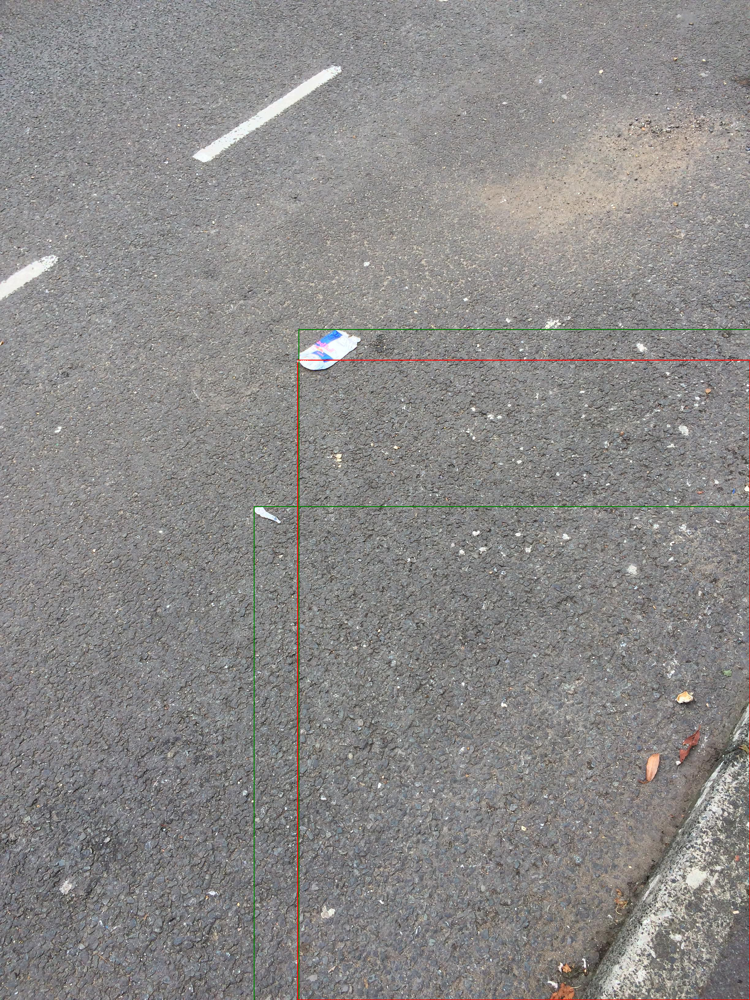

In [18]:
idx = 1
img, _ = dataset_test[idx]
label_boxes = np.array(dataset_test[idx][1]["boxes"])
loaded_model.eval()
with torch.no_grad():
    prediction = loaded_model([img])
image = Image.fromarray(img.mul(255).permute(1, 2,0).byte().numpy())
draw = ImageDraw.Draw(image)
for elem in range(len(label_boxes)):
    draw.rectangle([(label_boxes[elem][0], label_boxes[elem][1]),
    (label_boxes[elem][2], label_boxes[elem][3])], 
    outline ="green", width =3)
for element in range(len(prediction[0]["boxes"])):
    boxes = prediction[0]["boxes"][element].cpu().numpy()
    score = np.round(prediction[0]["scores"][element].cpu().numpy(),
                    decimals= 4)
    if score > 0.8:
        draw.rectangle([(boxes[0], boxes[1]), (boxes[2], boxes[3])], 
        outline ="red", width =3)
        draw.text((boxes[0], boxes[1]), text = str(score))
image